In [ ]:
%tensorflow_version 1.x
import tensorflow as tf
#tf.enable_eager_execution()
%matplotlib inline
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib
from scipy import optimize
import matplotlib.dates as dates
from ipywidgets import interact, widgets
from scipy.integrate import solve_ivp
plt.style.use('seaborn-poster')
matplotlib.rcParams['figure.figsize'] = (10., 6.)
import copy
import sympy
%matplotlib inline
import scipy as sp
from scipy.integrate import odeint
import datetime as dt
import timeit
import time
import os
from scipy.interpolate import CubicSpline
os.environ['KMP_DUPLICATE_LIB_OK']='TRUE'
np.set_printoptions(threshold=np.inf)
from prettytable import PrettyTable  
import matplotlib as mpl
import matplotlib.dates as mdates

In [ ]:
data = pd.read_csv("https://raw.githubusercontent.com/Jiel73654/Qualify-Exam_JieLong/master/Public-Dataset-Daily-Case-Info.csv",error_bad_lines = False)

In [ ]:
#The data range from 3/30 to 8/2
length = 126#time period
ic = data["TOTAL_CASES"]
IC = ic.iloc[26:152].to_numpy().reshape(length,1)
dc = data["TOTAL_DEATHS"]
DC = dc.iloc[26:152].to_numpy().reshape(length,1)
re = data["TOTAL_RECOVERED"]
RC = re.iloc[26:152].to_numpy().reshape(length,1)

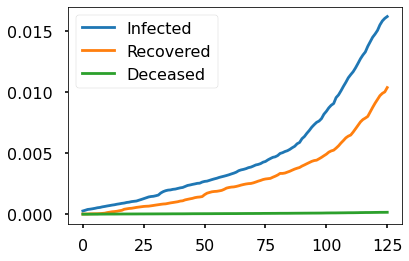

In [ ]:
N0 = 6.82*1.e6#The total population of tennessee
T = np.arange(0,length).reshape(length,1)
II = IC - RC - DC
SS = N0 - II - RC - DC
plt.plot(T,IC/N0)
plt.plot(T,RC/N0)
plt.plot(T,DC/N0)
plt.legend(("Infected","Recovered","Deceased"))

In [ ]:
np.random.seed(12345)
tf.compat.v1.set_random_seed(1234)
tf.compat.v1.disable_eager_execution()
class SIRD:
    def __init__(self, I, R, D, S, T, layers):
        self.t = T
        self.I = I
        self.R = R
        self.S = S
        self.D = D
        self.layers = layers
        self.lb = T.min()
        self.ub = T.max()
        # Initialize NN
        self.weights, self.biases = self.initialize_NN(self.layers)
        
        # Initialize parameters
        self.gamma = tf.Variable([1], dtype=tf.float32)
        self.beta = tf.Variable([1],constraint=lambda x: tf.abs(x),dtype=tf.float32)
        self.mu = tf.Variable([1], constraint=lambda x: tf.abs(x),dtype=tf.float32)
        # tf placeholders and graph
        self.sess = tf.compat.v1.Session(config=tf.compat.v1.ConfigProto(allow_soft_placement=True,
                                                     log_device_placement=True))
        self.t_tf = tf.compat.v1.placeholder(tf.float32, shape=[None, self.t.shape[1]])
        self.I_tf = tf.compat.v1.placeholder(tf.float32, shape=[None, self.I.shape[1]])
        self.R_tf = tf.compat.v1.placeholder(tf.float32, shape=[None, self.R.shape[1]])
        self.S_tf = tf.compat.v1.placeholder(tf.float32, shape=[None, self.S.shape[1]])
        self.D_tf = tf.compat.v1.placeholder(tf.float32, shape=[None, self.D.shape[1]])
       
        self.S_pred, self.I_pred, self.R_pred,self.D_pred,self.E1_pred, self.E2_pred, self.E3_pred, self.E4_pred, self.E5_pred = self.net_NS(
            self.t_tf)
        self.GE = tf.reduce_mean(tf.square(self.E1_pred))+ tf.reduce_mean(tf.square(self.E2_pred)) +\
                  tf.reduce_mean(tf.square(self.E3_pred)) + tf.reduce_mean(tf.square(self.E4_pred)) + tf.reduce_mean(tf.square(self.E5_pred))
        self.OB = tf.reduce_mean(tf.square(self.I_tf - self.I_pred)) + tf.reduce_mean(tf.square(self.R_pred - self.R_tf)) +\
                  tf.reduce_mean(tf.square(self.S_tf - self.S_pred)) + tf.reduce_mean(tf.square(self.D_tf - self.D_pred))
        self.loss = self.GE + self.OB
                    
        
        self.optimizer_Adam = tf.compat.v1.train.AdamOptimizer()
        #self.optimizer_Adam = tf.compat.v1.train.AdagradOptimizer(learning_rate = 0.01)
        self.train_op_Adam = self.optimizer_Adam.minimize(self.loss)                                     
        init = tf.compat.v1.global_variables_initializer()
        self.sess.run(init)
         
        
    def initialize_NN(self, layers):
        def xavier_init(size):
            in_dim = size[0]
            out_dim = size[1]        
            xavier_stddev = np.sqrt(2/(in_dim + out_dim))
            return tf.Variable(tf.random.truncated_normal([in_dim, out_dim], stddev=xavier_stddev), dtype=tf.float32)        
        weights = []
        biases = []
        num_layers = len(layers)
        for l in range(0,num_layers-1):
            W = xavier_init(size=[layers[l], layers[l+1]])
            b = tf.Variable(tf.zeros([1,layers[l+1]], dtype=tf.float32), dtype=tf.float32)
            weights.append(W)
            biases.append(b)        
        return weights, biases
    
    
    
    def forward(self, X, weights, biases):
        num_layers = len(weights) + 1
        H = 2.0*(X - self.lb)/(self.ub - self.lb) - 1.0
        for l in range(0,num_layers-2):
            W = weights[l]
            b = biases[l]
            H = tf.tanh(tf.add(tf.matmul(H, W), b))
        W = weights[-1]
        b = biases[-1]
        Y = tf.nn.softplus(tf.add(tf.matmul(H, W), b))
        return Y

    def forward1(self, X, weights, biases):
        num_layers = len(weights) + 1
        H = 2.0*(X - self.lb)/(self.ub - self.lb) - 1.0
        for l in range(0,num_layers-2):
            W = weights[l]
            b = biases[l]
            H = tf.tanh(tf.add(tf.matmul(H, W), b))
        W = weights[-1]
        b = biases[-1]
        Y = tf.nn.sigmoid(tf.add(tf.matmul(H, W), b))
        return Y

    def net_NS(self, t):
        gamma = self.gamma
        beta = self.beta
        mu = tf.abs(self.mu)
        #print(x.shape)
        #print(y.shape)
        output = self.forward1(t, self.weights, self.biases)
        #beta = self.neural_net(t,self.weights4,self.biases4)
        #gamma = self.neural_net1(t,self.weights5,self.biases5)
        
        S = output[:,0:1]
        I = output[:,1:2]
        R = output[:,2:3]
        D = output[:,3:4]

        E1 = tf.gradients(S, t)[0] + beta*S*I
        E2 = tf.gradients(I, t)[0] - beta*S*I + (mu + gamma)*I
        E3 = tf.gradients(R, t)[0] - gamma*I
        E4 = tf.gradients(D, t)[0] - mu*I
        E5 = 1 - (S+I+R+D)
        return S,I,R,D,E1,E2,E3,E4,E5

    def callback(self, loss):
        print('Loss: %.3e' % (loss))
    def train(self, nIter): 

        tf_dict = {self.t_tf: self.t, self.I_tf: self.I,self.R_tf: self.R,self.S_tf: self.S,self.D_tf: self.D}
        cpu_time = 0       
        start_time = time.time()
        for it in range(nIter):
            self.sess.run(self.train_op_Adam, tf_dict)
            if it % 10000 == 0:
                elapsed = time.time() - start_time
                loss_value = self.sess.run(self.loss, tf_dict)
                gamma_value = self.sess.run(self.gamma)
                beta_value = self.sess.run(self.beta)
                mu_value = self.sess.run(self.mu)
                ge_loss = self.sess.run(self.GE, tf_dict)
                ob_loss = self.sess.run(self.OB, tf_dict)
                cpu_time = cpu_time + elapsed
                print('It: %d, Loss: %.3e, GE_loss: %.5e,OB_loss: %.5e, Beta: %.5e,gamma: %.5e,mu: %.5e, Time: %.2f, cumulative_time: %.2f' % 
                      (it, loss_value,ge_loss,ob_loss,beta_value,gamma_value,mu_value,elapsed,cpu_time))
                start_time = time.time()
        return cpu_time
    def predict(self, t_star):
        tf_dict = {self.t_tf: t_star}
        S = self.sess.run(self.S_pred, tf_dict)
        I = self.sess.run(self.I_pred, tf_dict)
        R = self.sess.run(self.R_pred, tf_dict)
        D = self.sess.run(self.D_pred, tf_dict)
        #beta = self.sess.run(self.beta_pred,tf_dict)
        #gamma = self.sess.run(self.gamma_pred,tf_dict)
        #gamma = self.sess.run(self.gamma_pred,tf_dict)
        return S,I,R,D

In [ ]:
def handle(t1,t2,T_test,neural_network,s,i,r,d,layers,N_iter,N0,iter_num,S_ode,I_ode,R_ode,D_ode,S_learned,I_learned,R_learned,D_learned):
    a = CubicSpline(T_test,s[t1:t2])
    b = CubicSpline(T_test,i[t1:t2])
    c = CubicSpline(T_test,r[t1:t2])
    dd = CubicSpline(T_test,d[t1:t2])
    t_train = np.arange(t1,t2 - 1+iter_num,iter_num)
    s_train = a(t_train).reshape(len(t_train),1)/N0
    i_train = b(t_train).reshape(len(t_train),1)/N0
    r_train = c(t_train).reshape(len(t_train),1)/N0
    d_train = dd(t_train).reshape(len(t_train),1)/N0
    TT_train = t_train.reshape(len(t_train),1)
    model = neural_network(i_train,r_train,d_train,s_train,TT_train,layers)
    CPU_time = model.train(N_iter)
    TT = T_test.reshape(len(T_test),1)
    S_out,I_out,R_out,D_out = model.predict(TT)
    beta = model.sess.run(model.beta)
    gamma = model.sess.run(model.gamma)
    mu = model.sess.run(model.mu)
    print("beta: ",beta)
    print("gamma: ",gamma)
    print("mu: ",mu)
    def sird_model(z,t,beta_value,gamma,mu):
        s1 = z[0]
        i1 = z[1]
        r1 = z[2]
        d1 = z[3]
        dsdt = -beta_value*i1*s1
        didt = beta_value*i1*s1 - (gamma+mu)*i1
        drdt = gamma*i1
        dddt = mu*i1
        dzdt = [dsdt,didt,drdt,dddt]
        return dzdt
    z0 = [s_train[0,0],i_train[0,0],r_train[0,0],d_train[0,0]]
    z_sol = odeint(sird_model,z0,T_test,args=(beta[0],gamma[0],mu[0]))
    plt.figure(figsize=(8,14), dpi=100)
    plt.figure(1)
    plt.subplots_adjust(hspace = 0.5)
    ax1 = plt.subplot(411)  
    plt.plot(TT,100*S_out,c="red")
    plt.plot(T_test,100*z_sol[:,0],c='black')
    plt.scatter(T_test,100*s[t1:t2]/N0,marker='o',c='',edgecolors='blue',s=40,linewidths=1)
    plt.xlabel("Time(days)")
    plt.ylabel("S/N(%)")
    plt.legend(("S_nn","S_ode","S_data"))
    ax1 = plt.subplot(412) 
    plt.plot(TT,100*I_out,c="red")
    plt.plot(T_test,100*z_sol[:,1],c = "black")
    plt.scatter(T_test,100*i[t1:t2]/N0,marker='o',c='',edgecolors='blue',s=40,linewidths=1)
    plt.xlabel("Time(days)")
    plt.ylabel("I/N(%)")
    plt.legend(("I_nn","I_ode","I_data"))
    ax1 = plt.subplot(413)
    plt.plot(TT,100*R_out,c="red")
    plt.plot(T_test,100*z_sol[:,2],c = 'black')
    plt.scatter(T_test,100*r[t1:t2]/N0,marker='o',c='',edgecolors='blue',s=40,linewidths=1)
    plt.xlabel("Time(days)")
    plt.ylabel("R/N(%)")
    plt.legend(("R_nn","R_ode","R_data"))
    ax1 = plt.subplot(414)
    plt.plot(TT,100*D_out,c="red")
    plt.plot(T_test,100*z_sol[:,3],c='black')
    plt.scatter(T_test,100*d[t1:t2]/N0,marker='o',c='',edgecolors='blue',s=40,linewidths=1)
    plt.legend(("D_nn","D_ode","D_data"))
    plt.xlabel("Time(days)")
    plt.ylabel("D/N(%)")
    plt.show()
    S_ode[t1:t2] = z_sol[:,0]
    I_ode[t1:t2] = z_sol[:,1]
    R_ode[t1:t2] = z_sol[:,2]
    D_ode[t1:t2] = z_sol[:,3]
    S_learned[t1:t2] = S_out[:,0]
    I_learned[t1:t2] = I_out[:,0]
    R_learned[t1:t2] = R_out[:,0]
    D_learned[t1:t2] = D_out[:,0]
    '''
    S_erode = np.abs(s[t1:t2] - S_out)/s[t1:t2]
    S_erNN = np.abs(s[t1:t2] - z_sol[:,0])/s[t1:t2]
    I_erode = np.abs(i[t1:t2] - I_out)/i[t1:t2]
    I_erNN = np.abs(i[t1:t2] - z_sol[:,1])/i[t1:t2]
    R_erode = np.abs(r[t1:t2] - R_out)/r[t1:t2]
    R_erNN = np.abs(r[t1:t2] - z_sol[:,2])/r[t1:t2]
    '''
    return S_out,I_out,R_out,D_out,beta[0],gamma[0],mu[0],z_sol,S_ode,I_ode,R_ode,D_ode,S_learned,I_learned,R_learned,D_learned,CPU_time

In [ ]:
def sum_all(layers,length,SS,II,RC,DC,N0,inter_numb,NIter):
    S_ode = np.zeros(length)
    I_ode = np.zeros(length)
    R_ode = np.zeros(length)
    D_ode = np.zeros(length)
    S_learned = np.zeros(length)
    I_learned = np.zeros(length)
    R_learned = np.zeros(length)
    D_learned = np.zeros(length)
    gamma_all = np.zeros(18)
    beta_all = np.zeros(18)
    mu_all = np.zeros(18)
    T1 = np.arange(0,7).reshape(7,)
    S1,I1,R1,D1,beta1,gamma1,mu1,z1,S_ode,I_ode,R_ode,D_ode,S_learned,I_learned,R_learned,D_learned,time1 = handle(0,7,T1,SIRD,SS,II,RC,DC,layers,NIter,N0,inter_numb,S_ode,I_ode,R_ode,D_ode,S_learned,I_learned,R_learned,D_learned)
    #2th week
    T2 = np.arange(7,14).reshape(7,)
    S2,I2,R2,D2,beta2,gamma2,mu2,z2,S_ode,I_ode,R_ode,D_ode,S_learned,I_learned,R_learned,D_learned,time2 = handle(7,14,T2,SIRD,SS,II,RC,DC,layers,NIter,N0,inter_numb,S_ode,I_ode,R_ode,D_ode,S_learned,I_learned,R_learned,D_learned)
    #3th week
    T3 = np.arange(14,21).reshape(7,)
    S3,I3,R3,D3,beta3,gamma3,mu3,z3,S_ode,I_ode,R_ode,D_ode,S_learned,I_learned,R_learned,D_learned,time3 = handle(14,21,T3,SIRD,SS,II,RC,DC,layers,NIter,N0,inter_numb,S_ode,I_ode,R_ode,D_ode,S_learned,I_learned,R_learned,D_learned)
    #4th week
    T4 = np.arange(21,28).reshape(7,)
    S4,I4,R4,D4,beta4,gamma4,mu4,z4,S_ode,I_ode,R_ode,D_ode,S_learned,I_learned,R_learned,D_learned,time4 = handle(21,28,T4,SIRD,SS,II,RC,DC,layers,NIter,N0,inter_numb,S_ode,I_ode,R_ode,D_ode,S_learned,I_learned,R_learned,D_learned)
    #5th week
    T5 = np.arange(28,35).reshape(7,)
    S5,I5,R5,D5,beta5,gamma5,mu5,z5,S_ode,I_ode,R_ode,D_ode,S_learned,I_learned,R_learned,D_learned,time5 = handle(28,35,T5,SIRD,SS,II,RC,DC,layers,NIter,N0,inter_numb,S_ode,I_ode,R_ode,D_ode,S_learned,I_learned,R_learned,D_learned)
    #6th week
    T6 = np.arange(35,42).reshape(7,)
    S6,I6,R6,D6,beta6,gamma6,mu6,z6,S_ode,I_ode,R_ode,D_ode,S_learned,I_learned,R_learned,D_learned,time6 = handle(35,42,T6,SIRD,SS,II,RC,DC,layers,NIter,N0,inter_numb,S_ode,I_ode,R_ode,D_ode,S_learned,I_learned,R_learned,D_learned)
    #7th week
    T7 = np.arange(42,49).reshape(7,)
    S7,I7,R7,D7,beta7,gamma7,mu7,z7,S_ode,I_ode,R_ode,D_ode,S_learned,I_learned,R_learned,D_learned,time7 = handle(42,49,T7,SIRD,SS,II,RC,DC,layers,NIter,N0,inter_numb,S_ode,I_ode,R_ode,D_ode,S_learned,I_learned,R_learned,D_learned)
    #8th week
    T8 = np.arange(49,56).reshape(7,)
    S8,I8,R8,D8,beta8,gamma8,mu8,z8,S_ode,I_ode,R_ode,D_ode,S_learned,I_learned,R_learned,D_learned,time8 = handle(49,56,T8,SIRD,SS,II,RC,DC,layers,NIter,N0,inter_numb,S_ode,I_ode,R_ode,D_ode,S_learned,I_learned,R_learned,D_learned)
    #9th week
    T9 = np.arange(56,63).reshape(7,)
    S9,I9,R9,D9,beta9,gamma9,mu9,z9,S_ode,I_ode,R_ode,D_ode,S_learned,I_learned,R_learned,D_learned,time9 = handle(56,63,T9,SIRD,SS,II,RC,DC,layers,NIter,N0,inter_numb,S_ode,I_ode,R_ode,D_ode,S_learned,I_learned,R_learned,D_learned)
    #10th week
    T10 = np.arange(63,70).reshape(7,)
    S10,I10,R10,D10,beta10,gamma10,mu10,z10,S_ode,I_ode,R_ode,D_ode,S_learned,I_learned,R_learned,D_learned,time10 = handle(63,70,T10,SIRD,SS,II,RC,DC,layers,NIter,N0,inter_numb,S_ode,I_ode,R_ode,D_ode,S_learned,I_learned,R_learned,D_learned)
    #11 weeks
    T11 = np.arange(70,77).reshape(7,)
    S11,I11,R11,D11,beta11,gamma11,mu11,z11,S_ode,I_ode,R_ode,D_ode,S_learned,I_learned,R_learned,D_learned,time11 = handle(70,77,T11,SIRD,SS,II,RC,DC,layers,NIter,N0,inter_numb,S_ode,I_ode,R_ode,D_ode,S_learned,I_learned,R_learned,D_learned)
    #12
    T12 = np.arange(77,84).reshape(7,)
    S12,I12,R12,D12,beta12,gamma12,mu12,z12,S_ode,I_ode,R_ode,D_ode,S_learned,I_learned,R_learned,D_learned,time12 = handle(77,84,T12,SIRD,SS,II,RC,DC,layers,NIter,N0,inter_numb,S_ode,I_ode,R_ode,D_ode,S_learned,I_learned,R_learned,D_learned)
    #13
    T13 = np.arange(84,91).reshape(7,)
    S13,I13,R13,D13,beta13,gamma13,mu13,z13,S_ode,I_ode,R_ode,D_ode,S_learned,I_learned,R_learned,D_learned,time13 = handle(84,91,T13,SIRD,SS,II,RC,DC,layers,NIter,N0,inter_numb,S_ode,I_ode,R_ode,D_ode,S_learned,I_learned,R_learned,D_learned)
    #14
    T14 = np.arange(91,98).reshape(7,)
    S14,I14,R14,D14,beta14,gamma14,mu14,z14,S_ode,I_ode,R_ode,D_ode,S_learned,I_learned,R_learned,D_learned,time14 = handle(91,98,T14,SIRD,SS,II,RC,DC,layers,NIter,N0,inter_numb,S_ode,I_ode,R_ode,D_ode,S_learned,I_learned,R_learned,D_learned)
    #15
    T15 = np.arange(98,105).reshape(7,)
    S15,I15,R15,D15,beta15,gamma15,mu15,z15,S_ode,I_ode,R_ode,D_ode,S_learned,I_learned,R_learned,D_learned,time15 = handle(98,105,T15,SIRD,SS,II,RC,DC,layers,NIter,N0,inter_numb,S_ode,I_ode,R_ode,D_ode,S_learned,I_learned,R_learned,D_learned)
    #16
    T16 = np.arange(105,112).reshape(7,)
    S16,I16,R16,D16,beta16,gamma16,mu16,z16,S_ode,I_ode,R_ode,D_ode,S_learned,I_learned,R_learned,D_learned,time16 = handle(105,112,T16,SIRD,SS,II,RC,DC,layers,NIter,N0,inter_numb,S_ode,I_ode,R_ode,D_ode,S_learned,I_learned,R_learned,D_learned)
    #17
    T17 = np.arange(112,119).reshape(7,)
    S17,I17,R17,D17,beta17,gamma17,mu17,z17,S_ode,I_ode,R_ode,D_ode,S_learned,I_learned,R_learned,D_learned,time17 = handle(112,119,T17,SIRD,SS,II,RC,DC,layers,NIter,N0,inter_numb,S_ode,I_ode,R_ode,D_ode,S_learned,I_learned,R_learned,D_learned)
    #18
    T18 = np.arange(119,126).reshape(7,)
    S18,I18,R18,D18,beta18,gamma18,mu18,z18,S_ode,I_ode,R_ode,D_ode,S_learned,I_learned,R_learned,D_learned,time18 = handle(119,126,T18,SIRD,SS,II,RC,DC,layers,NIter,N0,inter_numb,S_ode,I_ode,R_ode,D_ode,S_learned,I_learned,R_learned,D_learned)
    
    gamma_all[0],gamma_all[1],gamma_all[2],gamma_all[3],gamma_all[4] = gamma1,gamma2,gamma3,gamma4,gamma5
    gamma_all[5],gamma_all[6],gamma_all[7],gamma_all[8],gamma_all[9] = gamma6,gamma7,gamma8,gamma9,gamma10
    gamma_all[10],gamma_all[11],gamma_all[12],gamma_all[13],gamma_all[14],gamma_all[15],gamma_all[16],gamma_all[17]= gamma11,gamma12,gamma13,gamma14,gamma15,gamma16,gamma17,gamma18
    beta_all[0],beta_all[1],beta_all[2],beta_all[3],beta_all[4] = beta1,beta2,beta3,beta4,beta5
    beta_all[5],beta_all[6],beta_all[7],beta_all[8],beta_all[9] = beta6,beta7,beta8,beta9,beta10
    beta_all[10],beta_all[11],beta_all[12],beta_all[13],beta_all[14],beta_all[15],beta_all[16],beta_all[17]=beta11,beta12,beta13,beta14,beta15,beta16,beta17,beta18
    mu_all[0],mu_all[1],mu_all[2],mu_all[3],mu_all[4],mu_all[5],mu_all[6],mu_all[7],mu_all[8],mu_all[9],mu_all[10],mu_all[11],mu_all[12],mu_all[13],mu_all[14],mu_all[15],mu_all[16],mu_all[17] = mu1,mu2,mu3,mu4,mu5,mu6,mu7,mu8,mu9,mu10,mu11,mu12,mu13,mu14,mu15,mu16,mu17,mu18
    time_con = time1+time2+time3+time4+time5+time6+time7+time8+time9+time10+time11+time12+time13+time14+time15+time16+time17+time18

    date_begin = dt.datetime(2020,3,30)
    date_end = dt.datetime(2020,8,3)
    delta = dt.timedelta(days=1)
    dates = mpl.dates.drange(date_begin, date_end, delta)
    lims = (np.datetime64('2020-03-30'), np.datetime64('2020-08-02'))
    fig, axs = plt.subplots(4, 1, constrained_layout=True, figsize=(13, 15))
    y = np.array([SS/N0,II/N0,RC/N0,DC/N0])
    y1 = np.array([S_learned,I_learned,R_learned,D_learned])
    y2 = np.array([S_ode,I_ode,R_ode,D_ode])
    y_label1 = ["S/N","I/N","R/N","D/N"]
    legend1 = [("S_data","S_NN","S_ode"),("I_data","I_NN","I_ode"),("R_data","R_NN","R_ode"),("D_data","D_NN","D_ode")]
    title1 = ["Suscceptible","Infected","Recovered","Deceased"]
    for nn, ax in enumerate(axs):
        locator = mdates.AutoDateLocator(minticks=3, maxticks=7)
        formatter = mdates.ConciseDateFormatter(locator)
        ax.xaxis.set_major_locator(locator)
        ax.xaxis.set_major_formatter(formatter)
        ax.plot(dates, y[nn],'.')
        ax.plot(dates, y1[nn])
        ax.plot(dates, y2[nn])
        ax.set_title(title1[nn])
        ax.set_xlabel("Date")
        ax.set_ylabel(y_label1[nn])
        ax.set_xlim(lims)
        ax.legend(legend1[nn])
    plt.show()
    x = PrettyTable()
    x.field_names = ["Paramaters","Week 1","Week 2","Week 3","Week 4","Week 5","Week 6","Week 7","Week 8","Week 9","Week 10","Week 11","Week 12","Week 13","Week 14","Week 15","Week 16","Week 17","Week 18"]
    x.add_row(["beta",beta1,beta2,beta3,beta4,beta5,beta6,beta7,beta8,beta9,beta10,beta11,beta12,beta13,beta14,beta15,beta16,beta17,beta18])
    x.add_row(["gamma",gamma1,gamma2,gamma3,gamma4,gamma5,gamma6,gamma7,gamma8,gamma9,gamma10,gamma11,gamma12,gamma13,gamma14,gamma15,gamma16,gamma17,gamma18])
    x.add_row(["mu",mu1,mu2,mu3,mu4,mu5,mu6,mu7,mu8,mu9,mu10,mu11,mu12,mu13,mu14,mu15,mu16,mu17,mu18])
    x.add_row(["Reproduction Number",beta1/(mu1+gamma1),beta2/(mu2+gamma2),beta3/(mu3+gamma3),beta4/(mu4+gamma4),beta5/(mu5+gamma5),beta6/(mu6+gamma6),beta7/(mu7+gamma7),beta8/(mu8+gamma8),beta9/(mu9+gamma9),beta10/(mu10+gamma10),beta11/(mu11+gamma11),beta12/(mu12+gamma12)
              ,beta13/(mu13+gamma13),beta14/(mu14+gamma14),beta15/(mu15+gamma15),beta16/(mu16+gamma16),beta17/(mu17+gamma17),beta18/(mu18+gamma18)])
    print(x)
    R0 = beta_all/(mu_all+gamma_all)
    delta1 = dt.timedelta(days=7)
    dates1 = mpl.dates.drange(date_begin, date_end, delta1)
    fig, axs = plt.subplots(constrained_layout=True, figsize=(12, 8))
    locator = mdates.AutoDateLocator(minticks=3, maxticks=7)
    formatter = mdates.ConciseDateFormatter(locator)
    axs.xaxis.set_major_locator(locator)
    axs.xaxis.set_major_formatter(formatter)
    axs.plot(dates1, beta_all)
    axs.plot(dates1, gamma_all)
    axs.plot(dates1, mu_all)
    axs.set_xlabel("Date")
    axs.set_ylabel("Value of Parameters")
    axs.set_xlim(lims)
    axs.legend(("beta","gamma","mu"),loc = "center left")
    axs.set_title('Parameters of SIRD')
    plt.show()
    fig, axs = plt.subplots(constrained_layout=True, figsize=(12, 8))
    locator = mdates.AutoDateLocator(minticks=3, maxticks=7)
    formatter = mdates.ConciseDateFormatter(locator)
    axs.xaxis.set_major_locator(locator)
    axs.xaxis.set_major_formatter(formatter)
    axs.plot(dates1, R0)
    axs.plot(dates1,R0,'.',c = "black",linewidth=2)
    axs.set_xlabel("Date")
    axs.set_ylabel("$R_{e}$")
    axs.set_xlim(lims)
    axs.set_title("The Effective Reproduction Number ")
    plt.show()
    S_erNN = np.abs(S_learned.reshape(len(S_learned),1) -SS/N0)/(SS/N0)
    S_erode = np.abs(S_ode.reshape(len(S_ode),1) -SS/N0)/(SS/N0)
    I_erNN = np.abs(I_learned.reshape(len(I_learned),1) - II/N0)/(II/N0)
    I_erode = np.abs(I_ode.reshape(len(I_ode),1) - II/N0)/(II/N0)
    R_erNN = np.abs((R_learned.reshape(len(R_learned),1)) - (RC/N0))/(RC/N0)
    R_erode = np.abs(R_ode.reshape(len(R_ode),1) - RC/N0)/(RC/N0)
    D_erNN = np.abs(D_learned.reshape(len(D_learned),1) - DC/N0)/(DC/N0)
    D_erode = np.abs(D_ode.reshape(len(D_ode),1) - DC/N0)/(DC/N0)
    fig, axs = plt.subplots(4, 1, constrained_layout=True, figsize=(13, 15))
    nn_err = np.array([S_erNN,I_erNN,R_erNN,D_erNN])
    ode_err = np.array([S_erode,I_erode,R_erode,D_erode])
    for nn, ax in enumerate(axs):
        locator = mdates.AutoDateLocator(minticks=3, maxticks=7)
        formatter = mdates.ConciseDateFormatter(locator)
        ax.xaxis.set_major_locator(locator)
        ax.xaxis.set_major_formatter(formatter)
        ax.plot(dates, ode_err[nn])
        ax.plot(dates, nn_err[nn])
        ax.set_xlabel("Date")
        ax.set_ylabel('Relative error')
        ax.set_xlim(lims)
        ax.set_title(title1[nn])
        ax.legend(("ODE Error","NN Error"))
    plt.show()  
    return S_ode,I_ode,R_ode,D_ode,S_learned,I_learned,R_learned,D_learned,beta_all,gamma_all,mu_all,S_erNN,I_erNN,R_erNN,D_erNN,S_erode,I_erode,R_erode,D_erode,time_con

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.077e+00, GE_loss: 2.07166e+00,OB_loss: 1.00541e+00, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 0.47, cumulative_time: 0.47
It: 10000, Loss: 3.710e-06, GE_loss: 1.02954e-06,OB_loss: 2.68082e-06, Beta: 1.07591e+00,gamma: 9.08727e-01,mu: 9.08186e-01, Time: 20.70, cumulative_time: 21.16
It: 20000, Loss: 1.266e-07, GE_loss: 3.41716e-08,OB_loss: 9.24436e-08, Beta: 1.07220e+00,gamma: 8.97298e-01,mu: 8.96426e-01, Time: 20.68, cumulative_time: 41.84
It: 30000, Loss: 1.506e-09, GE_loss: 2.59475e-10,OB_loss: 1.24658e-09, Beta: 1.02776e-01,gamma: 1.25060e-02,mu: 6.87360e-03, Time: 20.52, cumulative_time: 62.36
It: 40000, Loss: 7.699e-10, GE_loss: 4.44917e-11,OB_loss: 7.25452e-10, Beta: 1.03313e-01,gamma: 1.02762e-02,mu: 3.21371e-03, Time: 20.75, cumulative_time: 83.11
beta:  [0.10342107]
gamma:  [0.0103308]
mu:  [0.00291503]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


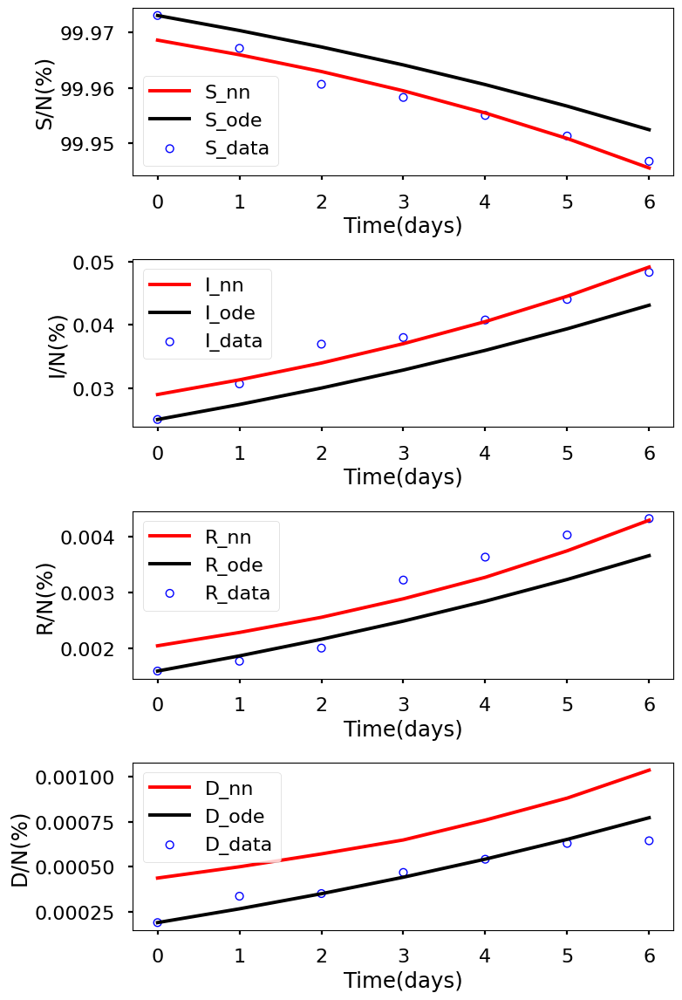

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.234e+00, GE_loss: 2.22984e+00,OB_loss: 1.00464e+00, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 0.45, cumulative_time: 0.45
It: 10000, Loss: 2.110e-06, GE_loss: 9.33763e-07,OB_loss: 1.17664e-06, Beta: 1.07760e+00,gamma: 9.11514e-01,mu: 9.11876e-01, Time: 21.26, cumulative_time: 21.71
It: 20000, Loss: 2.373e-07, GE_loss: 6.55806e-08,OB_loss: 1.71732e-07, Beta: 1.08560e+00,gamma: 8.94089e-01,mu: 8.93677e-01, Time: 20.68, cumulative_time: 42.39
It: 30000, Loss: 1.515e-09, GE_loss: 3.40399e-10,OB_loss: 1.17464e-09, Beta: 6.21881e-02,gamma: 3.73371e-02,mu: 5.77280e-03, Time: 20.88, cumulative_time: 63.27
It: 40000, Loss: 4.014e-10, GE_loss: 1.40116e-10,OB_loss: 2.61248e-10, Beta: 6.57428e-02,gamma: 5.32217e-02,mu: 4.91940e-03, Time: 22.17, cumulative_time: 85.44
beta:  [0.06617015]
gamma:  [0.05500282]
mu:  [0.0047981]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


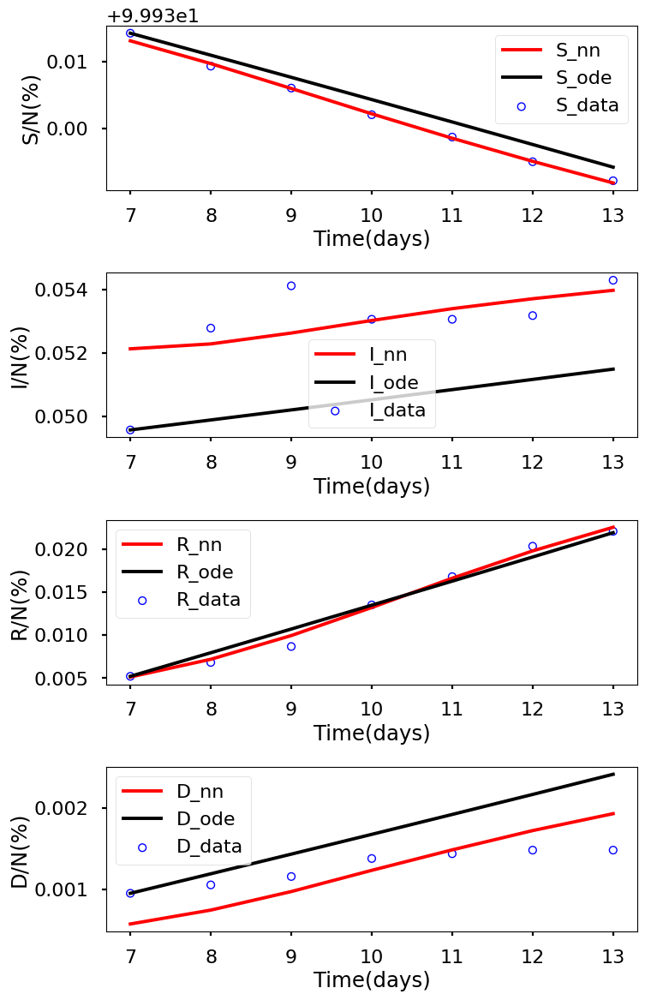

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.145e+00, GE_loss: 2.14862e+00,OB_loss: 9.95898e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 0.89, cumulative_time: 0.89
It: 10000, Loss: 2.121e-06, GE_loss: 1.18993e-06,OB_loss: 9.31510e-07, Beta: 1.07804e+00,gamma: 9.03234e-01,mu: 9.02906e-01, Time: 24.94, cumulative_time: 25.83
It: 20000, Loss: 2.236e-07, GE_loss: 6.29223e-08,OB_loss: 1.60629e-07, Beta: 1.08586e+00,gamma: 8.85201e-01,mu: 8.83409e-01, Time: 21.64, cumulative_time: 47.47
It: 30000, Loss: 1.723e-09, GE_loss: 4.21975e-10,OB_loss: 1.30122e-09, Beta: 6.45140e-02,gamma: 6.93058e-02,mu: 2.82598e-03, Time: 21.32, cumulative_time: 68.79
It: 40000, Loss: 5.297e-10, GE_loss: 6.46938e-11,OB_loss: 4.65001e-10, Beta: 6.61345e-02,gamma: 8.29365e-02,mu: 2.25665e-03, Time: 21.58, cumulative_time: 90.37
beta:  [0.06723921]
gamma:  [0.08363698]
mu:  [0.00228481]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


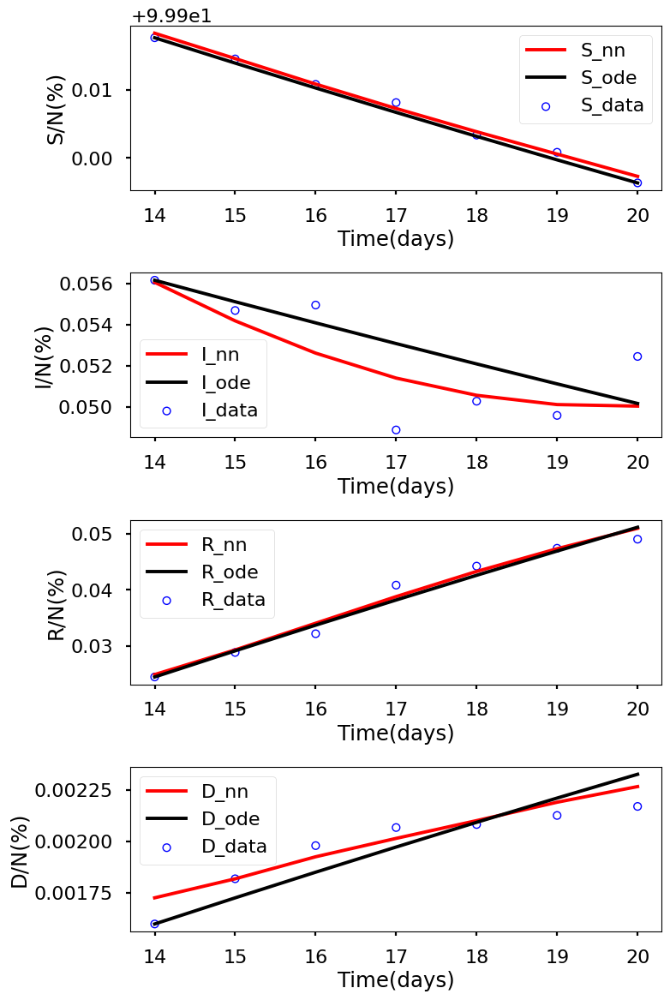

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.083e+00, GE_loss: 2.07925e+00,OB_loss: 1.00389e+00, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 0.52, cumulative_time: 0.52
It: 10000, Loss: 2.124e-06, GE_loss: 1.02209e-06,OB_loss: 1.10237e-06, Beta: 1.07432e+00,gamma: 9.12073e-01,mu: 9.11530e-01, Time: 21.59, cumulative_time: 22.11
It: 20000, Loss: 2.776e-07, GE_loss: 8.52408e-08,OB_loss: 1.92361e-07, Beta: 1.08833e+00,gamma: 8.88247e-01,mu: 8.84776e-01, Time: 21.54, cumulative_time: 43.65
It: 30000, Loss: 4.332e-10, GE_loss: 1.69395e-10,OB_loss: 2.63795e-10, Beta: 1.10623e-01,gamma: 3.96169e-02,mu: 3.88271e-03, Time: 21.61, cumulative_time: 65.27
It: 40000, Loss: 2.434e-10, GE_loss: 3.84986e-11,OB_loss: 2.04855e-10, Beta: 1.10475e-01,gamma: 3.78869e-02,mu: 3.81303e-03, Time: 21.37, cumulative_time: 86.64
beta:  [0.11031496]
gamma:  [0.0378919]
mu:  [0.00363485]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


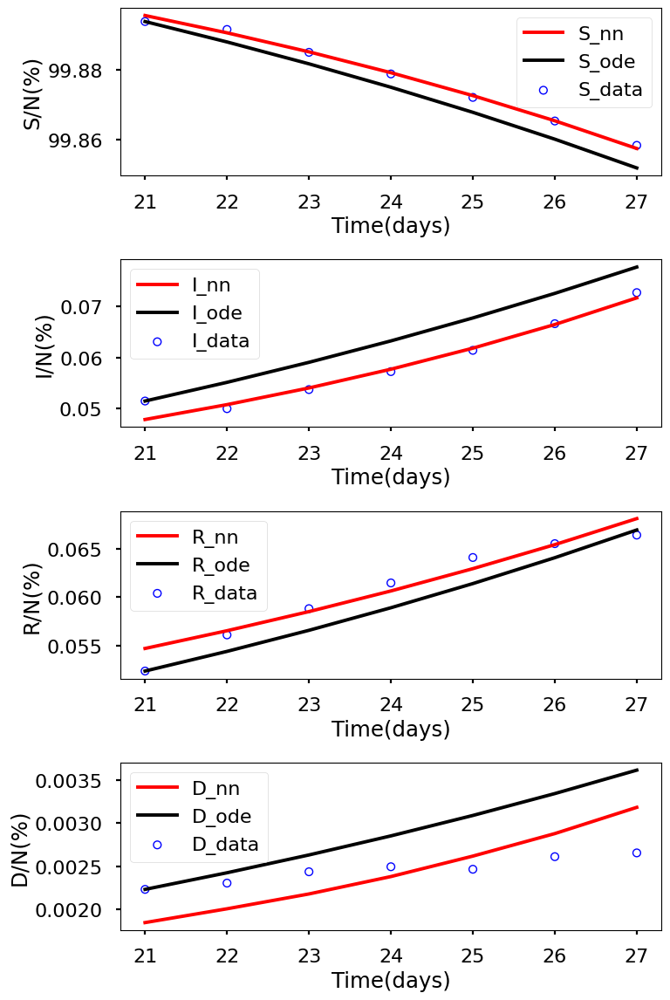

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.062e+00, GE_loss: 2.06414e+00,OB_loss: 9.97428e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 0.57, cumulative_time: 0.57
It: 10000, Loss: 2.462e-06, GE_loss: 8.60726e-07,OB_loss: 1.60169e-06, Beta: 1.07089e+00,gamma: 9.20013e-01,mu: 9.20479e-01, Time: 21.51, cumulative_time: 22.08
It: 20000, Loss: 5.631e-07, GE_loss: 1.70573e-07,OB_loss: 3.92518e-07, Beta: 1.10804e+00,gamma: 8.75519e-01,mu: 8.70102e-01, Time: 23.34, cumulative_time: 45.42
It: 30000, Loss: 2.234e-09, GE_loss: 4.28443e-10,OB_loss: 1.80586e-09, Beta: 1.14271e-01,gamma: 3.67951e-02,mu: 2.28926e-03, Time: 21.44, cumulative_time: 66.85
It: 40000, Loss: 1.877e-09, GE_loss: 2.09165e-10,OB_loss: 1.66736e-09, Beta: 1.10822e-01,gamma: 3.11512e-02,mu: 2.27198e-03, Time: 21.70, cumulative_time: 88.55
beta:  [0.10799832]
gamma:  [0.03008813]
mu:  [0.00270642]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


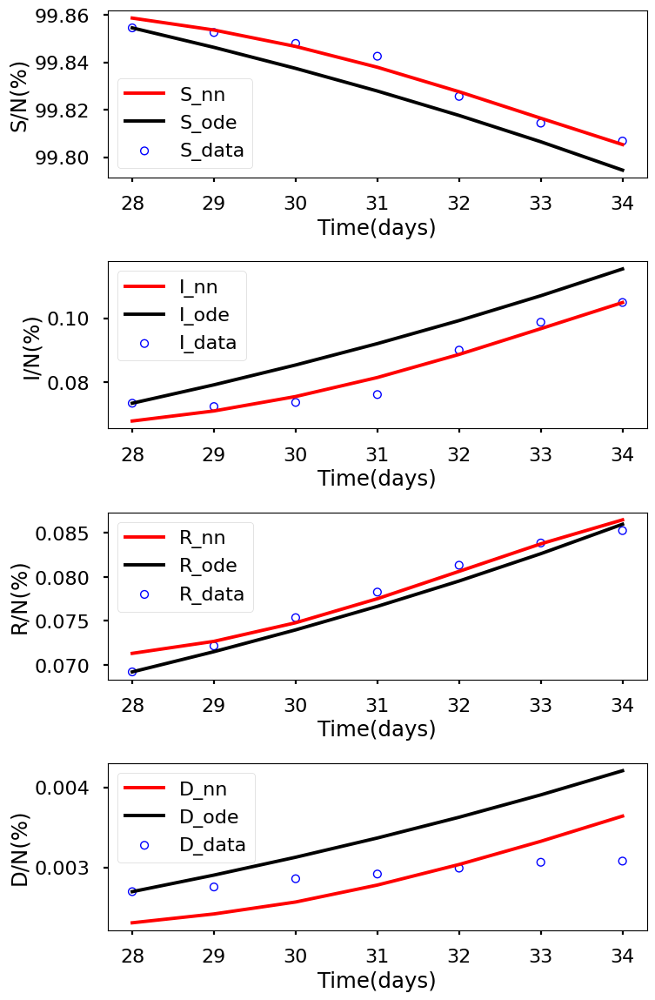

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.062e+00, GE_loss: 2.06332e+00,OB_loss: 9.98451e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 0.60, cumulative_time: 0.60
It: 10000, Loss: 1.920e-06, GE_loss: 8.39009e-07,OB_loss: 1.08102e-06, Beta: 1.07407e+00,gamma: 9.19761e-01,mu: 9.19098e-01, Time: 21.31, cumulative_time: 21.90
It: 20000, Loss: 8.800e-07, GE_loss: 2.76067e-07,OB_loss: 6.03931e-07, Beta: 1.08506e+00,gamma: 8.55929e-01,mu: 8.47047e-01, Time: 21.53, cumulative_time: 43.44
It: 30000, Loss: 2.173e-10, GE_loss: 1.08633e-10,OB_loss: 1.08664e-10, Beta: 3.78705e-02,gamma: 3.29678e-02,mu: 9.59166e-04, Time: 21.93, cumulative_time: 65.37
It: 40000, Loss: 1.406e-10, GE_loss: 5.49807e-11,OB_loss: 8.56657e-11, Beta: 3.79721e-02,gamma: 3.38287e-02,mu: 8.41714e-04, Time: 21.75, cumulative_time: 87.12
beta:  [0.03800895]
gamma:  [0.03405111]
mu:  [0.0008082]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


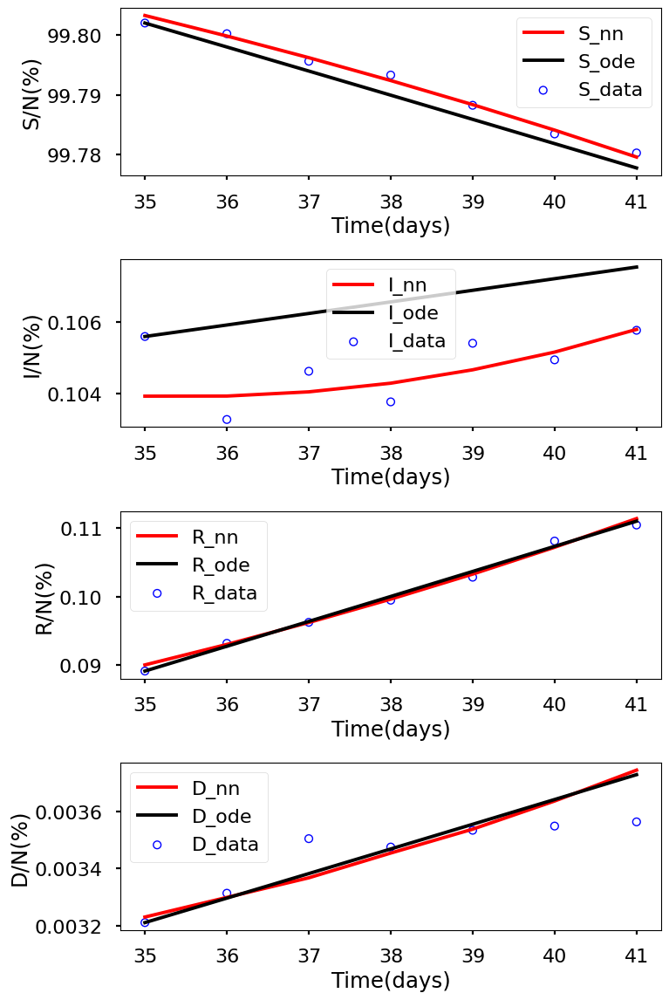

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.121e+00, GE_loss: 2.12478e+00,OB_loss: 9.95894e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 0.68, cumulative_time: 0.68
It: 10000, Loss: 1.984e-06, GE_loss: 1.01904e-06,OB_loss: 9.64698e-07, Beta: 1.07201e+00,gamma: 9.15920e-01,mu: 9.15586e-01, Time: 21.09, cumulative_time: 21.77
It: 20000, Loss: 9.593e-07, GE_loss: 3.01256e-07,OB_loss: 6.58073e-07, Beta: 1.08014e+00,gamma: 8.48735e-01,mu: 8.37105e-01, Time: 21.32, cumulative_time: 43.09
It: 30000, Loss: 4.521e-10, GE_loss: 7.38334e-11,OB_loss: 3.78237e-10, Beta: 3.95111e-02,gamma: 3.65732e-02,mu: 8.93868e-04, Time: 23.55, cumulative_time: 66.64
It: 40000, Loss: 3.053e-10, GE_loss: 2.79600e-11,OB_loss: 2.77308e-10, Beta: 3.95506e-02,gamma: 3.77887e-02,mu: 1.00547e-03, Time: 22.46, cumulative_time: 89.10
beta:  [0.03956475]
gamma:  [0.03807839]
mu:  [0.00105003]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


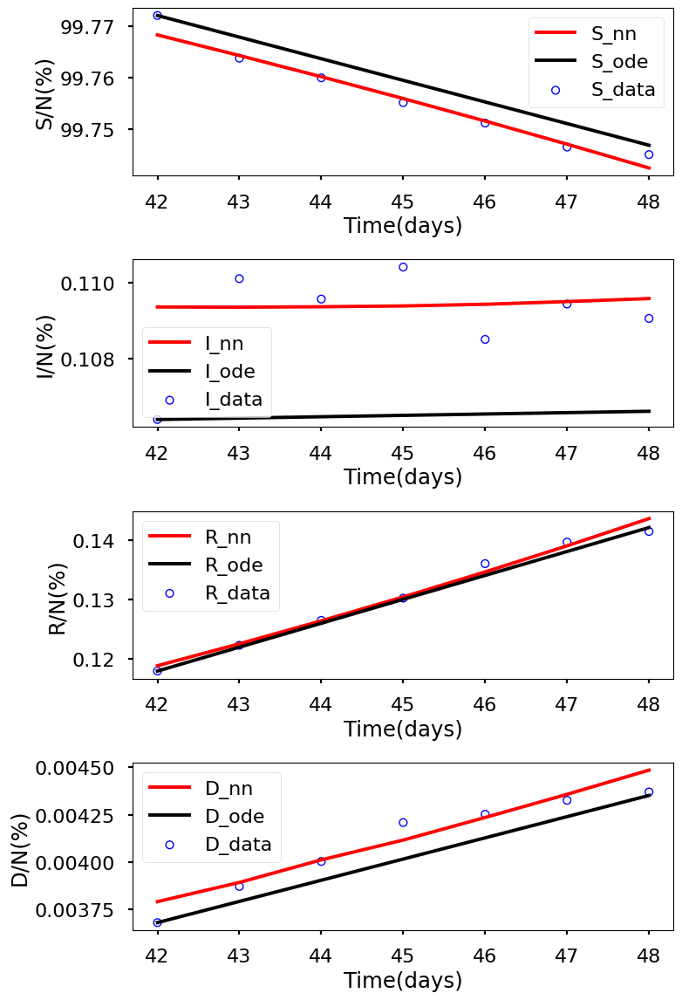

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.087e+00, GE_loss: 2.09281e+00,OB_loss: 9.93732e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 0.69, cumulative_time: 0.69
It: 10000, Loss: 2.065e-06, GE_loss: 1.01418e-06,OB_loss: 1.05129e-06, Beta: 1.07532e+00,gamma: 9.12681e-01,mu: 9.12290e-01, Time: 23.73, cumulative_time: 24.42
It: 20000, Loss: 7.887e-07, GE_loss: 2.46651e-07,OB_loss: 5.42058e-07, Beta: 1.08536e+00,gamma: 8.58652e-01,mu: 8.48467e-01, Time: 22.02, cumulative_time: 46.44
It: 30000, Loss: 3.203e-09, GE_loss: 6.00576e-10,OB_loss: 2.60237e-09, Beta: 5.14013e-02,gamma: 6.95469e-02,mu: 8.18117e-06, Time: 22.58, cumulative_time: 69.02
It: 40000, Loss: 2.755e-09, GE_loss: 9.56910e-10,OB_loss: 1.79765e-09, Beta: 5.27209e-02,gamma: 6.96225e-02,mu: 9.22458e-05, Time: 22.01, cumulative_time: 91.04
beta:  [0.05211148]
gamma:  [0.06890787]
mu:  [8.9290625e-05]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


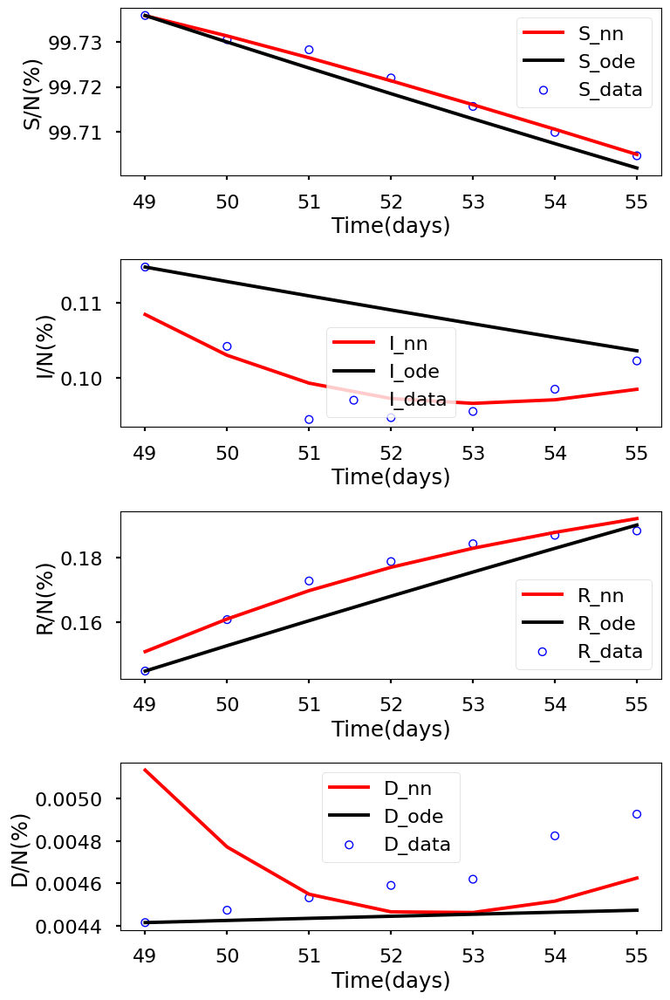

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.077e+00, GE_loss: 2.08558e+00,OB_loss: 9.91222e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 0.72, cumulative_time: 0.72
It: 10000, Loss: 2.114e-06, GE_loss: 9.69542e-07,OB_loss: 1.14437e-06, Beta: 1.07322e+00,gamma: 9.13188e-01,mu: 9.13085e-01, Time: 21.73, cumulative_time: 22.45
It: 20000, Loss: 8.308e-07, GE_loss: 2.65671e-07,OB_loss: 5.65153e-07, Beta: 1.08170e+00,gamma: 8.53468e-01,mu: 8.40247e-01, Time: 21.92, cumulative_time: 44.37
It: 30000, Loss: 2.002e-09, GE_loss: 1.71155e-10,OB_loss: 1.83083e-09, Beta: 5.70025e-02,gamma: 5.91573e-02,mu: 9.00466e-04, Time: 21.85, cumulative_time: 66.22
It: 40000, Loss: 1.668e-09, GE_loss: 1.00649e-10,OB_loss: 1.56753e-09, Beta: 5.63154e-02,gamma: 6.08678e-02,mu: 6.01512e-04, Time: 22.08, cumulative_time: 88.30
beta:  [0.05564545]
gamma:  [0.06047006]
mu:  [0.00021762]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


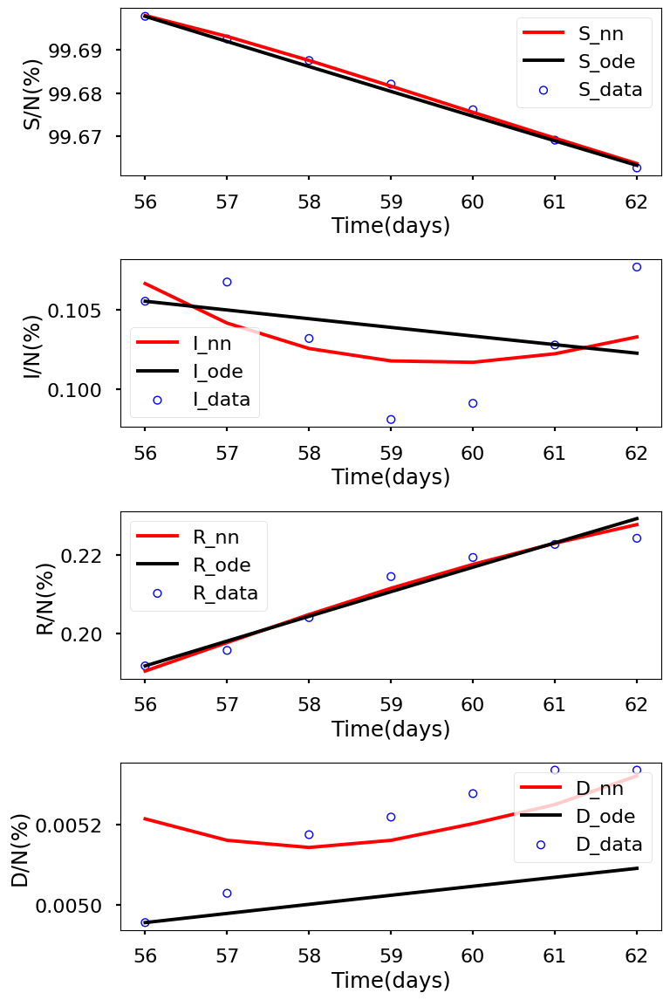

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.107e+00, GE_loss: 2.11469e+00,OB_loss: 9.91972e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 0.76, cumulative_time: 0.76
It: 10000, Loss: 2.289e-06, GE_loss: 1.44851e-06,OB_loss: 8.40311e-07, Beta: 1.08136e+00,gamma: 8.96192e-01,mu: 8.95048e-01, Time: 21.88, cumulative_time: 22.64
It: 20000, Loss: 1.117e-06, GE_loss: 3.68499e-07,OB_loss: 7.48741e-07, Beta: 1.07369e+00,gamma: 8.20667e-01,mu: 8.04560e-01, Time: 21.88, cumulative_time: 44.52
It: 30000, Loss: 7.380e-10, GE_loss: 2.32711e-11,OB_loss: 7.14713e-10, Beta: 5.32297e-02,gamma: 3.49921e-02,mu: 1.18485e-03, Time: 22.09, cumulative_time: 66.61
It: 40000, Loss: 6.995e-10, GE_loss: 1.18394e-11,OB_loss: 6.87631e-10, Beta: 5.32845e-02,gamma: 3.51730e-02,mu: 1.20458e-03, Time: 24.21, cumulative_time: 90.81
beta:  [0.05330339]
gamma:  [0.03526198]
mu:  [0.00120978]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


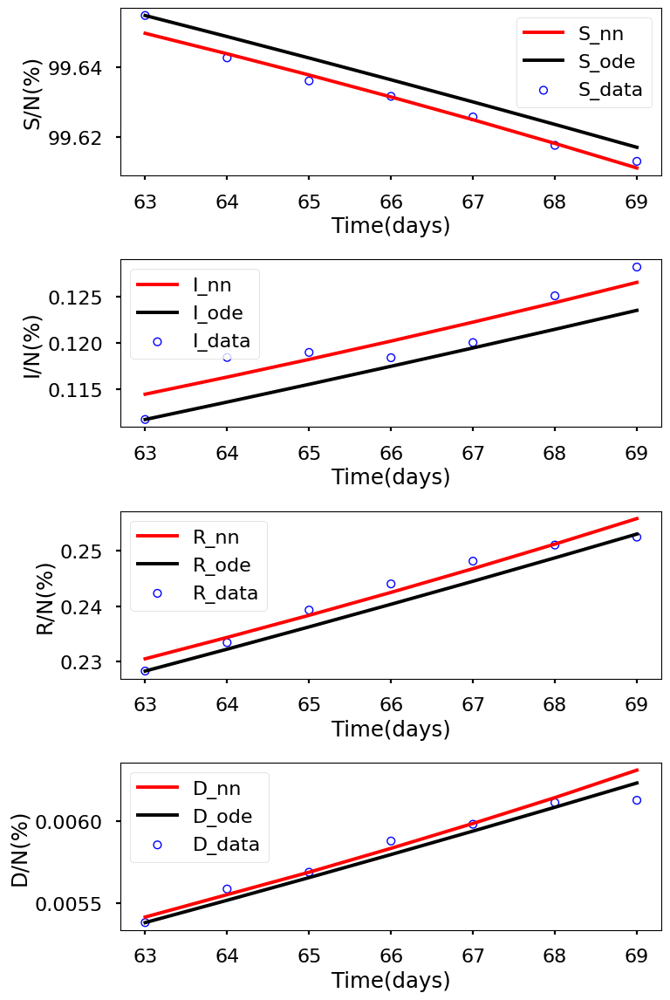

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.122e+00, GE_loss: 2.12743e+00,OB_loss: 9.94956e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 0.81, cumulative_time: 0.81
It: 10000, Loss: 2.519e-06, GE_loss: 1.17496e-06,OB_loss: 1.34419e-06, Beta: 1.08078e+00,gamma: 9.04123e-01,mu: 9.05112e-01, Time: 22.26, cumulative_time: 23.06
It: 20000, Loss: 1.370e-06, GE_loss: 4.59852e-07,OB_loss: 9.09914e-07, Beta: 1.08075e+00,gamma: 8.07301e-01,mu: 7.88675e-01, Time: 21.80, cumulative_time: 44.86
It: 30000, Loss: 1.104e-09, GE_loss: 7.87715e-11,OB_loss: 1.02539e-09, Beta: 5.83482e-02,gamma: 4.49980e-02,mu: 1.16796e-03, Time: 21.58, cumulative_time: 66.44
It: 40000, Loss: 1.021e-09, GE_loss: 8.98762e-11,OB_loss: 9.31283e-10, Beta: 5.81907e-02,gamma: 4.54824e-02,mu: 5.90671e-04, Time: 21.67, cumulative_time: 88.10
beta:  [0.05805819]
gamma:  [0.0457619]
mu:  [5.529952e-05]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


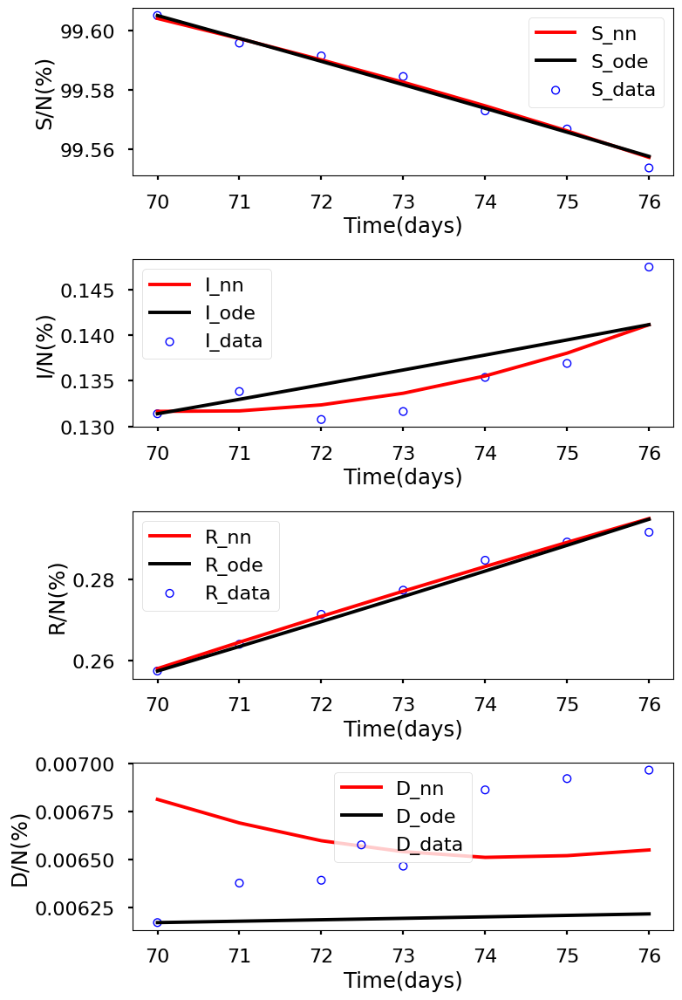

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.122e+00, GE_loss: 2.12810e+00,OB_loss: 9.93750e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 0.86, cumulative_time: 0.86
It: 10000, Loss: 2.892e-06, GE_loss: 1.31372e-06,OB_loss: 1.57862e-06, Beta: 1.07994e+00,gamma: 9.01656e-01,mu: 9.01519e-01, Time: 21.11, cumulative_time: 21.96
It: 20000, Loss: 1.754e-06, GE_loss: 6.24621e-07,OB_loss: 1.12978e-06, Beta: 1.03190e+00,gamma: 7.68692e-01,mu: 7.35678e-01, Time: 21.06, cumulative_time: 43.03
It: 30000, Loss: 3.369e-09, GE_loss: 1.49882e-10,OB_loss: 3.21949e-09, Beta: 6.36078e-02,gamma: 4.90049e-02,mu: 2.12370e-03, Time: 21.00, cumulative_time: 64.02
It: 40000, Loss: 2.562e-09, GE_loss: 5.13066e-10,OB_loss: 2.04879e-09, Beta: 6.33427e-02,gamma: 4.89357e-02,mu: 2.06937e-03, Time: 20.85, cumulative_time: 84.87
beta:  [0.06171678]
gamma:  [0.04774637]
mu:  [0.00138694]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


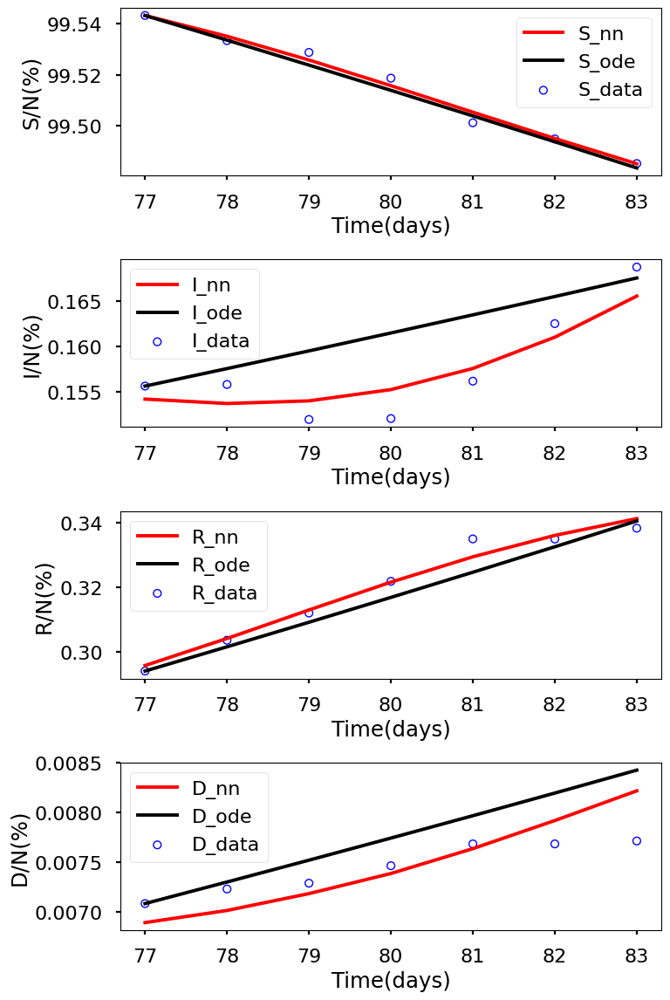

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.171e+00, GE_loss: 2.17428e+00,OB_loss: 9.97026e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 0.84, cumulative_time: 0.84
It: 10000, Loss: 3.838e-06, GE_loss: 1.31161e-06,OB_loss: 2.52631e-06, Beta: 1.08160e+00,gamma: 9.09865e-01,mu: 9.08431e-01, Time: 20.94, cumulative_time: 21.78
It: 20000, Loss: 2.281e-06, GE_loss: 8.52487e-07,OB_loss: 1.42875e-06, Beta: 1.02638e+00,gamma: 7.22948e-01,mu: 6.83515e-01, Time: 23.24, cumulative_time: 45.02
It: 30000, Loss: 1.551e-09, GE_loss: 1.98336e-10,OB_loss: 1.35273e-09, Beta: 8.36238e-02,gamma: 4.25914e-02,mu: 2.01158e-03, Time: 21.02, cumulative_time: 66.04
It: 40000, Loss: 1.493e-09, GE_loss: 1.05548e-10,OB_loss: 1.38777e-09, Beta: 8.36162e-02,gamma: 4.23309e-02,mu: 2.00549e-03, Time: 21.71, cumulative_time: 87.75
beta:  [0.08360222]
gamma:  [0.04230069]
mu:  [0.00198032]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


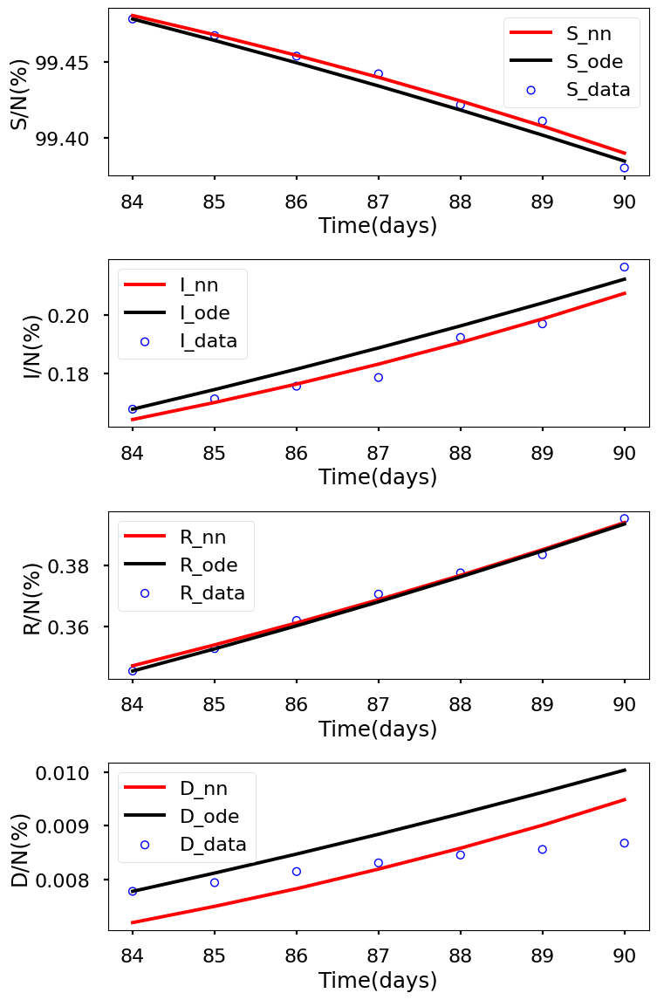

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.138e+00, GE_loss: 2.15024e+00,OB_loss: 9.88259e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 0.86, cumulative_time: 0.86
It: 10000, Loss: 6.434e-06, GE_loss: 2.43900e-06,OB_loss: 3.99528e-06, Beta: 1.08559e+00,gamma: 8.92676e-01,mu: 8.92554e-01, Time: 21.13, cumulative_time: 21.99
It: 20000, Loss: 2.802e-06, GE_loss: 1.53031e-06,OB_loss: 1.27190e-06, Beta: 6.63167e-01,gamma: 4.56827e-01,mu: 3.89888e-01, Time: 21.01, cumulative_time: 43.00
It: 30000, Loss: 5.113e-09, GE_loss: 7.70467e-11,OB_loss: 5.03614e-09, Beta: 8.21170e-02,gamma: 2.78720e-02,mu: 1.91167e-03, Time: 24.43, cumulative_time: 67.43
It: 40000, Loss: 4.310e-09, GE_loss: 2.85418e-11,OB_loss: 4.28124e-09, Beta: 8.20523e-02,gamma: 2.77121e-02,mu: 1.69466e-03, Time: 20.77, cumulative_time: 88.20
beta:  [0.08067149]
gamma:  [0.02776429]
mu:  [0.0011369]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


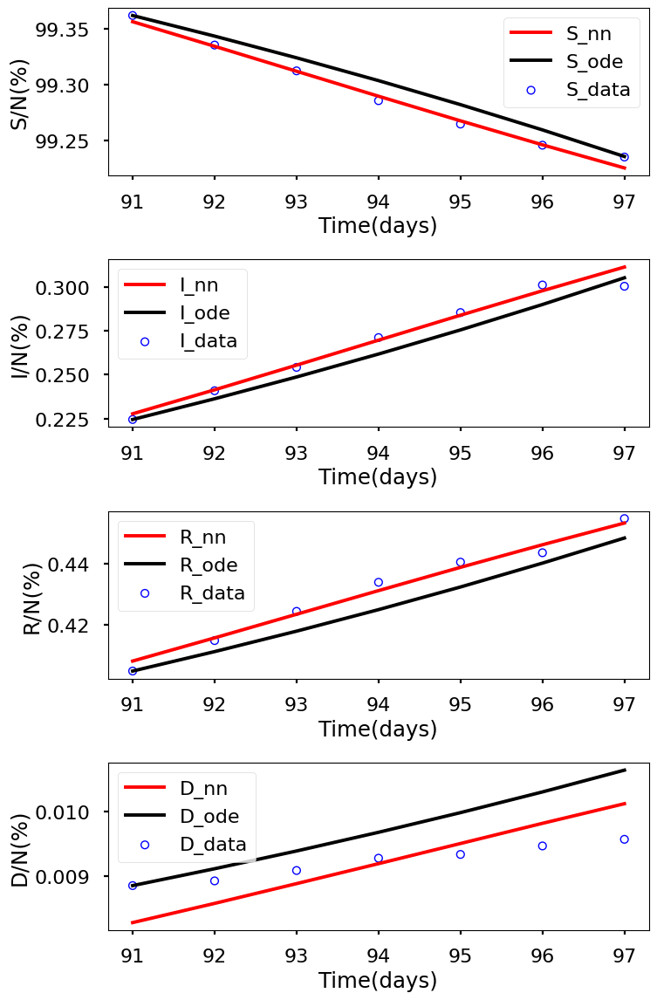

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.038e+00, GE_loss: 2.05342e+00,OB_loss: 9.84762e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 0.89, cumulative_time: 0.89
It: 10000, Loss: 1.063e-05, GE_loss: 3.15254e-06,OB_loss: 7.47891e-06, Beta: 1.08188e+00,gamma: 9.03074e-01,mu: 9.02110e-01, Time: 20.65, cumulative_time: 21.54
It: 20000, Loss: 1.127e-07, GE_loss: 7.23495e-08,OB_loss: 4.03633e-08, Beta: 1.30520e-01,gamma: 9.50890e-02,mu: 3.72060e-02, Time: 20.86, cumulative_time: 42.40
It: 30000, Loss: 5.925e-09, GE_loss: 1.77960e-10,OB_loss: 5.74655e-09, Beta: 7.00631e-02,gamma: 3.35727e-02,mu: 1.35843e-03, Time: 21.42, cumulative_time: 63.81
It: 40000, Loss: 5.600e-09, GE_loss: 1.13802e-10,OB_loss: 5.48645e-09, Beta: 7.00805e-02,gamma: 3.35207e-02,mu: 1.31358e-03, Time: 21.43, cumulative_time: 85.25
beta:  [0.07012816]
gamma:  [0.03352356]
mu:  [0.00123841]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


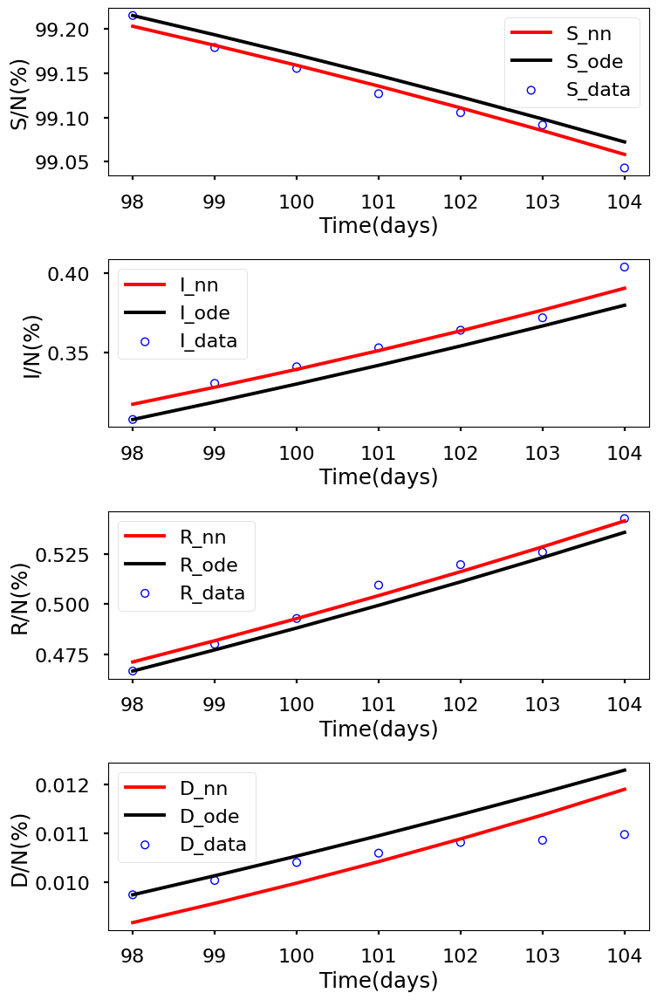

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.063e+00, GE_loss: 2.08373e+00,OB_loss: 9.78848e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 1.04, cumulative_time: 1.04
It: 10000, Loss: 1.668e-05, GE_loss: 4.48541e-06,OB_loss: 1.21901e-05, Beta: 1.08793e+00,gamma: 8.98470e-01,mu: 8.97702e-01, Time: 21.82, cumulative_time: 22.86
It: 20000, Loss: 1.352e-08, GE_loss: 1.71522e-09,OB_loss: 1.18001e-08, Beta: 7.75245e-02,gamma: 4.37104e-02,mu: 8.20082e-04, Time: 22.43, cumulative_time: 45.29
It: 30000, Loss: 4.427e-09, GE_loss: 9.90571e-10,OB_loss: 3.43641e-09, Beta: 7.31583e-02,gamma: 3.79855e-02,mu: 8.55765e-04, Time: 21.72, cumulative_time: 67.02
It: 40000, Loss: 4.243e-09, GE_loss: 1.08395e-09,OB_loss: 3.15884e-09, Beta: 7.29583e-02,gamma: 3.80889e-02,mu: 5.94547e-04, Time: 21.45, cumulative_time: 88.47
beta:  [0.07295034]
gamma:  [0.03816846]
mu:  [0.00064519]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


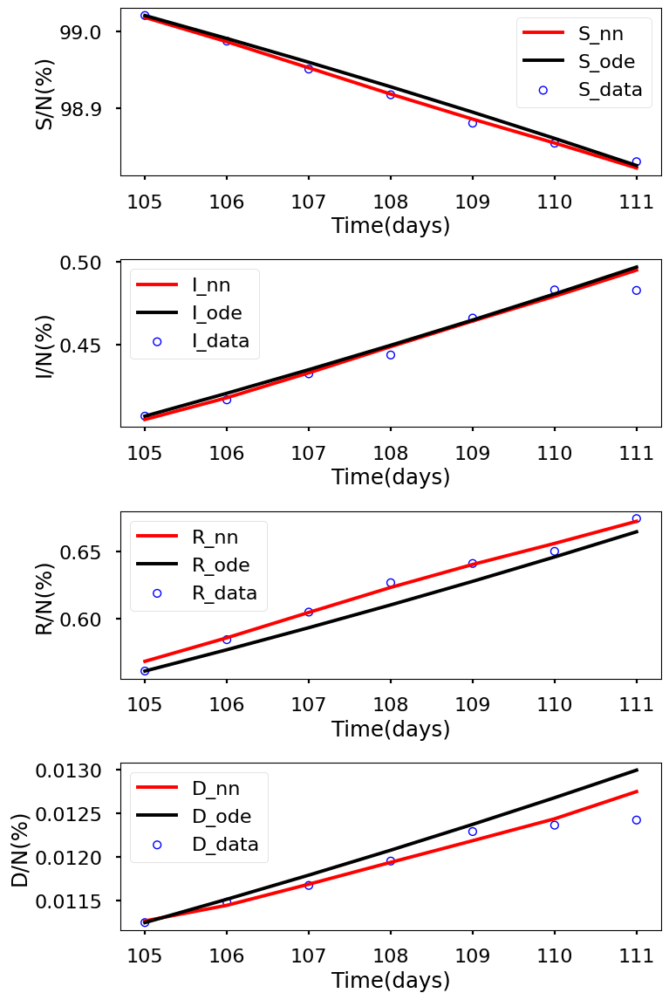

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.106e+00, GE_loss: 2.12503e+00,OB_loss: 9.80740e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 0.96, cumulative_time: 0.96
It: 10000, Loss: 2.225e-05, GE_loss: 6.69436e-06,OB_loss: 1.55599e-05, Beta: 1.08982e+00,gamma: 8.78897e-01,mu: 8.77562e-01, Time: 21.66, cumulative_time: 22.62
It: 20000, Loss: 1.403e-08, GE_loss: 2.64958e-09,OB_loss: 1.13841e-08, Beta: 6.80845e-02,gamma: 3.91519e-02,mu: 1.23662e-03, Time: 21.73, cumulative_time: 44.35
It: 30000, Loss: 1.002e-08, GE_loss: 5.44511e-10,OB_loss: 9.48032e-09, Beta: 6.77416e-02,gamma: 3.73237e-02,mu: 1.19771e-03, Time: 21.82, cumulative_time: 66.18
It: 40000, Loss: 1.051e-08, GE_loss: 8.71745e-10,OB_loss: 9.64159e-09, Beta: 6.77561e-02,gamma: 3.73483e-02,mu: 1.14317e-03, Time: 21.59, cumulative_time: 87.77
beta:  [0.06774805]
gamma:  [0.0373772]
mu:  [0.00110461]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


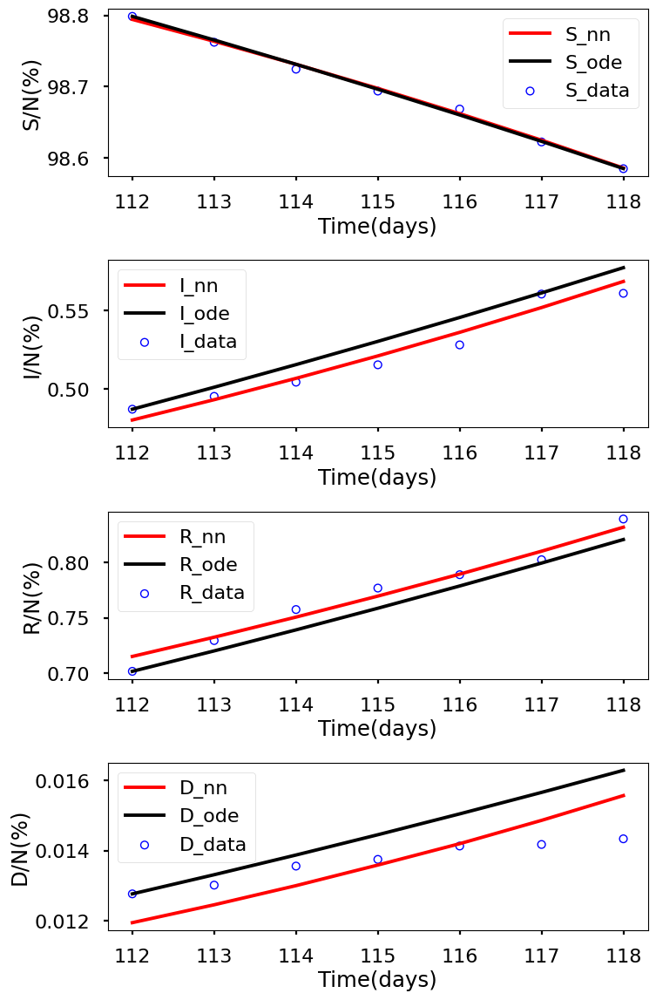

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.112e+00, GE_loss: 2.13792e+00,OB_loss: 9.74389e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 1.04, cumulative_time: 1.04
It: 10000, Loss: 2.647e-05, GE_loss: 7.92595e-06,OB_loss: 1.85400e-05, Beta: 1.08889e+00,gamma: 8.80337e-01,mu: 8.79342e-01, Time: 21.45, cumulative_time: 22.49
It: 20000, Loss: 2.275e-08, GE_loss: 1.26442e-09,OB_loss: 2.14884e-08, Beta: 5.61216e-02,gamma: 4.20179e-02,mu: 1.06079e-03, Time: 21.33, cumulative_time: 43.81
It: 30000, Loss: 1.456e-08, GE_loss: 1.61870e-09,OB_loss: 1.29418e-08, Beta: 5.49957e-02,gamma: 4.29090e-02,mu: 9.47900e-05, Time: 23.41, cumulative_time: 67.22
It: 40000, Loss: 1.254e-08, GE_loss: 1.94532e-09,OB_loss: 1.05944e-08, Beta: 5.42693e-02,gamma: 4.25659e-02,mu: 2.22106e-04, Time: 22.18, cumulative_time: 89.40
beta:  [0.05418876]
gamma:  [0.04363796]
mu:  [2.1945893e-05]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


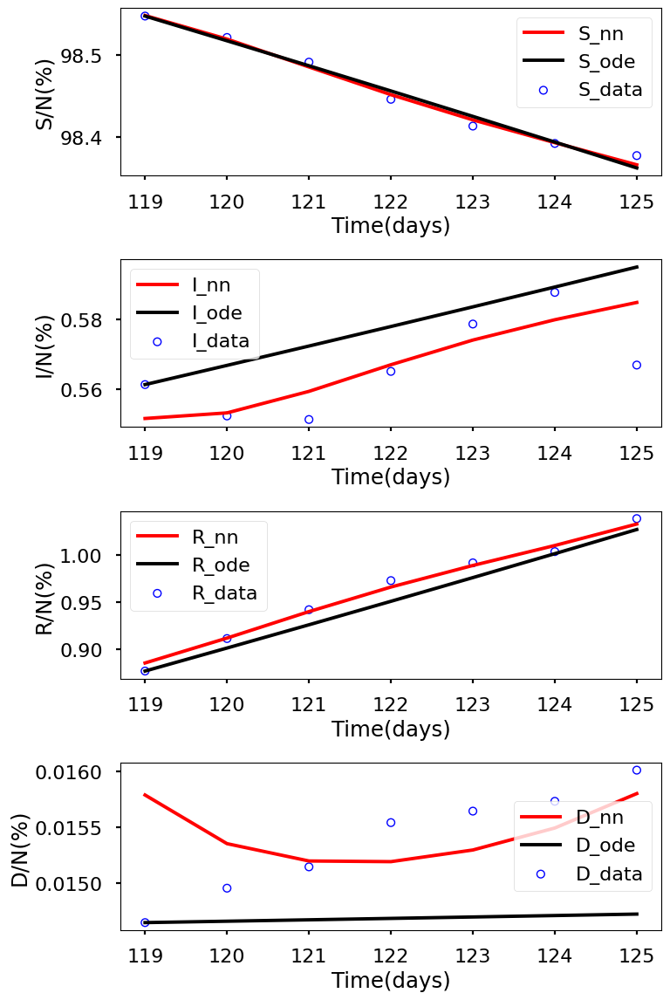

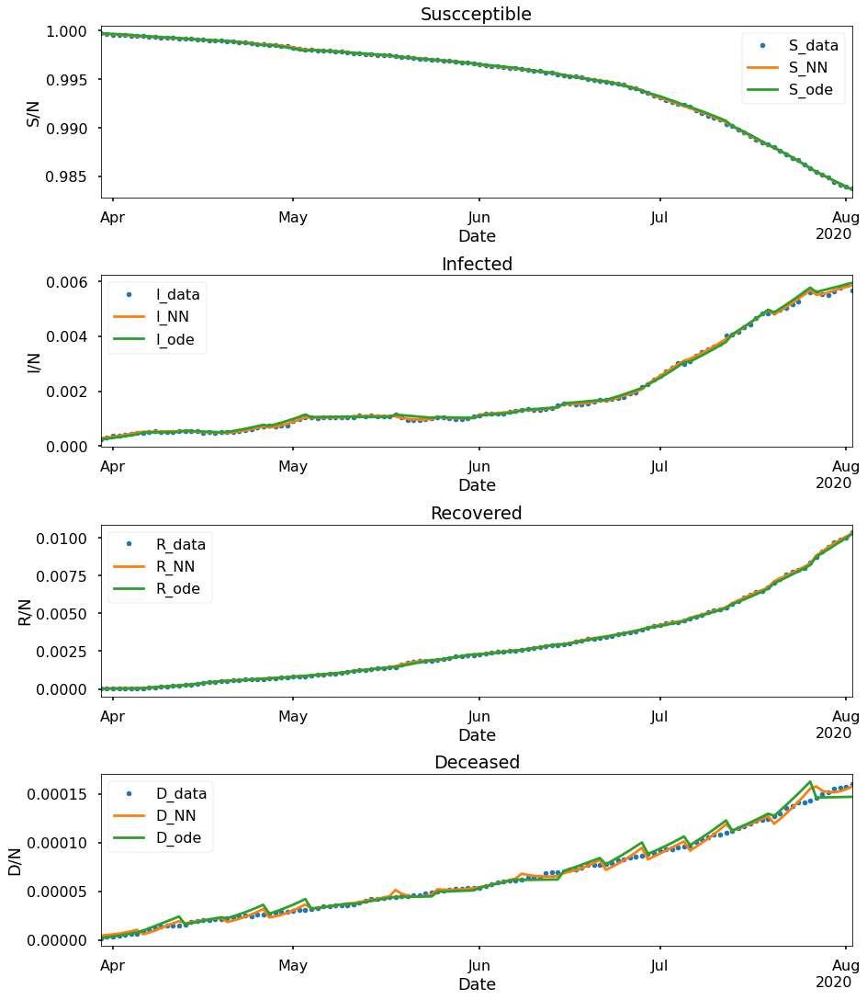

+---------------------+--------------+-------------+--------------+--------------+-------------+--------------+--------------+---------------+---------------+-------------+--------------+--------------+--------------+--------------+--------------+--------------+--------------+---------------+
|      Paramaters     |    Week 1    |    Week 2   |    Week 3    |    Week 4    |    Week 5   |    Week 6    |    Week 7    |     Week 8    |     Week 9    |   Week 10   |   Week 11    |   Week 12    |   Week 13    |   Week 14    |   Week 15    |   Week 16    |   Week 17    |    Week 18    |
+---------------------+--------------+-------------+--------------+--------------+-------------+--------------+--------------+---------------+---------------+-------------+--------------+--------------+--------------+--------------+--------------+--------------+--------------+---------------+
|         beta        |  0.10342107  |  0.06617015 |  0.06723921  |  0.11031496  |  0.10799832 | 0.038008947  | 0.0395

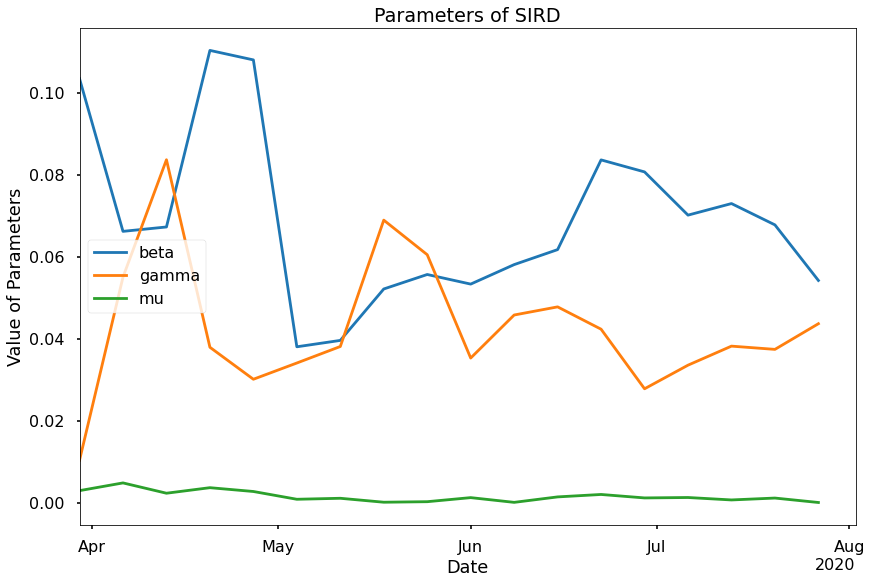

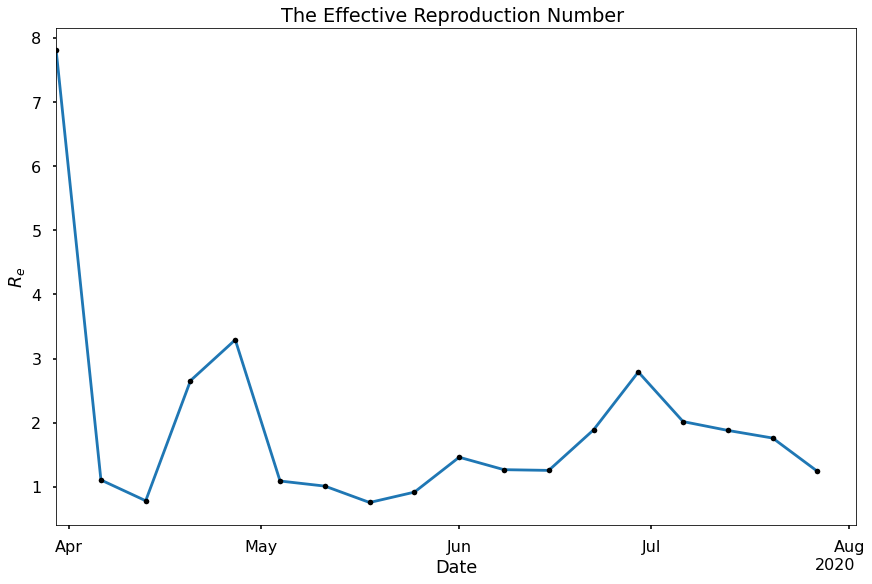

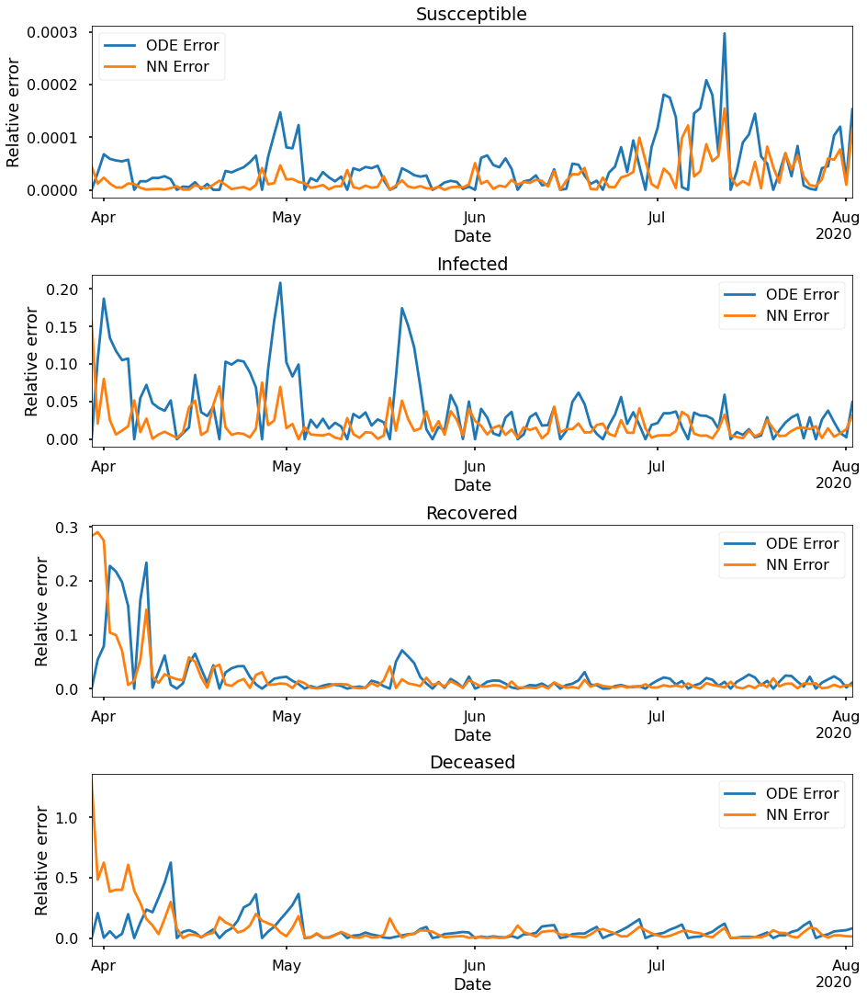

In [ ]:
layers216 = [1,16,16,4]
S216_ode,I216_ode,R216_ode,D216_ode,S216_learned,I216_learned,R216_learned,D216_learned,beta216,gamma216,mu_216,S_errnn216,I_errnn216,R_errnn216,D_errnn216,S_erode216,I_errode216,R_errode216,D_errode216,time216 = sum_all(
    layers216,length,SS,II,RC,DC,N0,0.1,50000)

In [ ]:
beta216/(mu_216+gamma216)

array([7.80782535, 1.10650726, 0.78256291, 2.65647921, 3.29317912,
       1.09035291, 1.01115129, 0.75526996, 0.91691518, 1.46149755,
       1.26717026, 1.25610866, 1.88799265, 2.79128587, 2.01738162,
       1.87950251, 1.76052127, 1.24115604])

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.160e+00, GE_loss: 2.15789e+00,OB_loss: 1.00170e+00, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 1.13, cumulative_time: 1.13
It: 10000, Loss: 4.384e-06, GE_loss: 1.38380e-06,OB_loss: 3.00025e-06, Beta: 1.05730e+00,gamma: 9.20823e-01,mu: 9.20689e-01, Time: 23.47, cumulative_time: 24.60
It: 20000, Loss: 1.329e-07, GE_loss: 3.53080e-08,OB_loss: 9.75684e-08, Beta: 1.04985e+00,gamma: 9.07055e-01,mu: 9.06702e-01, Time: 23.27, cumulative_time: 47.87
It: 30000, Loss: 1.761e-09, GE_loss: 3.26092e-10,OB_loss: 1.43539e-09, Beta: 1.00524e-01,gamma: 1.31998e-02,mu: 6.60030e-03, Time: 25.29, cumulative_time: 73.16
It: 40000, Loss: 4.337e-10, GE_loss: 3.58102e-11,OB_loss: 3.97923e-10, Beta: 1.01127e-01,gamma: 1.16021e-02,mu: 3.24127e-03, Time: 25.65, cumulative_time: 98.81
beta:  [0.10697389]
gamma:  [0.01263266]
mu:  [0.00265589]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


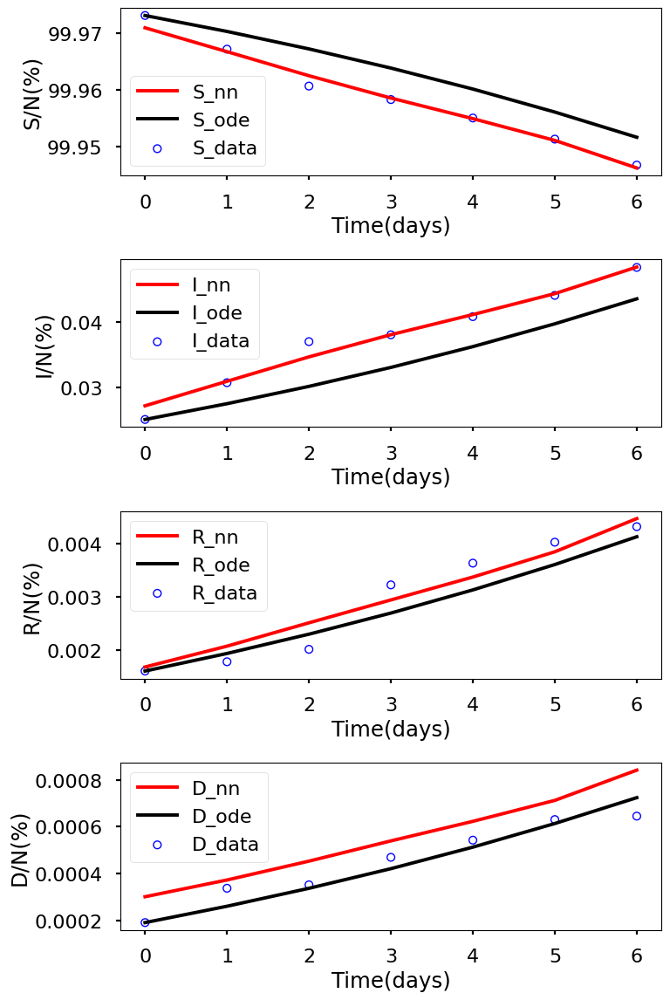

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.084e+00, GE_loss: 2.08762e+00,OB_loss: 9.96609e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 1.19, cumulative_time: 1.19
It: 10000, Loss: 3.221e-06, GE_loss: 1.25621e-06,OB_loss: 1.96474e-06, Beta: 1.05182e+00,gamma: 9.33308e-01,mu: 9.33545e-01, Time: 23.64, cumulative_time: 24.83
It: 20000, Loss: 2.442e-07, GE_loss: 6.95286e-08,OB_loss: 1.74721e-07, Beta: 1.05235e+00,gamma: 9.11543e-01,mu: 9.11588e-01, Time: 23.71, cumulative_time: 48.54
It: 30000, Loss: 1.358e-09, GE_loss: 2.63056e-10,OB_loss: 1.09502e-09, Beta: 6.28170e-02,gamma: 3.85349e-02,mu: 3.74202e-03, Time: 23.50, cumulative_time: 72.04
It: 40000, Loss: 1.426e-10, GE_loss: 2.26871e-11,OB_loss: 1.19869e-10, Beta: 6.70480e-02,gamma: 5.71848e-02,mu: 2.67142e-03, Time: 23.61, cumulative_time: 95.65
beta:  [0.06758582]
gamma:  [0.05845171]
mu:  [0.00290007]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


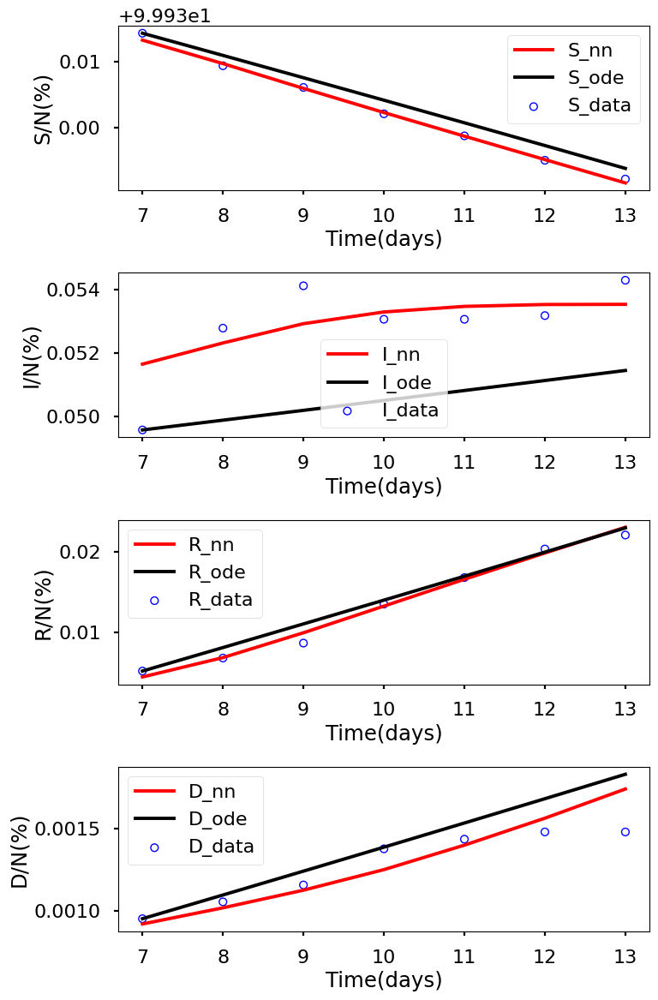

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.121e+00, GE_loss: 2.12104e+00,OB_loss: 1.00037e+00, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 1.17, cumulative_time: 1.17
It: 10000, Loss: 2.203e-06, GE_loss: 8.39433e-07,OB_loss: 1.36393e-06, Beta: 1.05495e+00,gamma: 9.33864e-01,mu: 9.34814e-01, Time: 24.65, cumulative_time: 25.81
It: 20000, Loss: 2.331e-07, GE_loss: 6.75176e-08,OB_loss: 1.65623e-07, Beta: 1.06372e+00,gamma: 9.14243e-01,mu: 9.14944e-01, Time: 24.55, cumulative_time: 50.36
It: 30000, Loss: 1.018e-09, GE_loss: 2.42864e-10,OB_loss: 7.74906e-10, Beta: 6.18115e-02,gamma: 7.58523e-02,mu: 5.98103e-03, Time: 24.44, cumulative_time: 74.81
It: 40000, Loss: 4.313e-10, GE_loss: 5.40812e-11,OB_loss: 3.77230e-10, Beta: 6.63514e-02,gamma: 8.21736e-02,mu: 4.52136e-03, Time: 24.82, cumulative_time: 99.63
beta:  [0.06677397]
gamma:  [0.08270639]
mu:  [0.00442363]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


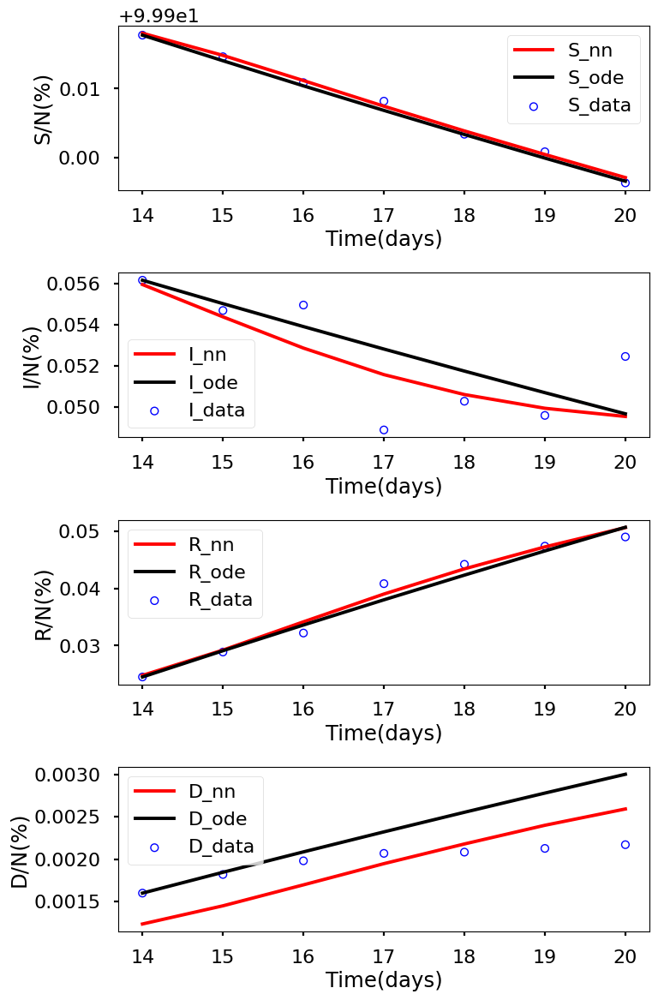

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.179e+00, GE_loss: 2.17422e+00,OB_loss: 1.00520e+00, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 1.29, cumulative_time: 1.29
It: 10000, Loss: 2.394e-06, GE_loss: 1.29459e-06,OB_loss: 1.09893e-06, Beta: 1.06222e+00,gamma: 9.22416e-01,mu: 9.21835e-01, Time: 24.32, cumulative_time: 25.61
It: 20000, Loss: 2.856e-07, GE_loss: 9.01587e-08,OB_loss: 1.95464e-07, Beta: 1.07582e+00,gamma: 8.96904e-01,mu: 8.93948e-01, Time: 24.00, cumulative_time: 49.61
It: 30000, Loss: 6.545e-10, GE_loss: 2.49492e-10,OB_loss: 4.04961e-10, Beta: 1.10069e-01,gamma: 4.43024e-02,mu: 4.95223e-03, Time: 24.53, cumulative_time: 74.14
It: 40000, Loss: 2.223e-10, GE_loss: 2.42394e-11,OB_loss: 1.98024e-10, Beta: 1.08144e-01,gamma: 3.73960e-02,mu: 4.41168e-03, Time: 24.81, cumulative_time: 98.95
beta:  [0.10831013]
gamma:  [0.03746562]
mu:  [0.00407312]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


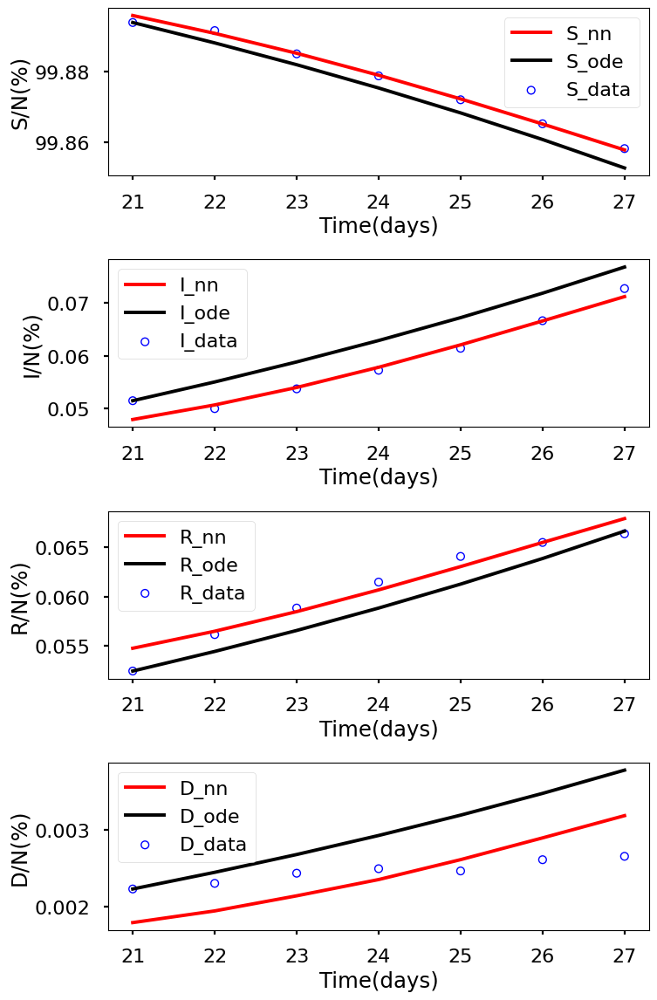

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.100e+00, GE_loss: 2.10451e+00,OB_loss: 9.95060e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 1.29, cumulative_time: 1.29
It: 10000, Loss: 1.882e-06, GE_loss: 7.54043e-07,OB_loss: 1.12782e-06, Beta: 1.05374e+00,gamma: 9.38094e-01,mu: 9.37946e-01, Time: 26.17, cumulative_time: 27.46
It: 20000, Loss: 5.787e-07, GE_loss: 1.84039e-07,OB_loss: 3.94709e-07, Beta: 1.09735e+00,gamma: 8.90961e-01,mu: 8.83562e-01, Time: 24.74, cumulative_time: 52.21
It: 30000, Loss: 2.140e-09, GE_loss: 3.10784e-10,OB_loss: 1.82943e-09, Beta: 1.13696e-01,gamma: 3.25351e-02,mu: 2.52583e-03, Time: 25.01, cumulative_time: 77.22
It: 40000, Loss: 1.822e-09, GE_loss: 3.22285e-10,OB_loss: 1.49930e-09, Beta: 1.07877e-01,gamma: 3.02748e-02,mu: 2.14019e-03, Time: 24.78, cumulative_time: 102.00
beta:  [0.10748668]
gamma:  [0.02977066]
mu:  [0.00204957]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


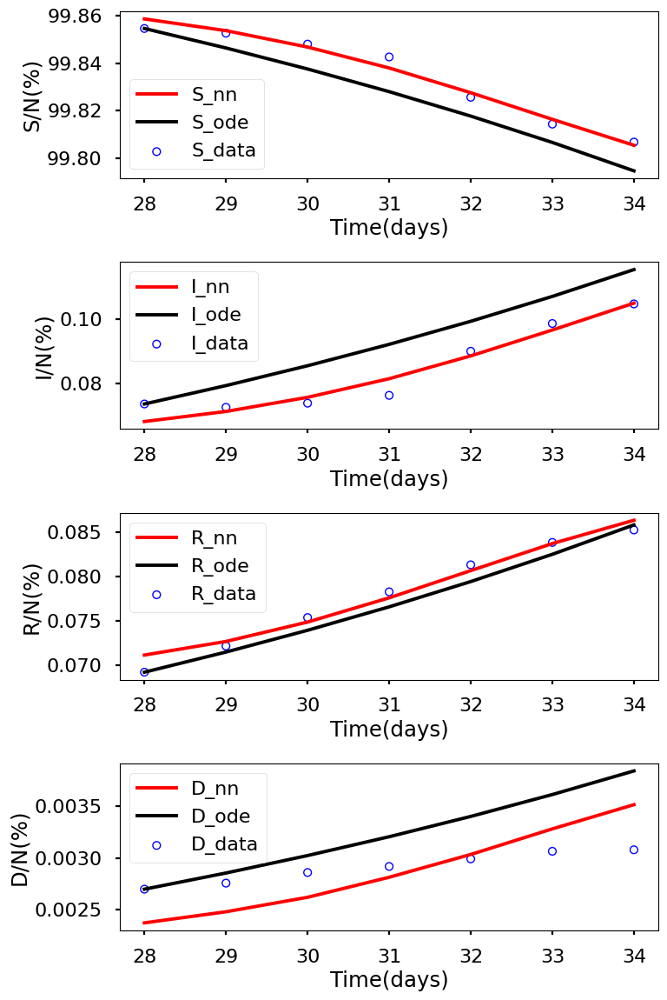

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.075e+00, GE_loss: 2.08143e+00,OB_loss: 9.93369e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 1.26, cumulative_time: 1.26
It: 10000, Loss: 1.725e-06, GE_loss: 7.59965e-07,OB_loss: 9.65488e-07, Beta: 1.05538e+00,gamma: 9.36487e-01,mu: 9.36680e-01, Time: 24.16, cumulative_time: 25.43
It: 20000, Loss: 8.988e-07, GE_loss: 2.82027e-07,OB_loss: 6.16768e-07, Beta: 1.08088e+00,gamma: 8.70308e-01,mu: 8.61836e-01, Time: 23.77, cumulative_time: 49.19
It: 30000, Loss: 1.255e-10, GE_loss: 4.18688e-11,OB_loss: 8.36710e-11, Beta: 3.79921e-02,gamma: 3.38325e-02,mu: 1.31594e-03, Time: 24.37, cumulative_time: 73.56
It: 40000, Loss: 9.911e-11, GE_loss: 9.43695e-12,OB_loss: 8.96707e-11, Beta: 3.80697e-02,gamma: 3.40776e-02,mu: 1.23283e-03, Time: 24.09, cumulative_time: 97.65
beta:  [0.03806857]
gamma:  [0.03411179]
mu:  [0.00119835]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


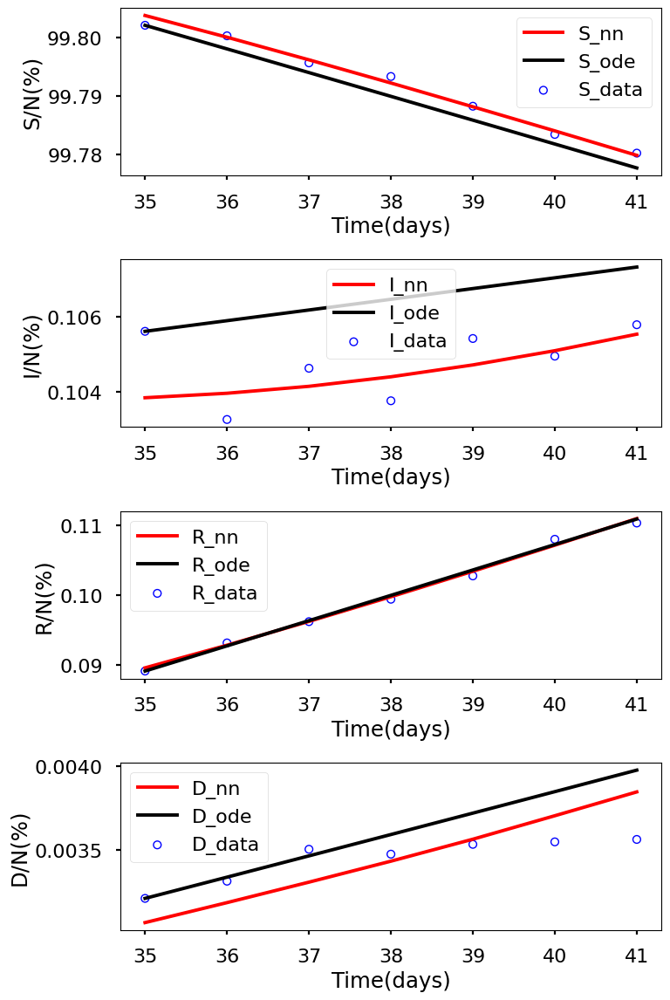

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.125e+00, GE_loss: 2.13297e+00,OB_loss: 9.91818e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 1.32, cumulative_time: 1.32
It: 10000, Loss: 1.708e-06, GE_loss: 1.06799e-06,OB_loss: 6.39985e-07, Beta: 1.06037e+00,gamma: 9.27450e-01,mu: 9.27270e-01, Time: 23.49, cumulative_time: 24.81
It: 20000, Loss: 9.727e-07, GE_loss: 3.09329e-07,OB_loss: 6.63343e-07, Beta: 1.07401e+00,gamma: 8.57546e-01,mu: 8.46412e-01, Time: 24.65, cumulative_time: 49.46
It: 30000, Loss: 2.208e-10, GE_loss: 2.41612e-11,OB_loss: 1.96627e-10, Beta: 3.95640e-02,gamma: 3.83997e-02,mu: 1.05855e-03, Time: 24.74, cumulative_time: 74.20
It: 40000, Loss: 1.816e-10, GE_loss: 1.68036e-11,OB_loss: 1.64800e-10, Beta: 3.95932e-02,gamma: 3.84218e-02,mu: 9.17748e-04, Time: 23.16, cumulative_time: 97.36
beta:  [0.03956418]
gamma:  [0.03840592]
mu:  [0.00087633]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


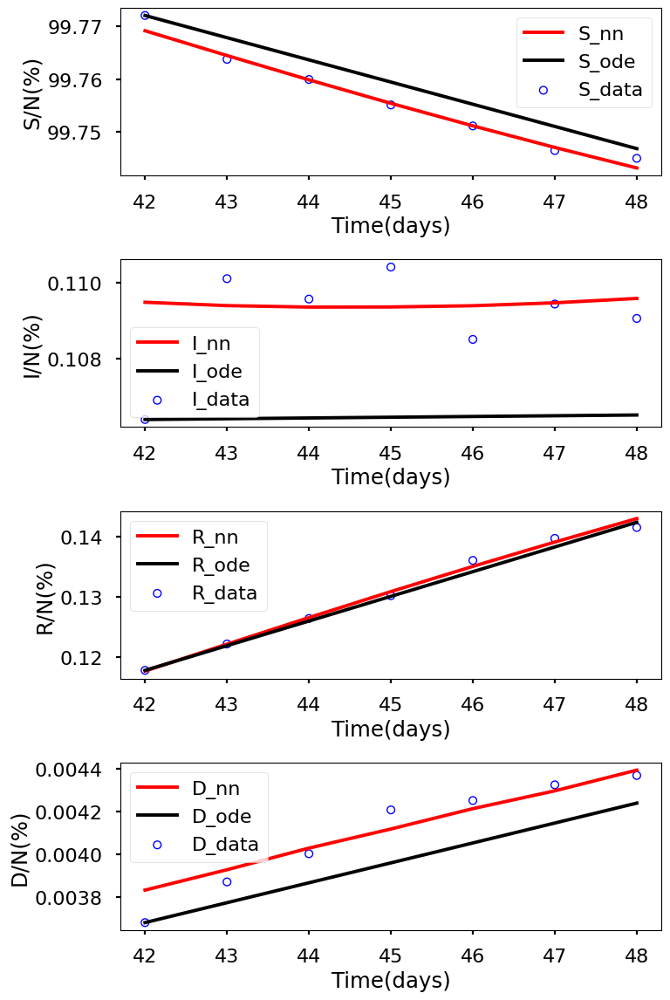

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.116e+00, GE_loss: 2.12004e+00,OB_loss: 9.96188e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 1.35, cumulative_time: 1.35
It: 10000, Loss: 2.335e-06, GE_loss: 1.40405e-06,OB_loss: 9.30703e-07, Beta: 1.06009e+00,gamma: 9.15233e-01,mu: 9.15516e-01, Time: 23.72, cumulative_time: 25.07
It: 20000, Loss: 7.961e-07, GE_loss: 2.56651e-07,OB_loss: 5.39410e-07, Beta: 1.07233e+00,gamma: 8.57840e-01,mu: 8.48719e-01, Time: 23.90, cumulative_time: 48.97
It: 30000, Loss: 2.971e-09, GE_loss: 5.66217e-10,OB_loss: 2.40487e-09, Beta: 5.39788e-02,gamma: 6.87893e-02,mu: 3.98391e-03, Time: 24.22, cumulative_time: 73.19
It: 40000, Loss: 2.612e-09, GE_loss: 9.93141e-10,OB_loss: 1.61872e-09, Beta: 5.29174e-02,gamma: 6.80574e-02,mu: 2.78276e-03, Time: 24.15, cumulative_time: 97.34
beta:  [0.05260342]
gamma:  [0.0679868]
mu:  [0.00258596]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


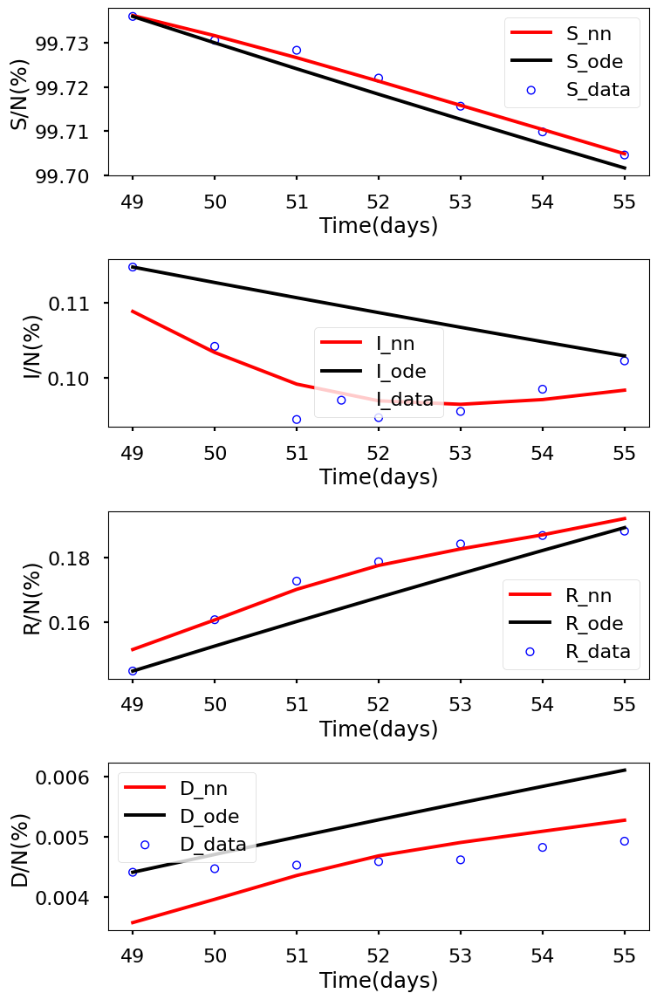

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.113e+00, GE_loss: 2.12224e+00,OB_loss: 9.91144e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 1.45, cumulative_time: 1.45
It: 10000, Loss: 1.632e-06, GE_loss: 1.04460e-06,OB_loss: 5.87070e-07, Beta: 1.06254e+00,gamma: 9.22423e-01,mu: 9.22799e-01, Time: 24.27, cumulative_time: 25.72
It: 20000, Loss: 8.443e-07, GE_loss: 2.73171e-07,OB_loss: 5.71135e-07, Beta: 1.08167e+00,gamma: 8.58886e-01,mu: 8.47999e-01, Time: 24.05, cumulative_time: 49.77
It: 30000, Loss: 1.900e-09, GE_loss: 1.27849e-10,OB_loss: 1.77240e-09, Beta: 5.68363e-02,gamma: 5.97547e-02,mu: 2.07884e-03, Time: 23.89, cumulative_time: 73.66
It: 40000, Loss: 1.217e-09, GE_loss: 2.82660e-10,OB_loss: 9.33976e-10, Beta: 5.68688e-02,gamma: 6.00396e-02,mu: 1.92091e-03, Time: 26.80, cumulative_time: 100.46
beta:  [0.05665313]
gamma:  [0.05887519]
mu:  [0.00163432]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


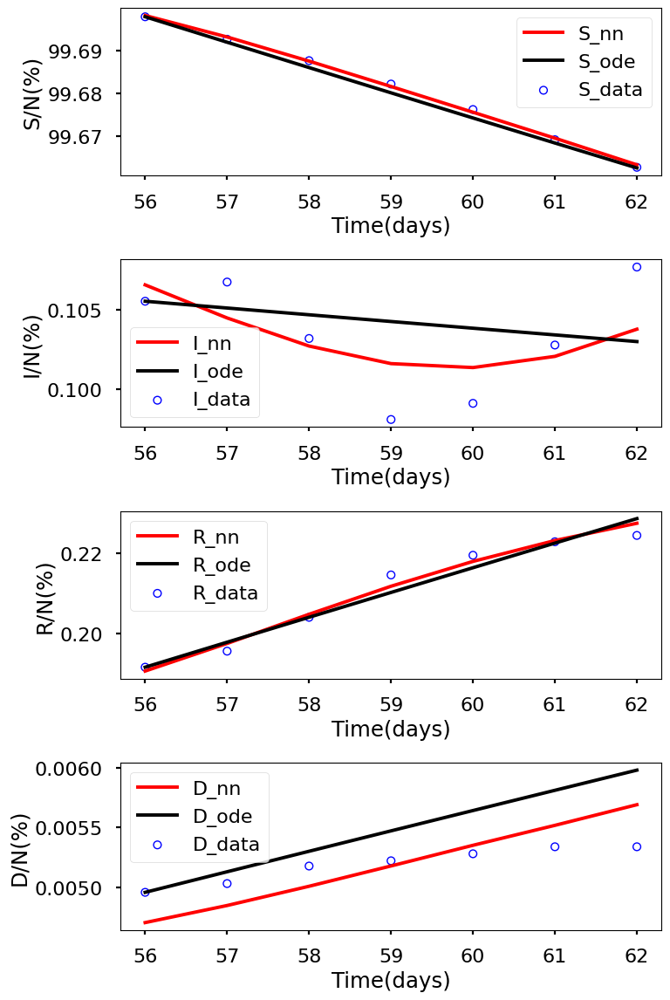

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.043e+00, GE_loss: 2.05035e+00,OB_loss: 9.92533e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 1.45, cumulative_time: 1.45
It: 10000, Loss: 2.091e-06, GE_loss: 1.12272e-06,OB_loss: 9.68441e-07, Beta: 1.05515e+00,gamma: 9.27078e-01,mu: 9.27288e-01, Time: 23.75, cumulative_time: 25.20
It: 20000, Loss: 1.130e-06, GE_loss: 3.80536e-07,OB_loss: 7.49608e-07, Beta: 1.06781e+00,gamma: 8.29652e-01,mu: 8.11820e-01, Time: 23.29, cumulative_time: 48.49
It: 30000, Loss: 8.564e-10, GE_loss: 7.27883e-11,OB_loss: 7.83603e-10, Beta: 5.28753e-02,gamma: 3.58812e-02,mu: 1.26104e-03, Time: 23.50, cumulative_time: 71.99
It: 40000, Loss: 5.830e-10, GE_loss: 3.16110e-11,OB_loss: 5.51422e-10, Beta: 5.42518e-02,gamma: 3.60577e-02,mu: 1.20384e-03, Time: 23.44, cumulative_time: 95.43
beta:  [0.05446119]
gamma:  [0.03621947]
mu:  [0.00130303]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


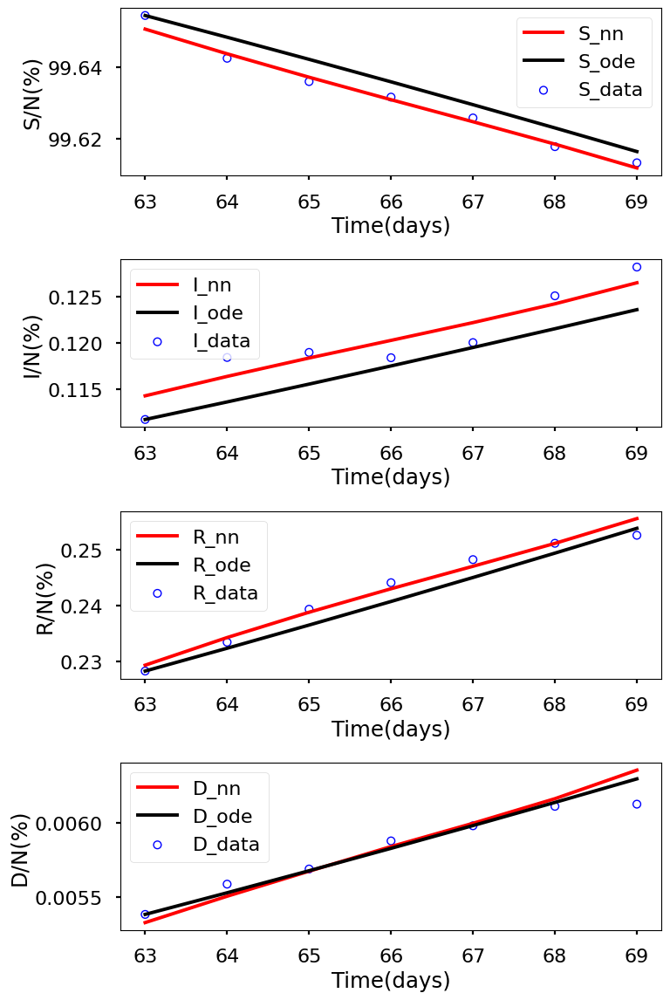

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.109e+00, GE_loss: 2.11744e+00,OB_loss: 9.91125e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 1.44, cumulative_time: 1.44
It: 10000, Loss: 2.450e-06, GE_loss: 1.28796e-06,OB_loss: 1.16233e-06, Beta: 1.05277e+00,gamma: 9.33740e-01,mu: 9.33809e-01, Time: 24.29, cumulative_time: 25.73
It: 20000, Loss: 1.391e-06, GE_loss: 4.74560e-07,OB_loss: 9.16330e-07, Beta: 1.06935e+00,gamma: 8.16330e-01,mu: 7.95509e-01, Time: 24.41, cumulative_time: 50.14
It: 30000, Loss: 1.248e-09, GE_loss: 1.20083e-10,OB_loss: 1.12746e-09, Beta: 5.86200e-02,gamma: 4.37312e-02,mu: 1.55562e-03, Time: 24.28, cumulative_time: 74.42
It: 40000, Loss: 1.137e-09, GE_loss: 4.60099e-11,OB_loss: 1.09099e-09, Beta: 5.84791e-02,gamma: 4.47013e-02,mu: 1.56237e-03, Time: 24.35, cumulative_time: 98.77
beta:  [0.05844308]
gamma:  [0.04485515]
mu:  [0.00154004]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


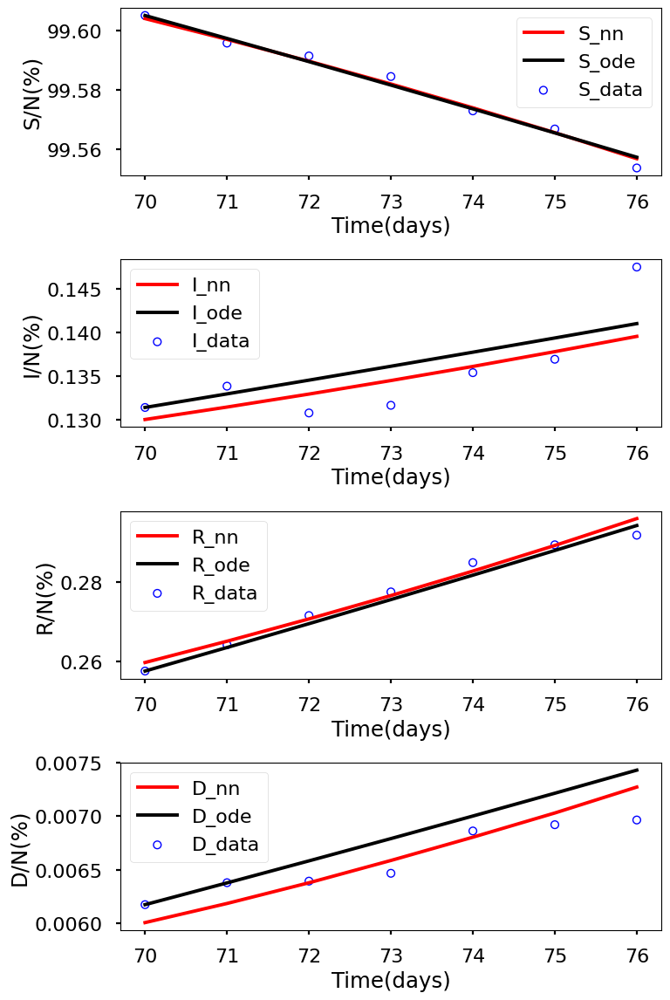

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.048e+00, GE_loss: 2.06163e+00,OB_loss: 9.86353e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 1.59, cumulative_time: 1.59
It: 10000, Loss: 2.393e-06, GE_loss: 8.53664e-07,OB_loss: 1.53982e-06, Beta: 1.05210e+00,gamma: 9.39870e-01,mu: 9.39710e-01, Time: 24.26, cumulative_time: 25.84
It: 20000, Loss: 1.763e-06, GE_loss: 6.31332e-07,OB_loss: 1.13132e-06, Beta: 1.04814e+00,gamma: 7.62166e-01,mu: 7.28429e-01, Time: 24.05, cumulative_time: 49.90
It: 30000, Loss: 3.588e-09, GE_loss: 9.82611e-11,OB_loss: 3.49001e-09, Beta: 6.32627e-02,gamma: 4.91035e-02,mu: 1.87809e-03, Time: 23.95, cumulative_time: 73.84
It: 40000, Loss: 2.477e-09, GE_loss: 5.70501e-10,OB_loss: 1.90689e-09, Beta: 6.16109e-02,gamma: 4.74522e-02,mu: 1.85563e-03, Time: 23.93, cumulative_time: 97.77
beta:  [0.0614964]
gamma:  [0.04741433]
mu:  [0.00172832]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


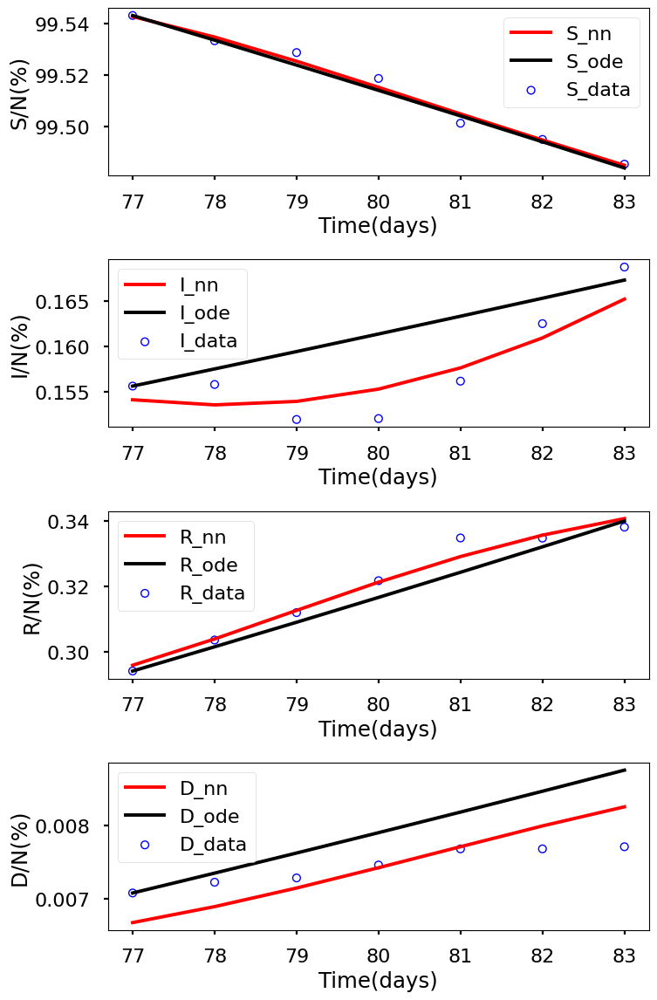

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.136e+00, GE_loss: 2.14807e+00,OB_loss: 9.88081e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 1.60, cumulative_time: 1.60
It: 10000, Loss: 3.319e-06, GE_loss: 1.12734e-06,OB_loss: 2.19154e-06, Beta: 1.05292e+00,gamma: 9.34906e-01,mu: 9.35116e-01, Time: 23.70, cumulative_time: 25.30
It: 20000, Loss: 2.166e-06, GE_loss: 8.63310e-07,OB_loss: 1.30272e-06, Beta: 9.83542e-01,gamma: 6.88246e-01,mu: 6.41201e-01, Time: 23.67, cumulative_time: 48.97
It: 30000, Loss: 1.582e-09, GE_loss: 2.01138e-10,OB_loss: 1.38068e-09, Beta: 8.35399e-02,gamma: 4.22467e-02,mu: 1.90439e-03, Time: 23.97, cumulative_time: 72.94
It: 40000, Loss: 1.517e-09, GE_loss: 9.64422e-11,OB_loss: 1.42062e-09, Beta: 8.34632e-02,gamma: 4.23084e-02,mu: 1.80032e-03, Time: 24.23, cumulative_time: 97.16
beta:  [0.08342852]
gamma:  [0.04233364]
mu:  [0.00173825]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


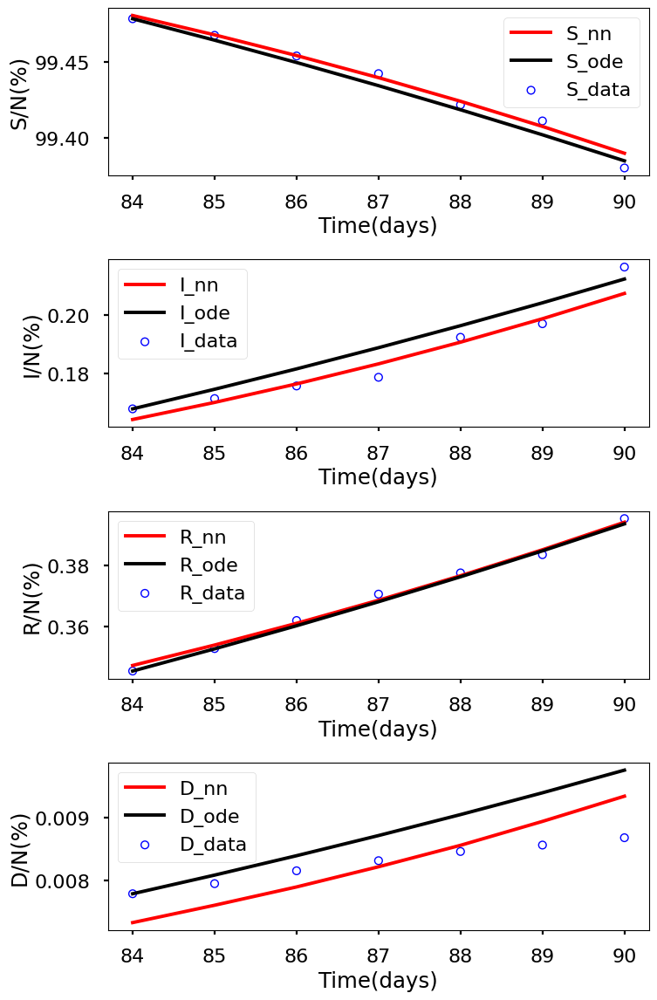

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.097e+00, GE_loss: 2.11230e+00,OB_loss: 9.84281e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 1.65, cumulative_time: 1.65
It: 10000, Loss: 6.823e-06, GE_loss: 2.13644e-06,OB_loss: 4.68689e-06, Beta: 1.05846e+00,gamma: 9.29742e-01,mu: 9.29309e-01, Time: 26.46, cumulative_time: 28.12
It: 20000, Loss: 1.375e-06, GE_loss: 8.96375e-07,OB_loss: 4.78859e-07, Beta: 4.59939e-01,gamma: 3.26763e-01,mu: 2.36850e-01, Time: 24.11, cumulative_time: 52.22
It: 30000, Loss: 2.849e-09, GE_loss: 9.19588e-10,OB_loss: 1.92899e-09, Beta: 8.11718e-02,gamma: 2.82036e-02,mu: 2.18098e-03, Time: 24.16, cumulative_time: 76.38
It: 40000, Loss: 2.749e-09, GE_loss: 9.98785e-10,OB_loss: 1.75063e-09, Beta: 8.07511e-02,gamma: 2.83019e-02,mu: 1.63067e-03, Time: 23.82, cumulative_time: 100.21
beta:  [0.0805568]
gamma:  [0.02829806]
mu:  [0.00117761]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


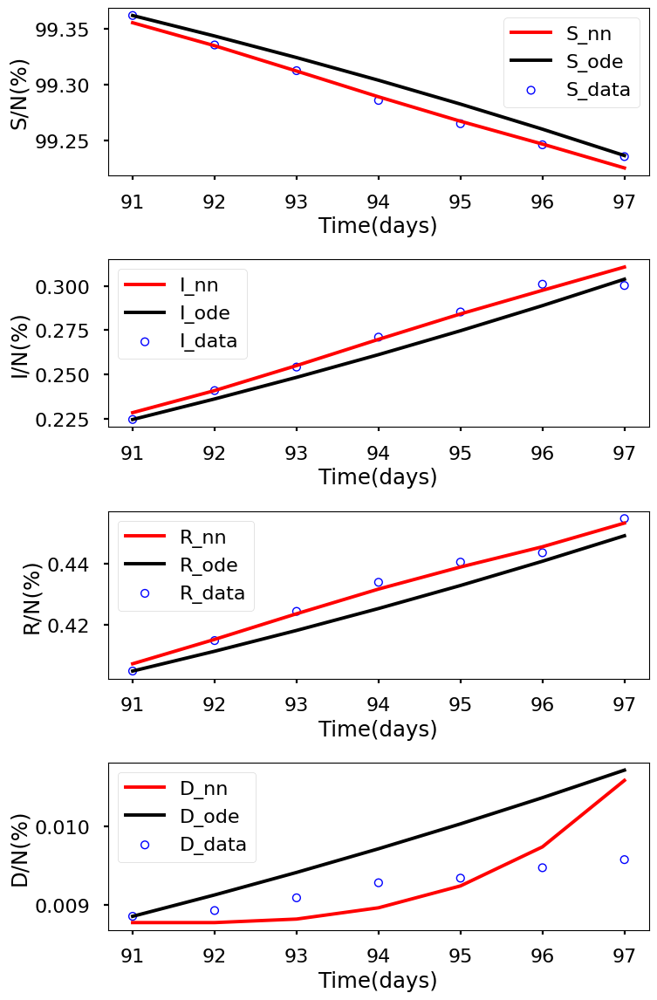

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.097e+00, GE_loss: 2.11223e+00,OB_loss: 9.84959e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 1.62, cumulative_time: 1.62
It: 10000, Loss: 1.062e-05, GE_loss: 3.61936e-06,OB_loss: 6.99651e-06, Beta: 1.06918e+00,gamma: 9.12805e-01,mu: 9.12762e-01, Time: 24.91, cumulative_time: 26.53
It: 20000, Loss: 9.679e-08, GE_loss: 6.12241e-08,OB_loss: 3.55688e-08, Beta: 1.21988e-01,gamma: 8.86347e-02,mu: 2.98764e-02, Time: 24.83, cumulative_time: 51.35
It: 30000, Loss: 7.366e-09, GE_loss: 6.33195e-10,OB_loss: 6.73263e-09, Beta: 7.00646e-02,gamma: 3.35181e-02,mu: 1.49298e-03, Time: 24.59, cumulative_time: 75.94
It: 40000, Loss: 5.592e-09, GE_loss: 9.15513e-11,OB_loss: 5.50068e-09, Beta: 7.01343e-02,gamma: 3.34453e-02,mu: 1.45494e-03, Time: 24.53, cumulative_time: 100.48
beta:  [0.07013249]
gamma:  [0.03344439]
mu:  [0.00142898]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


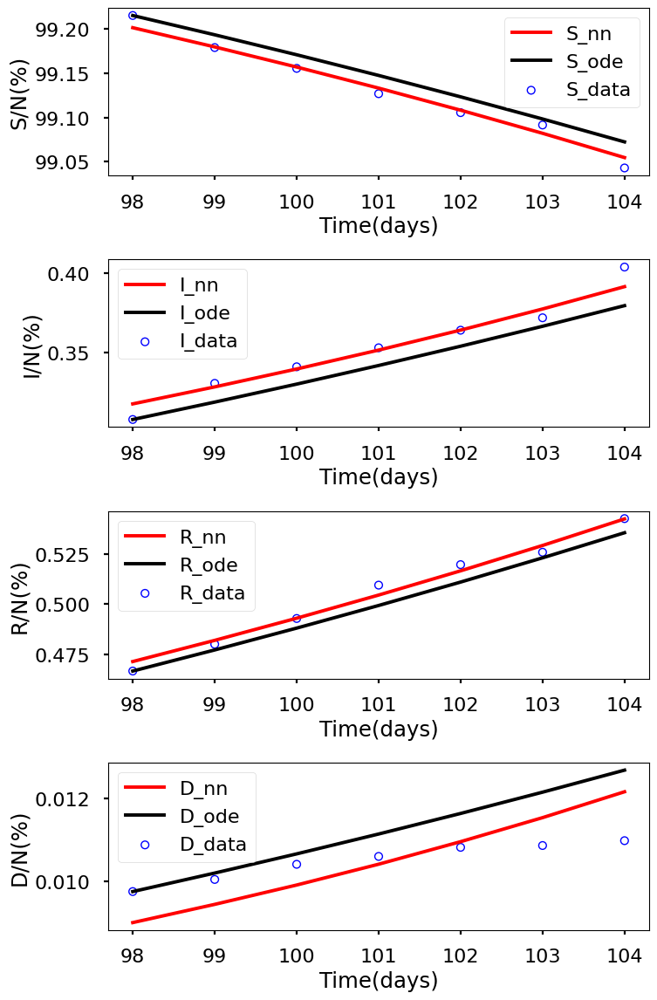

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.087e+00, GE_loss: 2.10976e+00,OB_loss: 9.77146e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 1.73, cumulative_time: 1.73
It: 10000, Loss: 1.706e-05, GE_loss: 4.94543e-06,OB_loss: 1.21189e-05, Beta: 1.06584e+00,gamma: 9.24605e-01,mu: 9.23035e-01, Time: 26.98, cumulative_time: 28.71
It: 20000, Loss: 2.122e-08, GE_loss: 4.88311e-09,OB_loss: 1.63324e-08, Beta: 7.53077e-02,gamma: 4.17997e-02,mu: 1.57200e-03, Time: 24.44, cumulative_time: 53.15
It: 30000, Loss: 4.112e-09, GE_loss: 1.24244e-09,OB_loss: 2.86986e-09, Beta: 7.30992e-02,gamma: 3.85659e-02,mu: 1.44534e-03, Time: 24.40, cumulative_time: 77.55
It: 40000, Loss: 4.027e-09, GE_loss: 1.25611e-09,OB_loss: 2.77059e-09, Beta: 7.31149e-02,gamma: 3.86094e-02,mu: 1.28445e-03, Time: 24.14, cumulative_time: 101.69
beta:  [0.07311671]
gamma:  [0.03868547]
mu:  [0.00115845]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


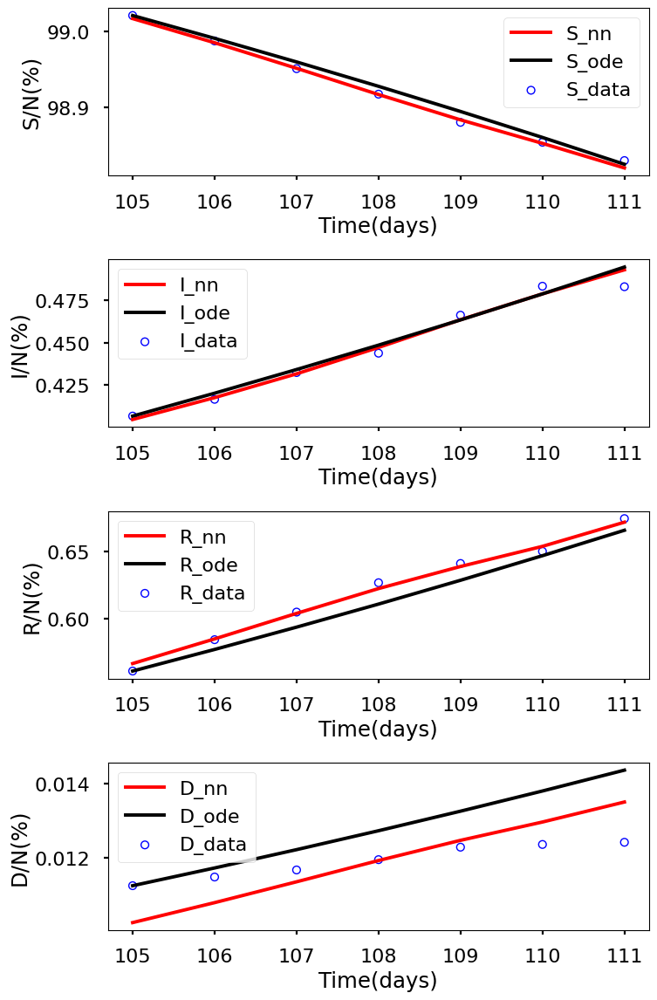

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.158e+00, GE_loss: 2.18148e+00,OB_loss: 9.76532e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 1.75, cumulative_time: 1.75
It: 10000, Loss: 2.299e-05, GE_loss: 6.84321e-06,OB_loss: 1.61442e-05, Beta: 1.06982e+00,gamma: 9.09386e-01,mu: 9.09182e-01, Time: 23.63, cumulative_time: 25.38
It: 20000, Loss: 2.821e-08, GE_loss: 1.11397e-08,OB_loss: 1.70670e-08, Beta: 6.70060e-02,gamma: 3.96635e-02,mu: 1.55668e-03, Time: 23.61, cumulative_time: 48.99
It: 30000, Loss: 9.619e-09, GE_loss: 1.35743e-10,OB_loss: 9.48341e-09, Beta: 6.73088e-02,gamma: 3.69653e-02,mu: 1.39503e-03, Time: 23.72, cumulative_time: 72.72
It: 40000, Loss: 8.847e-09, GE_loss: 2.96045e-10,OB_loss: 8.55117e-09, Beta: 6.73519e-02,gamma: 3.69382e-02,mu: 1.32365e-03, Time: 23.92, cumulative_time: 96.64
beta:  [0.06778007]
gamma:  [0.03718321]
mu:  [0.00130151]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


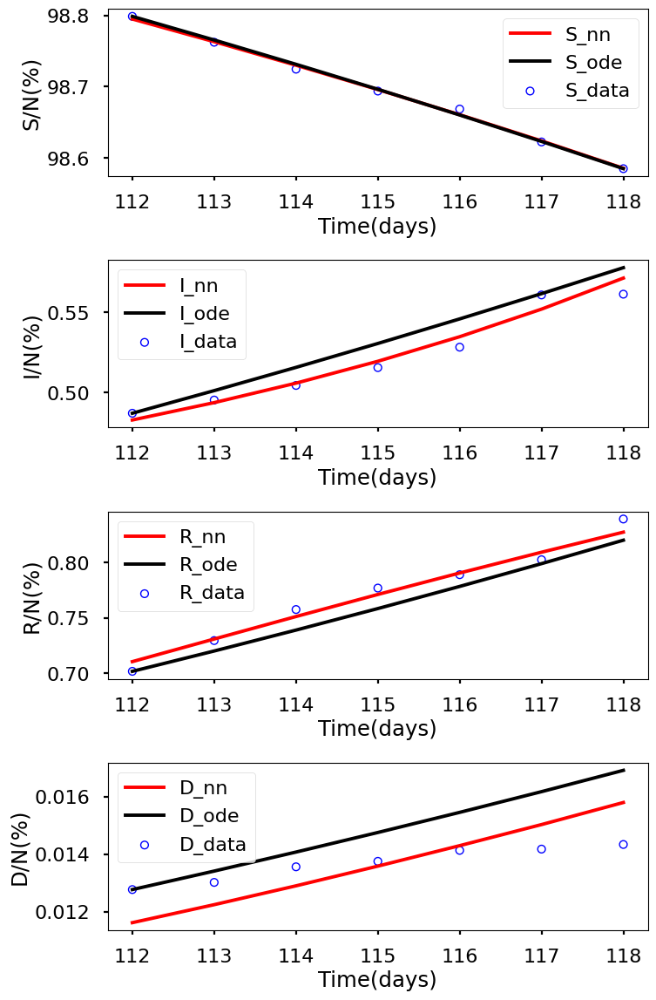

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.066e+00, GE_loss: 2.09498e+00,OB_loss: 9.70983e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 1.90, cumulative_time: 1.90
It: 10000, Loss: 2.730e-05, GE_loss: 7.82856e-06,OB_loss: 1.94684e-05, Beta: 1.06678e+00,gamma: 9.24256e-01,mu: 9.22496e-01, Time: 24.95, cumulative_time: 26.85
It: 20000, Loss: 2.683e-08, GE_loss: 2.89073e-09,OB_loss: 2.39441e-08, Beta: 5.51822e-02,gamma: 4.34804e-02,mu: 1.18851e-03, Time: 27.41, cumulative_time: 54.26
It: 30000, Loss: 1.217e-08, GE_loss: 2.21067e-09,OB_loss: 9.95933e-09, Beta: 5.44998e-02,gamma: 4.28941e-02,mu: 4.82050e-04, Time: 24.33, cumulative_time: 78.59
It: 40000, Loss: 1.046e-08, GE_loss: 3.14456e-09,OB_loss: 7.31643e-09, Beta: 5.41814e-02,gamma: 4.41174e-02,mu: 3.39196e-04, Time: 24.58, cumulative_time: 103.17
beta:  [0.05441224]
gamma:  [0.04422379]
mu:  [0.00048233]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


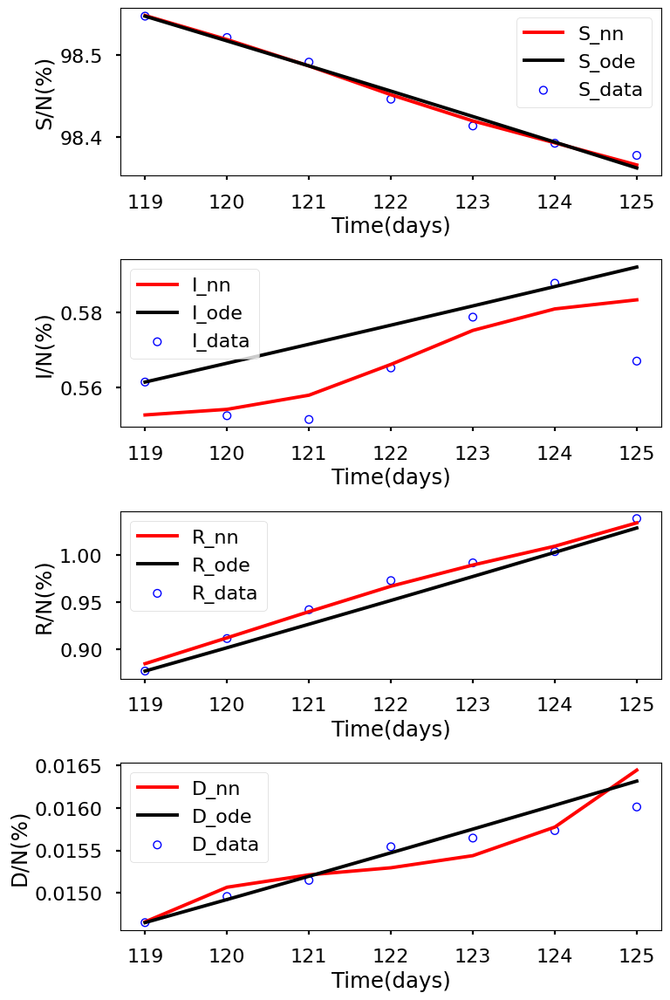

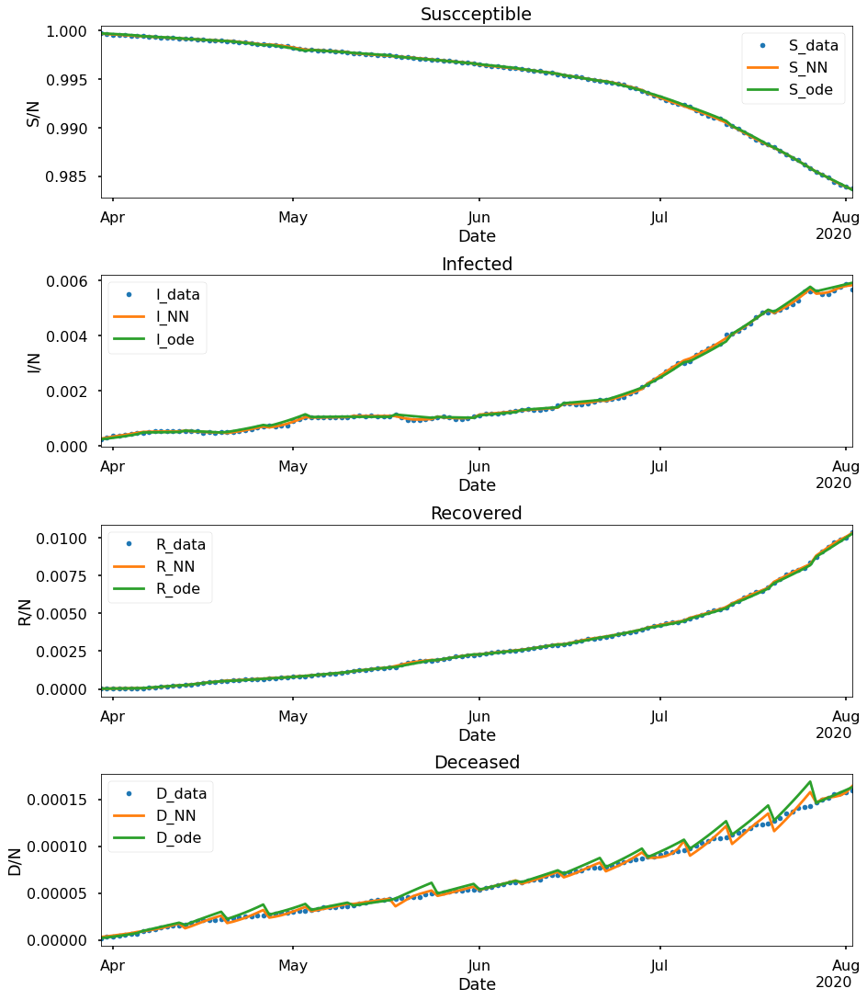

+---------------------+--------------+-------------+-------------+--------------+--------------+--------------+---------------+--------------+--------------+--------------+--------------+--------------+--------------+--------------+--------------+--------------+--------------+---------------+
|      Paramaters     |    Week 1    |    Week 2   |    Week 3   |    Week 4    |    Week 5    |    Week 6    |     Week 7    |    Week 8    |    Week 9    |   Week 10    |   Week 11    |   Week 12    |   Week 13    |   Week 14    |   Week 15    |   Week 16    |   Week 17    |    Week 18    |
+---------------------+--------------+-------------+-------------+--------------+--------------+--------------+---------------+--------------+--------------+--------------+--------------+--------------+--------------+--------------+--------------+--------------+--------------+---------------+
|         beta        | 0.106973894  |  0.06758582 | 0.066773966 |  0.10831013  |  0.10748668  | 0.038068574  |   0.03

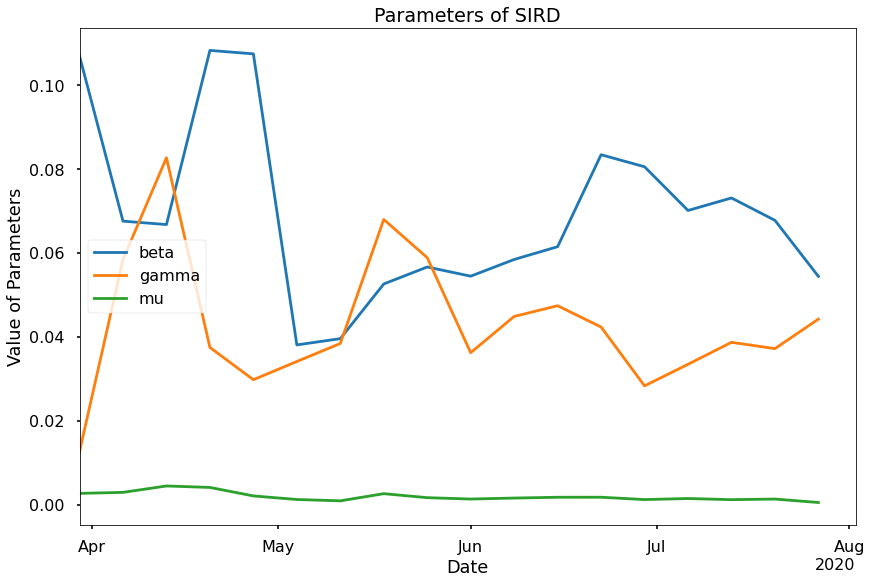

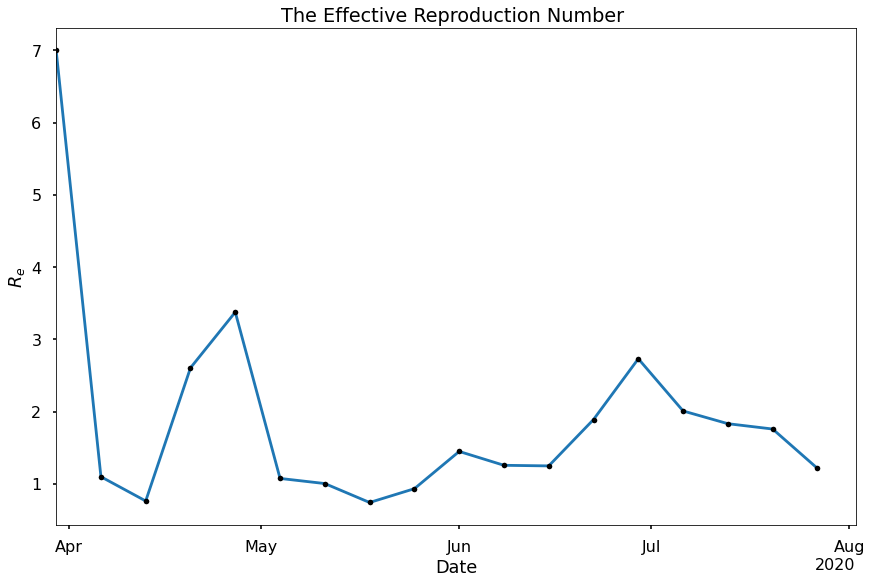

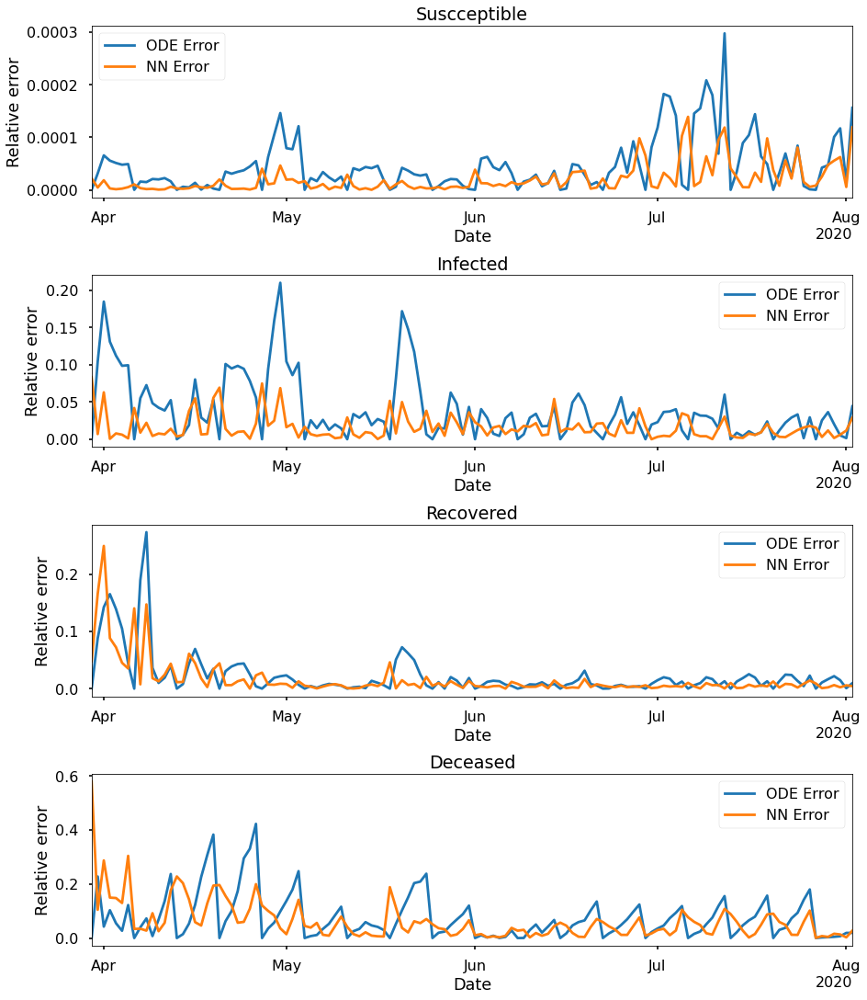

In [ ]:
layers316 = [1,16,16,16,4]
S316_ode,I316_ode,R316_ode,D316_ode,S316_learned,I316_learned,R316_learned,D316_learned,beta316,gamma316,mu316,S_errnn316,I_errnn316,R_errnn316,D_errnn316,S_erode316,I_errode316,R_errode316,D_errode316,time316 = sum_all(
    layers316,length,SS,II,RC,DC,N0,0.1,50000)

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.106e+00, GE_loss: 2.11100e+00,OB_loss: 9.94838e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 1.95, cumulative_time: 1.95
It: 10000, Loss: 2.249e-06, GE_loss: 9.43239e-07,OB_loss: 1.30560e-06, Beta: 1.04435e+00,gamma: 9.45331e-01,mu: 9.45374e-01, Time: 26.72, cumulative_time: 28.67
It: 20000, Loss: 1.329e-07, GE_loss: 3.60505e-08,OB_loss: 9.68939e-08, Beta: 1.04409e+00,gamma: 9.32220e-01,mu: 9.32449e-01, Time: 26.49, cumulative_time: 55.16
It: 30000, Loss: 9.850e-10, GE_loss: 7.04073e-11,OB_loss: 9.14602e-10, Beta: 1.00691e-01,gamma: 1.37148e-02,mu: 7.08213e-03, Time: 25.92, cumulative_time: 81.08
It: 40000, Loss: 3.638e-10, GE_loss: 6.05850e-11,OB_loss: 3.03262e-10, Beta: 1.04134e-01,gamma: 1.32717e-02,mu: 3.14008e-03, Time: 26.03, cumulative_time: 107.11
beta:  [0.10738894]
gamma:  [0.014063]
mu:  [0.00262812]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


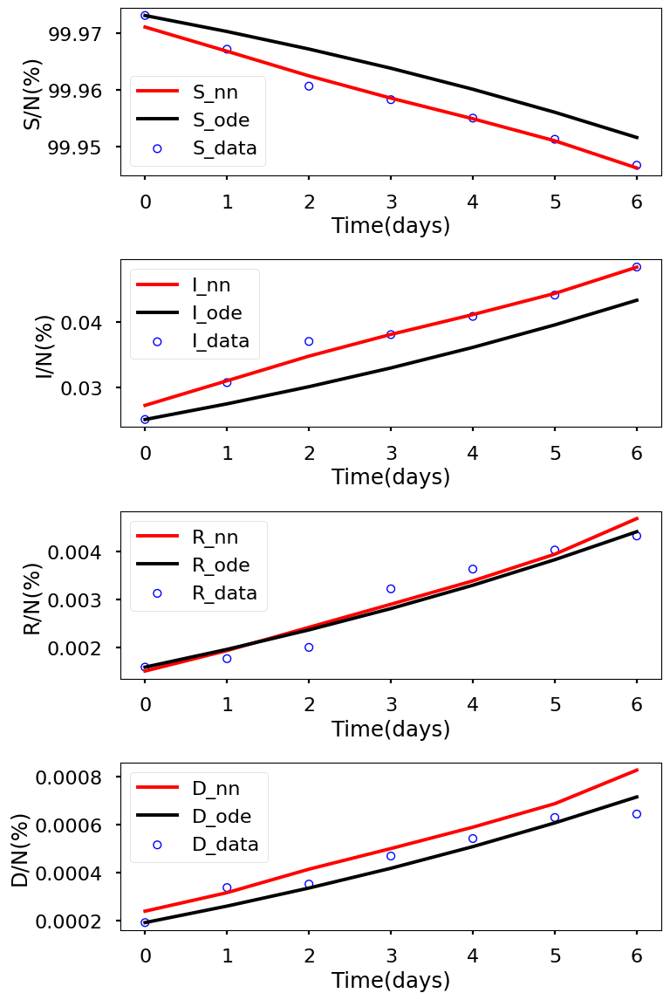

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.084e+00, GE_loss: 2.08462e+00,OB_loss: 9.99627e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 1.93, cumulative_time: 1.93
It: 10000, Loss: 3.107e-06, GE_loss: 1.13943e-06,OB_loss: 1.96792e-06, Beta: 1.04749e+00,gamma: 9.35387e-01,mu: 9.35919e-01, Time: 26.04, cumulative_time: 27.97
It: 20000, Loss: 2.576e-07, GE_loss: 7.43482e-08,OB_loss: 1.83297e-07, Beta: 1.03563e+00,gamma: 9.15225e-01,mu: 9.15088e-01, Time: 28.28, cumulative_time: 56.25
It: 30000, Loss: 3.395e-10, GE_loss: 1.04198e-10,OB_loss: 2.35343e-10, Beta: 6.31288e-02,gamma: 5.04327e-02,mu: 5.13606e-03, Time: 25.63, cumulative_time: 81.88
It: 40000, Loss: 1.322e-10, GE_loss: 3.65497e-11,OB_loss: 9.56628e-11, Beta: 6.72877e-02,gamma: 5.63808e-02,mu: 4.32131e-03, Time: 25.17, cumulative_time: 107.05
beta:  [0.06775053]
gamma:  [0.05689048]
mu:  [0.00406133]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


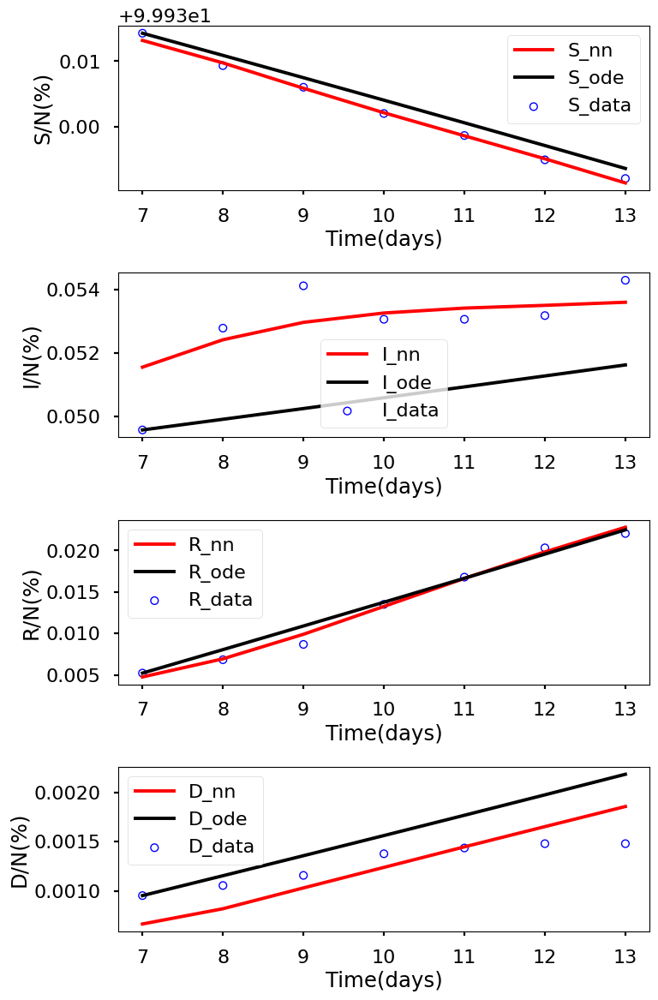

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.099e+00, GE_loss: 2.10060e+00,OB_loss: 9.98066e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 1.97, cumulative_time: 1.97
It: 10000, Loss: 2.491e-06, GE_loss: 1.06616e-06,OB_loss: 1.42476e-06, Beta: 1.04687e+00,gamma: 9.34964e-01,mu: 9.34867e-01, Time: 25.36, cumulative_time: 27.33
It: 20000, Loss: 2.363e-07, GE_loss: 7.19460e-08,OB_loss: 1.64391e-07, Beta: 1.05099e+00,gamma: 9.11554e-01,mu: 9.10625e-01, Time: 25.29, cumulative_time: 52.62
It: 30000, Loss: 5.878e-10, GE_loss: 1.67052e-10,OB_loss: 4.20769e-10, Beta: 6.56068e-02,gamma: 8.07728e-02,mu: 3.26646e-03, Time: 25.60, cumulative_time: 78.22
It: 40000, Loss: 4.494e-10, GE_loss: 5.23532e-11,OB_loss: 3.97095e-10, Beta: 6.61183e-02,gamma: 8.26054e-02,mu: 3.04112e-03, Time: 28.48, cumulative_time: 106.71
beta:  [0.06692912]
gamma:  [0.08367048]
mu:  [0.00295569]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


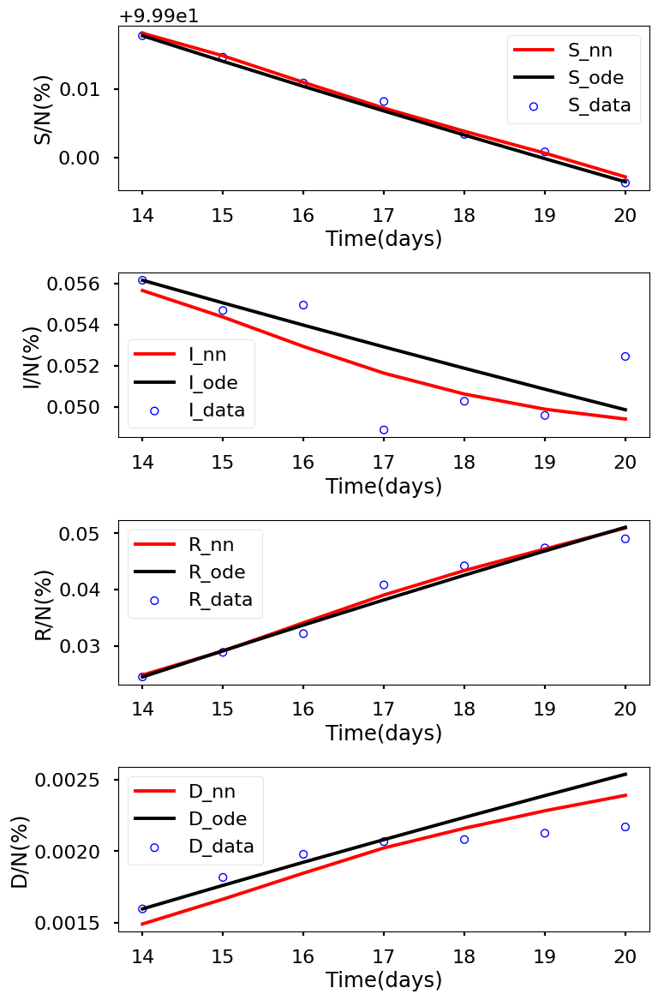

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.079e+00, GE_loss: 2.08068e+00,OB_loss: 9.98553e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 2.04, cumulative_time: 2.04
It: 10000, Loss: 1.613e-06, GE_loss: 9.57036e-07,OB_loss: 6.56153e-07, Beta: 1.04644e+00,gamma: 9.41193e-01,mu: 9.41518e-01, Time: 26.43, cumulative_time: 28.47
It: 20000, Loss: 2.965e-07, GE_loss: 9.42574e-08,OB_loss: 2.02277e-07, Beta: 1.06195e+00,gamma: 9.12347e-01,mu: 9.10508e-01, Time: 27.77, cumulative_time: 56.24
It: 30000, Loss: 7.163e-10, GE_loss: 9.59250e-11,OB_loss: 6.20354e-10, Beta: 1.11997e-01,gamma: 5.20886e-02,mu: 3.67592e-03, Time: 25.61, cumulative_time: 81.85
It: 40000, Loss: 1.767e-10, GE_loss: 1.47012e-11,OB_loss: 1.61970e-10, Beta: 1.09003e-01,gamma: 3.74812e-02,mu: 3.46709e-03, Time: 25.67, cumulative_time: 107.52
beta:  [0.10887601]
gamma:  [0.03718086]
mu:  [0.0034166]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


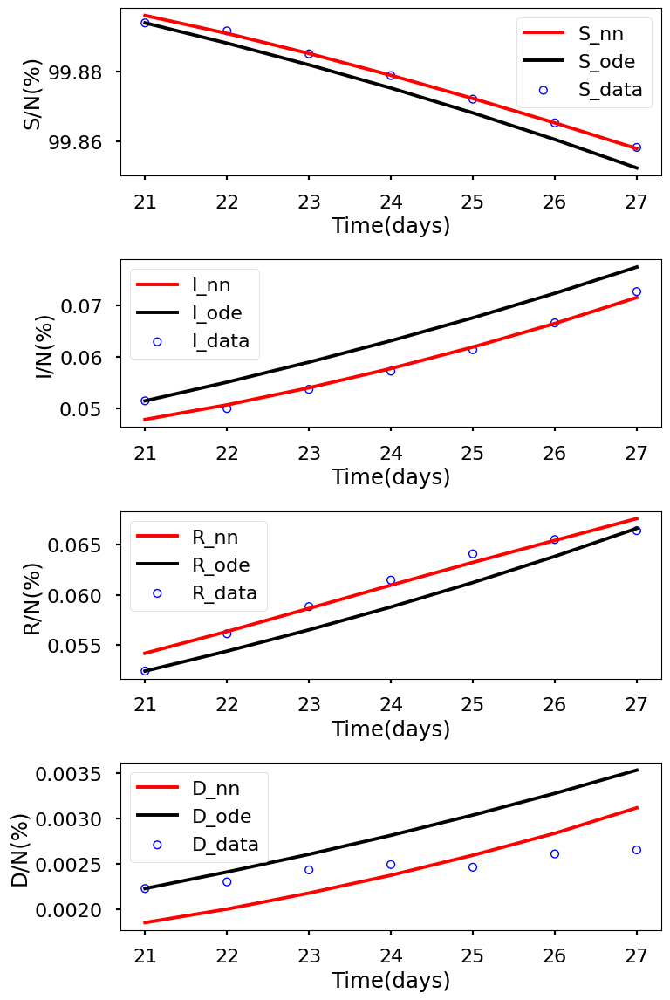

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.105e+00, GE_loss: 2.10882e+00,OB_loss: 9.96428e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 2.09, cumulative_time: 2.09
It: 10000, Loss: 1.930e-06, GE_loss: 6.19087e-07,OB_loss: 1.31115e-06, Beta: 1.04359e+00,gamma: 9.51529e-01,mu: 9.51775e-01, Time: 27.10, cumulative_time: 29.19
It: 20000, Loss: 5.907e-07, GE_loss: 1.87527e-07,OB_loss: 4.03222e-07, Beta: 1.08822e+00,gamma: 8.98530e-01,mu: 8.92806e-01, Time: 27.17, cumulative_time: 56.36
It: 30000, Loss: 1.836e-09, GE_loss: 3.42712e-10,OB_loss: 1.49348e-09, Beta: 1.08044e-01,gamma: 3.10867e-02,mu: 2.48197e-03, Time: 27.06, cumulative_time: 83.42
It: 40000, Loss: 1.763e-09, GE_loss: 3.65667e-10,OB_loss: 1.39757e-09, Beta: 1.07621e-01,gamma: 3.01391e-02,mu: 2.58017e-03, Time: 26.83, cumulative_time: 110.25
beta:  [0.10723044]
gamma:  [0.02979966]
mu:  [0.00256261]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


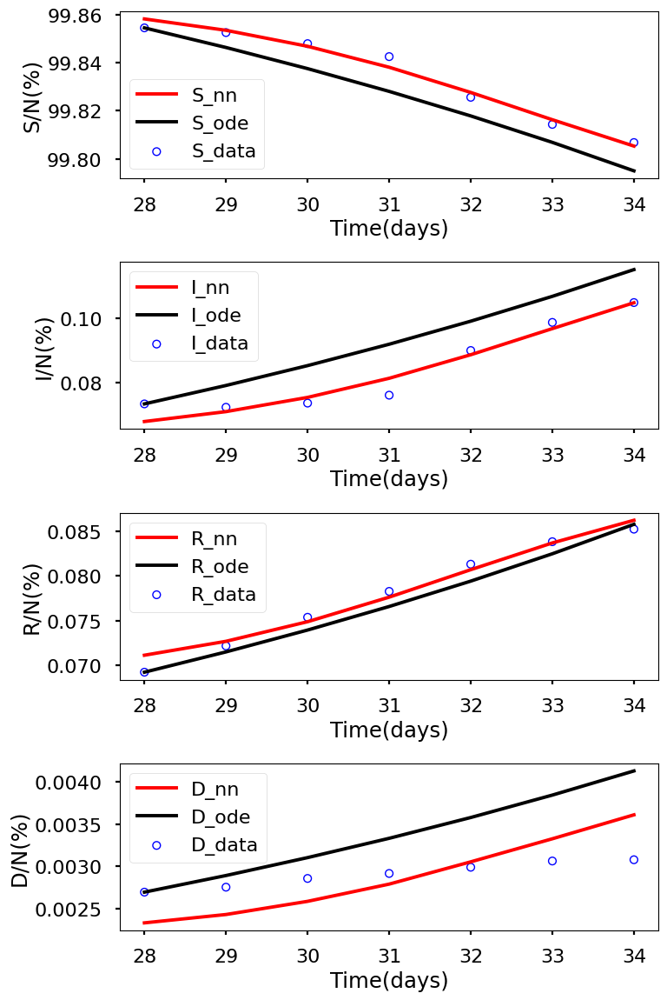

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.150e+00, GE_loss: 2.15719e+00,OB_loss: 9.93218e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 2.18, cumulative_time: 2.18
It: 10000, Loss: 1.920e-06, GE_loss: 1.36147e-06,OB_loss: 5.58830e-07, Beta: 1.05076e+00,gamma: 9.28325e-01,mu: 9.28583e-01, Time: 28.29, cumulative_time: 30.47
It: 20000, Loss: 8.941e-07, GE_loss: 2.90606e-07,OB_loss: 6.03520e-07, Beta: 1.06570e+00,gamma: 8.57848e-01,mu: 8.51964e-01, Time: 25.58, cumulative_time: 56.04
It: 30000, Loss: 1.115e-10, GE_loss: 2.38105e-11,OB_loss: 8.76556e-11, Beta: 3.72076e-02,gamma: 3.30058e-02,mu: 1.18227e-03, Time: 25.83, cumulative_time: 81.87
It: 40000, Loss: 9.982e-11, GE_loss: 9.17396e-12,OB_loss: 9.06456e-11, Beta: 3.79523e-02,gamma: 3.39252e-02,mu: 1.18314e-03, Time: 25.86, cumulative_time: 107.73
beta:  [0.03797863]
gamma:  [0.03398018]
mu:  [0.0011699]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


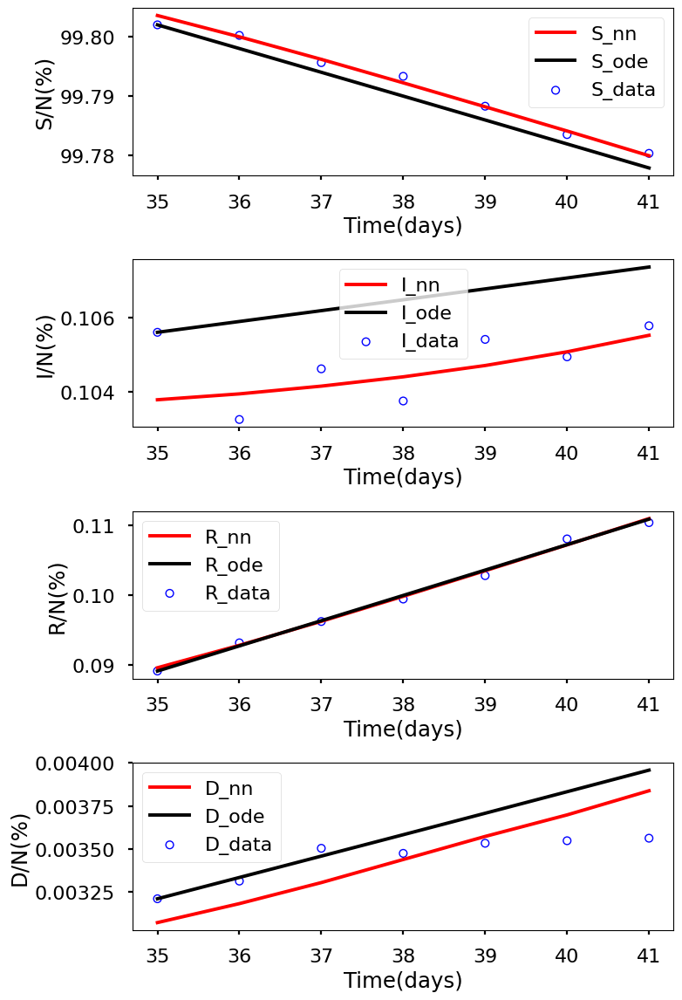

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.134e+00, GE_loss: 2.13737e+00,OB_loss: 9.96172e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 2.08, cumulative_time: 2.08
It: 10000, Loss: 1.959e-06, GE_loss: 1.02491e-06,OB_loss: 9.34528e-07, Beta: 1.03931e+00,gamma: 9.45018e-01,mu: 9.44811e-01, Time: 25.87, cumulative_time: 27.95
It: 20000, Loss: 9.715e-07, GE_loss: 3.15807e-07,OB_loss: 6.55741e-07, Beta: 1.05983e+00,gamma: 8.54031e-01,mu: 8.41994e-01, Time: 26.82, cumulative_time: 54.77
It: 30000, Loss: 2.207e-10, GE_loss: 8.23989e-12,OB_loss: 2.12494e-10, Beta: 3.86217e-02,gamma: 3.81923e-02,mu: 5.20982e-04, Time: 29.66, cumulative_time: 84.43
It: 40000, Loss: 1.776e-10, GE_loss: 1.79153e-11,OB_loss: 1.59723e-10, Beta: 3.90187e-02,gamma: 3.81045e-02,mu: 4.90082e-04, Time: 26.21, cumulative_time: 110.65
beta:  [0.039082]
gamma:  [0.03817405]
mu:  [0.00050853]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


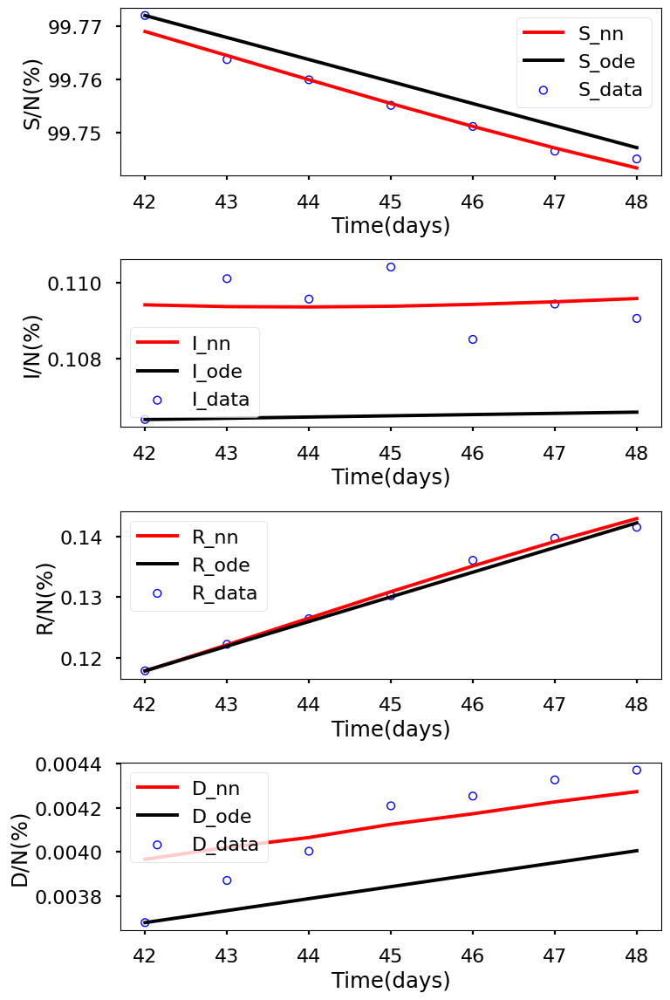

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.081e+00, GE_loss: 2.09105e+00,OB_loss: 9.89754e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 2.19, cumulative_time: 2.19
It: 10000, Loss: 1.782e-06, GE_loss: 1.13989e-06,OB_loss: 6.41864e-07, Beta: 1.04592e+00,gamma: 9.35902e-01,mu: 9.35822e-01, Time: 27.51, cumulative_time: 29.70
It: 20000, Loss: 8.010e-07, GE_loss: 2.59132e-07,OB_loss: 5.41838e-07, Beta: 1.07167e+00,gamma: 8.63924e-01,mu: 8.52113e-01, Time: 26.08, cumulative_time: 55.77
It: 30000, Loss: 2.845e-09, GE_loss: 6.61814e-10,OB_loss: 2.18276e-09, Beta: 5.19863e-02,gamma: 6.94365e-02,mu: 1.58248e-03, Time: 26.46, cumulative_time: 82.23
It: 40000, Loss: 2.555e-09, GE_loss: 8.50827e-10,OB_loss: 1.70393e-09, Beta: 5.26316e-02,gamma: 6.98906e-02,mu: 1.20174e-03, Time: 26.74, cumulative_time: 108.97
beta:  [0.05294885]
gamma:  [0.06945519]
mu:  [0.00095115]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


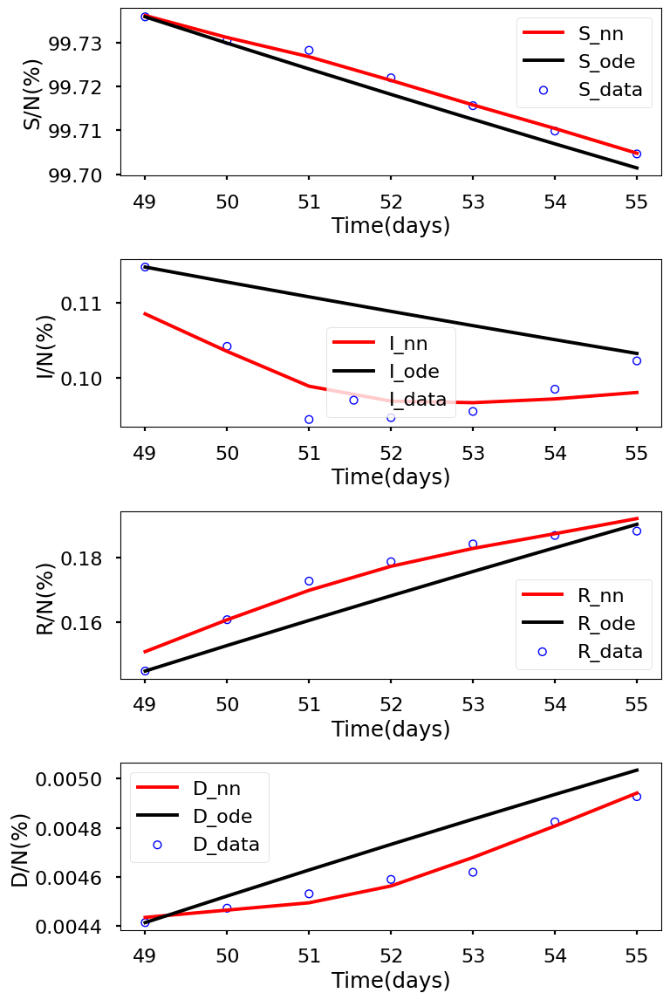

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.053e+00, GE_loss: 2.06287e+00,OB_loss: 9.90517e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 2.23, cumulative_time: 2.23
It: 10000, Loss: 1.817e-06, GE_loss: 1.09178e-06,OB_loss: 7.25329e-07, Beta: 1.04500e+00,gamma: 9.43716e-01,mu: 9.43643e-01, Time: 26.56, cumulative_time: 28.78
It: 20000, Loss: 8.563e-07, GE_loss: 2.77665e-07,OB_loss: 5.78662e-07, Beta: 1.07347e+00,gamma: 8.68543e-01,mu: 8.53577e-01, Time: 26.58, cumulative_time: 55.36
It: 30000, Loss: 1.289e-09, GE_loss: 1.52936e-10,OB_loss: 1.13646e-09, Beta: 5.71478e-02,gamma: 6.06352e-02,mu: 2.16551e-03, Time: 26.56, cumulative_time: 81.92
It: 40000, Loss: 1.135e-09, GE_loss: 2.41622e-10,OB_loss: 8.92905e-10, Beta: 5.78286e-02,gamma: 6.02598e-02,mu: 2.06395e-03, Time: 26.86, cumulative_time: 108.77
beta:  [0.05818874]
gamma:  [0.05946887]
mu:  [0.00178034]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


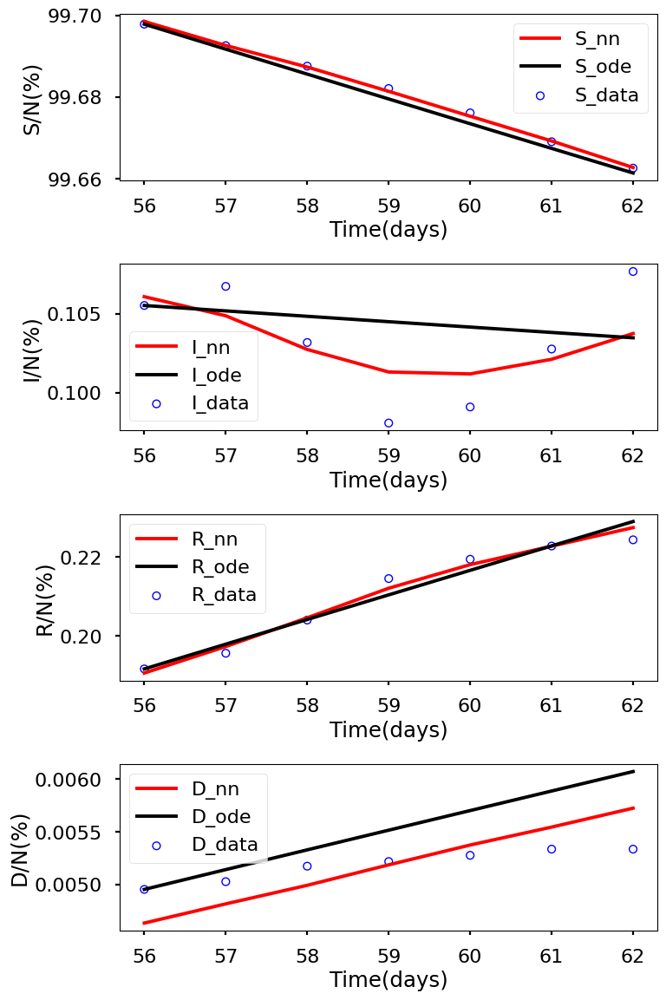

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.084e+00, GE_loss: 2.09327e+00,OB_loss: 9.90301e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 2.27, cumulative_time: 2.27
It: 10000, Loss: 1.830e-06, GE_loss: 1.03086e-06,OB_loss: 7.99278e-07, Beta: 1.04961e+00,gamma: 9.35726e-01,mu: 9.35556e-01, Time: 25.80, cumulative_time: 28.08
It: 20000, Loss: 1.136e-06, GE_loss: 3.81617e-07,OB_loss: 7.54271e-07, Beta: 1.06795e+00,gamma: 8.36314e-01,mu: 8.20467e-01, Time: 25.89, cumulative_time: 53.97
It: 30000, Loss: 5.524e-10, GE_loss: 6.30833e-11,OB_loss: 4.89309e-10, Beta: 5.47483e-02,gamma: 3.61467e-02,mu: 2.07219e-03, Time: 25.75, cumulative_time: 79.71
It: 40000, Loss: 5.419e-10, GE_loss: 8.20146e-11,OB_loss: 4.59914e-10, Beta: 5.45992e-02,gamma: 3.59684e-02,mu: 1.85539e-03, Time: 25.86, cumulative_time: 105.57
beta:  [0.05451054]
gamma:  [0.03591941]
mu:  [0.00172683]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


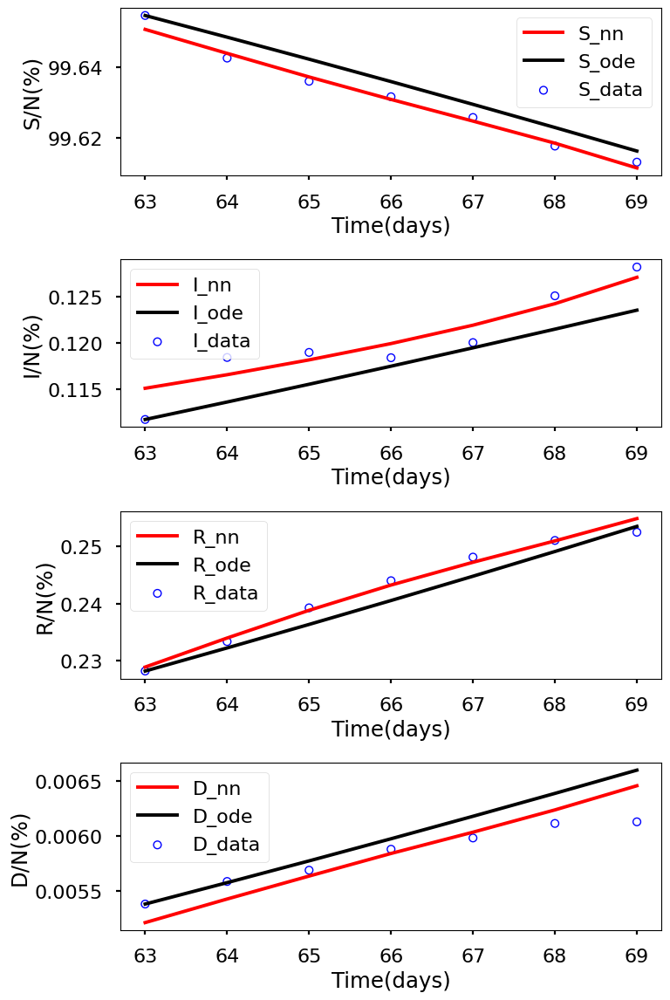

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.128e+00, GE_loss: 2.13915e+00,OB_loss: 9.88625e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 2.26, cumulative_time: 2.26
It: 10000, Loss: 2.037e-06, GE_loss: 9.68866e-07,OB_loss: 1.06818e-06, Beta: 1.04973e+00,gamma: 9.38997e-01,mu: 9.38445e-01, Time: 28.79, cumulative_time: 31.06
It: 20000, Loss: 1.381e-06, GE_loss: 4.71202e-07,OB_loss: 9.09563e-07, Beta: 1.07090e+00,gamma: 8.14964e-01,mu: 7.92340e-01, Time: 27.34, cumulative_time: 58.40
It: 30000, Loss: 9.796e-10, GE_loss: 5.09817e-11,OB_loss: 9.28663e-10, Beta: 5.84449e-02,gamma: 4.55919e-02,mu: 2.74995e-03, Time: 25.88, cumulative_time: 84.28
It: 40000, Loss: 8.444e-10, GE_loss: 1.63617e-10,OB_loss: 6.80822e-10, Beta: 5.83837e-02,gamma: 4.47837e-02,mu: 2.14950e-03, Time: 28.39, cumulative_time: 112.67
beta:  [0.05826145]
gamma:  [0.04470295]
mu:  [0.00191803]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


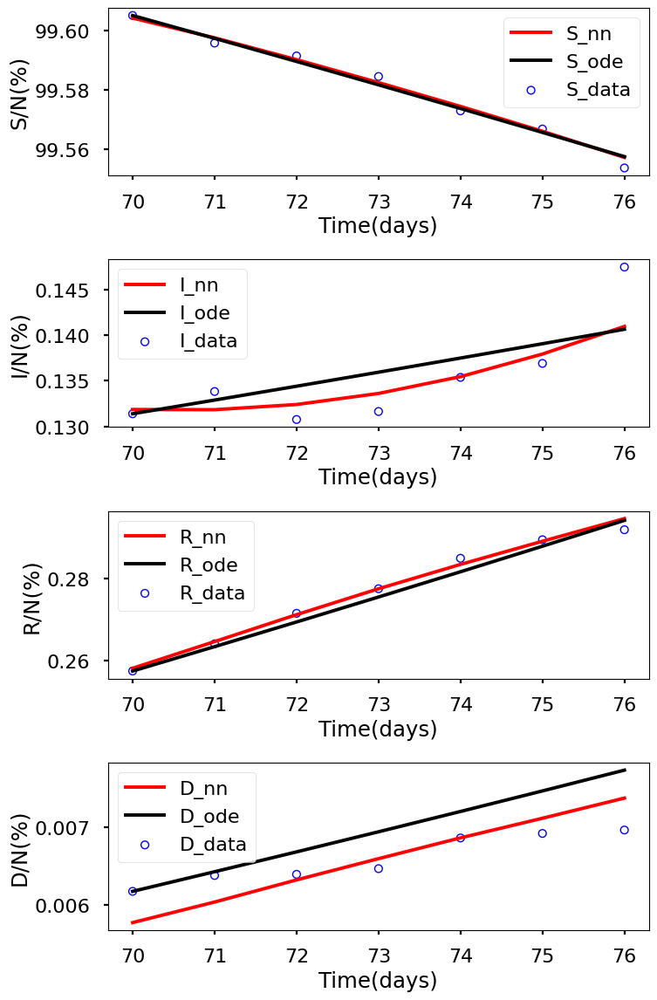

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.065e+00, GE_loss: 2.07730e+00,OB_loss: 9.87856e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 2.37, cumulative_time: 2.37
It: 10000, Loss: 3.092e-06, GE_loss: 1.69845e-06,OB_loss: 1.39404e-06, Beta: 1.04913e+00,gamma: 9.20327e-01,mu: 9.20397e-01, Time: 26.54, cumulative_time: 28.91
It: 20000, Loss: 1.688e-06, GE_loss: 6.10521e-07,OB_loss: 1.07700e-06, Beta: 9.94202e-01,gamma: 7.53946e-01,mu: 7.20749e-01, Time: 26.24, cumulative_time: 55.16
It: 30000, Loss: 2.539e-09, GE_loss: 5.10108e-10,OB_loss: 2.02860e-09, Beta: 6.15036e-02,gamma: 4.87328e-02,mu: 2.14469e-03, Time: 26.12, cumulative_time: 81.27
It: 40000, Loss: 2.360e-09, GE_loss: 6.24266e-10,OB_loss: 1.73536e-09, Beta: 6.12923e-02,gamma: 4.74175e-02,mu: 2.02628e-03, Time: 26.38, cumulative_time: 107.66
beta:  [0.06196459]
gamma:  [0.04716029]
mu:  [0.00181792]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


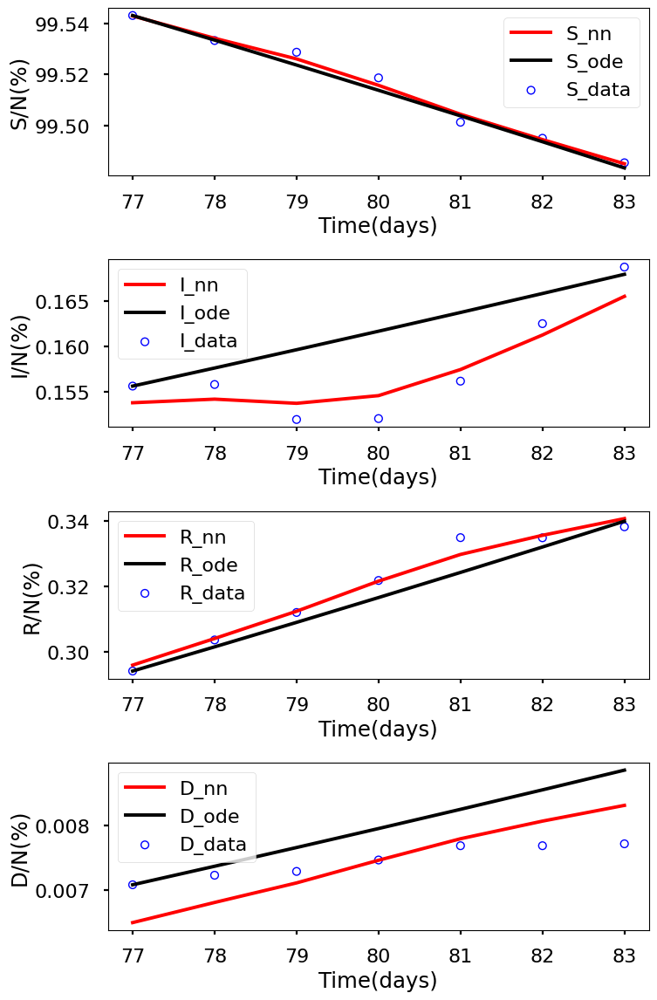

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.065e+00, GE_loss: 2.08311e+00,OB_loss: 9.82204e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 2.44, cumulative_time: 2.44
It: 10000, Loss: 3.157e-06, GE_loss: 1.10671e-06,OB_loss: 2.05072e-06, Beta: 1.04509e+00,gamma: 9.44931e-01,mu: 9.44659e-01, Time: 26.73, cumulative_time: 29.17
It: 20000, Loss: 2.070e-06, GE_loss: 8.43697e-07,OB_loss: 1.22656e-06, Beta: 9.61832e-01,gamma: 6.62265e-01,mu: 6.08005e-01, Time: 26.30, cumulative_time: 55.46
It: 30000, Loss: 1.545e-09, GE_loss: 1.89428e-10,OB_loss: 1.35511e-09, Beta: 8.42233e-02,gamma: 4.17782e-02,mu: 3.83844e-03, Time: 26.99, cumulative_time: 82.46
It: 40000, Loss: 1.431e-09, GE_loss: 1.82258e-10,OB_loss: 1.24877e-09, Beta: 8.42219e-02,gamma: 4.20812e-02,mu: 2.92536e-03, Time: 27.64, cumulative_time: 110.09
beta:  [0.08408479]
gamma:  [0.04224072]
mu:  [0.00237322]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


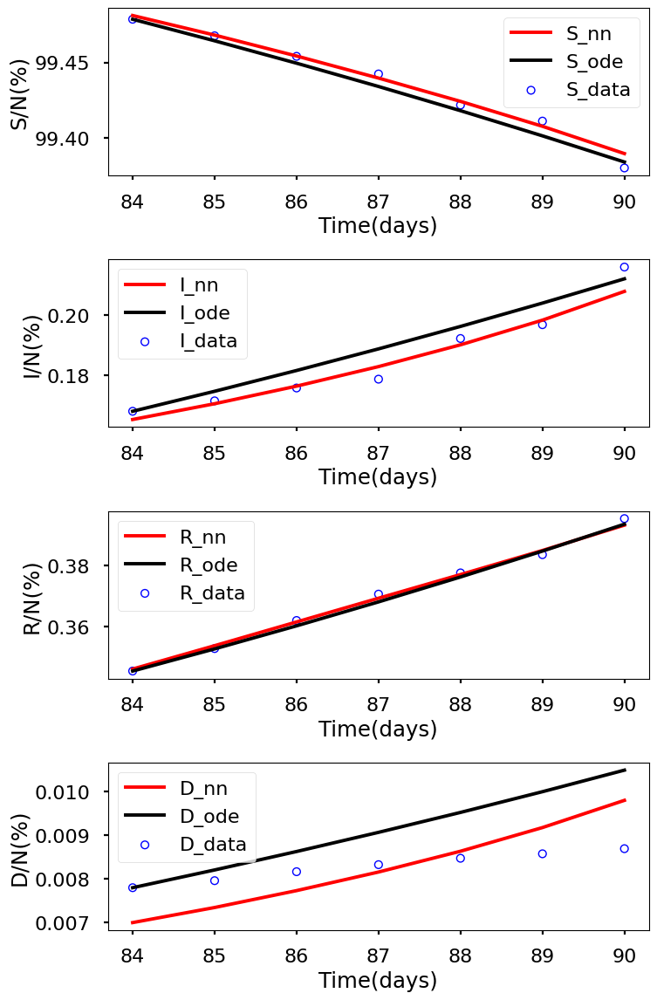

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.084e+00, GE_loss: 2.09858e+00,OB_loss: 9.85857e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 2.46, cumulative_time: 2.46
It: 10000, Loss: 6.710e-06, GE_loss: 2.16384e-06,OB_loss: 4.54630e-06, Beta: 1.04928e+00,gamma: 9.30059e-01,mu: 9.29737e-01, Time: 26.55, cumulative_time: 29.01
It: 20000, Loss: 8.778e-07, GE_loss: 6.05356e-07,OB_loss: 2.72446e-07, Beta: 3.55282e-01,gamma: 2.59356e-01,mu: 1.67904e-01, Time: 26.51, cumulative_time: 55.52
It: 30000, Loss: 2.726e-09, GE_loss: 9.37015e-10,OB_loss: 1.78930e-09, Beta: 8.06997e-02,gamma: 2.80390e-02,mu: 2.00404e-03, Time: 26.91, cumulative_time: 82.43
It: 40000, Loss: 2.707e-09, GE_loss: 9.30962e-10,OB_loss: 1.77567e-09, Beta: 8.06668e-02,gamma: 2.80369e-02,mu: 1.85814e-03, Time: 26.63, cumulative_time: 109.06
beta:  [0.08062614]
gamma:  [0.02808021]
mu:  [0.00170034]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


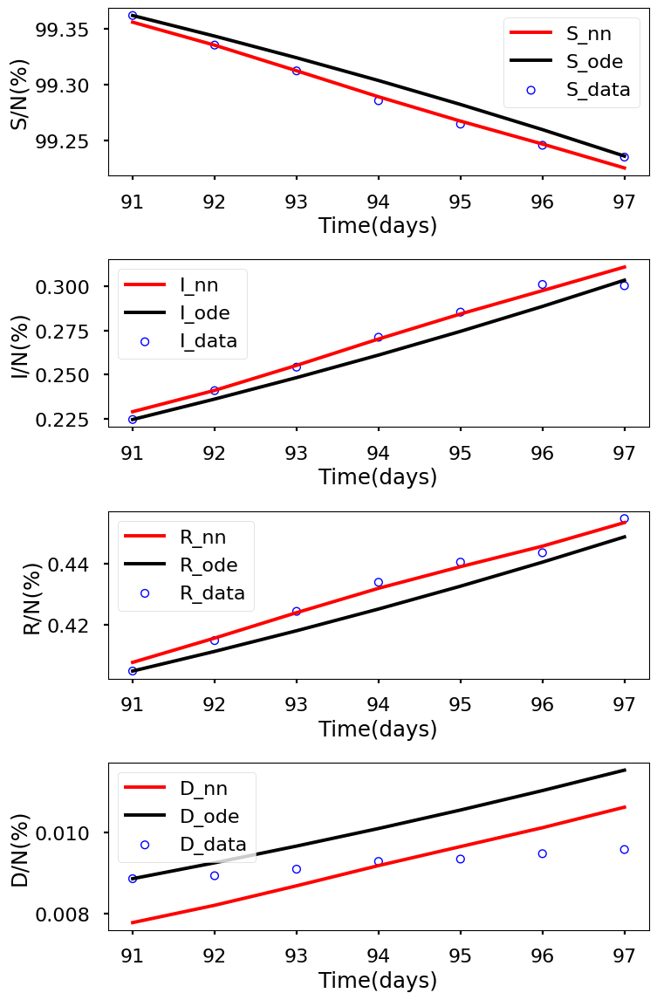

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.159e+00, GE_loss: 2.16994e+00,OB_loss: 9.89064e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 2.52, cumulative_time: 2.52
It: 10000, Loss: 1.095e-05, GE_loss: 3.15859e-06,OB_loss: 7.78690e-06, Beta: 1.05295e+00,gamma: 9.34210e-01,mu: 9.34453e-01, Time: 26.33, cumulative_time: 28.85
It: 20000, Loss: 2.265e-08, GE_loss: 1.06515e-08,OB_loss: 1.19949e-08, Beta: 8.86081e-02,gamma: 6.30465e-02,mu: 4.07605e-03, Time: 25.92, cumulative_time: 54.77
It: 30000, Loss: 3.979e-09, GE_loss: 6.41182e-10,OB_loss: 3.33831e-09, Beta: 7.13754e-02,gamma: 3.42684e-02,mu: 1.40303e-03, Time: 27.09, cumulative_time: 81.86
It: 40000, Loss: 4.796e-09, GE_loss: 1.34359e-09,OB_loss: 3.45282e-09, Beta: 7.13534e-02,gamma: 3.40948e-02,mu: 1.16431e-03, Time: 26.37, cumulative_time: 108.23
beta:  [0.07132205]
gamma:  [0.03390278]
mu:  [0.00096191]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


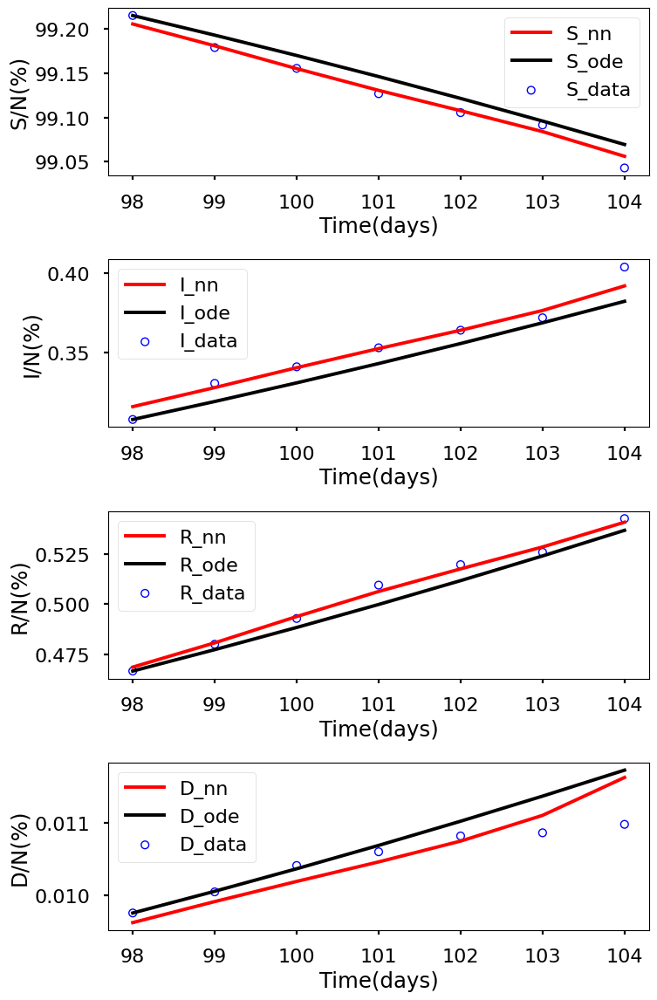

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.107e+00, GE_loss: 2.13203e+00,OB_loss: 9.74663e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 2.58, cumulative_time: 2.58
It: 10000, Loss: 1.738e-05, GE_loss: 5.31762e-06,OB_loss: 1.20636e-05, Beta: 1.05175e+00,gamma: 9.26091e-01,mu: 9.25050e-01, Time: 25.88, cumulative_time: 28.46
It: 20000, Loss: 1.460e-08, GE_loss: 1.13252e-09,OB_loss: 1.34642e-08, Beta: 7.34488e-02,gamma: 4.52490e-02,mu: 2.37295e-03, Time: 25.93, cumulative_time: 54.39
It: 30000, Loss: 4.322e-09, GE_loss: 1.09722e-09,OB_loss: 3.22476e-09, Beta: 7.31239e-02,gamma: 3.78835e-02,mu: 1.41170e-03, Time: 26.04, cumulative_time: 80.43
It: 40000, Loss: 4.269e-09, GE_loss: 1.12488e-09,OB_loss: 3.14383e-09, Beta: 7.30676e-02,gamma: 3.80350e-02,mu: 1.25591e-03, Time: 26.01, cumulative_time: 106.45
beta:  [0.0730615]
gamma:  [0.03814851]
mu:  [0.0011824]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


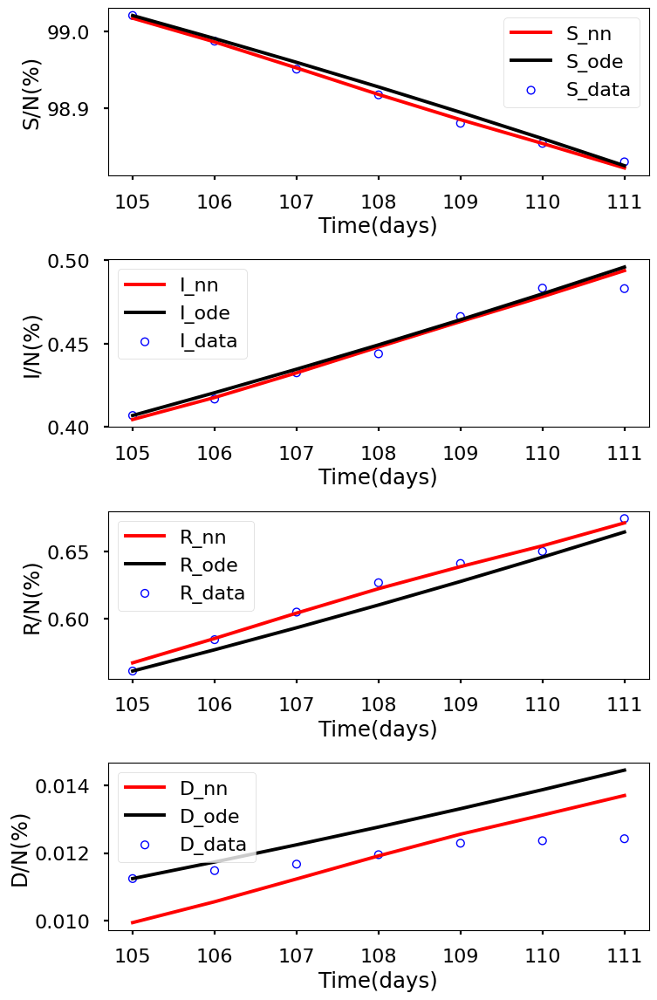

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.050e+00, GE_loss: 2.07557e+00,OB_loss: 9.74559e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 2.60, cumulative_time: 2.60
It: 10000, Loss: 2.330e-05, GE_loss: 6.99684e-06,OB_loss: 1.63009e-05, Beta: 1.05736e+00,gamma: 9.20979e-01,mu: 9.19562e-01, Time: 26.05, cumulative_time: 28.64
It: 20000, Loss: 1.602e-08, GE_loss: 6.92964e-09,OB_loss: 9.08801e-09, Beta: 7.06356e-02,gamma: 4.35112e-02,mu: 2.39872e-03, Time: 27.50, cumulative_time: 56.14
It: 30000, Loss: 7.009e-09, GE_loss: 1.53342e-09,OB_loss: 5.47545e-09, Beta: 6.89868e-02,gamma: 3.82458e-02,mu: 1.94201e-03, Time: 27.07, cumulative_time: 83.21
It: 40000, Loss: 6.219e-09, GE_loss: 1.89079e-09,OB_loss: 4.32779e-09, Beta: 6.87916e-02,gamma: 3.86456e-02,mu: 1.50127e-03, Time: 26.04, cumulative_time: 109.25
beta:  [0.06875803]
gamma:  [0.03871286]
mu:  [0.00129422]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


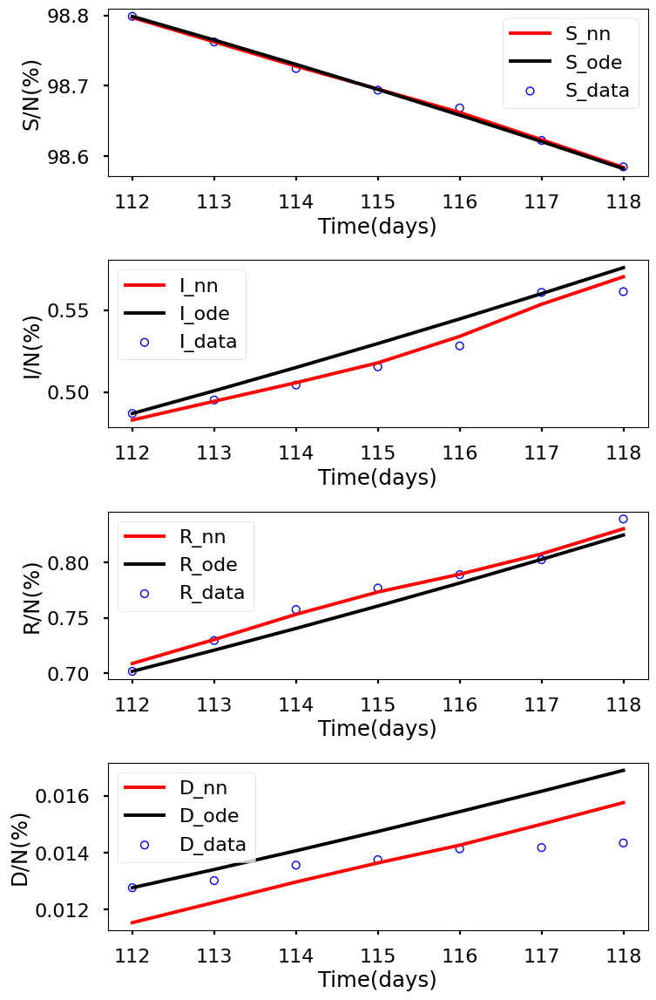

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.069e+00, GE_loss: 2.09927e+00,OB_loss: 9.69855e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 2.59, cumulative_time: 2.59
It: 10000, Loss: 2.753e-05, GE_loss: 8.28129e-06,OB_loss: 1.92441e-05, Beta: 1.05872e+00,gamma: 9.26652e-01,mu: 9.24581e-01, Time: 26.14, cumulative_time: 28.74
It: 20000, Loss: 1.408e-08, GE_loss: 1.74109e-09,OB_loss: 1.23347e-08, Beta: 5.65947e-02,gamma: 4.47242e-02,mu: 1.34662e-03, Time: 26.08, cumulative_time: 54.81
It: 30000, Loss: 1.155e-08, GE_loss: 2.28485e-09,OB_loss: 9.27000e-09, Beta: 5.47106e-02,gamma: 4.26708e-02,mu: 1.18220e-03, Time: 27.96, cumulative_time: 82.77
It: 40000, Loss: 1.013e-08, GE_loss: 3.37200e-09,OB_loss: 6.75575e-09, Beta: 5.45263e-02,gamma: 4.40277e-02,mu: 9.35239e-04, Time: 27.34, cumulative_time: 110.11
beta:  [0.05447576]
gamma:  [0.0440301]
mu:  [0.00081636]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


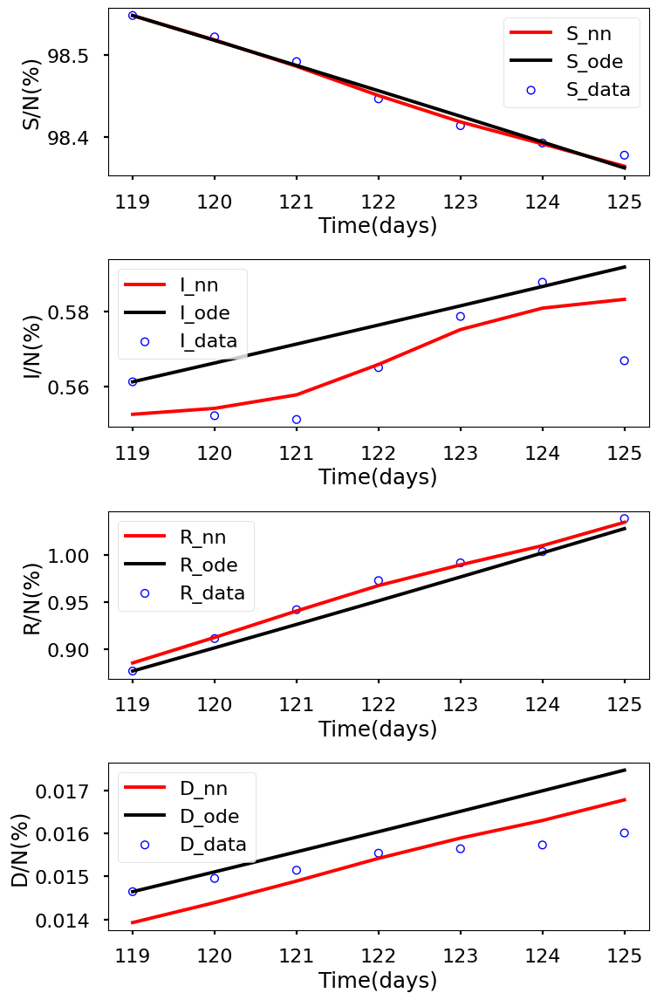

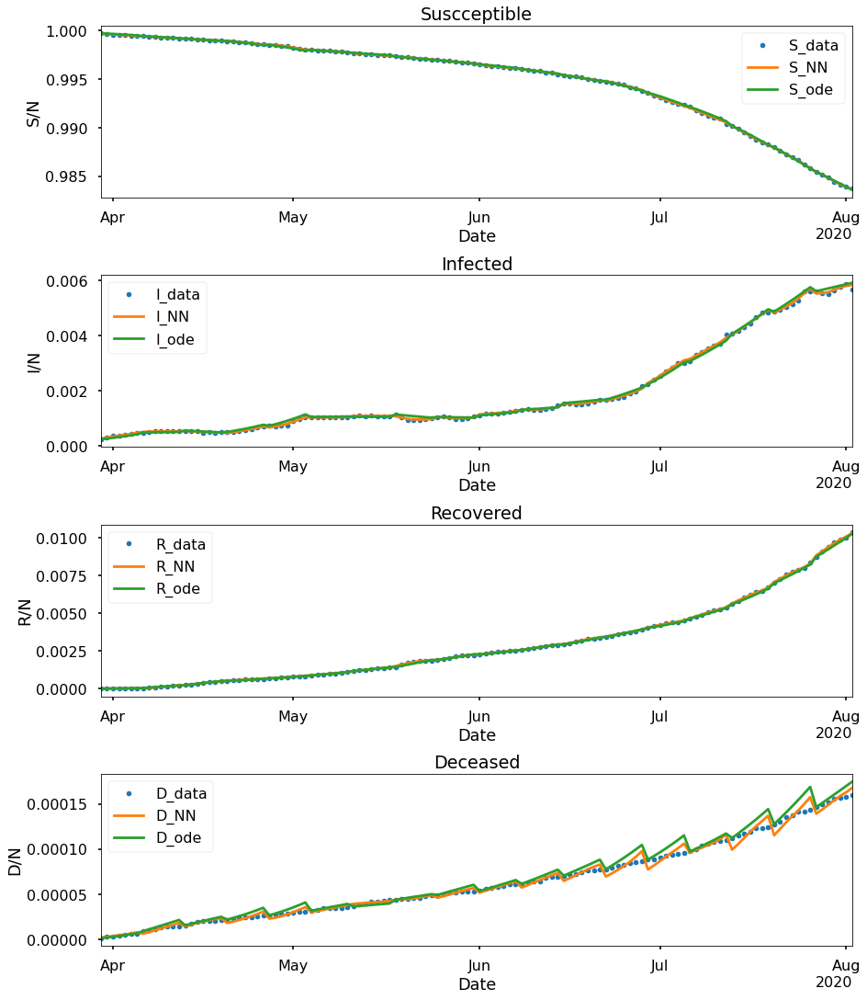

+---------------------+-------------+-------------+--------------+--------------+-------------+--------------+--------------+---------------+--------------+--------------+--------------+-------------+-------------+--------------+---------------+--------------+-------------+--------------+
|      Paramaters     |    Week 1   |    Week 2   |    Week 3    |    Week 4    |    Week 5   |    Week 6    |    Week 7    |     Week 8    |    Week 9    |   Week 10    |   Week 11    |   Week 12   |   Week 13   |   Week 14    |    Week 15    |   Week 16    |   Week 17   |   Week 18    |
+---------------------+-------------+-------------+--------------+--------------+-------------+--------------+--------------+---------------+--------------+--------------+--------------+-------------+-------------+--------------+---------------+--------------+-------------+--------------+
|         beta        |  0.10738894 |  0.06775053 | 0.066929124  |  0.10887601  |  0.10723044 |  0.03797863  | 0.039082002  |   0.

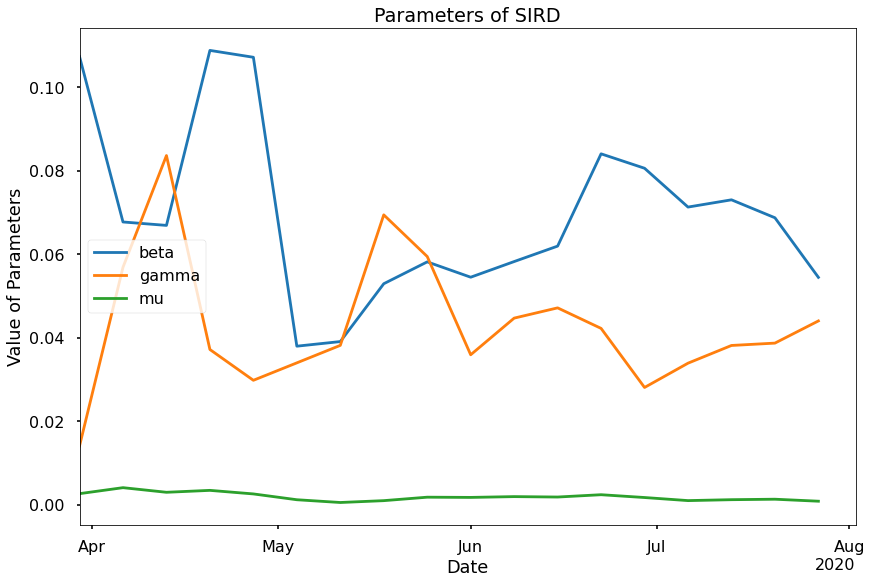

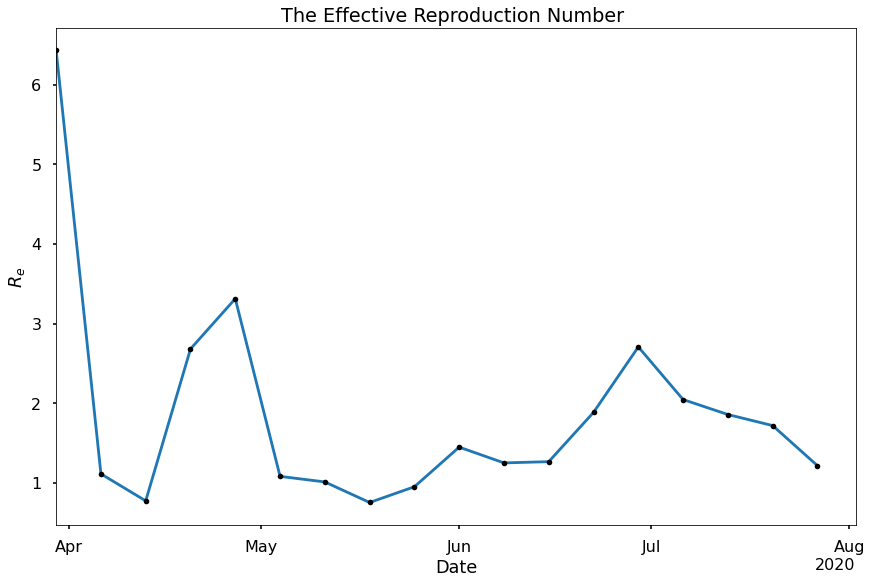

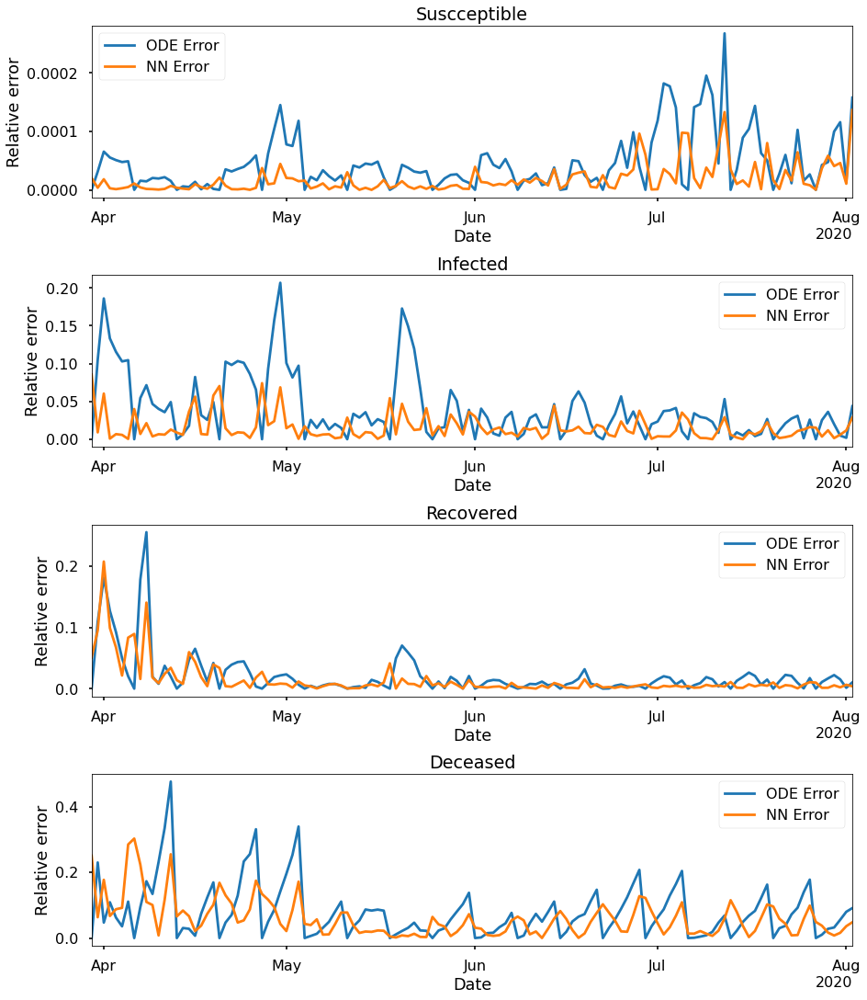

In [ ]:
layers416 = [1,16,16,16,16,4]
S416_ode,I416_ode,R416_ode,D416_ode,S416_learned,I416_learned,R416_learned,D416_learned,beta416,gamma416,mu416,S_errnn416,I_errnn416,R_errnn416,D_errnn416,S_erode416,I_errode416,R_errode416,D_errode416,time416 = sum_all(
    layers416,length,SS,II,RC,DC,N0,0.1,50000)

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.136e+00, GE_loss: 2.13916e+00,OB_loss: 9.96401e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 2.69, cumulative_time: 2.69
It: 10000, Loss: 3.083e-06, GE_loss: 6.16224e-07,OB_loss: 2.46648e-06, Beta: 1.03981e+00,gamma: 9.50913e-01,mu: 9.50878e-01, Time: 30.01, cumulative_time: 32.70
It: 20000, Loss: 1.409e-07, GE_loss: 3.60736e-08,OB_loss: 1.04805e-07, Beta: 1.03441e+00,gamma: 9.39372e-01,mu: 9.39419e-01, Time: 27.96, cumulative_time: 60.67
It: 30000, Loss: 1.153e-09, GE_loss: 1.24013e-10,OB_loss: 1.02902e-09, Beta: 1.00555e-01,gamma: 1.16185e-02,mu: 6.59325e-03, Time: 28.35, cumulative_time: 89.02
It: 40000, Loss: 3.550e-10, GE_loss: 9.37819e-11,OB_loss: 2.61222e-10, Beta: 1.06174e-01,gamma: 1.11622e-02,mu: 2.64893e-03, Time: 28.72, cumulative_time: 117.73
beta:  [0.10619208]
gamma:  [0.0114368]
mu:  [0.00230414]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


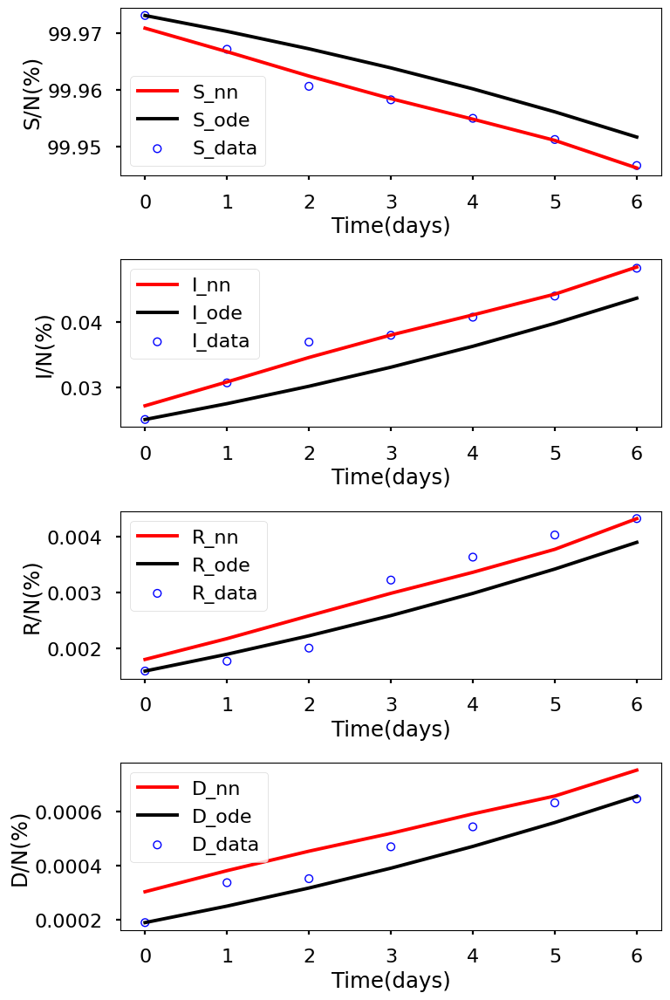

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.115e+00, GE_loss: 2.11979e+00,OB_loss: 9.95055e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 2.87, cumulative_time: 2.87
It: 10000, Loss: 3.181e-06, GE_loss: 1.36564e-06,OB_loss: 1.81538e-06, Beta: 1.04199e+00,gamma: 9.31050e-01,mu: 9.30850e-01, Time: 29.29, cumulative_time: 32.16
It: 20000, Loss: 2.518e-07, GE_loss: 7.57917e-08,OB_loss: 1.76039e-07, Beta: 1.03079e+00,gamma: 9.06445e-01,mu: 9.05743e-01, Time: 28.54, cumulative_time: 60.70
It: 30000, Loss: 3.226e-10, GE_loss: 1.08696e-10,OB_loss: 2.13876e-10, Beta: 6.62813e-02,gamma: 5.11461e-02,mu: 7.04813e-03, Time: 29.06, cumulative_time: 89.76
It: 40000, Loss: 1.885e-10, GE_loss: 4.86871e-11,OB_loss: 1.39811e-10, Beta: 6.78241e-02,gamma: 5.45928e-02,mu: 5.33207e-03, Time: 28.68, cumulative_time: 118.44
beta:  [0.0680229]
gamma:  [0.05546201]
mu:  [0.005116]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


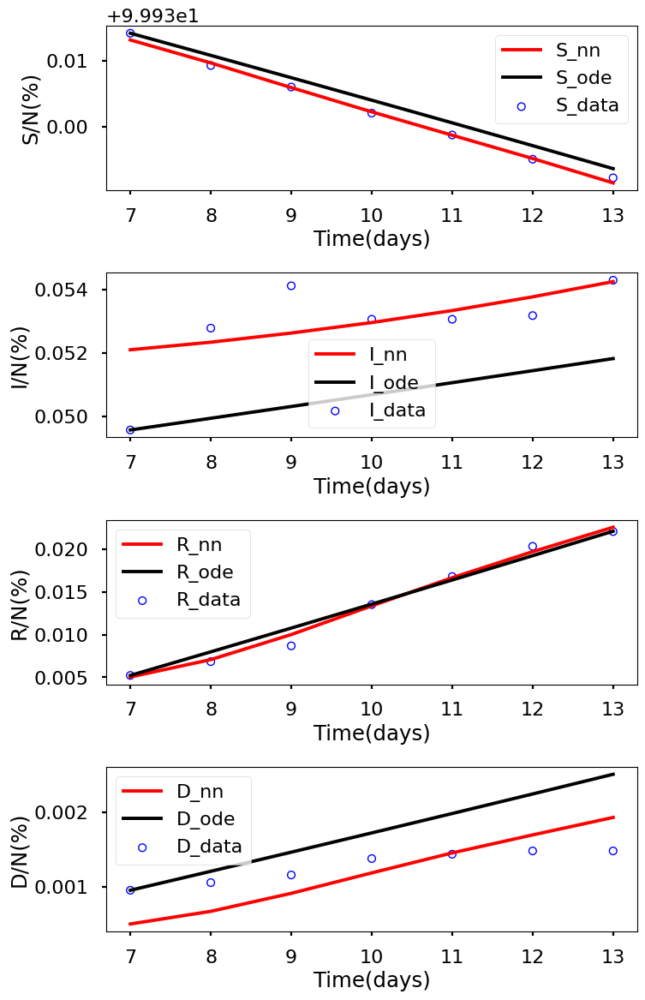

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.102e+00, GE_loss: 2.10458e+00,OB_loss: 9.97295e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 2.87, cumulative_time: 2.87
It: 10000, Loss: 2.235e-06, GE_loss: 1.12084e-06,OB_loss: 1.11452e-06, Beta: 1.04075e+00,gamma: 9.39570e-01,mu: 9.39975e-01, Time: 28.30, cumulative_time: 31.17
It: 20000, Loss: 2.405e-07, GE_loss: 7.24491e-08,OB_loss: 1.68039e-07, Beta: 1.04022e+00,gamma: 9.15458e-01,mu: 9.15172e-01, Time: 28.16, cumulative_time: 59.33
It: 30000, Loss: 5.320e-10, GE_loss: 1.30778e-10,OB_loss: 4.01188e-10, Beta: 6.67696e-02,gamma: 7.85981e-02,mu: 4.97271e-03, Time: 28.58, cumulative_time: 87.91
It: 40000, Loss: 4.452e-10, GE_loss: 8.88659e-11,OB_loss: 3.56359e-10, Beta: 6.76835e-02,gamma: 8.14110e-02,mu: 4.69361e-03, Time: 27.97, cumulative_time: 115.88
beta:  [0.06741188]
gamma:  [0.08118514]
mu:  [0.00461922]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


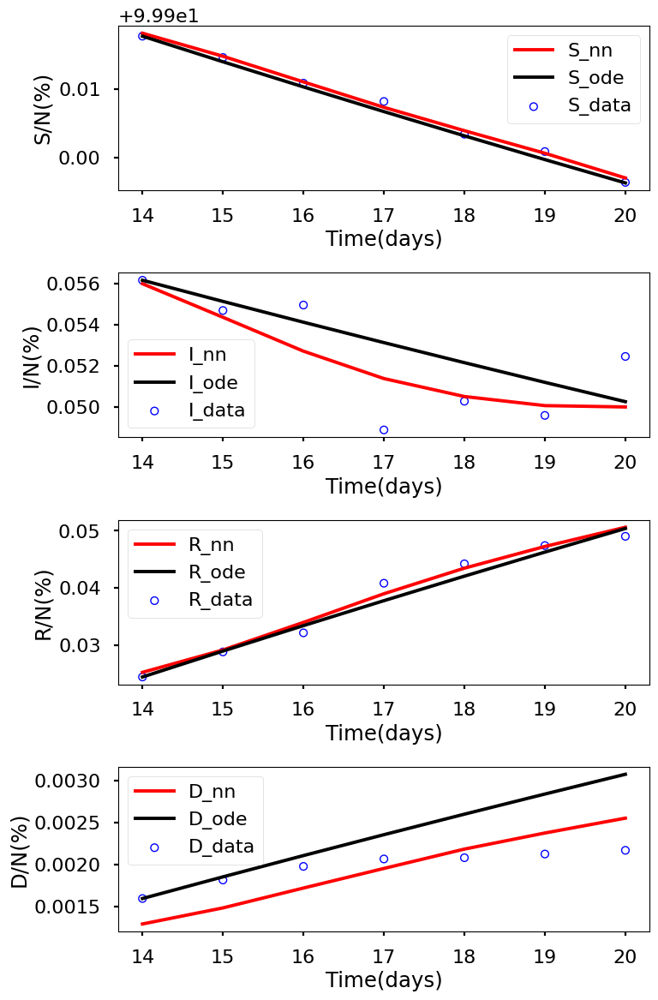

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.062e+00, GE_loss: 2.06597e+00,OB_loss: 9.96269e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 2.94, cumulative_time: 2.94
It: 10000, Loss: 2.382e-06, GE_loss: 9.44407e-07,OB_loss: 1.43791e-06, Beta: 1.04086e+00,gamma: 9.42763e-01,mu: 9.43055e-01, Time: 29.84, cumulative_time: 32.78
It: 20000, Loss: 3.047e-07, GE_loss: 9.41417e-08,OB_loss: 2.10551e-07, Beta: 1.04361e+00,gamma: 9.15490e-01,mu: 9.13938e-01, Time: 31.16, cumulative_time: 63.95
It: 30000, Loss: 3.058e-10, GE_loss: 4.79496e-11,OB_loss: 2.57894e-10, Beta: 1.09757e-01,gamma: 4.16566e-02,mu: 5.12507e-03, Time: 35.50, cumulative_time: 99.44
It: 40000, Loss: 2.316e-10, GE_loss: 1.64425e-11,OB_loss: 2.15129e-10, Beta: 1.09161e-01,gamma: 3.74107e-02,mu: 5.08128e-03, Time: 29.56, cumulative_time: 129.00
beta:  [0.10911419]
gamma:  [0.03740967]
mu:  [0.00484284]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


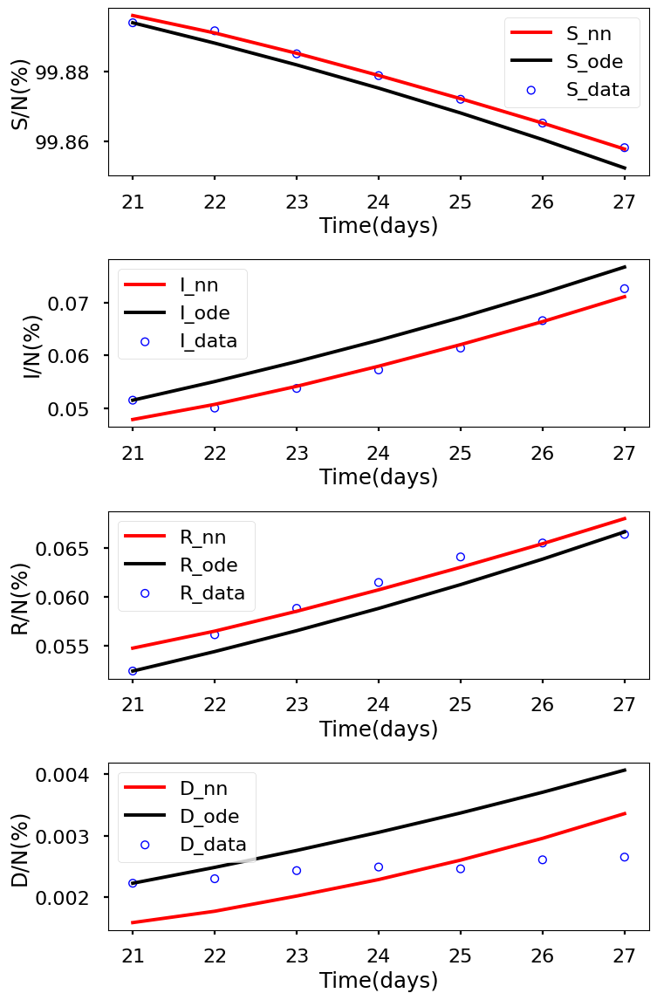

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.065e+00, GE_loss: 2.07264e+00,OB_loss: 9.92734e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 3.03, cumulative_time: 3.03
It: 10000, Loss: 1.542e-06, GE_loss: 6.37897e-07,OB_loss: 9.04352e-07, Beta: 1.03429e+00,gamma: 9.56068e-01,mu: 9.56114e-01, Time: 29.04, cumulative_time: 32.07
It: 20000, Loss: 5.856e-07, GE_loss: 1.87333e-07,OB_loss: 3.98286e-07, Beta: 1.07811e+00,gamma: 8.94235e-01,mu: 8.88190e-01, Time: 29.05, cumulative_time: 61.11
It: 30000, Loss: 1.835e-09, GE_loss: 3.42238e-10,OB_loss: 1.49301e-09, Beta: 1.08597e-01,gamma: 3.04987e-02,mu: 3.40483e-03, Time: 28.70, cumulative_time: 89.81
It: 40000, Loss: 1.758e-09, GE_loss: 4.13279e-10,OB_loss: 1.34491e-09, Beta: 1.07501e-01,gamma: 2.98674e-02,mu: 3.21268e-03, Time: 28.51, cumulative_time: 118.33
beta:  [0.10738912]
gamma:  [0.02976557]
mu:  [0.00321889]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


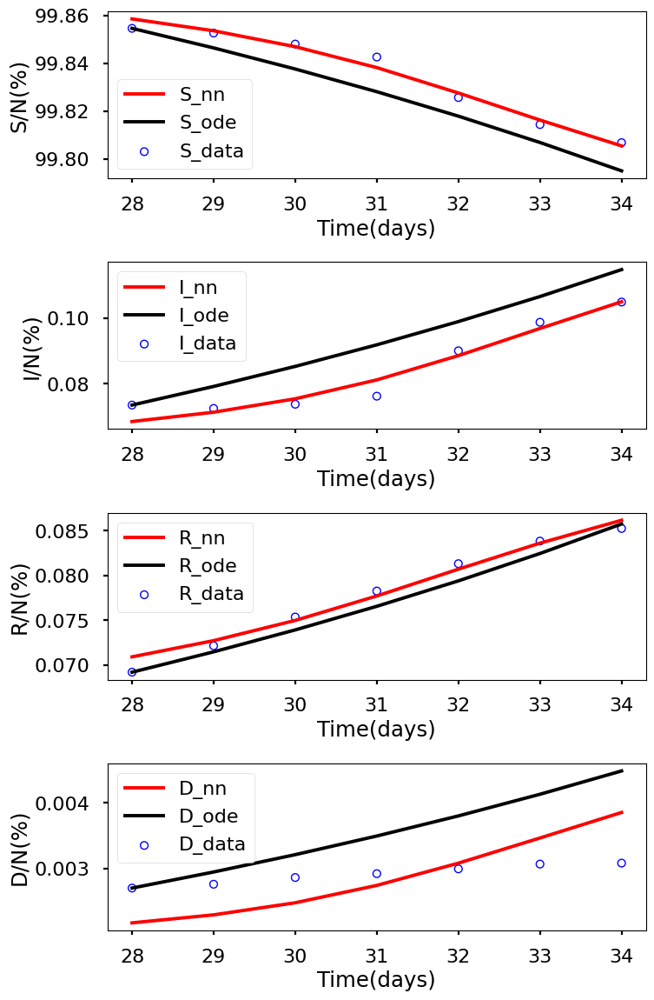

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.080e+00, GE_loss: 2.08471e+00,OB_loss: 9.94855e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 2.94, cumulative_time: 2.94
It: 10000, Loss: 2.207e-06, GE_loss: 1.02631e-06,OB_loss: 1.18100e-06, Beta: 1.03982e+00,gamma: 9.44727e-01,mu: 9.44943e-01, Time: 29.91, cumulative_time: 32.85
It: 20000, Loss: 9.070e-07, GE_loss: 2.95757e-07,OB_loss: 6.11197e-07, Beta: 1.04736e+00,gamma: 8.65405e-01,mu: 8.60959e-01, Time: 27.96, cumulative_time: 60.80
It: 30000, Loss: 1.452e-10, GE_loss: 3.48991e-11,OB_loss: 1.10255e-10, Beta: 3.90053e-02,gamma: 3.41757e-02,mu: 1.51669e-03, Time: 27.68, cumulative_time: 88.48
It: 40000, Loss: 1.058e-10, GE_loss: 1.06545e-11,OB_loss: 9.51512e-11, Beta: 3.82643e-02,gamma: 3.40352e-02,mu: 1.48493e-03, Time: 27.67, cumulative_time: 116.15
beta:  [0.0380788]
gamma:  [0.03397441]
mu:  [0.00144417]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


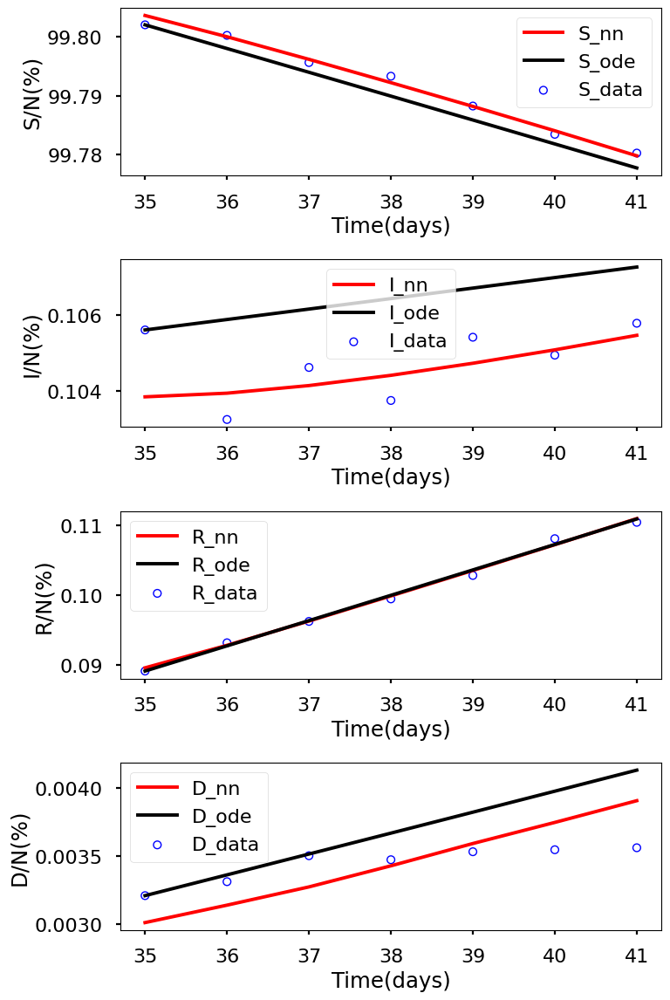

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.108e+00, GE_loss: 2.11560e+00,OB_loss: 9.92847e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 3.10, cumulative_time: 3.10
It: 10000, Loss: 2.030e-06, GE_loss: 1.07064e-06,OB_loss: 9.59793e-07, Beta: 1.03908e+00,gamma: 9.44917e-01,mu: 9.44971e-01, Time: 30.34, cumulative_time: 33.44
It: 20000, Loss: 9.836e-07, GE_loss: 3.23654e-07,OB_loss: 6.59964e-07, Beta: 1.05346e+00,gamma: 8.55717e-01,mu: 8.47442e-01, Time: 28.55, cumulative_time: 61.99
It: 30000, Loss: 2.086e-10, GE_loss: 2.37542e-11,OB_loss: 1.84809e-10, Beta: 4.02678e-02,gamma: 3.80848e-02,mu: 1.33519e-03, Time: 27.94, cumulative_time: 89.94
It: 40000, Loss: 1.812e-10, GE_loss: 1.60709e-11,OB_loss: 1.65178e-10, Beta: 3.97902e-02,gamma: 3.80203e-02,mu: 1.32731e-03, Time: 27.97, cumulative_time: 117.90
beta:  [0.03962583]
gamma:  [0.03798855]
mu:  [0.00132326]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


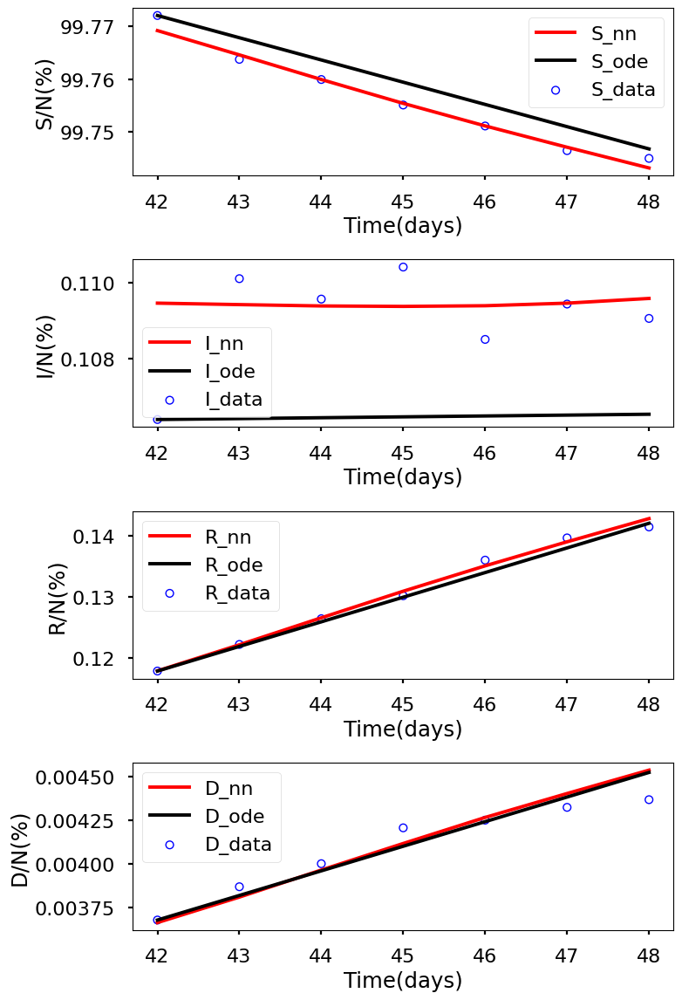

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.122e+00, GE_loss: 2.11730e+00,OB_loss: 1.00491e+00, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 3.11, cumulative_time: 3.11
It: 10000, Loss: 2.038e-06, GE_loss: 1.23825e-06,OB_loss: 7.99422e-07, Beta: 1.03890e+00,gamma: 9.43178e-01,mu: 9.42652e-01, Time: 27.86, cumulative_time: 30.97
It: 20000, Loss: 8.148e-07, GE_loss: 2.64075e-07,OB_loss: 5.50722e-07, Beta: 1.05571e+00,gamma: 8.68479e-01,mu: 8.56106e-01, Time: 28.23, cumulative_time: 59.20
It: 30000, Loss: 2.967e-09, GE_loss: 5.93474e-10,OB_loss: 2.37384e-09, Beta: 5.10104e-02,gamma: 7.02373e-02,mu: 8.52264e-04, Time: 28.94, cumulative_time: 88.14
It: 40000, Loss: 2.567e-09, GE_loss: 8.58931e-10,OB_loss: 1.70793e-09, Beta: 5.26247e-02,gamma: 6.93389e-02,mu: 7.38928e-04, Time: 28.65, cumulative_time: 116.79
beta:  [0.0529995]
gamma:  [0.06848927]
mu:  [0.00082395]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


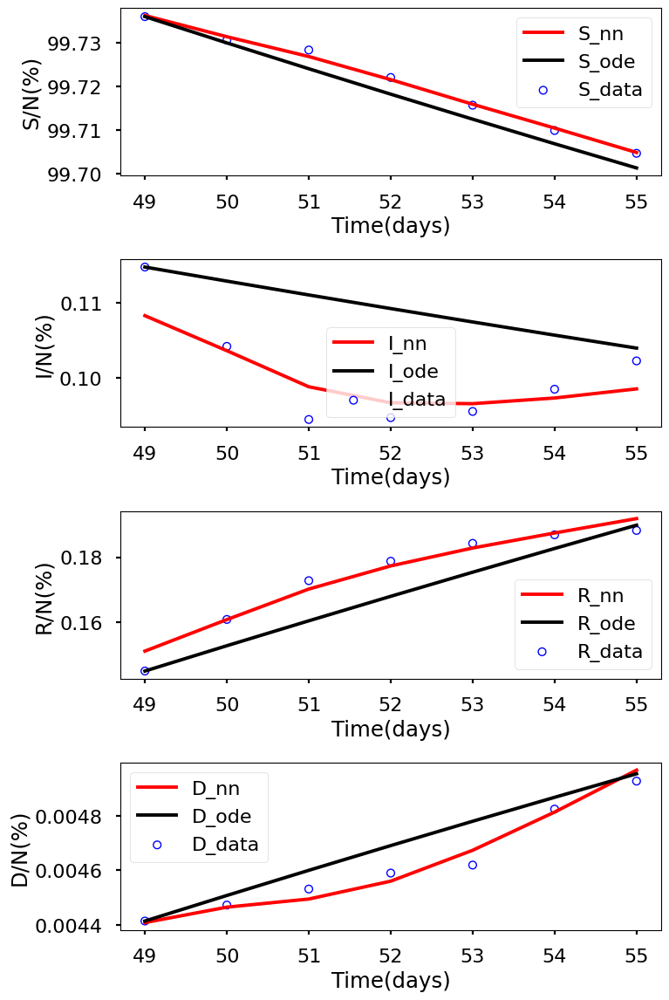

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.086e+00, GE_loss: 2.09975e+00,OB_loss: 9.85806e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 3.29, cumulative_time: 3.29
It: 10000, Loss: 1.353e-06, GE_loss: 8.33492e-07,OB_loss: 5.19189e-07, Beta: 1.04023e+00,gamma: 9.47513e-01,mu: 9.47501e-01, Time: 28.53, cumulative_time: 31.82
It: 20000, Loss: 8.493e-07, GE_loss: 2.74445e-07,OB_loss: 5.74813e-07, Beta: 1.07228e+00,gamma: 8.65993e-01,mu: 8.53121e-01, Time: 28.35, cumulative_time: 60.18
It: 30000, Loss: 1.275e-09, GE_loss: 1.94594e-10,OB_loss: 1.08073e-09, Beta: 5.67047e-02,gamma: 6.06358e-02,mu: 2.05251e-03, Time: 30.97, cumulative_time: 91.14
It: 40000, Loss: 1.134e-09, GE_loss: 3.18734e-10,OB_loss: 8.14955e-10, Beta: 5.76281e-02,gamma: 5.95578e-02,mu: 1.90593e-03, Time: 28.99, cumulative_time: 120.13
beta:  [0.05801745]
gamma:  [0.05900153]
mu:  [0.0015152]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


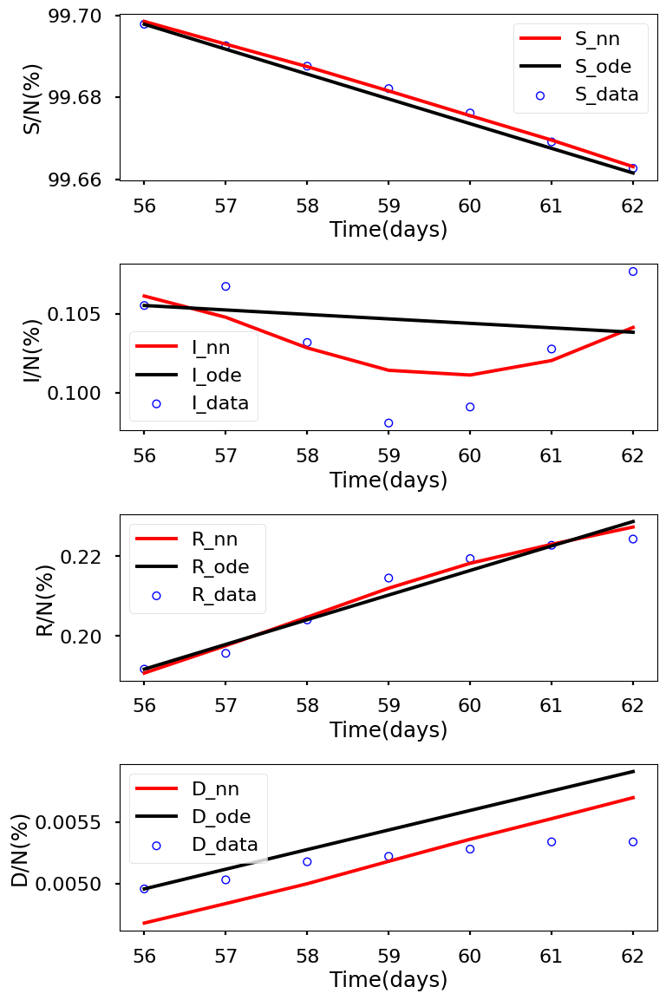

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.083e+00, GE_loss: 2.09614e+00,OB_loss: 9.86429e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 3.33, cumulative_time: 3.33
It: 10000, Loss: 2.045e-06, GE_loss: 7.32018e-07,OB_loss: 1.31334e-06, Beta: 1.03459e+00,gamma: 9.55421e-01,mu: 9.55311e-01, Time: 28.01, cumulative_time: 31.33
It: 20000, Loss: 1.138e-06, GE_loss: 3.80947e-07,OB_loss: 7.56812e-07, Beta: 1.06063e+00,gamma: 8.36579e-01,mu: 8.15992e-01, Time: 30.37, cumulative_time: 61.70
It: 30000, Loss: 5.710e-10, GE_loss: 4.93099e-11,OB_loss: 5.21714e-10, Beta: 5.46029e-02,gamma: 3.71381e-02,mu: 1.41462e-03, Time: 28.87, cumulative_time: 90.57
It: 40000, Loss: 5.364e-10, GE_loss: 5.11888e-11,OB_loss: 4.85230e-10, Beta: 5.44356e-02,gamma: 3.62388e-02,mu: 1.32476e-03, Time: 28.93, cumulative_time: 119.50
beta:  [0.05442837]
gamma:  [0.03613349]
mu:  [0.00125754]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


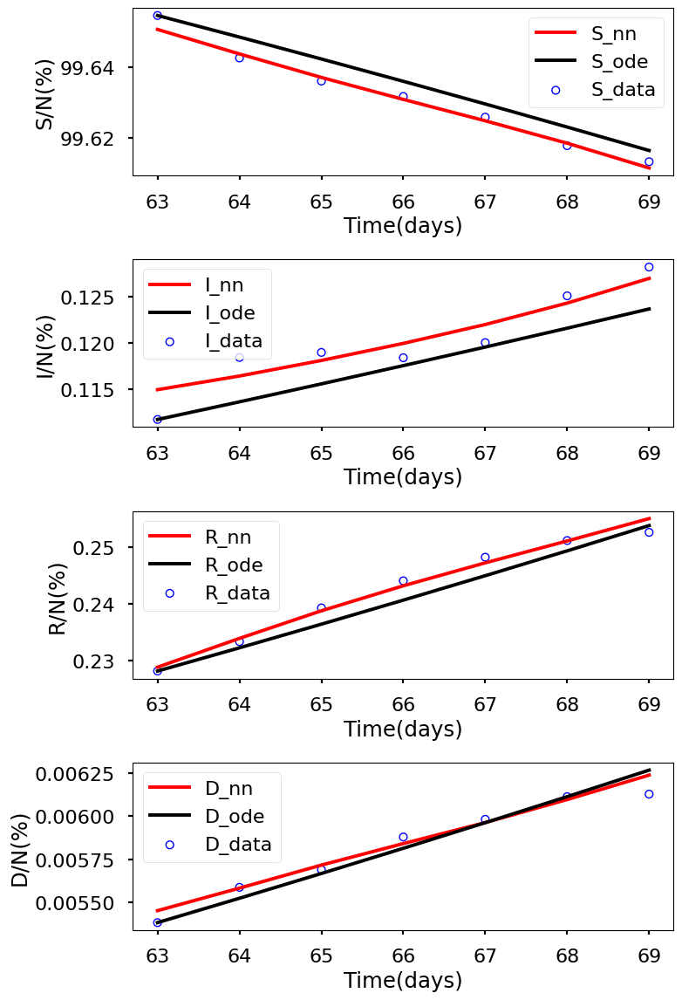

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.099e+00, GE_loss: 2.11261e+00,OB_loss: 9.86713e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 3.35, cumulative_time: 3.35
It: 10000, Loss: 2.281e-06, GE_loss: 1.23458e-06,OB_loss: 1.04602e-06, Beta: 1.04262e+00,gamma: 9.40705e-01,mu: 9.40516e-01, Time: 29.14, cumulative_time: 32.49
It: 20000, Loss: 1.367e-06, GE_loss: 4.66681e-07,OB_loss: 8.99845e-07, Beta: 1.06264e+00,gamma: 8.06236e-01,mu: 7.82827e-01, Time: 27.78, cumulative_time: 60.26
It: 30000, Loss: 8.693e-10, GE_loss: 1.63109e-10,OB_loss: 7.06215e-10, Beta: 5.83092e-02,gamma: 4.52505e-02,mu: 1.40152e-03, Time: 27.95, cumulative_time: 88.21
It: 40000, Loss: 7.560e-10, GE_loss: 2.11827e-10,OB_loss: 5.44191e-10, Beta: 5.85416e-02,gamma: 4.46217e-02,mu: 1.38568e-03, Time: 27.71, cumulative_time: 115.92
beta:  [0.05857797]
gamma:  [0.04467601]
mu:  [0.0014091]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


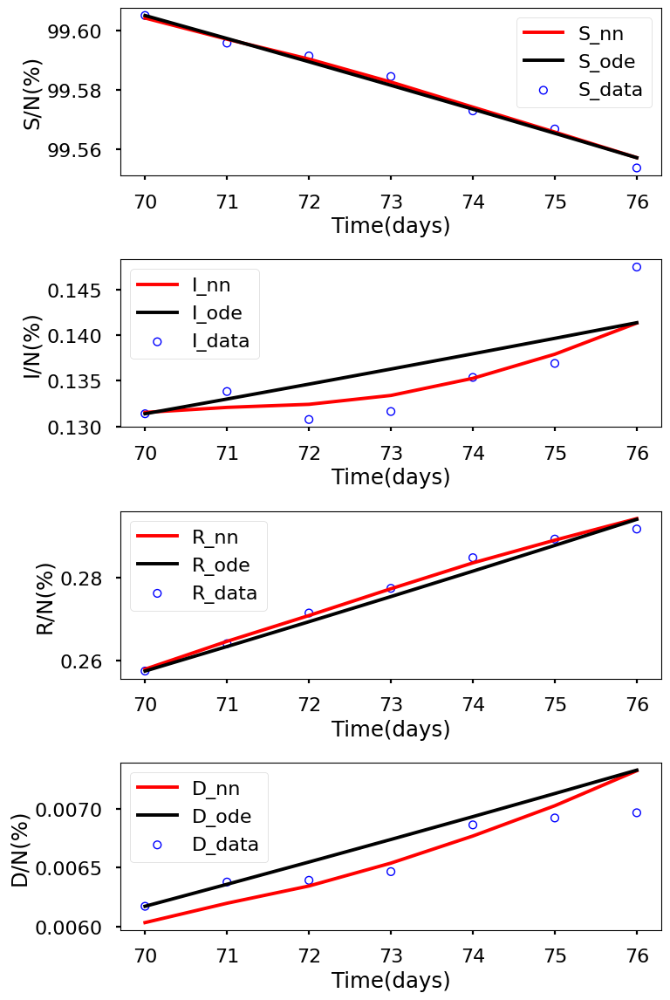

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.077e+00, GE_loss: 2.09222e+00,OB_loss: 9.84482e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 3.25, cumulative_time: 3.25
It: 10000, Loss: 2.683e-06, GE_loss: 1.04905e-06,OB_loss: 1.63432e-06, Beta: 1.04010e+00,gamma: 9.49315e-01,mu: 9.49185e-01, Time: 28.49, cumulative_time: 31.74
It: 20000, Loss: 1.734e-06, GE_loss: 6.31022e-07,OB_loss: 1.10298e-06, Beta: 1.04166e+00,gamma: 7.51603e-01,mu: 7.12081e-01, Time: 28.63, cumulative_time: 60.37
It: 30000, Loss: 2.527e-09, GE_loss: 4.07269e-10,OB_loss: 2.11973e-09, Beta: 6.08558e-02,gamma: 4.83972e-02,mu: 1.32412e-03, Time: 28.22, cumulative_time: 88.59
It: 40000, Loss: 2.179e-09, GE_loss: 7.56861e-10,OB_loss: 1.42198e-09, Beta: 6.18420e-02,gamma: 4.77563e-02,mu: 9.03476e-04, Time: 28.04, cumulative_time: 116.63
beta:  [0.06186236]
gamma:  [0.04785318]
mu:  [0.00088219]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


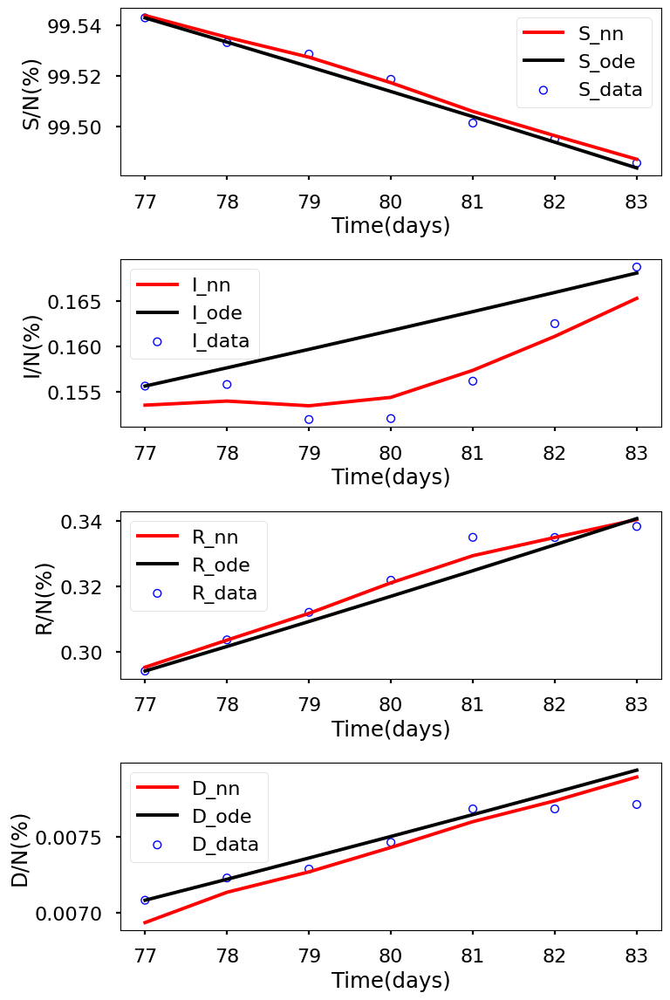

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.070e+00, GE_loss: 2.08460e+00,OB_loss: 9.85603e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 3.37, cumulative_time: 3.37
It: 10000, Loss: 3.623e-06, GE_loss: 1.27428e-06,OB_loss: 2.34915e-06, Beta: 1.04087e+00,gamma: 9.44496e-01,mu: 9.44660e-01, Time: 29.00, cumulative_time: 32.37
It: 20000, Loss: 2.009e-06, GE_loss: 8.28053e-07,OB_loss: 1.18082e-06, Beta: 9.60029e-01,gamma: 6.62690e-01,mu: 6.03469e-01, Time: 28.57, cumulative_time: 60.93
It: 30000, Loss: 1.600e-09, GE_loss: 2.12748e-10,OB_loss: 1.38694e-09, Beta: 8.45934e-02,gamma: 4.26450e-02,mu: 3.85099e-03, Time: 28.21, cumulative_time: 89.15
It: 40000, Loss: 1.429e-09, GE_loss: 2.02614e-10,OB_loss: 1.22596e-09, Beta: 8.43266e-02,gamma: 4.24503e-02,mu: 3.26098e-03, Time: 30.64, cumulative_time: 119.79
beta:  [0.08422418]
gamma:  [0.04246023]
mu:  [0.00286105]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


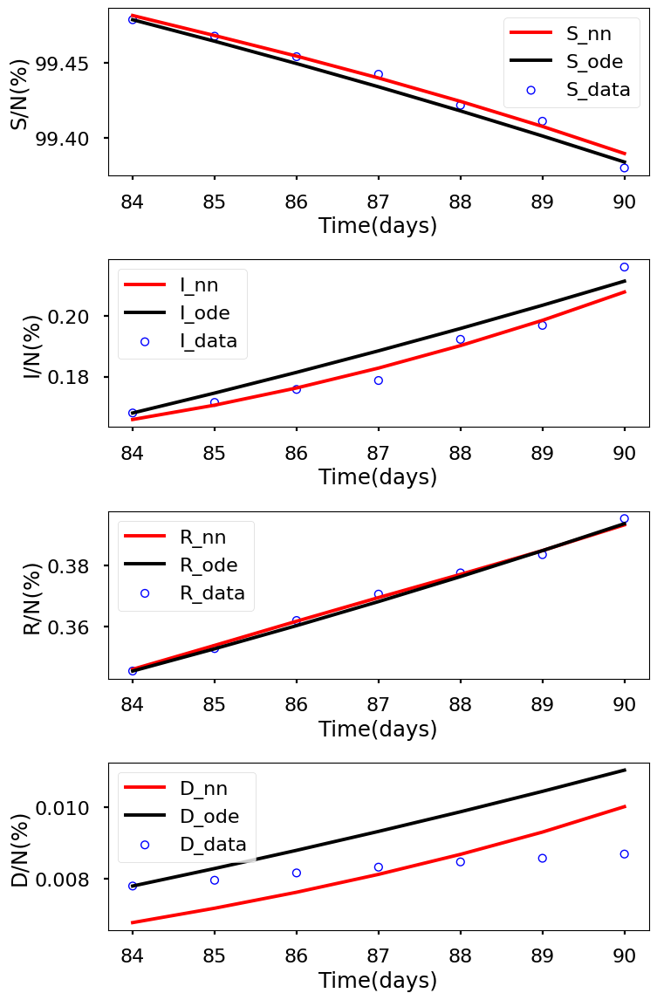

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.073e+00, GE_loss: 2.09028e+00,OB_loss: 9.82908e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 3.48, cumulative_time: 3.48
It: 10000, Loss: 7.425e-06, GE_loss: 1.96326e-06,OB_loss: 5.46205e-06, Beta: 1.03765e+00,gamma: 9.48228e-01,mu: 9.48116e-01, Time: 27.98, cumulative_time: 31.45
It: 20000, Loss: 6.079e-07, GE_loss: 4.19763e-07,OB_loss: 1.88182e-07, Beta: 3.11473e-01,gamma: 2.24475e-01,mu: 1.34089e-01, Time: 30.19, cumulative_time: 61.65
It: 30000, Loss: 2.687e-09, GE_loss: 9.32330e-10,OB_loss: 1.75429e-09, Beta: 8.05241e-02,gamma: 2.80541e-02,mu: 1.50524e-03, Time: 27.68, cumulative_time: 89.33
It: 40000, Loss: 2.717e-09, GE_loss: 9.52300e-10,OB_loss: 1.76468e-09, Beta: 8.04979e-02,gamma: 2.81262e-02,mu: 1.34637e-03, Time: 27.86, cumulative_time: 117.19
beta:  [0.08045616]
gamma:  [0.02818206]
mu:  [0.00119374]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


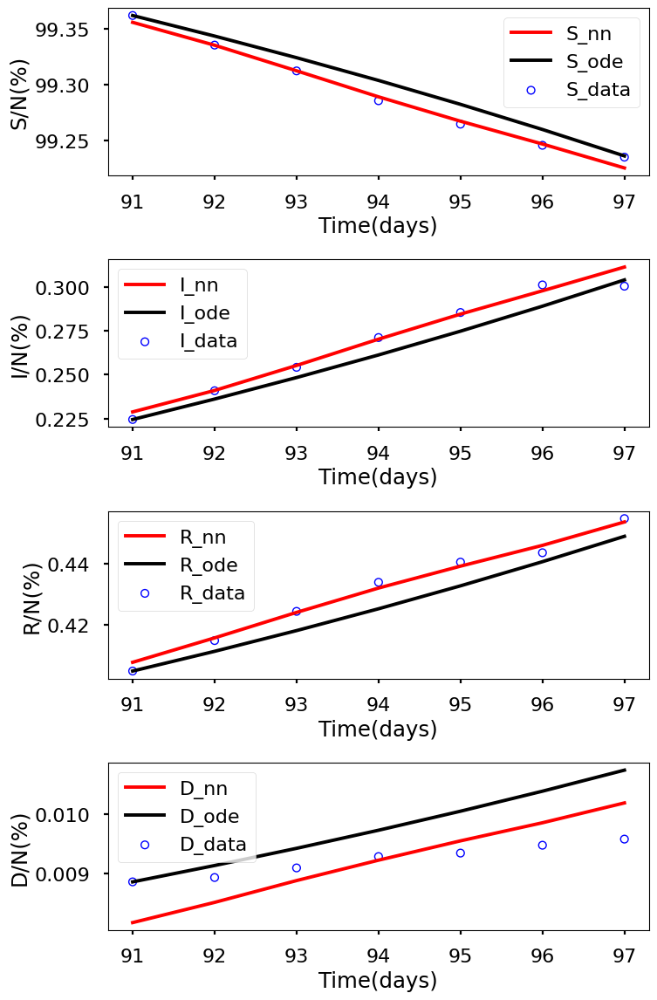

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.052e+00, GE_loss: 2.07326e+00,OB_loss: 9.78831e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 3.47, cumulative_time: 3.47
It: 10000, Loss: 1.113e-05, GE_loss: 3.27835e-06,OB_loss: 7.84692e-06, Beta: 1.04162e+00,gamma: 9.37036e-01,mu: 9.36837e-01, Time: 28.05, cumulative_time: 31.52
It: 20000, Loss: 3.193e-08, GE_loss: 5.83958e-09,OB_loss: 2.60939e-08, Beta: 7.93979e-02,gamma: 6.13378e-02,mu: 2.40566e-03, Time: 28.37, cumulative_time: 59.90
It: 30000, Loss: 4.032e-09, GE_loss: 6.23145e-10,OB_loss: 3.40865e-09, Beta: 7.14630e-02,gamma: 3.41619e-02,mu: 1.64588e-03, Time: 28.14, cumulative_time: 88.04
It: 40000, Loss: 3.953e-09, GE_loss: 6.55991e-10,OB_loss: 3.29695e-09, Beta: 7.14740e-02,gamma: 3.39972e-02,mu: 1.57249e-03, Time: 28.09, cumulative_time: 116.12
beta:  [0.07148174]
gamma:  [0.03383175]
mu:  [0.00150538]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


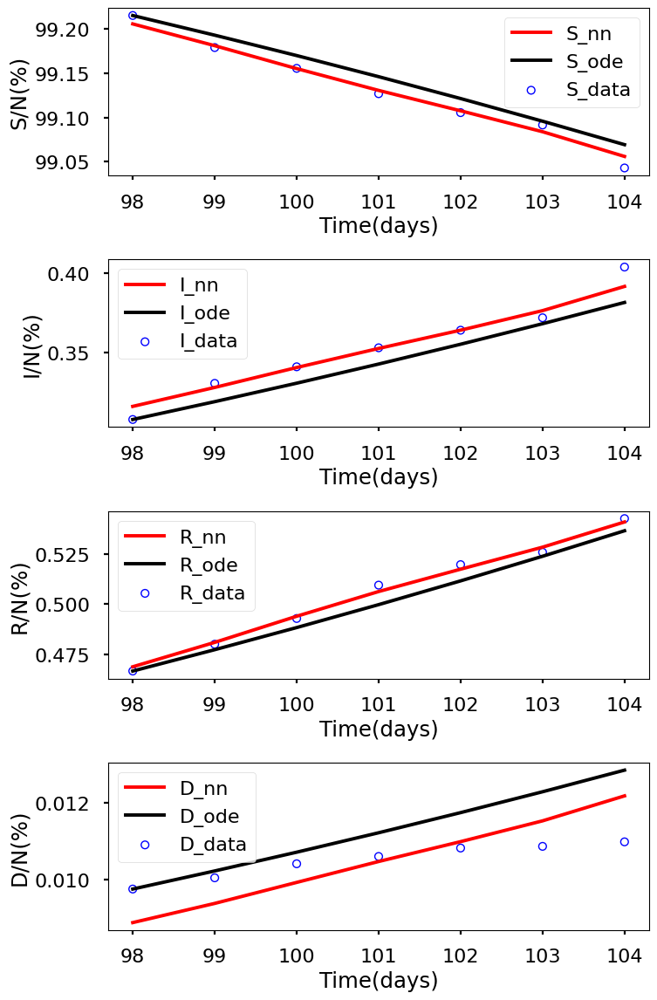

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.094e+00, GE_loss: 2.11804e+00,OB_loss: 9.76235e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 3.62, cumulative_time: 3.62
It: 10000, Loss: 1.785e-05, GE_loss: 5.52370e-06,OB_loss: 1.23289e-05, Beta: 1.04623e+00,gamma: 9.23253e-01,mu: 9.22472e-01, Time: 29.19, cumulative_time: 32.81
It: 20000, Loss: 5.074e-09, GE_loss: 1.24371e-09,OB_loss: 3.83040e-09, Beta: 7.42192e-02,gamma: 4.20040e-02,mu: 8.62217e-04, Time: 28.52, cumulative_time: 61.32
It: 30000, Loss: 4.130e-09, GE_loss: 1.14132e-09,OB_loss: 2.98839e-09, Beta: 7.30267e-02,gamma: 3.82666e-02,mu: 1.14689e-03, Time: 28.35, cumulative_time: 89.67
It: 40000, Loss: 4.044e-09, GE_loss: 1.19113e-09,OB_loss: 2.85265e-09, Beta: 7.30098e-02,gamma: 3.83416e-02,mu: 1.03918e-03, Time: 27.98, cumulative_time: 117.65
beta:  [0.07299979]
gamma:  [0.03843032]
mu:  [0.00096447]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


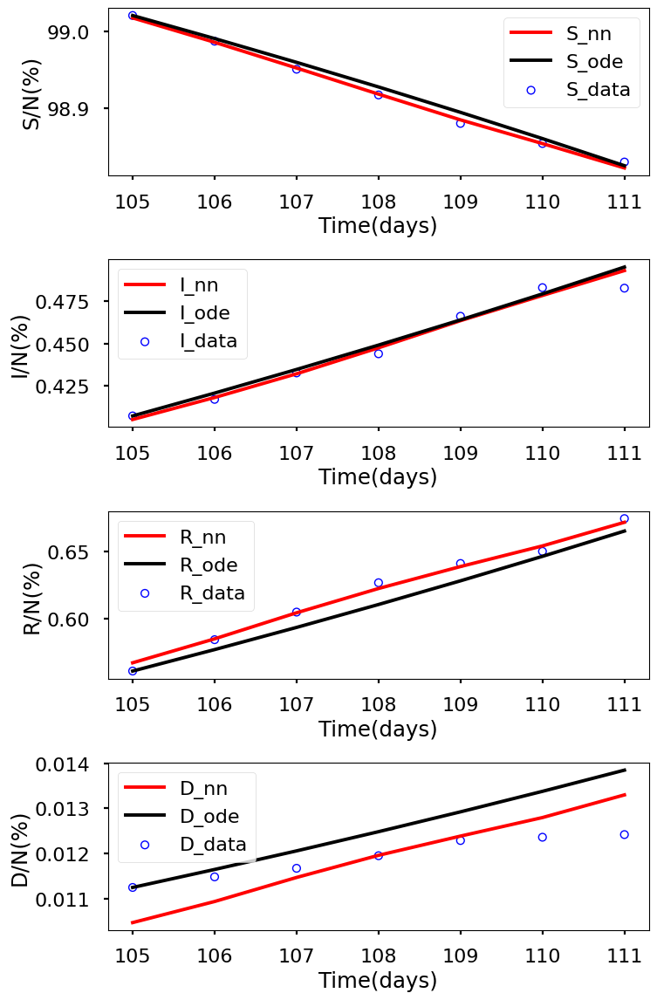

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.068e+00, GE_loss: 2.09611e+00,OB_loss: 9.71559e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 3.58, cumulative_time: 3.58
It: 10000, Loss: 2.351e-05, GE_loss: 7.03135e-06,OB_loss: 1.64795e-05, Beta: 1.04960e+00,gamma: 9.33855e-01,mu: 9.33290e-01, Time: 28.11, cumulative_time: 31.69
It: 20000, Loss: 1.126e-08, GE_loss: 2.63306e-09,OB_loss: 8.62840e-09, Beta: 6.99201e-02,gamma: 4.06098e-02,mu: 1.84240e-03, Time: 28.59, cumulative_time: 60.28
It: 30000, Loss: 7.058e-09, GE_loss: 1.56650e-09,OB_loss: 5.49162e-09, Beta: 6.90570e-02,gamma: 3.88453e-02,mu: 1.50952e-03, Time: 29.93, cumulative_time: 90.21
It: 40000, Loss: 6.345e-09, GE_loss: 1.85201e-09,OB_loss: 4.49263e-09, Beta: 6.86990e-02,gamma: 3.87153e-02,mu: 1.20003e-03, Time: 30.03, cumulative_time: 120.24
beta:  [0.06866369]
gamma:  [0.0387548]
mu:  [0.00099629]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


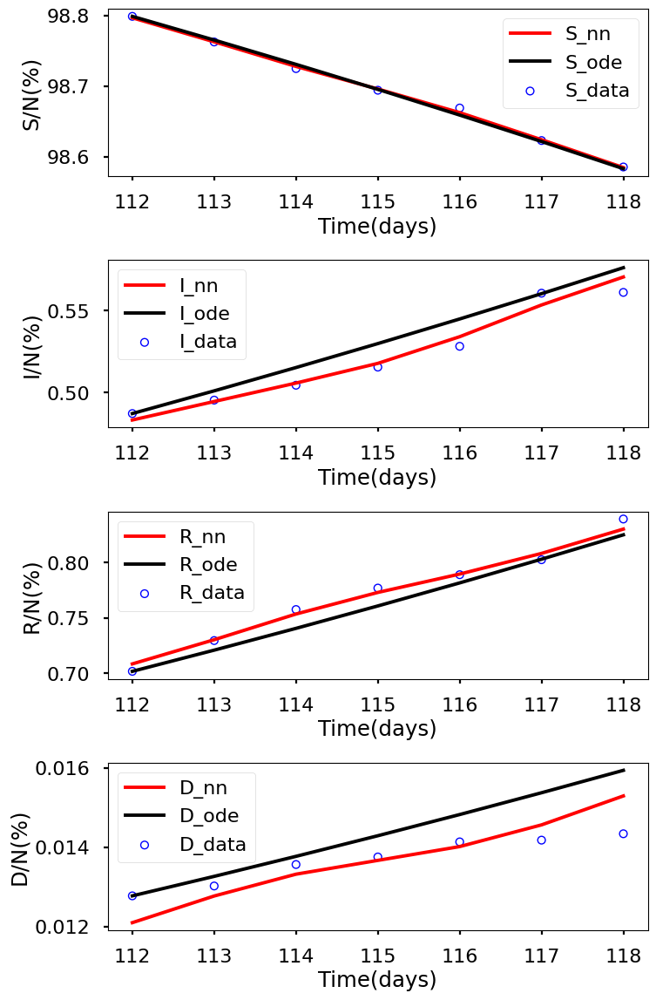

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.073e+00, GE_loss: 2.10522e+00,OB_loss: 9.68093e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 3.77, cumulative_time: 3.77
It: 10000, Loss: 2.775e-05, GE_loss: 8.47887e-06,OB_loss: 1.92715e-05, Beta: 1.04941e+00,gamma: 9.16591e-01,mu: 9.15776e-01, Time: 29.25, cumulative_time: 33.02
It: 20000, Loss: 1.410e-08, GE_loss: 1.42984e-09,OB_loss: 1.26706e-08, Beta: 5.56545e-02,gamma: 4.52856e-02,mu: 1.43993e-03, Time: 28.96, cumulative_time: 61.98
It: 30000, Loss: 1.088e-08, GE_loss: 2.72733e-09,OB_loss: 8.15167e-09, Beta: 5.47574e-02,gamma: 4.33806e-02,mu: 9.97179e-04, Time: 29.90, cumulative_time: 91.89
It: 40000, Loss: 1.016e-08, GE_loss: 3.30238e-09,OB_loss: 6.85371e-09, Beta: 5.45330e-02,gamma: 4.38463e-02,mu: 9.57632e-04, Time: 28.48, cumulative_time: 120.36
beta:  [0.05451953]
gamma:  [0.04394918]
mu:  [0.00081747]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


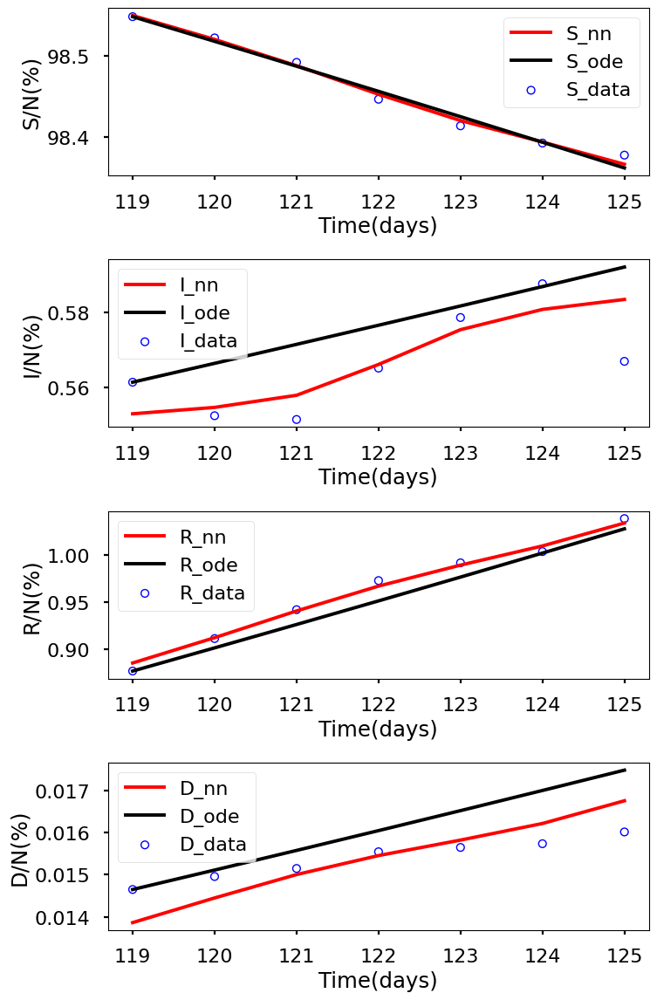

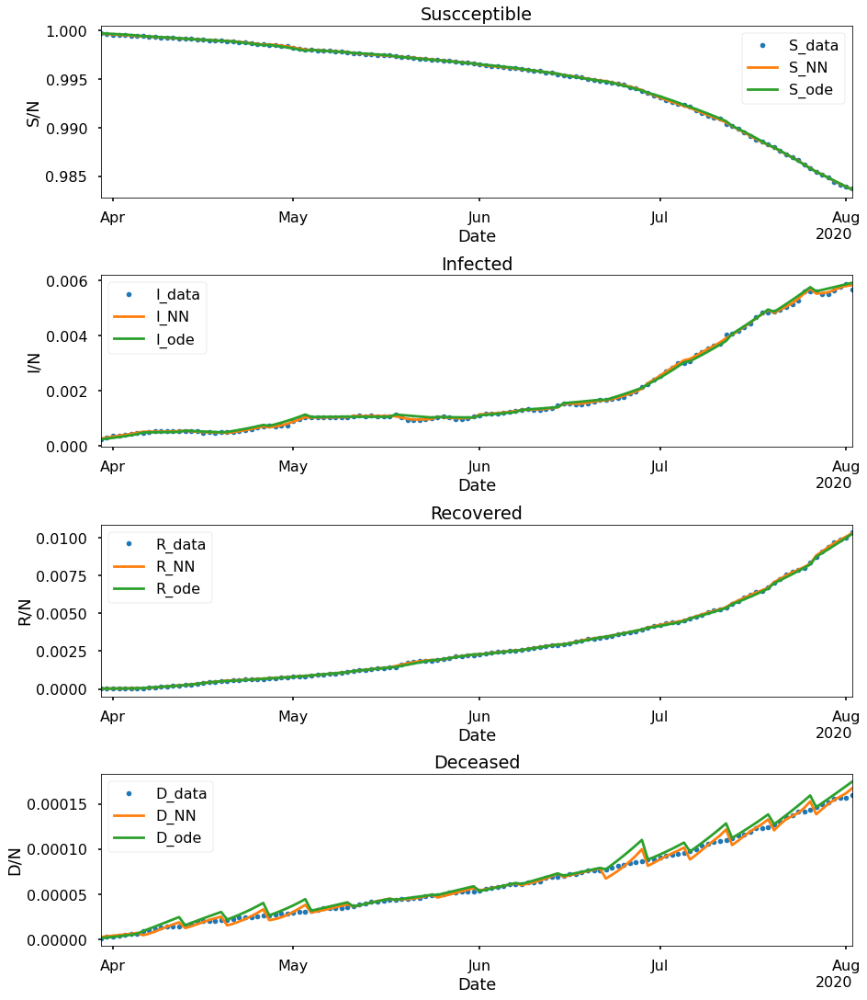

+---------------------+--------------+--------------+-------------+--------------+--------------+--------------+-------------+--------------+--------------+--------------+-------------+--------------+-------------+-------------+--------------+--------------+--------------+--------------+
|      Paramaters     |    Week 1    |    Week 2    |    Week 3   |    Week 4    |    Week 5    |    Week 6    |    Week 7   |    Week 8    |    Week 9    |   Week 10    |   Week 11   |   Week 12    |   Week 13   |   Week 14   |   Week 15    |   Week 16    |   Week 17    |   Week 18    |
+---------------------+--------------+--------------+-------------+--------------+--------------+--------------+-------------+--------------+--------------+--------------+-------------+--------------+-------------+-------------+--------------+--------------+--------------+--------------+
|         beta        |  0.10619208  |  0.0680229   |  0.06741188 |  0.10911419  |  0.10738912  | 0.038078796  | 0.039625827 | 0.0529

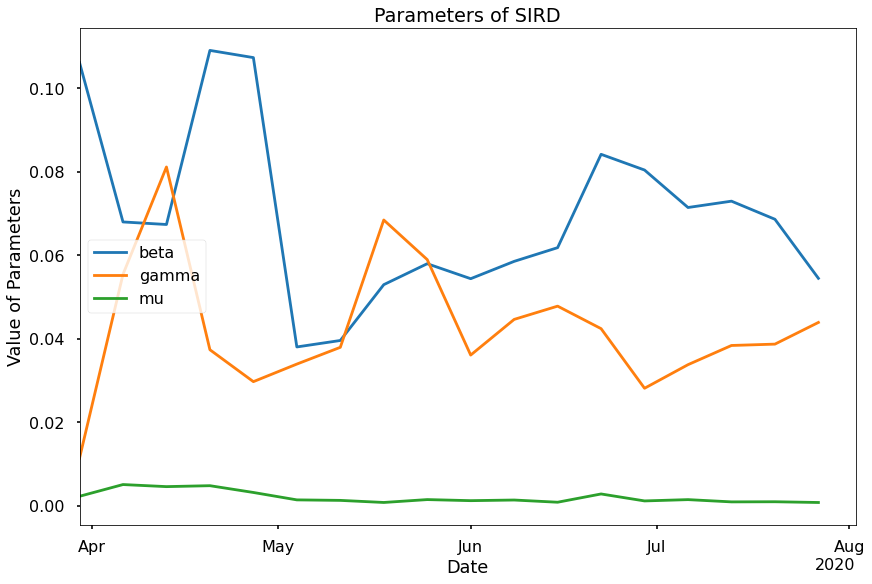

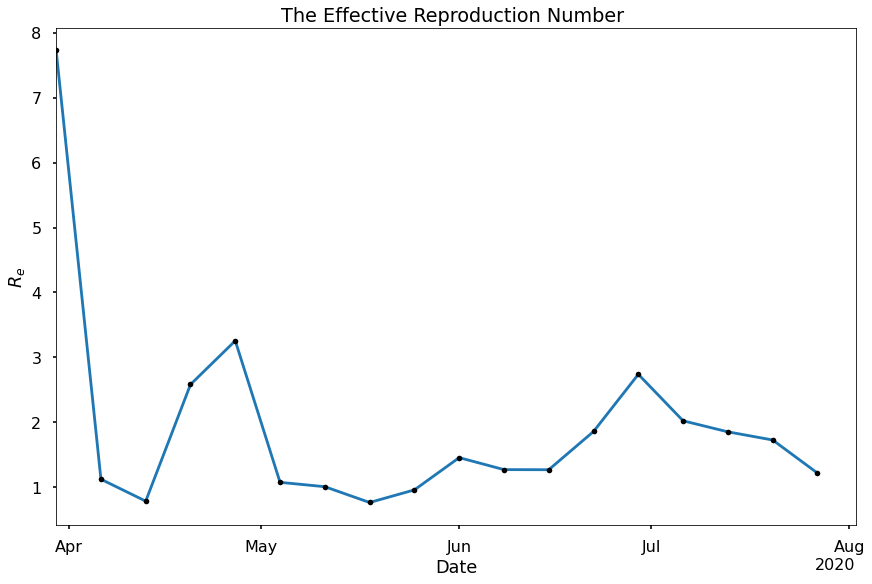

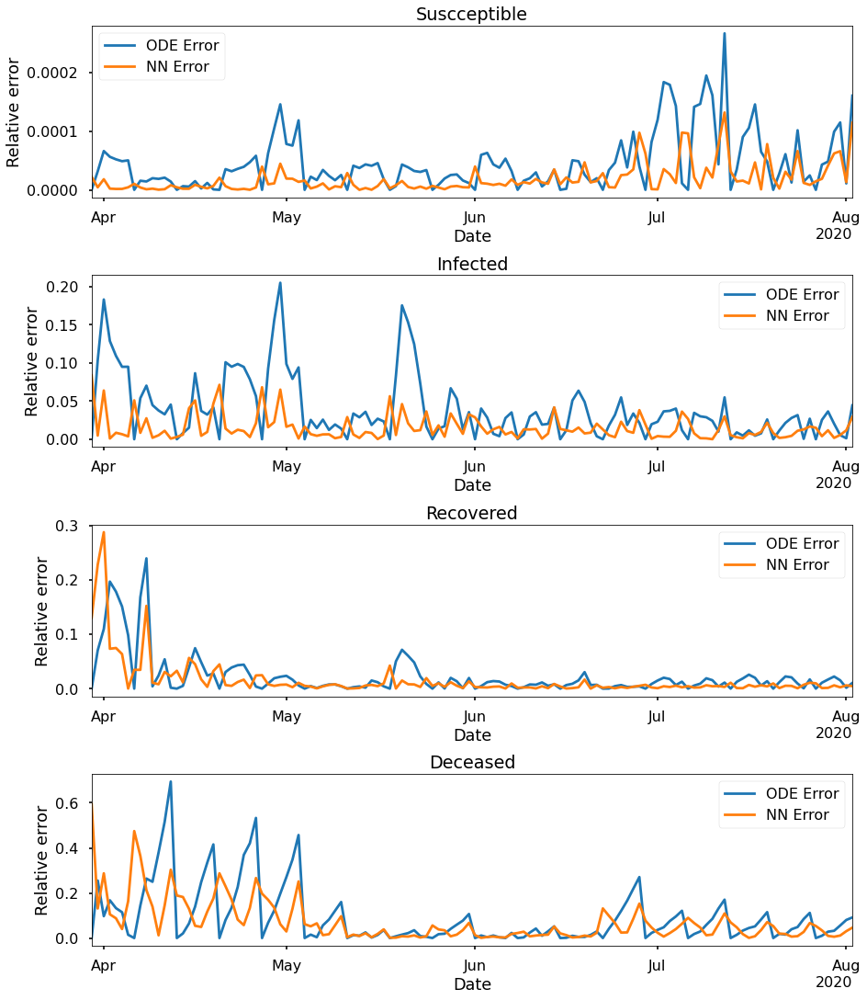

In [ ]:
layers516 = [1,16,16,16,16,16,4]
S516_ode,I516_ode,R516_ode,D516_ode,S516_learned,I516_learned,R516_learned,D516_learned,beta516,gamma516,mu516,S_errnn516,I_errnn516,R_errnn516,D_errnn516,S_erode516,I_errode516,R_errode516,D_errode516,time516 = sum_all(
    layers516,length,SS,II,RC,DC,N0,0.1,50000)

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.110e+00, GE_loss: 2.11249e+00,OB_loss: 9.97306e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 3.52, cumulative_time: 3.52
It: 10000, Loss: 7.234e-07, GE_loss: 2.55546e-07,OB_loss: 4.67835e-07, Beta: 1.05562e+00,gamma: 9.41564e-01,mu: 9.41836e-01, Time: 23.02, cumulative_time: 26.54
It: 20000, Loss: 1.242e-07, GE_loss: 3.44704e-08,OB_loss: 8.97175e-08, Beta: 1.06682e+00,gamma: 9.31141e-01,mu: 9.31185e-01, Time: 23.02, cumulative_time: 49.56
It: 30000, Loss: 9.505e-10, GE_loss: 1.15734e-10,OB_loss: 8.34727e-10, Beta: 1.07964e-01,gamma: 1.64026e-02,mu: 5.75939e-03, Time: 22.92, cumulative_time: 72.49
It: 40000, Loss: 6.731e-10, GE_loss: 2.67451e-11,OB_loss: 6.46357e-10, Beta: 1.04575e-01,gamma: 1.24478e-02,mu: 2.85664e-03, Time: 22.98, cumulative_time: 95.47
beta:  [0.10466063]
gamma:  [0.01249724]
mu:  [0.00280102]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


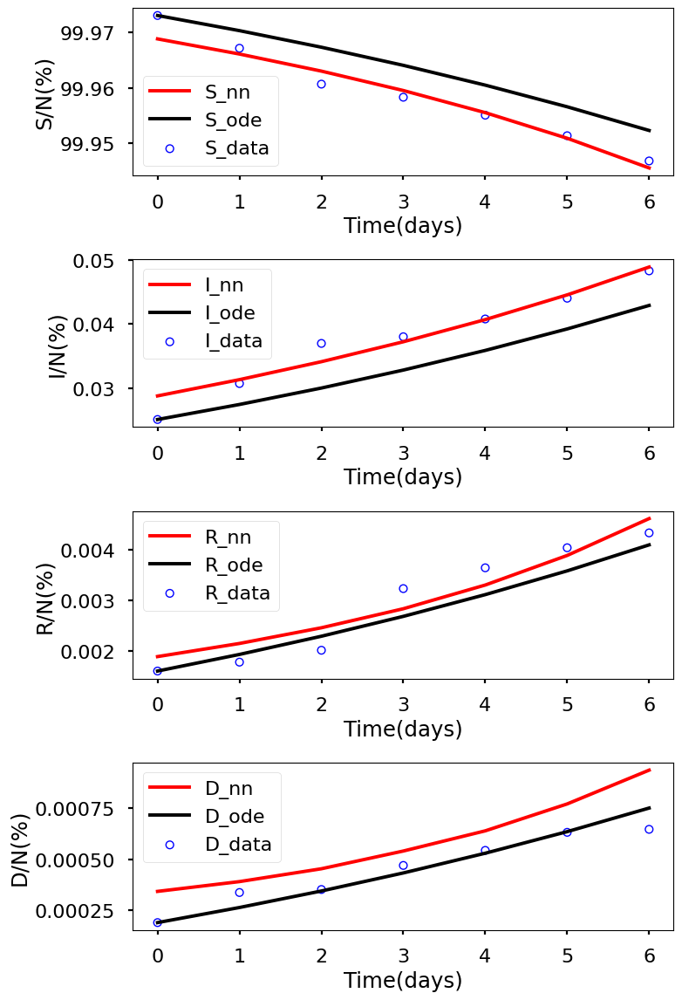

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.094e+00, GE_loss: 2.10005e+00,OB_loss: 9.93938e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 3.50, cumulative_time: 3.50
It: 10000, Loss: 7.249e-07, GE_loss: 2.74464e-07,OB_loss: 4.50387e-07, Beta: 1.05404e+00,gamma: 9.42334e-01,mu: 9.42239e-01, Time: 23.61, cumulative_time: 27.11
It: 20000, Loss: 2.365e-07, GE_loss: 6.64837e-08,OB_loss: 1.70032e-07, Beta: 1.07015e+00,gamma: 9.23762e-01,mu: 9.22363e-01, Time: 22.90, cumulative_time: 50.01
It: 30000, Loss: 7.839e-10, GE_loss: 2.63851e-10,OB_loss: 5.20068e-10, Beta: 6.47444e-02,gamma: 4.89762e-02,mu: 5.21311e-03, Time: 22.89, cumulative_time: 72.90
It: 40000, Loss: 5.454e-10, GE_loss: 2.02694e-10,OB_loss: 3.42697e-10, Beta: 6.58816e-02,gamma: 5.20764e-02,mu: 5.00504e-03, Time: 22.95, cumulative_time: 95.85
beta:  [0.06496852]
gamma:  [0.05354372]
mu:  [0.0050271]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


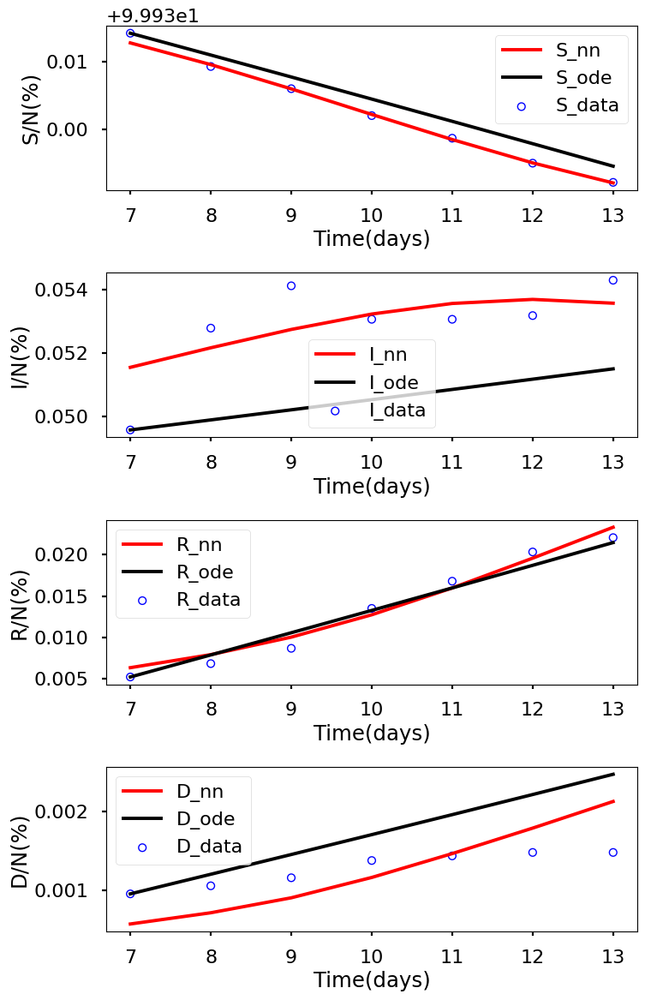

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.070e+00, GE_loss: 2.07125e+00,OB_loss: 9.99077e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 3.50, cumulative_time: 3.50
It: 10000, Loss: 7.148e-07, GE_loss: 3.67373e-07,OB_loss: 3.47406e-07, Beta: 1.06059e+00,gamma: 9.35306e-01,mu: 9.35118e-01, Time: 22.92, cumulative_time: 26.43
It: 20000, Loss: 2.227e-07, GE_loss: 6.70776e-08,OB_loss: 1.55663e-07, Beta: 1.07280e+00,gamma: 9.17511e-01,mu: 9.14540e-01, Time: 23.09, cumulative_time: 49.52
It: 30000, Loss: 1.143e-09, GE_loss: 2.89046e-10,OB_loss: 8.53486e-10, Beta: 6.54161e-02,gamma: 7.66198e-02,mu: 3.90538e-03, Time: 22.90, cumulative_time: 72.42
It: 40000, Loss: 8.167e-10, GE_loss: 1.67783e-10,OB_loss: 6.48915e-10, Beta: 6.55199e-02,gamma: 8.03352e-02,mu: 2.62724e-03, Time: 22.66, cumulative_time: 95.08
beta:  [0.06575526]
gamma:  [0.08349584]
mu:  [0.00160359]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


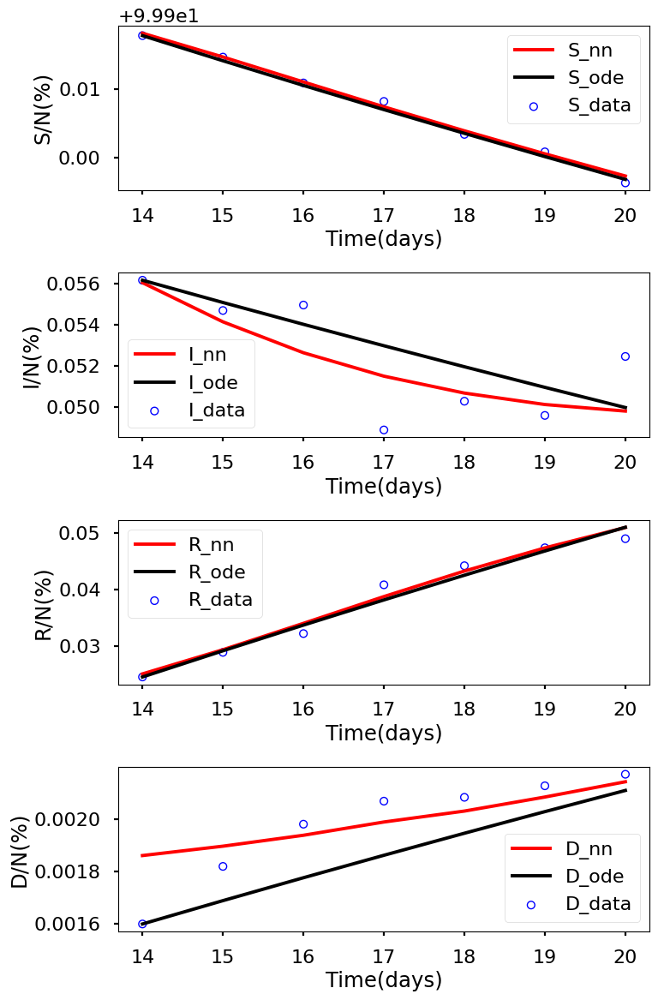

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.091e+00, GE_loss: 2.09519e+00,OB_loss: 9.95368e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 3.53, cumulative_time: 3.53
It: 10000, Loss: 6.617e-07, GE_loss: 2.61388e-07,OB_loss: 4.00301e-07, Beta: 1.05682e+00,gamma: 9.40553e-01,mu: 9.40975e-01, Time: 22.48, cumulative_time: 26.01
It: 20000, Loss: 2.828e-07, GE_loss: 8.49001e-08,OB_loss: 1.97911e-07, Beta: 1.08200e+00,gamma: 9.17089e-01,mu: 9.13147e-01, Time: 22.41, cumulative_time: 48.42
It: 30000, Loss: 2.567e-10, GE_loss: 3.98763e-11,OB_loss: 2.16784e-10, Beta: 1.10589e-01,gamma: 3.83481e-02,mu: 3.56135e-03, Time: 22.87, cumulative_time: 71.29
It: 40000, Loss: 2.181e-10, GE_loss: 1.42238e-11,OB_loss: 2.03852e-10, Beta: 1.10105e-01,gamma: 3.84136e-02,mu: 2.81989e-03, Time: 22.87, cumulative_time: 94.17
beta:  [0.10999347]
gamma:  [0.03843033]
mu:  [0.00266495]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


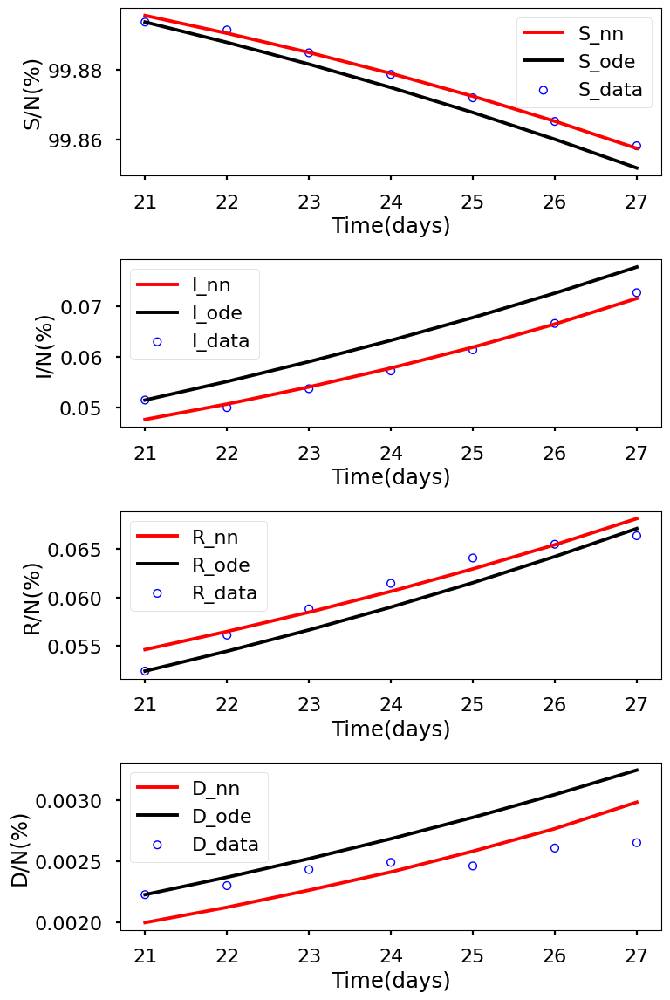

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.116e+00, GE_loss: 2.11401e+00,OB_loss: 1.00169e+00, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 3.67, cumulative_time: 3.67
It: 10000, Loss: 9.154e-07, GE_loss: 4.45347e-07,OB_loss: 4.70023e-07, Beta: 1.06169e+00,gamma: 9.32588e-01,mu: 9.32939e-01, Time: 22.73, cumulative_time: 26.40
It: 20000, Loss: 5.640e-07, GE_loss: 1.73096e-07,OB_loss: 3.90882e-07, Beta: 1.09994e+00,gamma: 8.87087e-01,mu: 8.79702e-01, Time: 22.80, cumulative_time: 49.19
It: 30000, Loss: 2.065e-09, GE_loss: 1.88221e-10,OB_loss: 1.87659e-09, Beta: 1.14147e-01,gamma: 3.20744e-02,mu: 4.10645e-03, Time: 24.54, cumulative_time: 73.74
It: 40000, Loss: 1.973e-09, GE_loss: 2.02053e-10,OB_loss: 1.77063e-09, Beta: 1.12988e-01,gamma: 3.15236e-02,mu: 3.46473e-03, Time: 24.00, cumulative_time: 97.73
beta:  [0.10795343]
gamma:  [0.02941636]
mu:  [0.00321287]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


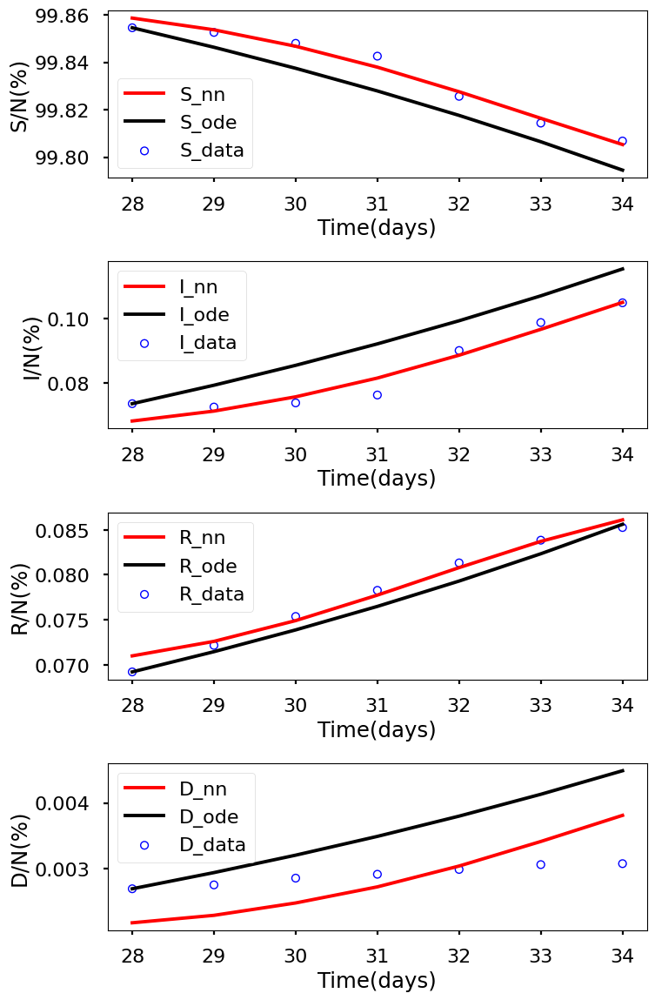

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.046e+00, GE_loss: 2.05065e+00,OB_loss: 9.95287e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 3.65, cumulative_time: 3.65
It: 10000, Loss: 1.142e-06, GE_loss: 3.56791e-07,OB_loss: 7.85364e-07, Beta: 1.05676e+00,gamma: 9.41253e-01,mu: 9.41352e-01, Time: 23.14, cumulative_time: 26.79
It: 20000, Loss: 8.729e-07, GE_loss: 2.75344e-07,OB_loss: 5.97536e-07, Beta: 1.06768e+00,gamma: 8.67945e-01,mu: 8.58128e-01, Time: 25.83, cumulative_time: 52.62
It: 30000, Loss: 1.390e-10, GE_loss: 1.60252e-11,OB_loss: 1.22985e-10, Beta: 3.92877e-02,gamma: 3.37059e-02,mu: 3.07495e-03, Time: 28.43, cumulative_time: 81.05
It: 40000, Loss: 1.059e-10, GE_loss: 1.02849e-11,OB_loss: 9.55853e-11, Beta: 3.83768e-02,gamma: 3.38940e-02,mu: 1.99964e-03, Time: 23.49, cumulative_time: 104.54
beta:  [0.03814654]
gamma:  [0.03399337]
mu:  [0.0016369]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


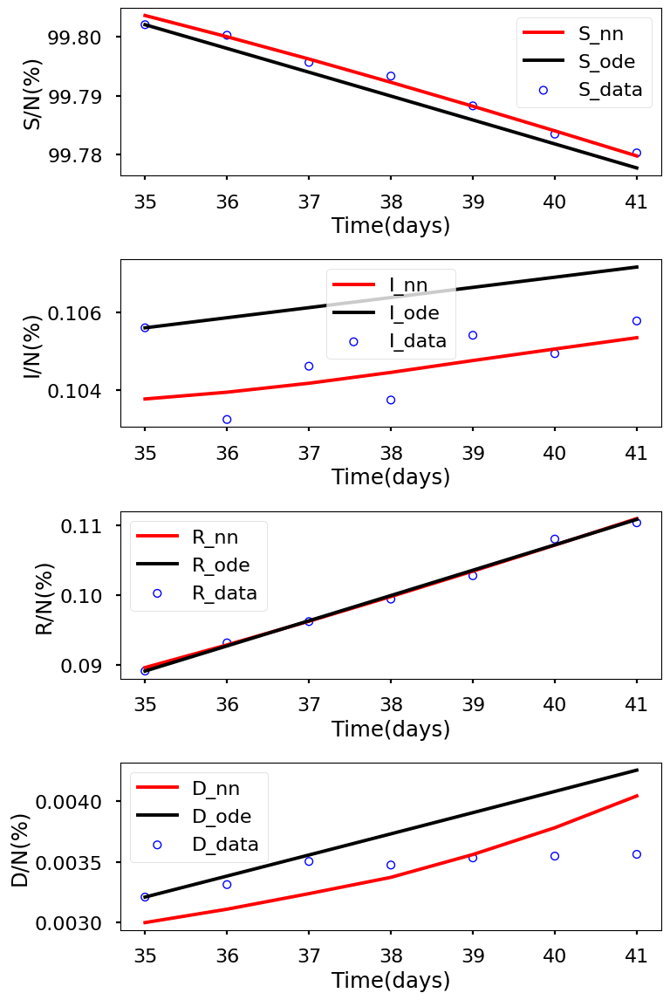

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.060e+00, GE_loss: 2.06774e+00,OB_loss: 9.92421e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 3.71, cumulative_time: 3.71
It: 10000, Loss: 1.367e-06, GE_loss: 5.16178e-07,OB_loss: 8.50782e-07, Beta: 1.05895e+00,gamma: 9.34700e-01,mu: 9.34931e-01, Time: 23.22, cumulative_time: 26.94
It: 20000, Loss: 9.526e-07, GE_loss: 3.04124e-07,OB_loss: 6.48429e-07, Beta: 1.06137e+00,gamma: 8.59183e-01,mu: 8.46860e-01, Time: 23.25, cumulative_time: 50.18
It: 30000, Loss: 3.018e-10, GE_loss: 2.69348e-11,OB_loss: 2.74886e-10, Beta: 3.96526e-02,gamma: 3.77927e-02,mu: 1.49122e-03, Time: 24.05, cumulative_time: 74.24
It: 40000, Loss: 2.795e-10, GE_loss: 1.96158e-11,OB_loss: 2.59913e-10, Beta: 3.96099e-02,gamma: 3.79609e-02,mu: 1.33599e-03, Time: 22.92, cumulative_time: 97.16
beta:  [0.03960519]
gamma:  [0.03804754]
mu:  [0.00128002]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


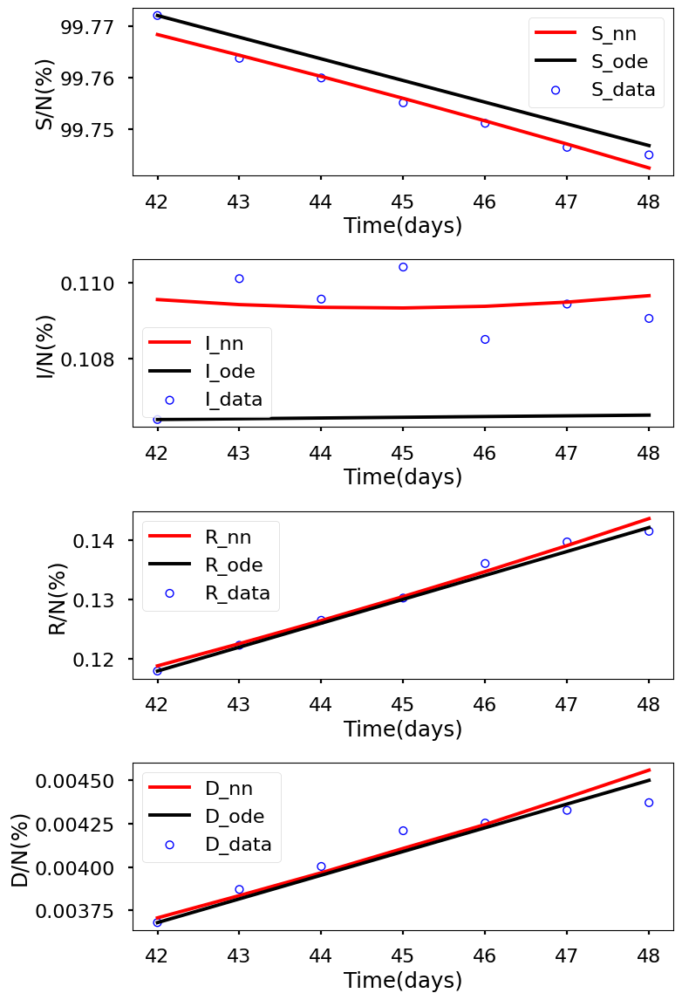

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.101e+00, GE_loss: 2.10771e+00,OB_loss: 9.93145e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 3.81, cumulative_time: 3.81
It: 10000, Loss: 1.141e-06, GE_loss: 5.54749e-07,OB_loss: 5.86286e-07, Beta: 1.06351e+00,gamma: 9.29959e-01,mu: 9.29810e-01, Time: 24.80, cumulative_time: 28.61
It: 20000, Loss: 7.851e-07, GE_loss: 2.49392e-07,OB_loss: 5.35716e-07, Beta: 1.07425e+00,gamma: 8.70560e-01,mu: 8.57525e-01, Time: 23.11, cumulative_time: 51.73
It: 30000, Loss: 2.738e-09, GE_loss: 9.90991e-10,OB_loss: 1.74715e-09, Beta: 5.34765e-02,gamma: 6.80858e-02,mu: 1.77232e-03, Time: 22.74, cumulative_time: 74.46
It: 40000, Loss: 2.710e-09, GE_loss: 9.92720e-10,OB_loss: 1.71720e-09, Beta: 5.33181e-02,gamma: 6.84346e-02,mu: 1.49111e-03, Time: 22.77, cumulative_time: 97.23
beta:  [0.05284451]
gamma:  [0.06842071]
mu:  [0.00114753]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


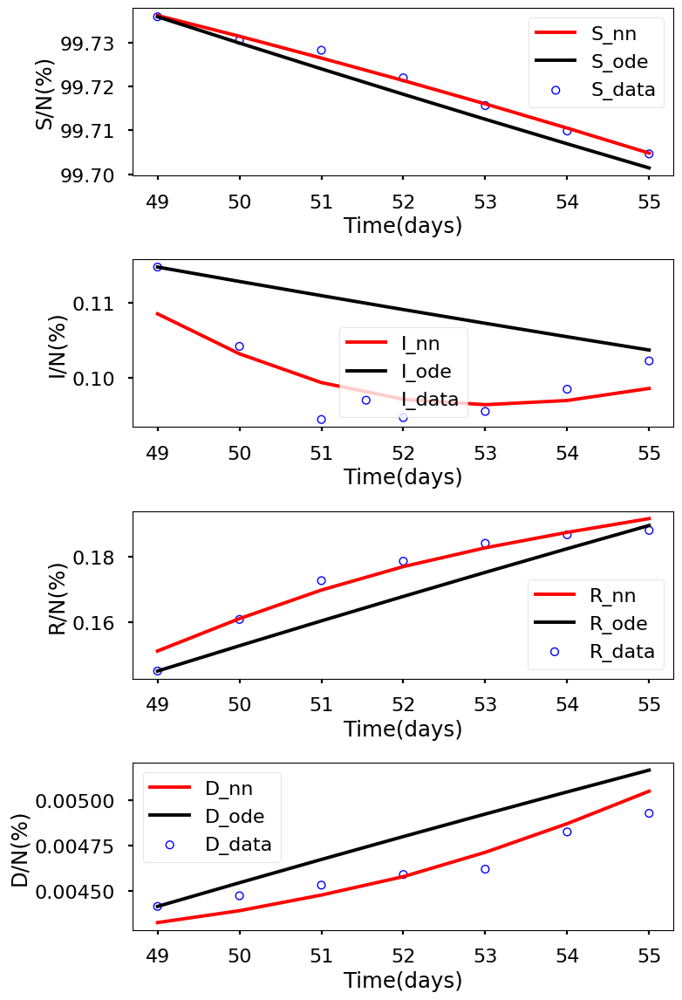

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.117e+00, GE_loss: 2.12385e+00,OB_loss: 9.92730e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 3.75, cumulative_time: 3.75
It: 10000, Loss: 1.238e-06, GE_loss: 4.31479e-07,OB_loss: 8.06465e-07, Beta: 1.05789e+00,gamma: 9.39681e-01,mu: 9.39409e-01, Time: 23.27, cumulative_time: 27.02
It: 20000, Loss: 8.375e-07, GE_loss: 2.66088e-07,OB_loss: 5.71374e-07, Beta: 1.07507e+00,gamma: 8.72770e-01,mu: 8.59592e-01, Time: 22.75, cumulative_time: 49.77
It: 30000, Loss: 1.286e-09, GE_loss: 2.89185e-10,OB_loss: 9.96662e-10, Beta: 5.92856e-02,gamma: 5.86542e-02,mu: 5.31121e-03, Time: 22.76, cumulative_time: 72.53
It: 40000, Loss: 1.186e-09, GE_loss: 3.36562e-10,OB_loss: 8.49133e-10, Beta: 5.83169e-02,gamma: 5.90898e-02,mu: 2.57046e-03, Time: 22.98, cumulative_time: 95.51
beta:  [0.05801637]
gamma:  [0.05921345]
mu:  [0.00142609]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


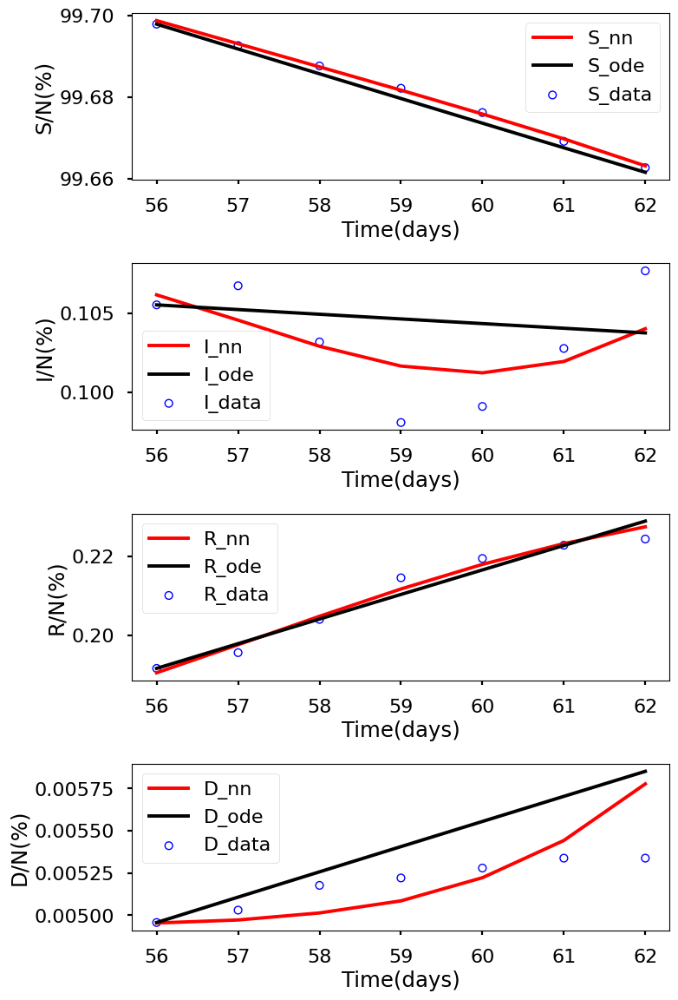

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.087e+00, GE_loss: 2.09815e+00,OB_loss: 9.89049e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 4.05, cumulative_time: 4.05
It: 10000, Loss: 1.481e-06, GE_loss: 5.30860e-07,OB_loss: 9.49721e-07, Beta: 1.05774e+00,gamma: 9.38896e-01,mu: 9.38402e-01, Time: 23.45, cumulative_time: 27.50
It: 20000, Loss: 1.123e-06, GE_loss: 3.62323e-07,OB_loss: 7.60708e-07, Beta: 1.07084e+00,gamma: 8.42937e-01,mu: 8.26880e-01, Time: 23.90, cumulative_time: 51.40
It: 30000, Loss: 5.501e-10, GE_loss: 7.70167e-11,OB_loss: 4.73039e-10, Beta: 5.49788e-02,gamma: 3.50806e-02,mu: 3.51327e-03, Time: 23.81, cumulative_time: 75.21
It: 40000, Loss: 5.195e-10, GE_loss: 8.84852e-11,OB_loss: 4.30971e-10, Beta: 5.46922e-02,gamma: 3.57179e-02,mu: 1.94726e-03, Time: 23.53, cumulative_time: 98.74
beta:  [0.05459055]
gamma:  [0.03587056]
mu:  [0.00137085]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


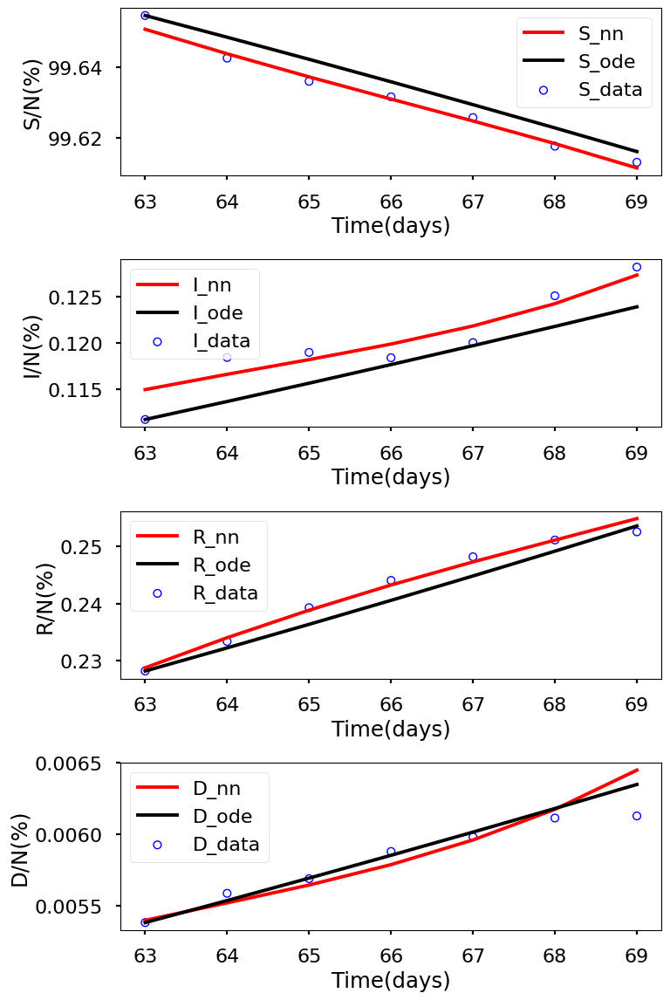

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.065e+00, GE_loss: 2.07354e+00,OB_loss: 9.91317e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 3.88, cumulative_time: 3.88
It: 10000, Loss: 1.799e-06, GE_loss: 6.42647e-07,OB_loss: 1.15594e-06, Beta: 1.06153e+00,gamma: 9.32632e-01,mu: 9.33017e-01, Time: 22.97, cumulative_time: 26.85
It: 20000, Loss: 1.358e-06, GE_loss: 4.54769e-07,OB_loss: 9.03096e-07, Beta: 1.05949e+00,gamma: 8.17765e-01,mu: 7.94930e-01, Time: 23.28, cumulative_time: 50.13
It: 30000, Loss: 1.391e-09, GE_loss: 3.76855e-10,OB_loss: 1.01426e-09, Beta: 5.96456e-02,gamma: 4.43526e-02,mu: 3.91573e-03, Time: 23.56, cumulative_time: 73.70
It: 40000, Loss: 8.120e-10, GE_loss: 1.83604e-10,OB_loss: 6.28396e-10, Beta: 5.87909e-02,gamma: 4.43053e-02,mu: 2.47572e-03, Time: 23.08, cumulative_time: 96.78
beta:  [0.05843589]
gamma:  [0.04450401]
mu:  [0.00161344]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


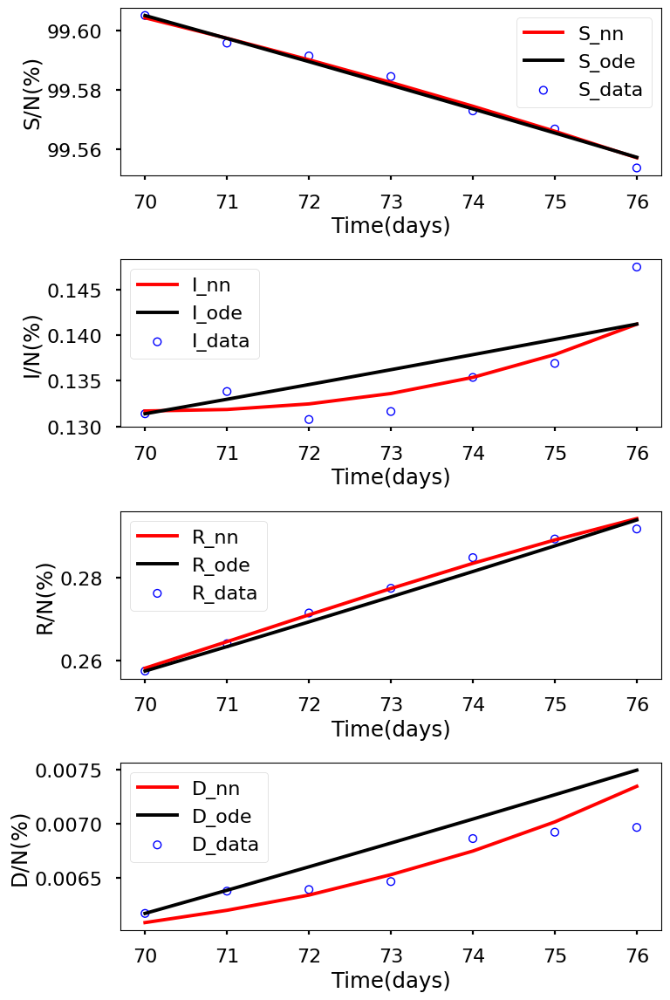

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.069e+00, GE_loss: 2.08187e+00,OB_loss: 9.87115e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 3.91, cumulative_time: 3.91
It: 10000, Loss: 2.278e-06, GE_loss: 6.88436e-07,OB_loss: 1.58919e-06, Beta: 1.05624e+00,gamma: 9.40381e-01,mu: 9.40238e-01, Time: 22.39, cumulative_time: 26.30
It: 20000, Loss: 1.735e-06, GE_loss: 6.10621e-07,OB_loss: 1.12446e-06, Beta: 1.03604e+00,gamma: 7.66807e-01,mu: 7.39741e-01, Time: 22.24, cumulative_time: 48.55
It: 30000, Loss: 2.616e-09, GE_loss: 5.99090e-10,OB_loss: 2.01658e-09, Beta: 6.25584e-02,gamma: 4.74665e-02,mu: 3.18120e-03, Time: 25.01, cumulative_time: 73.56
It: 40000, Loss: 2.477e-09, GE_loss: 5.78479e-10,OB_loss: 1.89843e-09, Beta: 6.15597e-02,gamma: 4.75078e-02,mu: 1.74028e-03, Time: 23.19, cumulative_time: 96.74
beta:  [0.06138106]
gamma:  [0.04768962]
mu:  [0.00129458]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


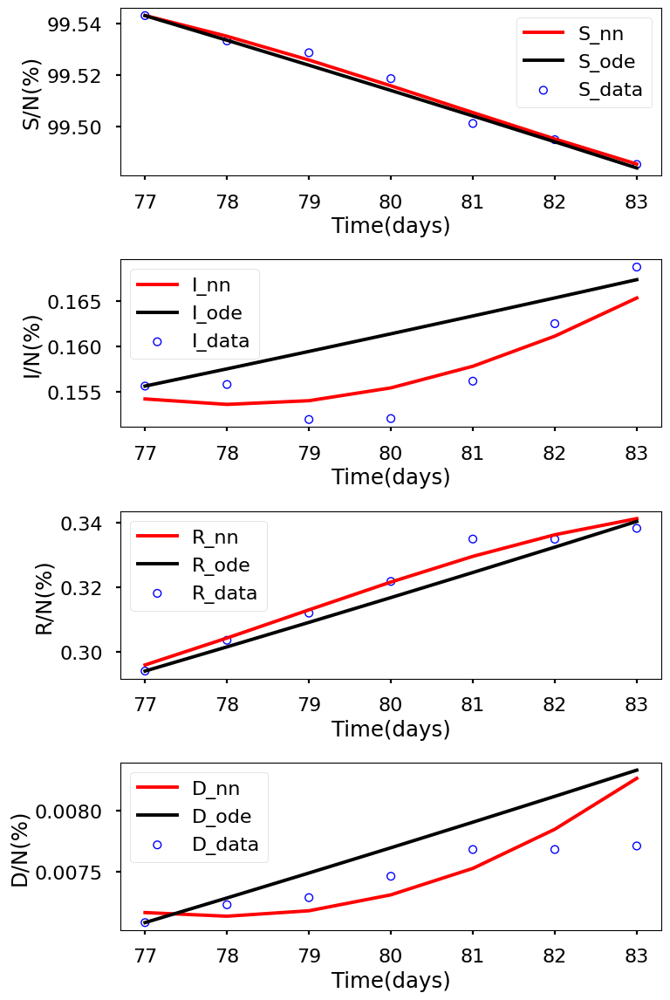

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.093e+00, GE_loss: 2.10608e+00,OB_loss: 9.86722e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 3.87, cumulative_time: 3.87
It: 10000, Loss: 2.971e-06, GE_loss: 9.07511e-07,OB_loss: 2.06309e-06, Beta: 1.06255e+00,gamma: 9.33353e-01,mu: 9.33300e-01, Time: 22.64, cumulative_time: 26.50
It: 20000, Loss: 2.167e-06, GE_loss: 8.19594e-07,OB_loss: 1.34717e-06, Beta: 9.97032e-01,gamma: 7.00302e-01,mu: 6.67425e-01, Time: 22.84, cumulative_time: 49.34
It: 30000, Loss: 2.230e-09, GE_loss: 7.36835e-10,OB_loss: 1.49326e-09, Beta: 8.40933e-02,gamma: 4.22804e-02,mu: 2.35168e-03, Time: 24.15, cumulative_time: 73.49
It: 40000, Loss: 1.359e-09, GE_loss: 1.94526e-10,OB_loss: 1.16400e-09, Beta: 8.38215e-02,gamma: 4.26843e-02,mu: 1.20774e-03, Time: 23.41, cumulative_time: 96.91
beta:  [0.0837631]
gamma:  [0.04279863]
mu:  [0.00094888]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


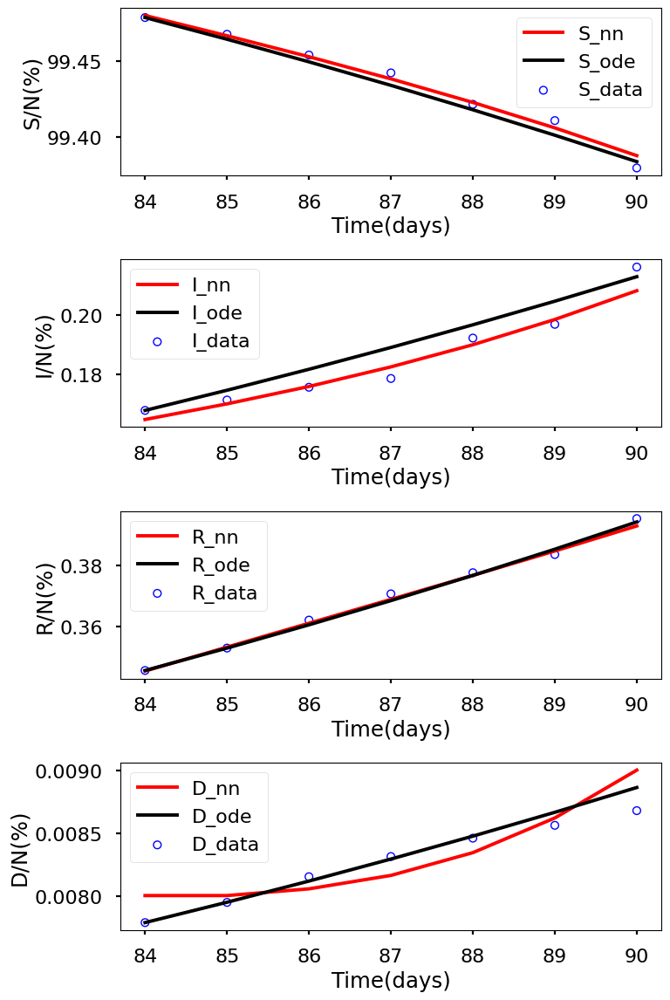

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.061e+00, GE_loss: 2.07373e+00,OB_loss: 9.87202e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 4.07, cumulative_time: 4.07
It: 10000, Loss: 6.432e-06, GE_loss: 1.57308e-06,OB_loss: 4.85940e-06, Beta: 1.05461e+00,gamma: 9.43718e-01,mu: 9.43142e-01, Time: 22.84, cumulative_time: 26.90
It: 20000, Loss: 9.590e-07, GE_loss: 6.51535e-07,OB_loss: 3.07420e-07, Beta: 3.81953e-01,gamma: 2.61701e-01,mu: 1.98512e-01, Time: 23.74, cumulative_time: 50.65
It: 30000, Loss: 3.087e-09, GE_loss: 8.59303e-10,OB_loss: 2.22803e-09, Beta: 8.12381e-02,gamma: 2.74922e-02,mu: 3.20451e-03, Time: 22.81, cumulative_time: 73.46
It: 40000, Loss: 3.118e-09, GE_loss: 1.11215e-09,OB_loss: 2.00612e-09, Beta: 8.03528e-02,gamma: 2.82833e-02,mu: 9.87274e-04, Time: 23.30, cumulative_time: 96.76
beta:  [0.08038416]
gamma:  [0.028287]
mu:  [0.00080901]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


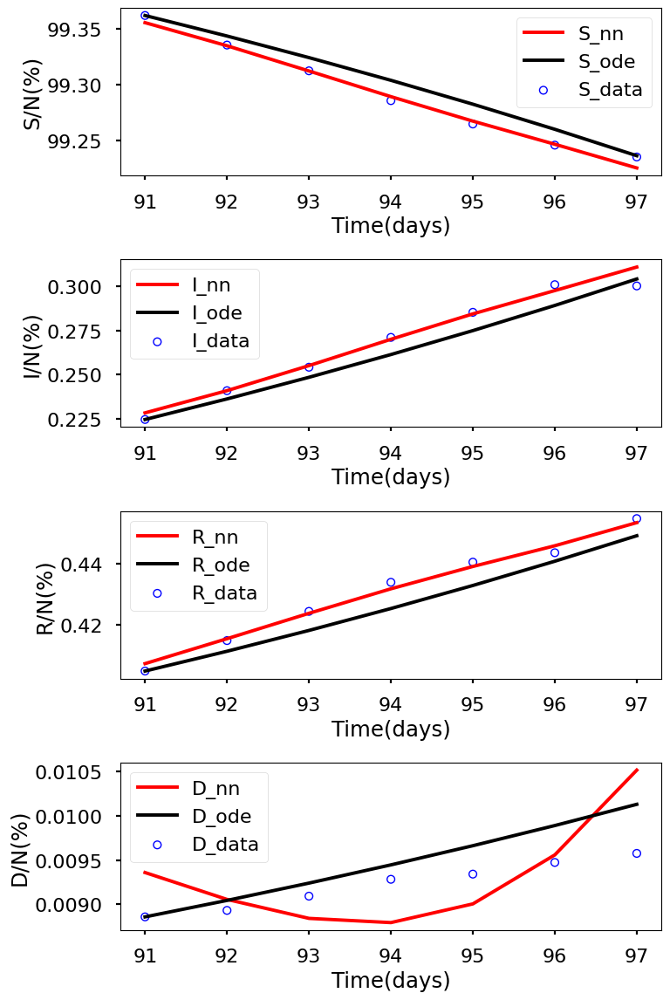

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.059e+00, GE_loss: 2.07494e+00,OB_loss: 9.84347e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 4.06, cumulative_time: 4.06
It: 10000, Loss: 1.060e-05, GE_loss: 2.91123e-06,OB_loss: 7.69228e-06, Beta: 1.06196e+00,gamma: 9.33176e-01,mu: 9.31816e-01, Time: 26.03, cumulative_time: 30.10
It: 20000, Loss: 2.337e-08, GE_loss: 1.16132e-08,OB_loss: 1.17613e-08, Beta: 9.37201e-02,gamma: 5.76631e-02,mu: 1.33890e-02, Time: 23.63, cumulative_time: 53.73
It: 30000, Loss: 5.261e-09, GE_loss: 5.79417e-11,OB_loss: 5.20336e-09, Beta: 7.01463e-02,gamma: 3.34710e-02,mu: 1.42137e-03, Time: 23.49, cumulative_time: 77.21
It: 40000, Loss: 4.915e-09, GE_loss: 2.12013e-10,OB_loss: 4.70283e-09, Beta: 7.01309e-02,gamma: 3.35171e-02,mu: 1.20482e-03, Time: 23.21, cumulative_time: 100.42
beta:  [0.07126087]
gamma:  [0.03433404]
mu:  [0.00047013]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


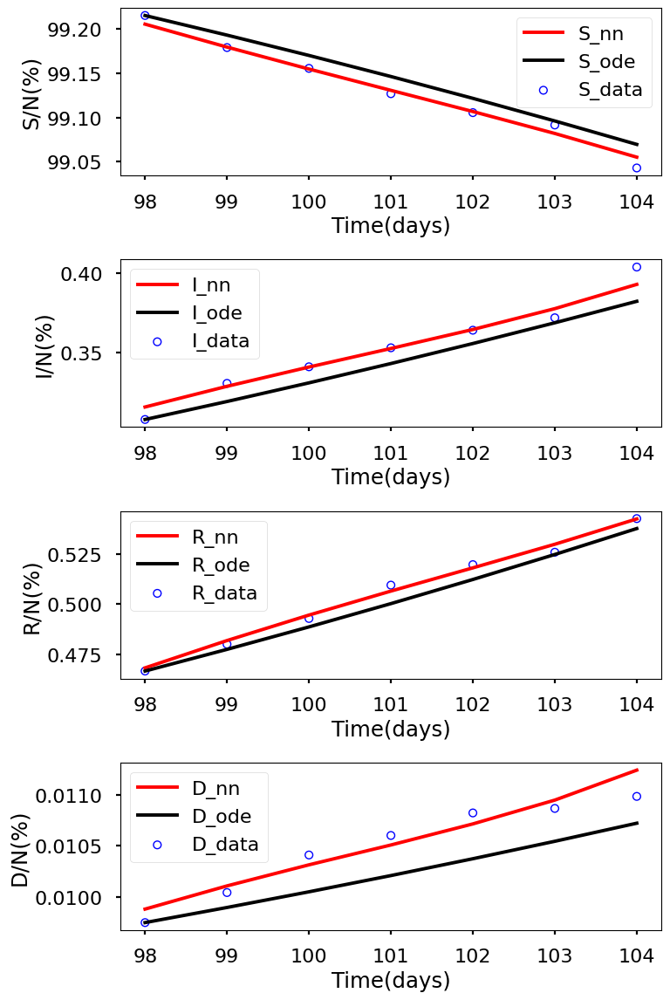

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.147e+00, GE_loss: 2.17054e+00,OB_loss: 9.76851e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 4.31, cumulative_time: 4.31
It: 10000, Loss: 1.696e-05, GE_loss: 4.83669e-06,OB_loss: 1.21245e-05, Beta: 1.06587e+00,gamma: 9.29586e-01,mu: 9.28052e-01, Time: 23.33, cumulative_time: 27.64
It: 20000, Loss: 6.736e-09, GE_loss: 1.79401e-09,OB_loss: 4.94201e-09, Beta: 7.65320e-02,gamma: 3.93063e-02,mu: 3.95965e-03, Time: 23.46, cumulative_time: 51.10
It: 30000, Loss: 4.680e-09, GE_loss: 1.02592e-09,OB_loss: 3.65393e-09, Beta: 7.32503e-02,gamma: 3.75216e-02,mu: 1.88120e-03, Time: 23.15, cumulative_time: 74.24
It: 40000, Loss: 4.706e-09, GE_loss: 1.25032e-09,OB_loss: 3.45581e-09, Beta: 7.30057e-02,gamma: 3.83624e-02,mu: 7.73205e-04, Time: 22.97, cumulative_time: 97.21
beta:  [0.07285249]
gamma:  [0.03859119]
mu:  [0.0005857]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


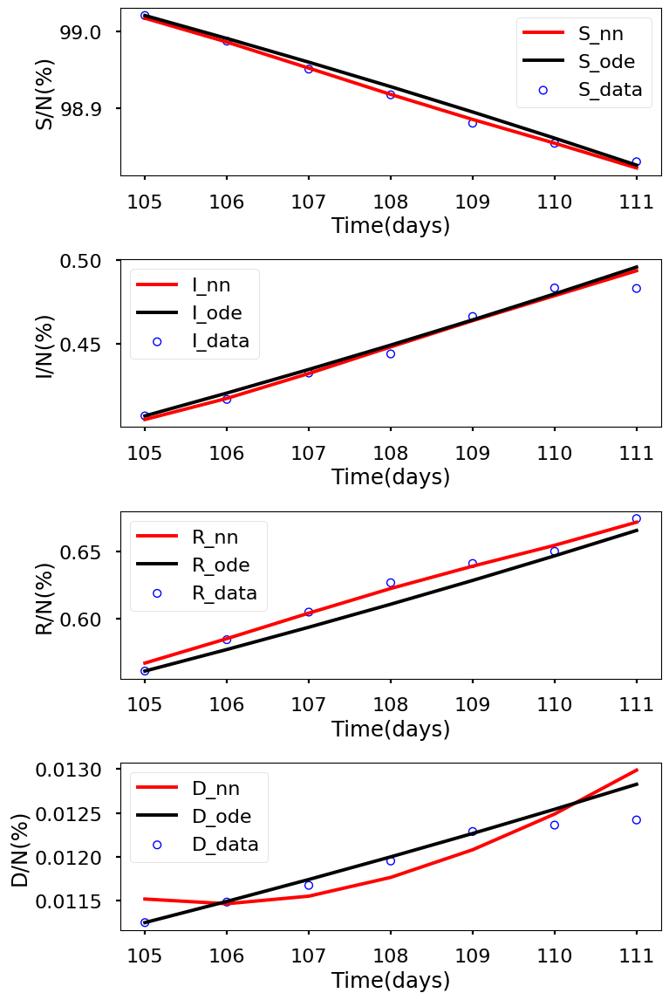

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.072e+00, GE_loss: 2.10100e+00,OB_loss: 9.70708e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 4.17, cumulative_time: 4.17
It: 10000, Loss: 2.284e-05, GE_loss: 6.64158e-06,OB_loss: 1.61952e-05, Beta: 1.06684e+00,gamma: 9.28490e-01,mu: 9.25783e-01, Time: 22.74, cumulative_time: 26.91
It: 20000, Loss: 8.662e-09, GE_loss: 1.64361e-09,OB_loss: 7.01853e-09, Beta: 7.02072e-02,gamma: 3.78072e-02,mu: 3.53737e-03, Time: 22.99, cumulative_time: 49.90
It: 30000, Loss: 7.687e-09, GE_loss: 1.33904e-09,OB_loss: 6.34763e-09, Beta: 6.91275e-02,gamma: 3.81447e-02,mu: 1.42796e-03, Time: 22.88, cumulative_time: 72.78
It: 40000, Loss: 7.418e-09, GE_loss: 1.33665e-09,OB_loss: 6.08174e-09, Beta: 6.90078e-02,gamma: 3.85993e-02,mu: 7.37681e-04, Time: 22.95, cumulative_time: 95.72
beta:  [0.06895684]
gamma:  [0.03885633]
mu:  [0.00060438]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


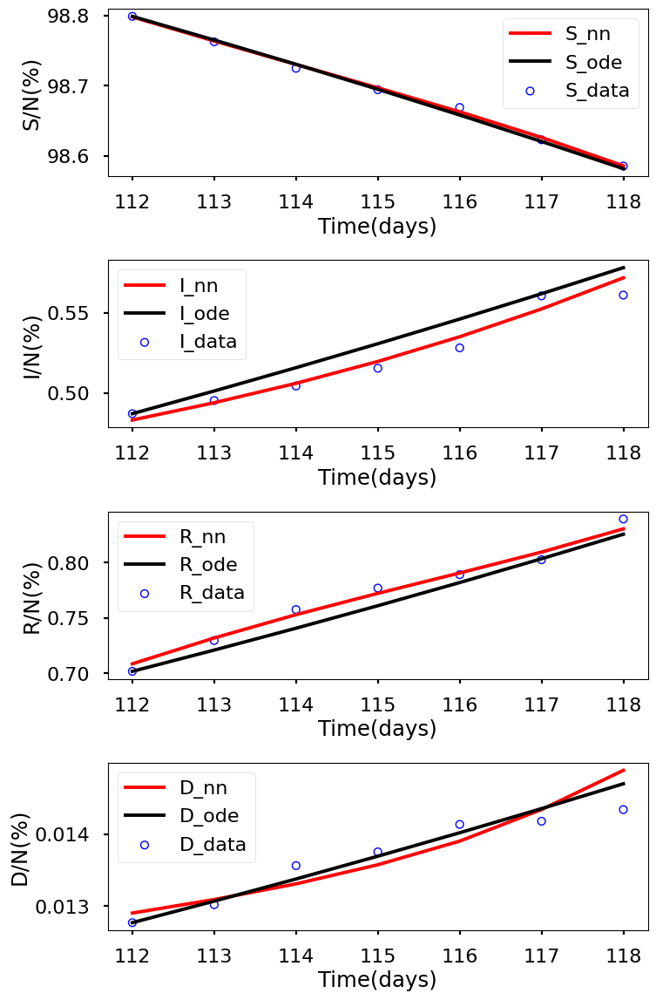

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.044e+00, GE_loss: 2.07646e+00,OB_loss: 9.67284e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 4.19, cumulative_time: 4.19
It: 10000, Loss: 2.708e-05, GE_loss: 7.81178e-06,OB_loss: 1.92729e-05, Beta: 1.06553e+00,gamma: 9.29637e-01,mu: 9.27268e-01, Time: 22.61, cumulative_time: 26.80
It: 20000, Loss: 1.417e-08, GE_loss: 1.40701e-09,OB_loss: 1.27610e-08, Beta: 5.64775e-02,gamma: 4.24450e-02,mu: 2.58846e-03, Time: 22.64, cumulative_time: 49.44
It: 30000, Loss: 1.276e-08, GE_loss: 1.85122e-09,OB_loss: 1.09063e-08, Beta: 5.48076e-02,gamma: 4.24724e-02,mu: 1.01436e-03, Time: 22.61, cumulative_time: 72.06
It: 40000, Loss: 1.097e-08, GE_loss: 2.86984e-09,OB_loss: 8.10224e-09, Beta: 5.41966e-02,gamma: 4.36750e-02,mu: 4.02463e-04, Time: 23.19, cumulative_time: 95.24
beta:  [0.05420253]
gamma:  [0.04414345]
mu:  [0.00043474]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


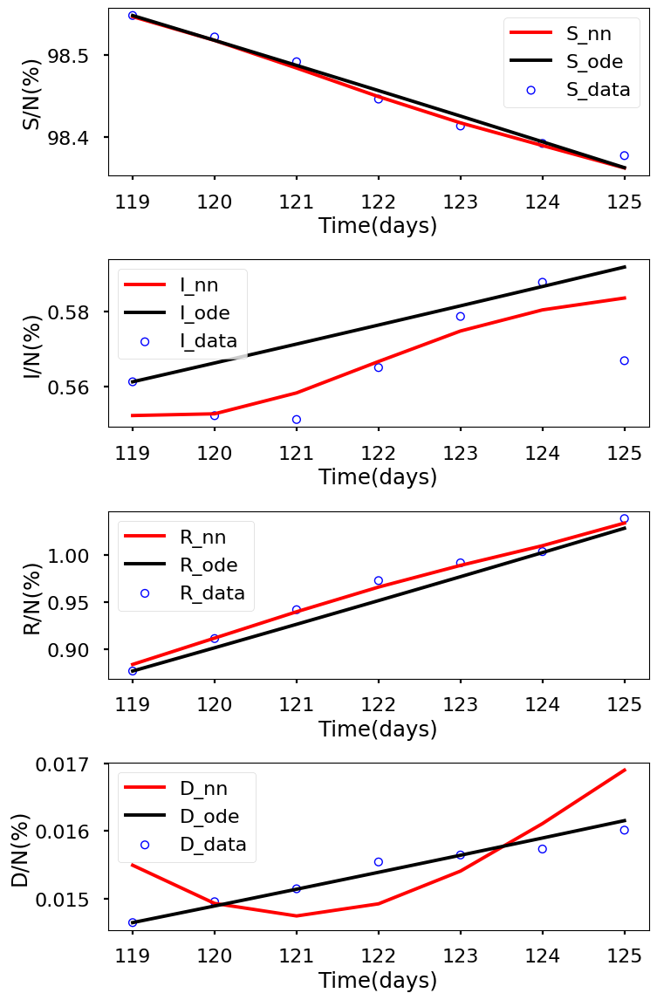

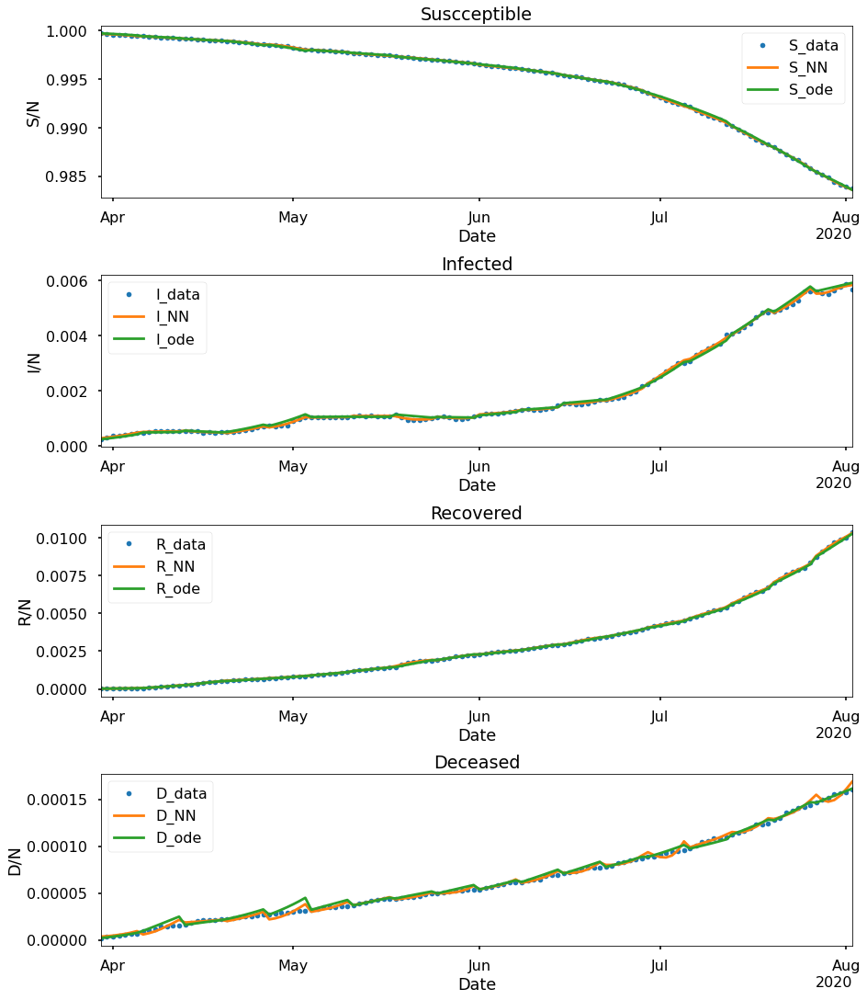

+---------------------+--------------+-------------+--------------+--------------+-------------+--------------+--------------+--------------+--------------+-------------+--------------+--------------+--------------+--------------+---------------+---------------+---------------+---------------+
|      Paramaters     |    Week 1    |    Week 2   |    Week 3    |    Week 4    |    Week 5   |    Week 6    |    Week 7    |    Week 8    |    Week 9    |   Week 10   |   Week 11    |   Week 12    |   Week 13    |   Week 14    |    Week 15    |    Week 16    |    Week 17    |    Week 18    |
+---------------------+--------------+-------------+--------------+--------------+-------------+--------------+--------------+--------------+--------------+-------------+--------------+--------------+--------------+--------------+---------------+---------------+---------------+---------------+
|         beta        |  0.10466063  |  0.06496852 | 0.065755256  |  0.10999347  |  0.10795343 | 0.038146544  |  0.

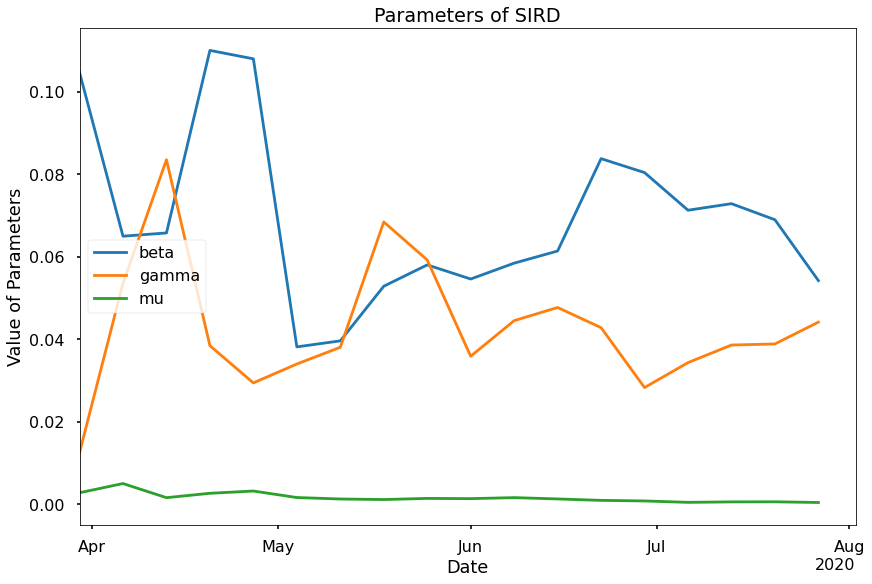

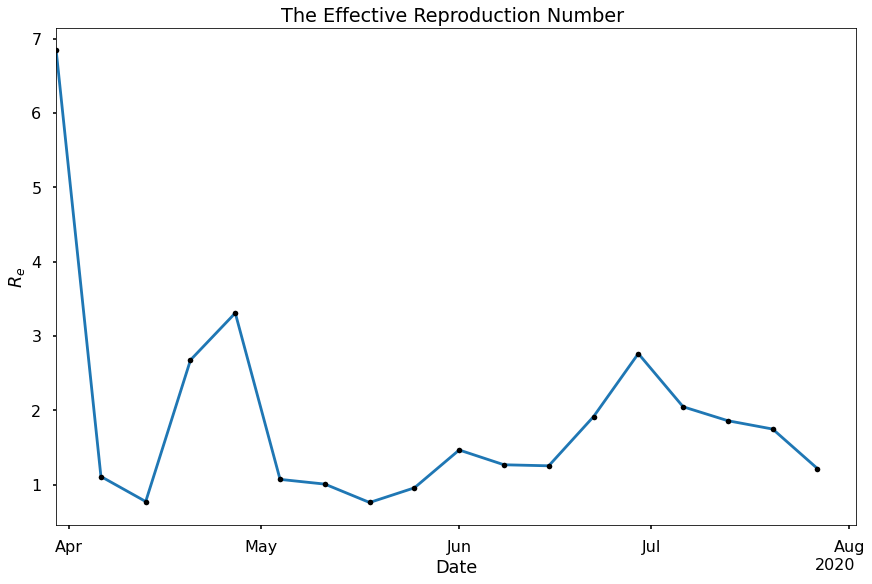

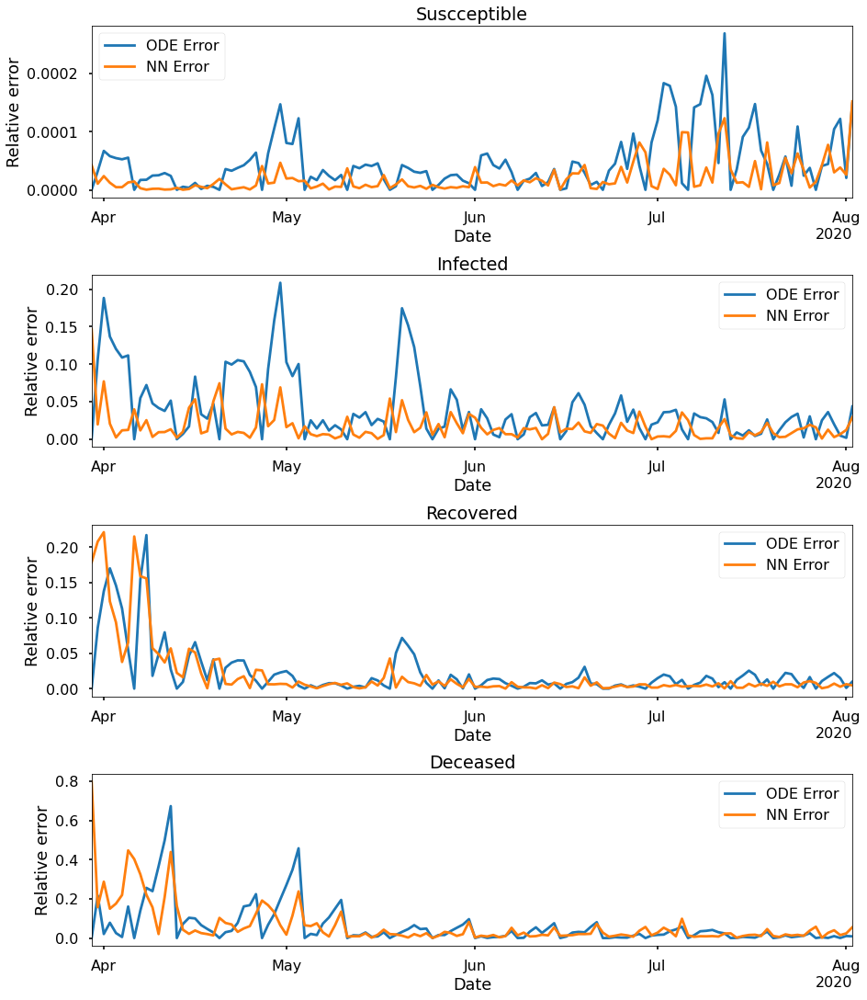

In [ ]:
layers232 = [1,32,32,4]
S232_ode,I232_ode,R232_ode,D232_ode,S232_learned,I232_learned,R232_learned,D232_learned,beta232,gamma232,mu232,S_errnn232,I_errnn232,R_errnn232,D_errnn232,S_erode232,I_errode232,R_errode232,D_errode232,time232 = sum_all(
    layers232,length,SS,II,RC,DC,N0,0.1,50000)

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.102e+00, GE_loss: 2.10918e+00,OB_loss: 9.92908e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 4.29, cumulative_time: 4.29
It: 10000, Loss: 5.502e-07, GE_loss: 2.35874e-07,OB_loss: 3.14364e-07, Beta: 1.03731e+00,gamma: 9.60280e-01,mu: 9.60512e-01, Time: 27.88, cumulative_time: 32.17
It: 20000, Loss: 1.269e-07, GE_loss: 3.57927e-08,OB_loss: 9.10685e-08, Beta: 1.05238e+00,gamma: 9.46982e-01,mu: 9.46864e-01, Time: 26.43, cumulative_time: 58.60
It: 30000, Loss: 1.297e-09, GE_loss: 1.90018e-10,OB_loss: 1.10658e-09, Beta: 1.06775e-01,gamma: 1.44949e-02,mu: 4.89397e-03, Time: 25.16, cumulative_time: 83.76
It: 40000, Loss: 4.396e-10, GE_loss: 1.88524e-11,OB_loss: 4.20764e-10, Beta: 1.05672e-01,gamma: 1.19287e-02,mu: 3.27058e-03, Time: 25.22, cumulative_time: 108.98
beta:  [0.1091219]
gamma:  [0.01323409]
mu:  [0.00254721]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


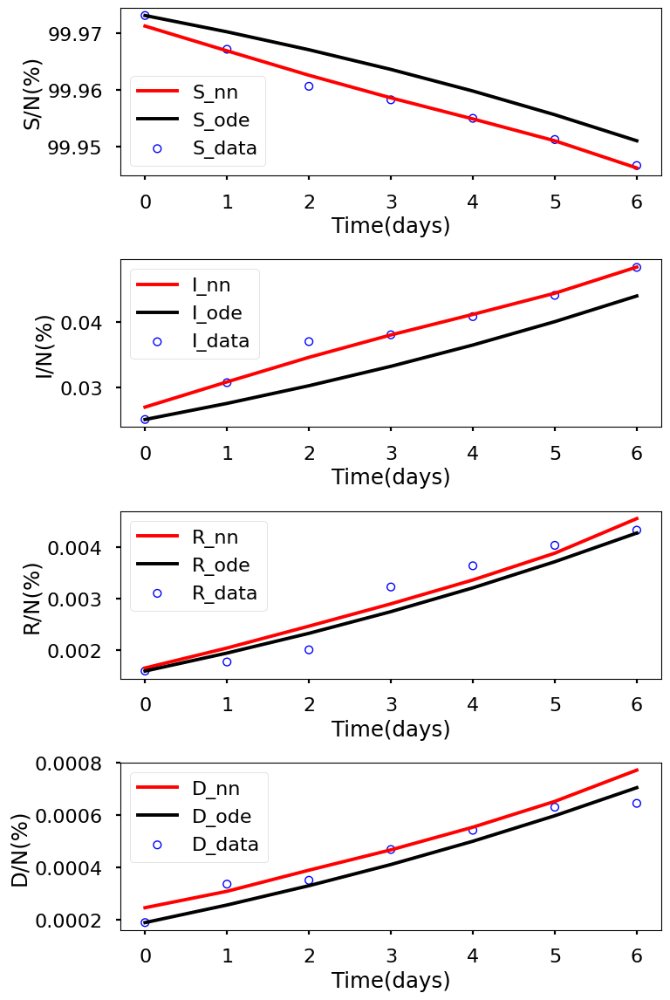

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.092e+00, GE_loss: 2.09624e+00,OB_loss: 9.95742e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 4.32, cumulative_time: 4.32
It: 10000, Loss: 6.116e-07, GE_loss: 3.20426e-07,OB_loss: 2.91176e-07, Beta: 1.04497e+00,gamma: 9.49746e-01,mu: 9.49510e-01, Time: 26.84, cumulative_time: 31.16
It: 20000, Loss: 2.401e-07, GE_loss: 6.88760e-08,OB_loss: 1.71239e-07, Beta: 1.06319e+00,gamma: 9.29811e-01,mu: 9.28066e-01, Time: 25.17, cumulative_time: 56.33
It: 30000, Loss: 2.192e-10, GE_loss: 6.55694e-11,OB_loss: 1.53614e-10, Beta: 6.98204e-02,gamma: 5.68022e-02,mu: 5.35277e-03, Time: 24.78, cumulative_time: 81.12
It: 40000, Loss: 1.695e-10, GE_loss: 3.74142e-11,OB_loss: 1.32108e-10, Beta: 6.88540e-02,gamma: 5.66215e-02,mu: 4.59660e-03, Time: 25.87, cumulative_time: 106.98
beta:  [0.06880227]
gamma:  [0.05677801]
mu:  [0.00428046]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


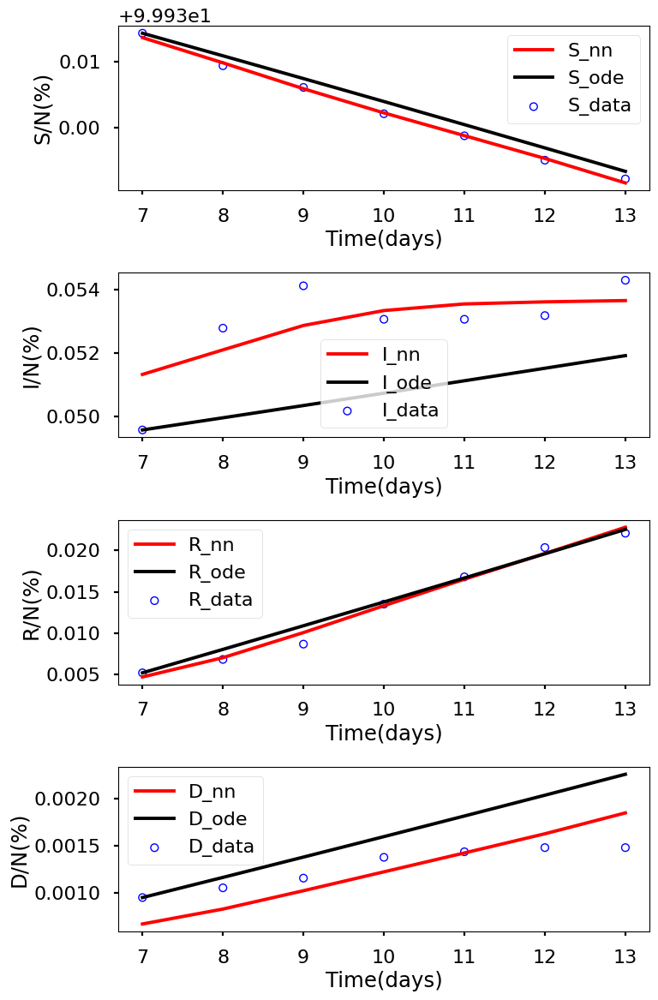

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.096e+00, GE_loss: 2.10172e+00,OB_loss: 9.94548e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 4.36, cumulative_time: 4.36
It: 10000, Loss: 5.105e-07, GE_loss: 2.31863e-07,OB_loss: 2.78684e-07, Beta: 1.04089e+00,gamma: 9.57309e-01,mu: 9.57344e-01, Time: 24.59, cumulative_time: 28.96
It: 20000, Loss: 2.314e-07, GE_loss: 6.76226e-08,OB_loss: 1.63729e-07, Beta: 1.06094e+00,gamma: 9.36137e-01,mu: 9.33623e-01, Time: 24.56, cumulative_time: 53.52
It: 30000, Loss: 4.866e-10, GE_loss: 1.17550e-10,OB_loss: 3.69084e-10, Beta: 6.87244e-02,gamma: 8.33768e-02,mu: 4.61798e-03, Time: 24.28, cumulative_time: 77.79
It: 40000, Loss: 4.399e-10, GE_loss: 6.05092e-11,OB_loss: 3.79417e-10, Beta: 6.68975e-02,gamma: 8.27226e-02,mu: 3.95875e-03, Time: 24.77, cumulative_time: 102.56
beta:  [0.06679813]
gamma:  [0.0827669]
mu:  [0.0036353]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


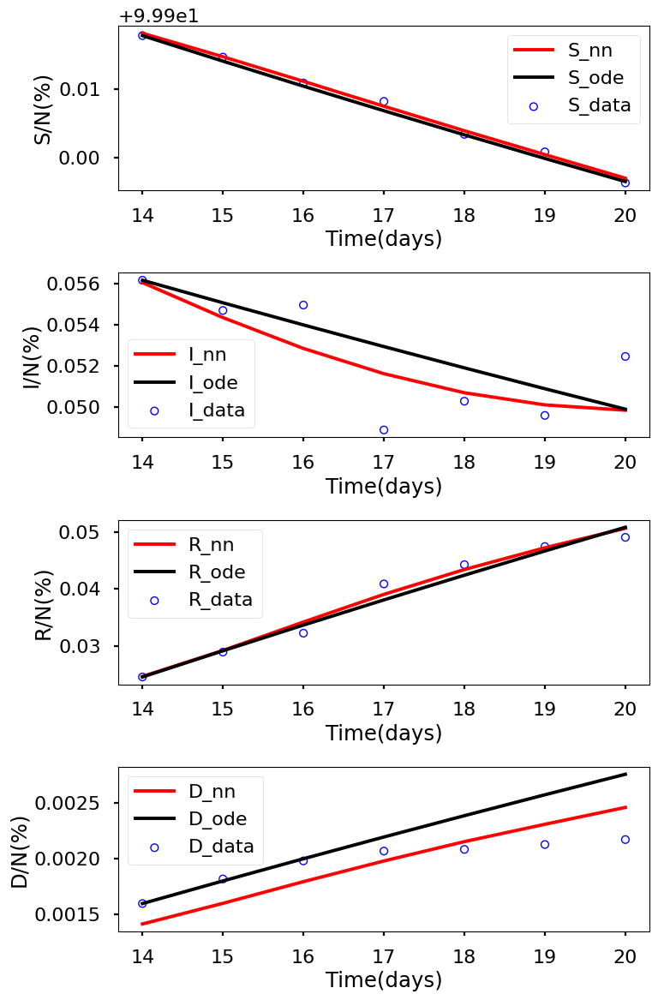

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.065e+00, GE_loss: 2.06993e+00,OB_loss: 9.95026e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 4.60, cumulative_time: 4.60
It: 10000, Loss: 4.829e-07, GE_loss: 2.62984e-07,OB_loss: 2.19897e-07, Beta: 1.04413e+00,gamma: 9.52435e-01,mu: 9.52698e-01, Time: 25.19, cumulative_time: 29.79
It: 20000, Loss: 2.886e-07, GE_loss: 8.69547e-08,OB_loss: 2.01604e-07, Beta: 1.07373e+00,gamma: 9.26276e-01,mu: 9.22454e-01, Time: 27.36, cumulative_time: 57.15
It: 30000, Loss: 4.480e-10, GE_loss: 1.01692e-10,OB_loss: 3.46277e-10, Beta: 1.09722e-01,gamma: 3.93648e-02,mu: 3.61721e-03, Time: 25.78, cumulative_time: 82.93
It: 40000, Loss: 3.265e-10, GE_loss: 2.21818e-11,OB_loss: 3.04303e-10, Beta: 1.08909e-01,gamma: 3.87772e-02,mu: 3.04973e-03, Time: 25.38, cumulative_time: 108.31
beta:  [0.10852598]
gamma:  [0.03863743]
mu:  [0.00276244]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


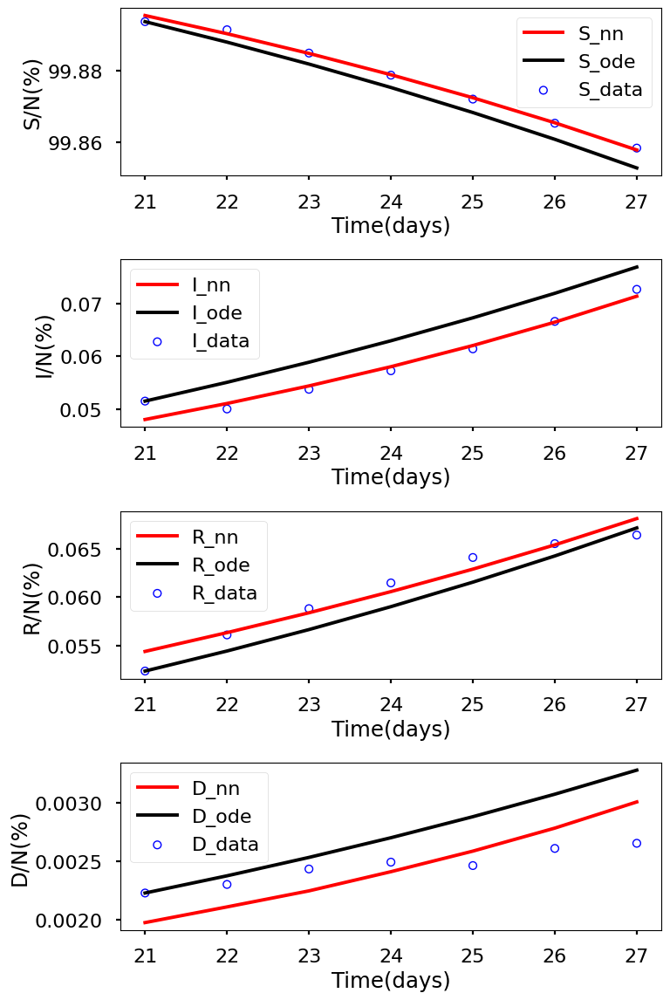

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.078e+00, GE_loss: 2.08512e+00,OB_loss: 9.92636e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 4.60, cumulative_time: 4.60
It: 10000, Loss: 7.543e-07, GE_loss: 2.74349e-07,OB_loss: 4.79934e-07, Beta: 1.04374e+00,gamma: 9.55154e-01,mu: 9.55121e-01, Time: 25.72, cumulative_time: 30.32
It: 20000, Loss: 5.744e-07, GE_loss: 1.77180e-07,OB_loss: 3.97211e-07, Beta: 1.10557e+00,gamma: 8.99732e-01,mu: 8.90948e-01, Time: 25.58, cumulative_time: 55.90
It: 30000, Loss: 2.166e-09, GE_loss: 2.43553e-10,OB_loss: 1.92223e-09, Beta: 1.09788e-01,gamma: 3.14584e-02,mu: 3.09992e-03, Time: 27.43, cumulative_time: 83.33
It: 40000, Loss: 1.903e-09, GE_loss: 4.62344e-10,OB_loss: 1.44035e-09, Beta: 1.04395e-01,gamma: 2.97398e-02,mu: 2.55199e-03, Time: 25.48, cumulative_time: 108.81
beta:  [0.10416261]
gamma:  [0.02994427]
mu:  [0.00259767]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


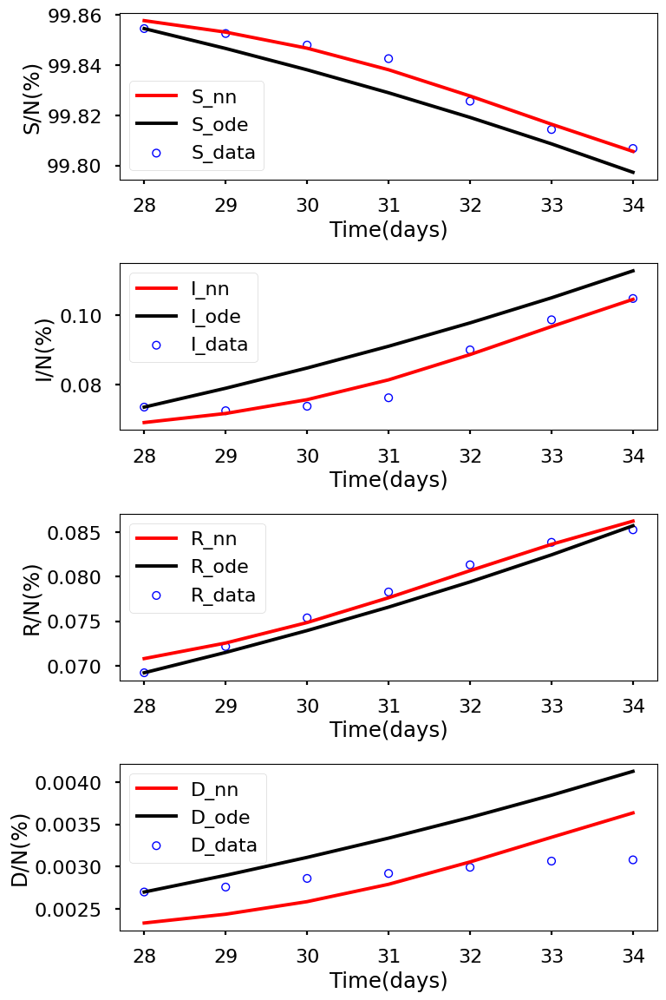

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.073e+00, GE_loss: 2.07996e+00,OB_loss: 9.92898e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 4.53, cumulative_time: 4.53
It: 10000, Loss: 1.050e-06, GE_loss: 3.91669e-07,OB_loss: 6.58723e-07, Beta: 1.04544e+00,gamma: 9.51347e-01,mu: 9.51333e-01, Time: 25.03, cumulative_time: 29.57
It: 20000, Loss: 8.882e-07, GE_loss: 2.80618e-07,OB_loss: 6.07622e-07, Beta: 1.05982e+00,gamma: 8.73668e-01,mu: 8.62719e-01, Time: 25.69, cumulative_time: 55.26
It: 30000, Loss: 1.895e-10, GE_loss: 5.90171e-11,OB_loss: 1.30472e-10, Beta: 3.91776e-02,gamma: 3.53083e-02,mu: 1.75510e-03, Time: 25.42, cumulative_time: 80.68
It: 40000, Loss: 1.373e-10, GE_loss: 1.60688e-11,OB_loss: 1.21268e-10, Beta: 3.83149e-02,gamma: 3.46633e-02,mu: 1.51589e-03, Time: 25.66, cumulative_time: 106.34
beta:  [0.03803919]
gamma:  [0.03448744]
mu:  [0.00142694]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


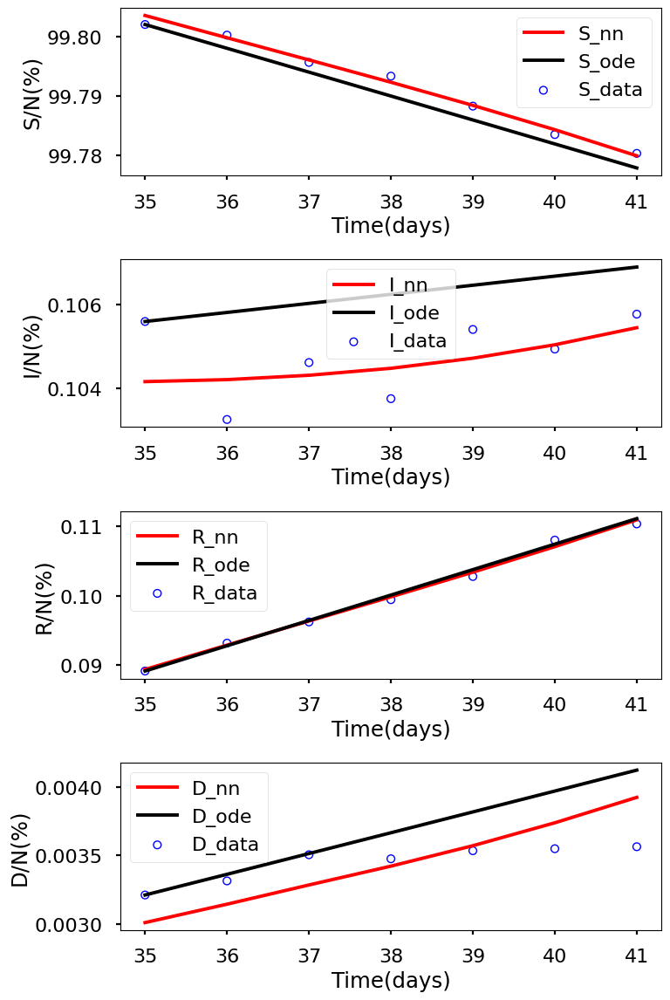

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.057e+00, GE_loss: 2.06250e+00,OB_loss: 9.94506e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 4.76, cumulative_time: 4.76
It: 10000, Loss: 1.158e-06, GE_loss: 4.19880e-07,OB_loss: 7.37689e-07, Beta: 1.04516e+00,gamma: 9.51661e-01,mu: 9.51812e-01, Time: 24.53, cumulative_time: 29.29
It: 20000, Loss: 9.670e-07, GE_loss: 3.06816e-07,OB_loss: 6.60204e-07, Beta: 1.07084e+00,gamma: 8.67302e-01,mu: 8.52880e-01, Time: 26.55, cumulative_time: 55.84
It: 30000, Loss: 2.909e-10, GE_loss: 3.79621e-11,OB_loss: 2.52910e-10, Beta: 4.13109e-02,gamma: 3.83790e-02,mu: 1.72180e-03, Time: 25.14, cumulative_time: 80.98
It: 40000, Loss: 2.436e-10, GE_loss: 2.73979e-11,OB_loss: 2.16239e-10, Beta: 4.07838e-02,gamma: 3.79661e-02,mu: 1.56812e-03, Time: 25.92, cumulative_time: 106.90
beta:  [0.04077548]
gamma:  [0.03789213]
mu:  [0.00148461]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


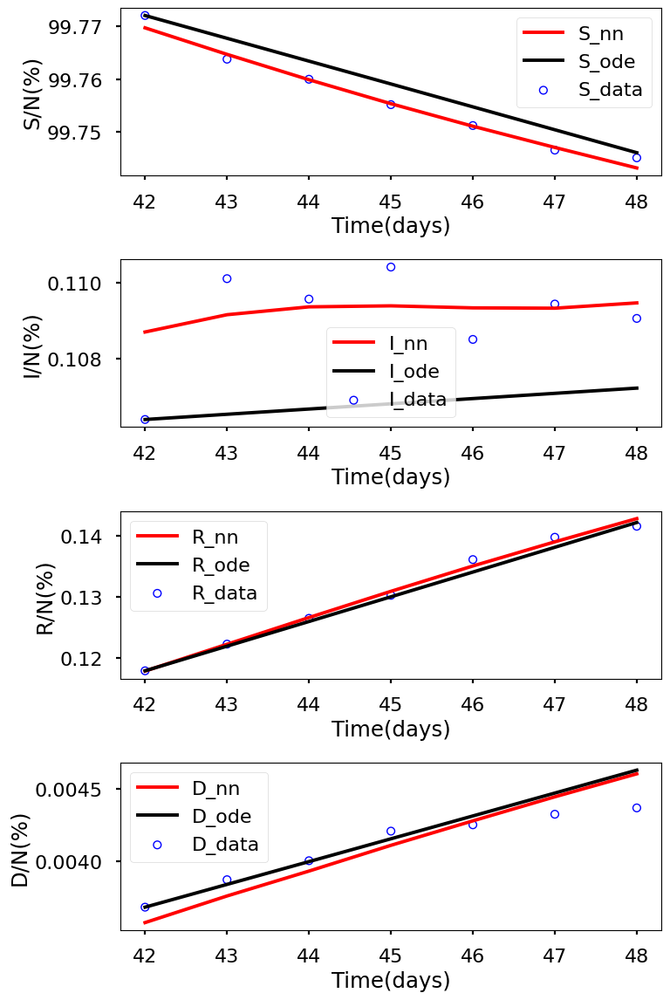

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.104e+00, GE_loss: 2.11460e+00,OB_loss: 9.89399e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 4.67, cumulative_time: 4.67
It: 10000, Loss: 9.541e-07, GE_loss: 3.42248e-07,OB_loss: 6.11820e-07, Beta: 1.04216e+00,gamma: 9.55542e-01,mu: 9.55761e-01, Time: 24.94, cumulative_time: 29.61
It: 20000, Loss: 7.986e-07, GE_loss: 2.51282e-07,OB_loss: 5.47330e-07, Beta: 1.06840e+00,gamma: 8.81278e-01,mu: 8.66346e-01, Time: 24.99, cumulative_time: 54.60
It: 30000, Loss: 2.969e-09, GE_loss: 1.20612e-09,OB_loss: 1.76290e-09, Beta: 5.30052e-02,gamma: 7.03269e-02,mu: 2.55799e-03, Time: 24.86, cumulative_time: 79.46
It: 40000, Loss: 2.819e-09, GE_loss: 1.19658e-09,OB_loss: 1.62227e-09, Beta: 5.28307e-02,gamma: 6.99547e-02,mu: 1.90761e-03, Time: 29.32, cumulative_time: 108.78
beta:  [0.05285697]
gamma:  [0.07019468]
mu:  [0.00132617]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


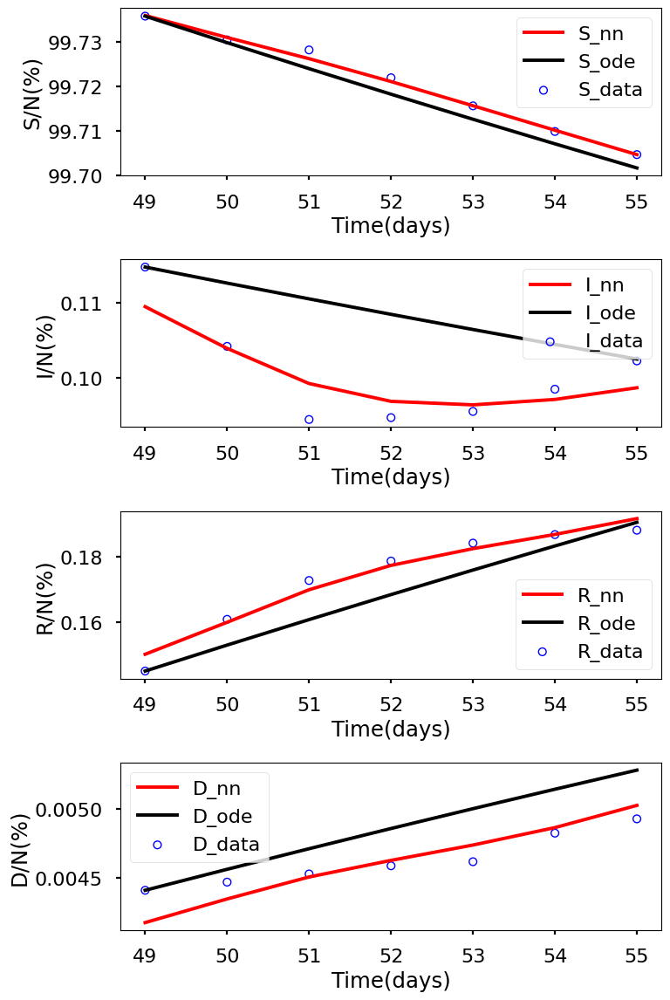

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.051e+00, GE_loss: 2.05731e+00,OB_loss: 9.94041e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 4.64, cumulative_time: 4.64
It: 10000, Loss: 9.776e-07, GE_loss: 3.33819e-07,OB_loss: 6.43746e-07, Beta: 1.04517e+00,gamma: 9.52572e-01,mu: 9.52410e-01, Time: 24.92, cumulative_time: 29.56
It: 20000, Loss: 8.461e-07, GE_loss: 2.73571e-07,OB_loss: 5.72547e-07, Beta: 1.06434e+00,gamma: 8.75012e-01,mu: 8.59579e-01, Time: 24.91, cumulative_time: 54.48
It: 30000, Loss: 1.365e-09, GE_loss: 1.96272e-10,OB_loss: 1.16910e-09, Beta: 5.91851e-02,gamma: 6.07253e-02,mu: 2.73272e-03, Time: 25.58, cumulative_time: 80.06
It: 40000, Loss: 1.156e-09, GE_loss: 3.77980e-10,OB_loss: 7.78465e-10, Beta: 5.73747e-02,gamma: 5.72837e-02,mu: 1.48286e-03, Time: 25.85, cumulative_time: 105.91
beta:  [0.05746923]
gamma:  [0.05723951]
mu:  [0.00103476]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


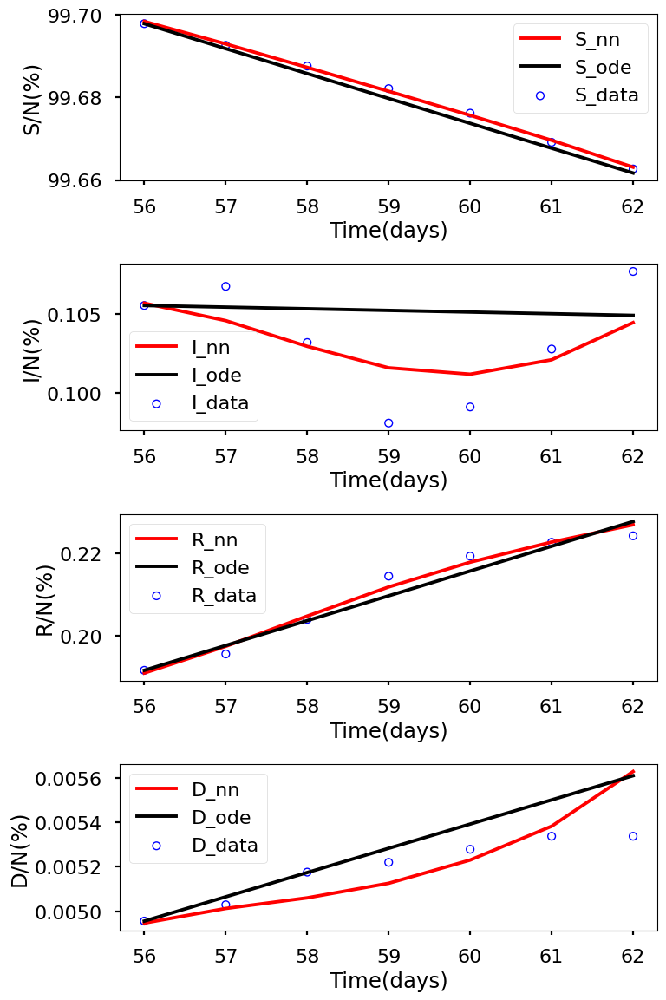

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.038e+00, GE_loss: 2.04485e+00,OB_loss: 9.92793e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 4.73, cumulative_time: 4.73
It: 10000, Loss: 1.349e-06, GE_loss: 3.91638e-07,OB_loss: 9.57311e-07, Beta: 1.04260e+00,gamma: 9.55940e-01,mu: 9.55897e-01, Time: 25.16, cumulative_time: 29.89
It: 20000, Loss: 1.130e-06, GE_loss: 3.72317e-07,OB_loss: 7.57820e-07, Beta: 1.06309e+00,gamma: 8.40132e-01,mu: 8.22153e-01, Time: 25.87, cumulative_time: 55.76
It: 30000, Loss: 7.064e-10, GE_loss: 1.16346e-10,OB_loss: 5.90065e-10, Beta: 5.53805e-02,gamma: 3.49737e-02,mu: 3.19343e-03, Time: 25.72, cumulative_time: 81.48
It: 40000, Loss: 6.316e-10, GE_loss: 8.66149e-11,OB_loss: 5.45005e-10, Beta: 5.49640e-02,gamma: 3.53828e-02,mu: 1.69072e-03, Time: 25.71, cumulative_time: 107.19
beta:  [0.05505059]
gamma:  [0.03559359]
mu:  [0.00128248]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


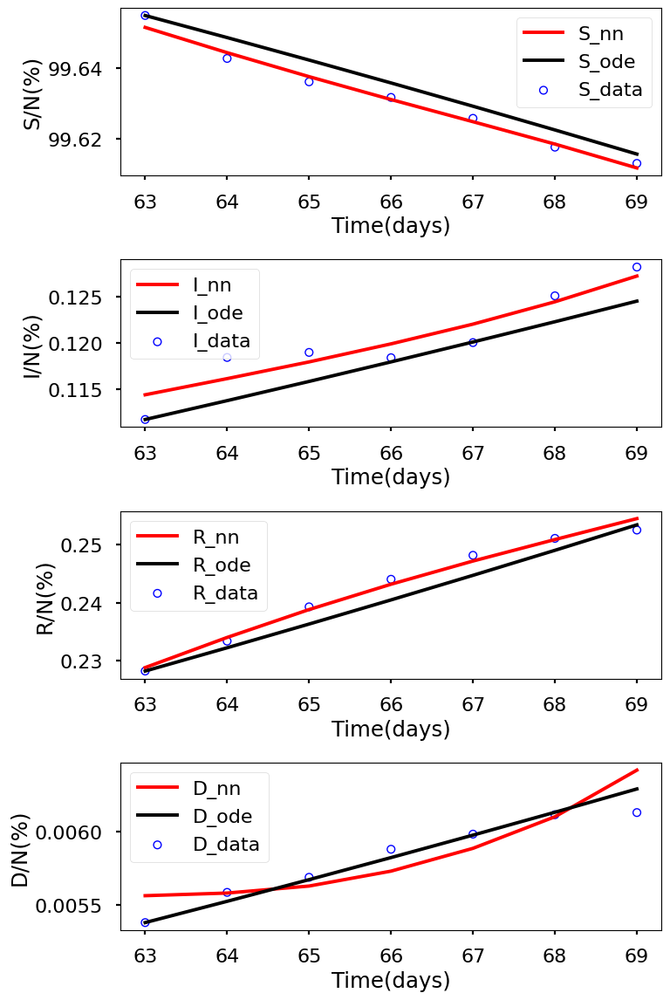

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.135e+00, GE_loss: 2.14389e+00,OB_loss: 9.91161e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 4.73, cumulative_time: 4.73
It: 10000, Loss: 1.693e-06, GE_loss: 5.24264e-07,OB_loss: 1.16900e-06, Beta: 1.04319e+00,gamma: 9.54902e-01,mu: 9.54507e-01, Time: 25.54, cumulative_time: 30.27
It: 20000, Loss: 1.374e-06, GE_loss: 4.68959e-07,OB_loss: 9.05382e-07, Beta: 1.05610e+00,gamma: 8.17166e-01,mu: 7.89644e-01, Time: 25.53, cumulative_time: 55.80
It: 30000, Loss: 1.146e-09, GE_loss: 3.19059e-10,OB_loss: 8.27289e-10, Beta: 6.07333e-02,gamma: 4.35111e-02,mu: 3.73592e-03, Time: 26.08, cumulative_time: 81.88
It: 40000, Loss: 1.288e-09, GE_loss: 4.13615e-10,OB_loss: 8.74316e-10, Beta: 6.04747e-02,gamma: 4.37613e-02,mu: 2.85016e-03, Time: 28.57, cumulative_time: 110.45
beta:  [0.06035241]
gamma:  [0.0438599]
mu:  [0.0024229]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


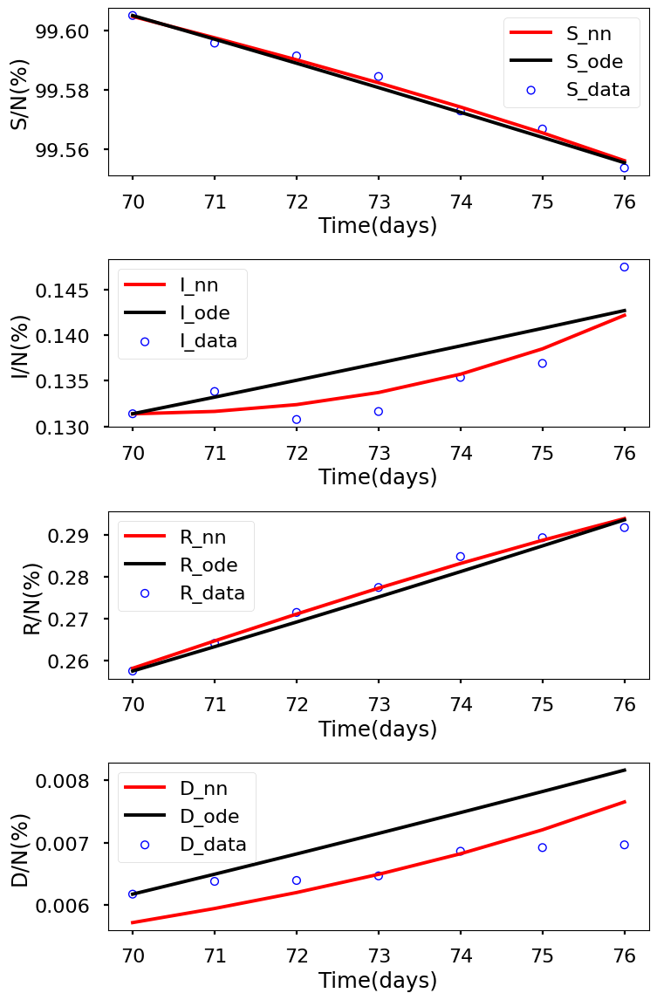

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.070e+00, GE_loss: 2.07963e+00,OB_loss: 9.90018e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 4.82, cumulative_time: 4.82
It: 10000, Loss: 2.194e-06, GE_loss: 5.63676e-07,OB_loss: 1.62985e-06, Beta: 1.03890e+00,gamma: 9.60451e-01,mu: 9.60131e-01, Time: 25.46, cumulative_time: 30.28
It: 20000, Loss: 1.697e-06, GE_loss: 6.31017e-07,OB_loss: 1.06635e-06, Beta: 1.00127e+00,gamma: 7.42908e-01,mu: 6.99714e-01, Time: 26.11, cumulative_time: 56.39
It: 30000, Loss: 2.459e-09, GE_loss: 6.01346e-10,OB_loss: 1.85746e-09, Beta: 6.18296e-02,gamma: 4.76303e-02,mu: 1.13252e-03, Time: 25.44, cumulative_time: 81.82
It: 40000, Loss: 2.435e-09, GE_loss: 6.07868e-10,OB_loss: 1.82737e-09, Beta: 6.14220e-02,gamma: 4.73315e-02,mu: 8.72518e-04, Time: 24.84, cumulative_time: 106.67
beta:  [0.06147504]
gamma:  [0.04722061]
mu:  [0.00091951]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


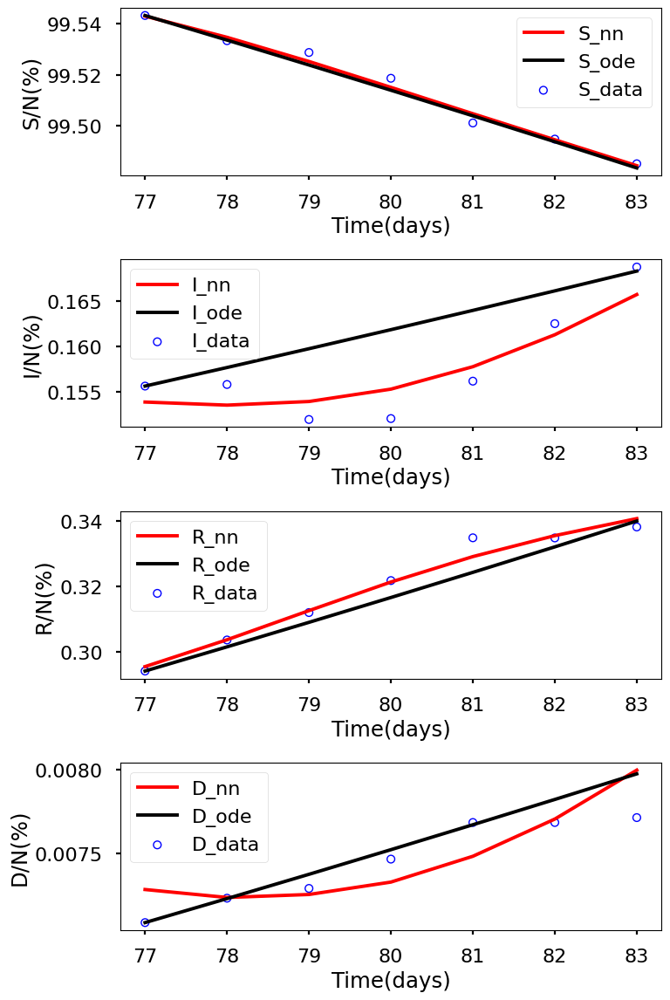

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.083e+00, GE_loss: 2.09486e+00,OB_loss: 9.88215e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 4.80, cumulative_time: 4.80
It: 10000, Loss: 2.951e-06, GE_loss: 8.83809e-07,OB_loss: 2.06716e-06, Beta: 1.04659e+00,gamma: 9.50322e-01,mu: 9.50200e-01, Time: 26.67, cumulative_time: 31.47
It: 20000, Loss: 2.047e-06, GE_loss: 8.33216e-07,OB_loss: 1.21409e-06, Beta: 9.69216e-01,gamma: 6.65090e-01,mu: 6.30500e-01, Time: 26.61, cumulative_time: 58.08
It: 30000, Loss: 2.100e-09, GE_loss: 3.87676e-10,OB_loss: 1.71204e-09, Beta: 8.64747e-02,gamma: 4.36355e-02,mu: 2.44514e-03, Time: 26.86, cumulative_time: 84.95
It: 40000, Loss: 2.916e-09, GE_loss: 1.00321e-09,OB_loss: 1.91261e-09, Beta: 8.61805e-02,gamma: 4.38175e-02,mu: 1.34402e-03, Time: 27.95, cumulative_time: 112.90
beta:  [0.08611817]
gamma:  [0.04381848]
mu:  [0.00102717]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


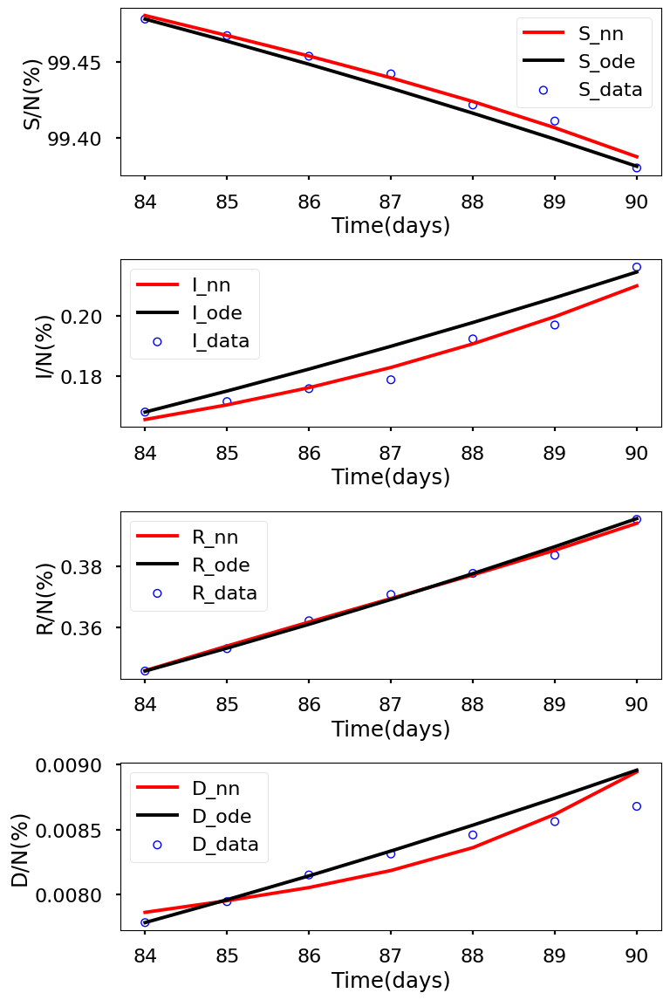

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.025e+00, GE_loss: 2.04338e+00,OB_loss: 9.81443e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 4.91, cumulative_time: 4.91
It: 10000, Loss: 6.311e-06, GE_loss: 1.76619e-06,OB_loss: 4.54528e-06, Beta: 1.04644e+00,gamma: 9.52008e-01,mu: 9.51196e-01, Time: 24.49, cumulative_time: 29.40
It: 20000, Loss: 6.578e-07, GE_loss: 4.65475e-07,OB_loss: 1.92327e-07, Beta: 3.27333e-01,gamma: 2.23590e-01,mu: 1.56496e-01, Time: 24.42, cumulative_time: 53.82
It: 30000, Loss: 3.797e-09, GE_loss: 1.32066e-09,OB_loss: 2.47650e-09, Beta: 7.90927e-02,gamma: 2.86814e-02,mu: 1.29519e-03, Time: 24.62, cumulative_time: 78.44
It: 40000, Loss: 3.615e-09, GE_loss: 1.24387e-09,OB_loss: 2.37136e-09, Beta: 7.92855e-02,gamma: 2.89340e-02,mu: 5.45585e-04, Time: 25.75, cumulative_time: 104.19
beta:  [0.07936285]
gamma:  [0.02902198]
mu:  [0.00058268]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


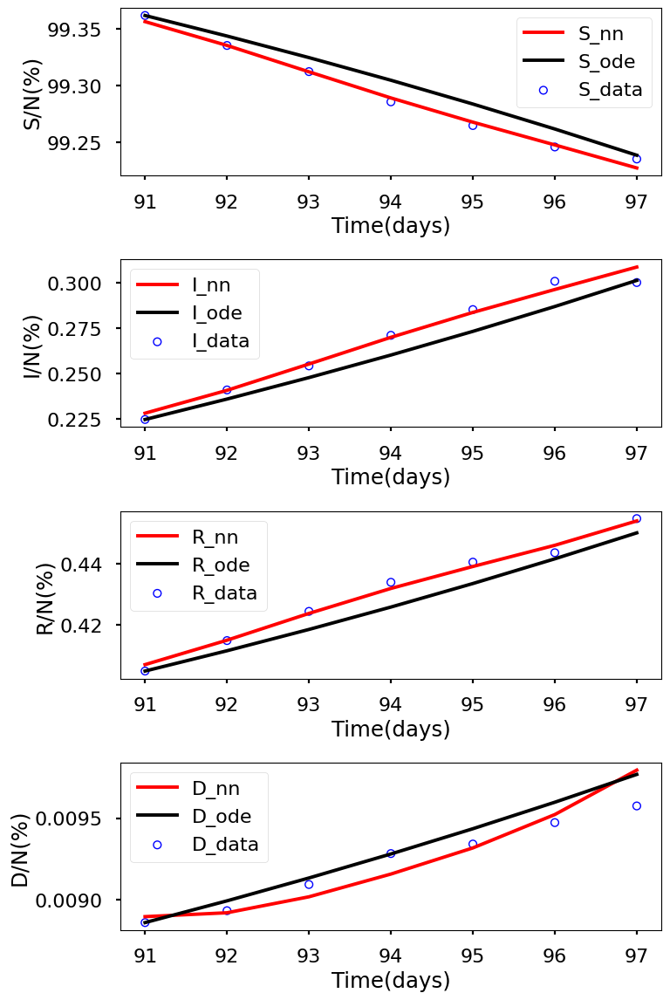

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.108e+00, GE_loss: 2.12360e+00,OB_loss: 9.84305e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 4.87, cumulative_time: 4.87
It: 10000, Loss: 1.074e-05, GE_loss: 3.10257e-06,OB_loss: 7.64007e-06, Beta: 1.04736e+00,gamma: 9.50643e-01,mu: 9.50059e-01, Time: 25.61, cumulative_time: 30.48
It: 20000, Loss: 1.353e-08, GE_loss: 6.90334e-09,OB_loss: 6.62359e-09, Beta: 8.75458e-02,gamma: 4.73701e-02,mu: 6.14562e-03, Time: 25.94, cumulative_time: 56.42
It: 30000, Loss: 5.901e-09, GE_loss: 7.69406e-10,OB_loss: 5.13119e-09, Beta: 7.48702e-02,gamma: 3.53070e-02,mu: 7.27890e-04, Time: 25.95, cumulative_time: 82.37
It: 40000, Loss: 5.505e-09, GE_loss: 1.06572e-09,OB_loss: 4.43976e-09, Beta: 7.48593e-02,gamma: 3.42502e-02,mu: 7.10914e-04, Time: 25.80, cumulative_time: 108.16
beta:  [0.07485653]
gamma:  [0.03422436]
mu:  [0.00071542]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


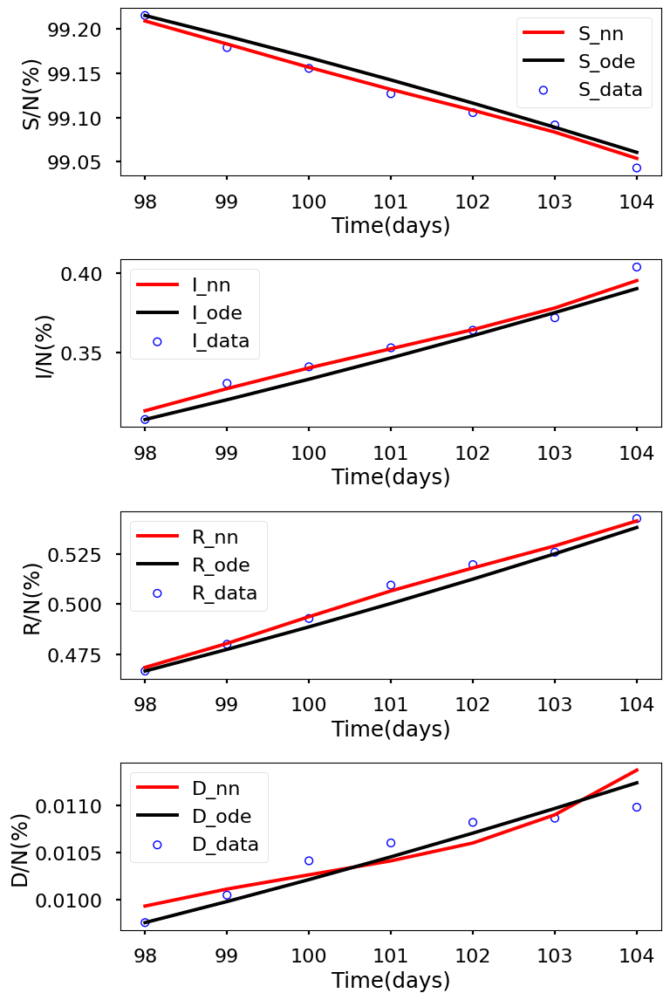

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.095e+00, GE_loss: 2.11988e+00,OB_loss: 9.74862e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 5.16, cumulative_time: 5.16
It: 10000, Loss: 1.709e-05, GE_loss: 4.99833e-06,OB_loss: 1.20914e-05, Beta: 1.05094e+00,gamma: 9.44902e-01,mu: 9.43114e-01, Time: 26.02, cumulative_time: 31.18
It: 20000, Loss: 6.460e-09, GE_loss: 1.65838e-09,OB_loss: 4.80126e-09, Beta: 7.41385e-02,gamma: 4.04360e-02,mu: 3.56201e-03, Time: 26.69, cumulative_time: 57.87
It: 30000, Loss: 5.223e-09, GE_loss: 1.68184e-09,OB_loss: 3.54090e-09, Beta: 7.23912e-02,gamma: 3.95104e-02,mu: 9.04399e-04, Time: 25.93, cumulative_time: 83.80
It: 40000, Loss: 4.605e-09, GE_loss: 1.38981e-09,OB_loss: 3.21533e-09, Beta: 7.23939e-02,gamma: 3.96521e-02,mu: 7.89563e-04, Time: 25.00, cumulative_time: 108.80
beta:  [0.07240399]
gamma:  [0.03971862]
mu:  [0.00076369]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


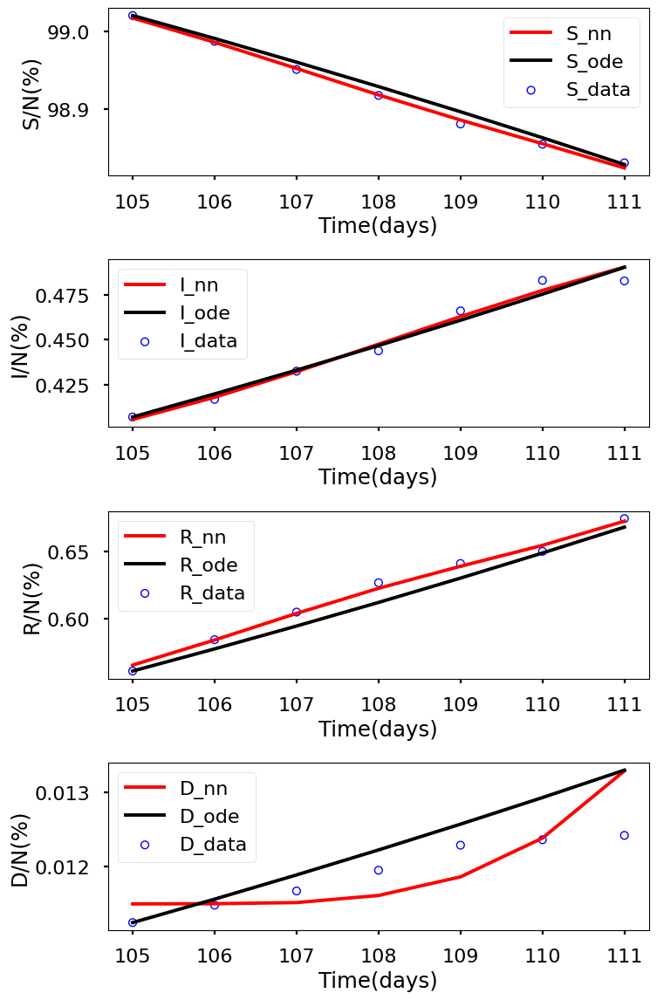

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.075e+00, GE_loss: 2.10548e+00,OB_loss: 9.69284e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 4.96, cumulative_time: 4.96
It: 10000, Loss: 2.332e-05, GE_loss: 6.83809e-06,OB_loss: 1.64811e-05, Beta: 1.05364e+00,gamma: 9.43987e-01,mu: 9.41980e-01, Time: 24.88, cumulative_time: 29.83
It: 20000, Loss: 9.517e-09, GE_loss: 1.62827e-09,OB_loss: 7.88900e-09, Beta: 7.01690e-02,gamma: 3.94664e-02,mu: 3.77216e-03, Time: 24.85, cumulative_time: 54.68
It: 30000, Loss: 8.129e-09, GE_loss: 1.16082e-09,OB_loss: 6.96850e-09, Beta: 6.89438e-02,gamma: 4.02894e-02,mu: 1.13982e-03, Time: 24.91, cumulative_time: 79.59
It: 40000, Loss: 1.158e-08, GE_loss: 4.66255e-09,OB_loss: 6.91886e-09, Beta: 6.88492e-02,gamma: 4.08297e-02,mu: 6.35465e-04, Time: 24.92, cumulative_time: 104.51
beta:  [0.06861193]
gamma:  [0.04065504]
mu:  [0.00054703]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


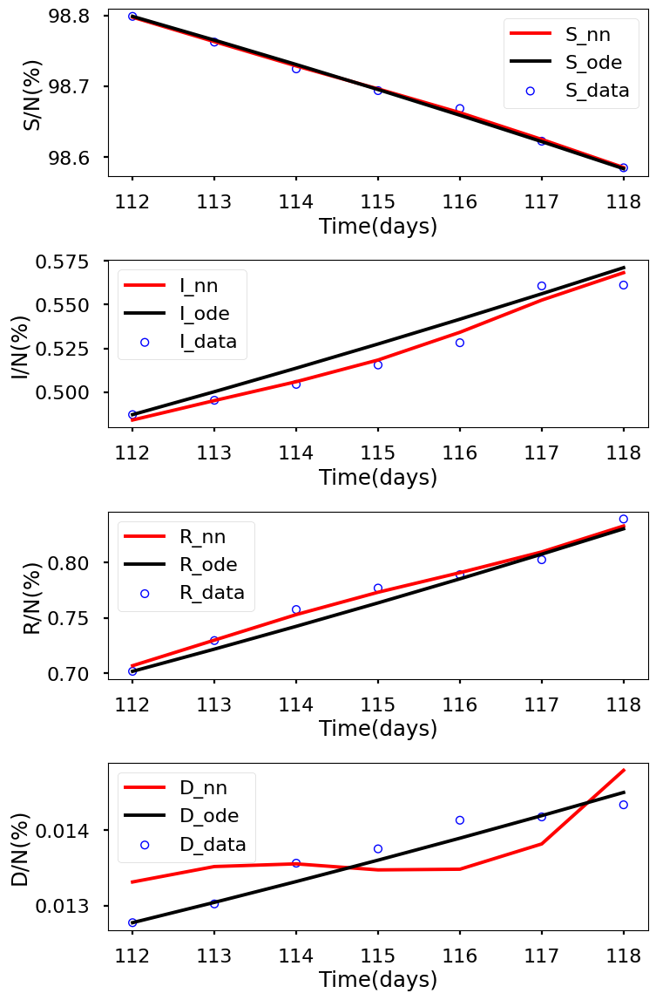

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.039e+00, GE_loss: 2.07066e+00,OB_loss: 9.68141e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 5.18, cumulative_time: 5.18
It: 10000, Loss: 2.745e-05, GE_loss: 8.06437e-06,OB_loss: 1.93884e-05, Beta: 1.05318e+00,gamma: 9.43324e-01,mu: 9.40675e-01, Time: 24.59, cumulative_time: 29.77
It: 20000, Loss: 1.682e-08, GE_loss: 1.70453e-09,OB_loss: 1.51174e-08, Beta: 5.55861e-02,gamma: 4.33793e-02,mu: 3.19672e-03, Time: 25.03, cumulative_time: 54.80
It: 30000, Loss: 1.275e-08, GE_loss: 3.88555e-09,OB_loss: 8.85952e-09, Beta: 5.33915e-02,gamma: 4.52907e-02,mu: 1.12286e-03, Time: 25.30, cumulative_time: 80.10
It: 40000, Loss: 1.197e-08, GE_loss: 3.75293e-09,OB_loss: 8.21618e-09, Beta: 5.32953e-02,gamma: 4.55857e-02,mu: 3.59305e-04, Time: 25.38, cumulative_time: 105.48
beta:  [0.05331483]
gamma:  [0.04559232]
mu:  [0.00033964]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


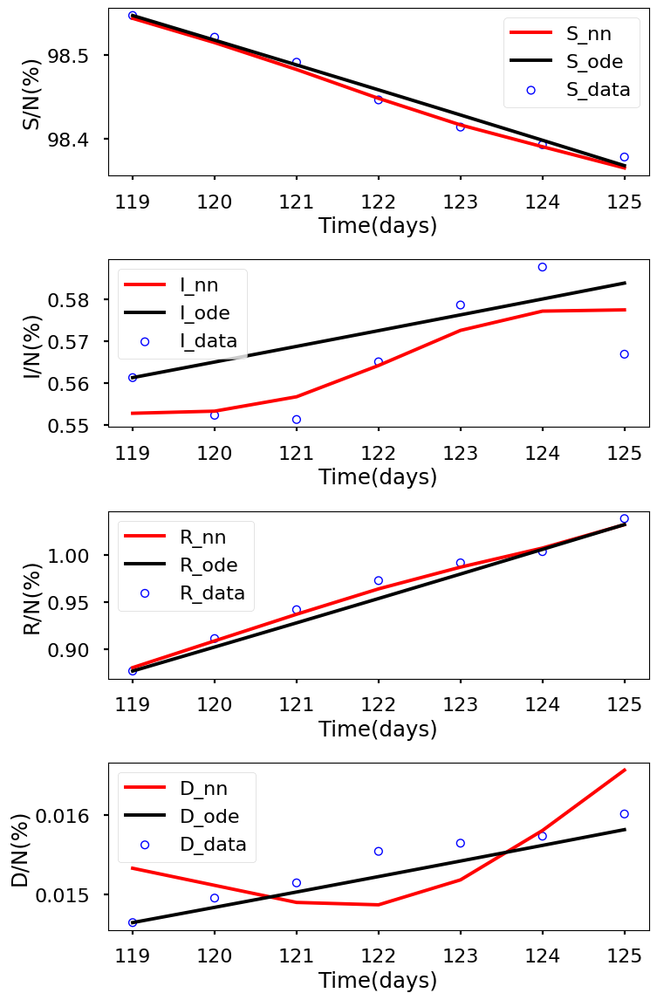

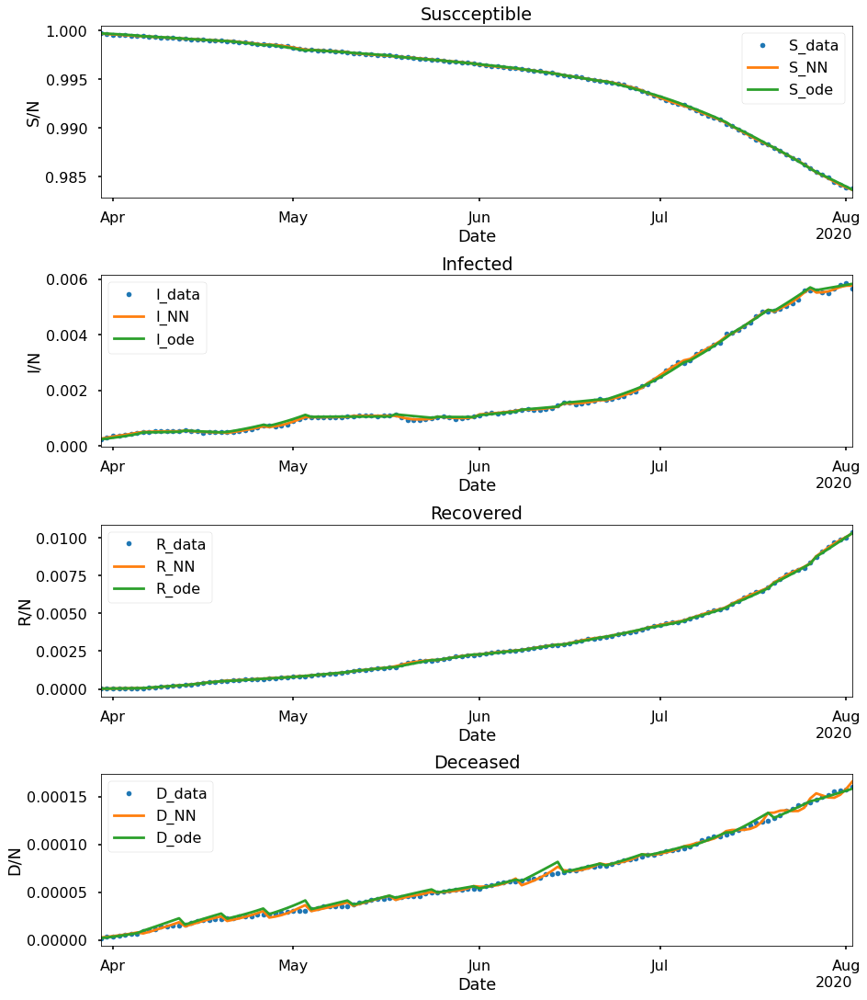

+---------------------+--------------+--------------+-------------+-------------+-------------+--------------+--------------+--------------+--------------+--------------+--------------+-------------+-------------+--------------+---------------+--------------+---------------+-------------+
|      Paramaters     |    Week 1    |    Week 2    |    Week 3   |    Week 4   |    Week 5   |    Week 6    |    Week 7    |    Week 8    |    Week 9    |   Week 10    |   Week 11    |   Week 12   |   Week 13   |   Week 14    |    Week 15    |   Week 16    |    Week 17    |   Week 18   |
+---------------------+--------------+--------------+-------------+-------------+-------------+--------------+--------------+--------------+--------------+--------------+--------------+-------------+-------------+--------------+---------------+--------------+---------------+-------------+
|         beta        |  0.1091219   |  0.06880227  |  0.06679813 | 0.108525984 |  0.10416261 | 0.038039193  | 0.040775478  |  0.0

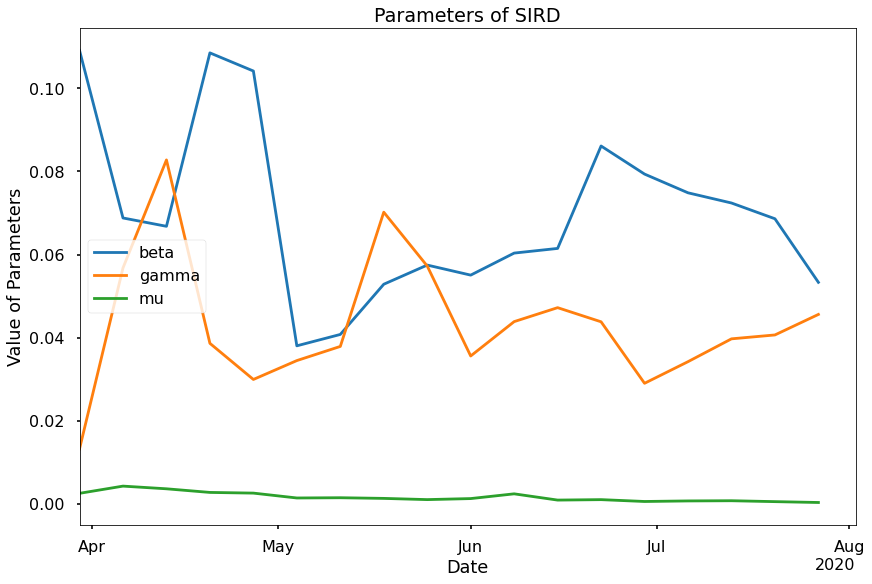

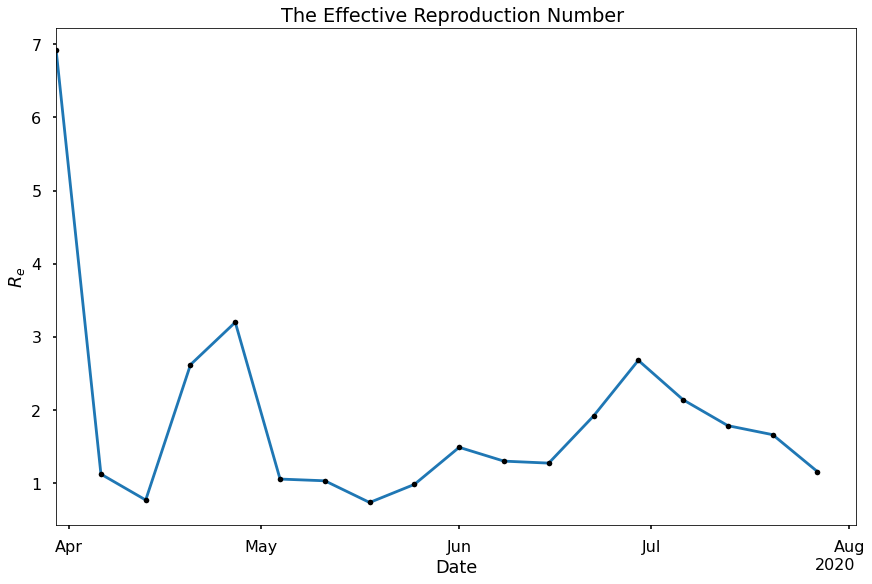

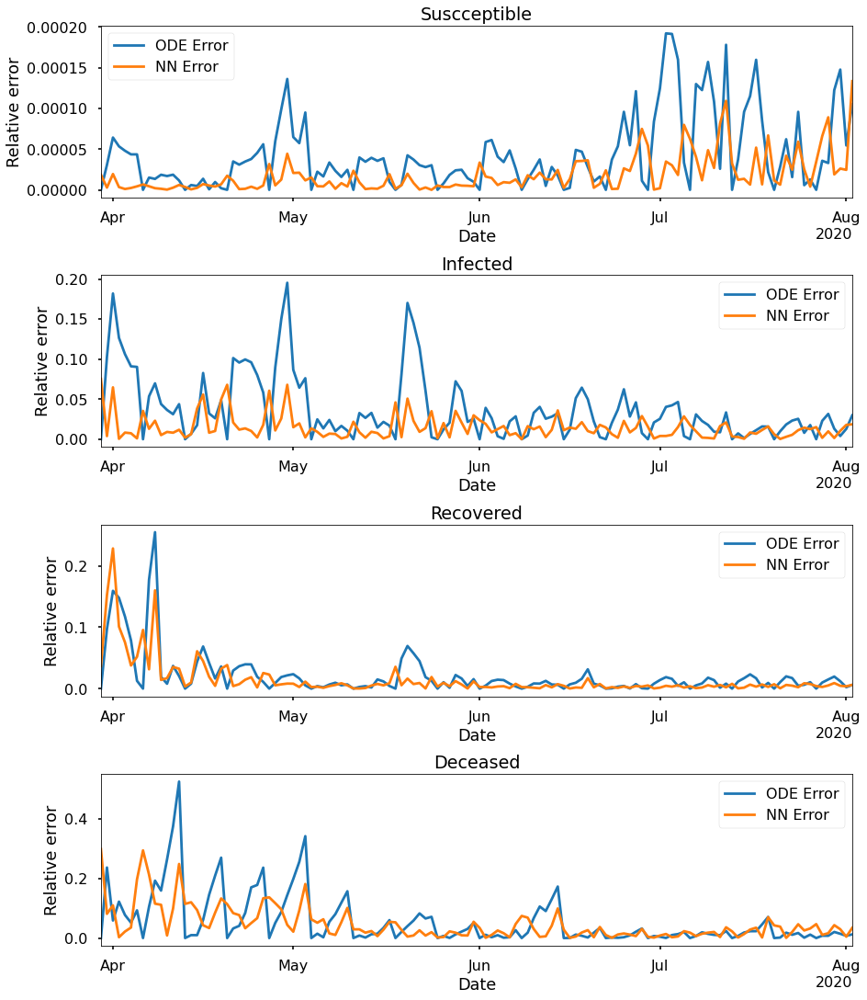

In [ ]:
layers332 = [1,32,32,32,4]
S332_ode,I332_ode,R332_ode,D332_ode,S332_learned,I332_learned,R332_learned,D332_learned,beta332,gamma332,mu332,S_errnn332,I_errnn332,R_errnn332,D_errnn332,S_erode332,I_errode332,R_errode332,D_errode332,time332 = sum_all(
    layers332,length,SS,II,RC,DC,N0,0.5,50000)

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.111e+00, GE_loss: 2.11391e+00,OB_loss: 9.97218e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 5.19, cumulative_time: 5.19
It: 10000, Loss: 4.929e-07, GE_loss: 1.60782e-07,OB_loss: 3.32086e-07, Beta: 1.03495e+00,gamma: 9.63969e-01,mu: 9.64182e-01, Time: 31.29, cumulative_time: 36.47
It: 20000, Loss: 1.298e-07, GE_loss: 3.67693e-08,OB_loss: 9.30094e-08, Beta: 1.04858e+00,gamma: 9.51527e-01,mu: 9.51651e-01, Time: 28.22, cumulative_time: 64.69
It: 30000, Loss: 8.061e-10, GE_loss: 5.26534e-11,OB_loss: 7.53467e-10, Beta: 1.04753e-01,gamma: 1.77535e-02,mu: 5.23065e-03, Time: 29.01, cumulative_time: 93.69
It: 40000, Loss: 3.738e-10, GE_loss: 6.58768e-11,OB_loss: 3.07926e-10, Beta: 1.04605e-01,gamma: 1.55685e-02,mu: 2.86617e-03, Time: 28.56, cumulative_time: 122.25
beta:  [0.10690616]
gamma:  [0.01571003]
mu:  [0.0026444]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


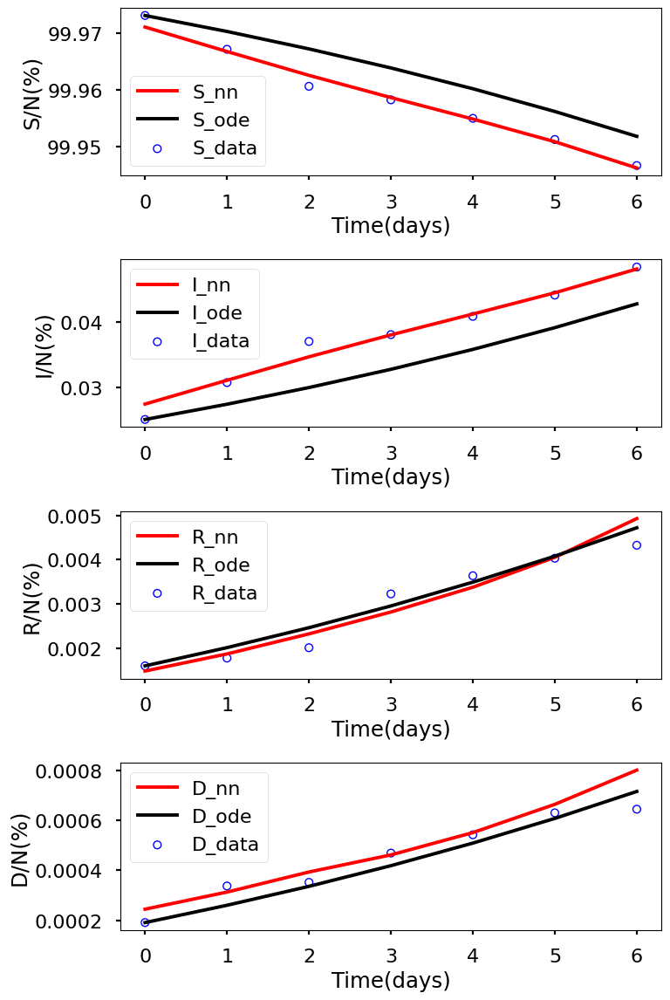

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.073e+00, GE_loss: 2.07774e+00,OB_loss: 9.95227e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 5.23, cumulative_time: 5.23
It: 10000, Loss: 6.992e-07, GE_loss: 2.86077e-07,OB_loss: 4.13156e-07, Beta: 1.03344e+00,gamma: 9.62084e-01,mu: 9.62265e-01, Time: 29.72, cumulative_time: 34.95
It: 20000, Loss: 2.409e-07, GE_loss: 7.23464e-08,OB_loss: 1.68558e-07, Beta: 1.04943e+00,gamma: 9.37917e-01,mu: 9.36504e-01, Time: 28.43, cumulative_time: 63.37
It: 30000, Loss: 1.338e-10, GE_loss: 3.48904e-11,OB_loss: 9.88714e-11, Beta: 6.95019e-02,gamma: 5.85858e-02,mu: 4.12711e-03, Time: 30.65, cumulative_time: 94.03
It: 40000, Loss: 1.196e-10, GE_loss: 3.09064e-11,OB_loss: 8.86532e-11, Beta: 6.83047e-02,gamma: 5.77772e-02,mu: 3.46497e-03, Time: 28.20, cumulative_time: 122.23
beta:  [0.0681381]
gamma:  [0.05766292]
mu:  [0.00321788]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


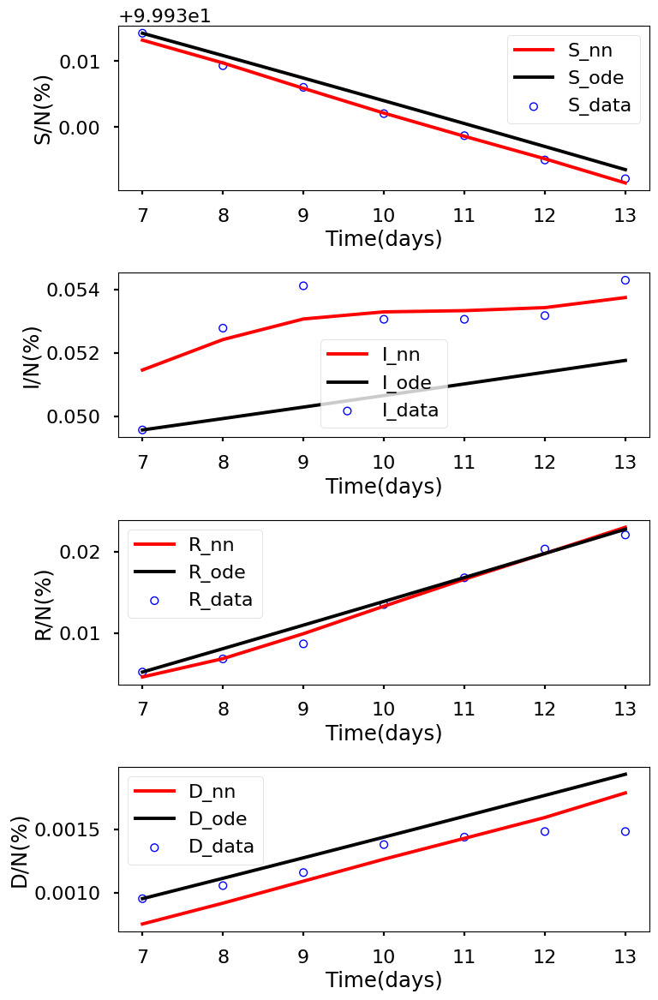

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.121e+00, GE_loss: 2.12789e+00,OB_loss: 9.93146e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 5.24, cumulative_time: 5.24
It: 10000, Loss: 6.619e-07, GE_loss: 2.74069e-07,OB_loss: 3.87783e-07, Beta: 1.03362e+00,gamma: 9.62896e-01,mu: 9.62793e-01, Time: 28.28, cumulative_time: 33.52
It: 20000, Loss: 2.340e-07, GE_loss: 6.85954e-08,OB_loss: 1.65444e-07, Beta: 1.05395e+00,gamma: 9.40174e-01,mu: 9.38008e-01, Time: 28.96, cumulative_time: 62.48
It: 30000, Loss: 5.150e-10, GE_loss: 3.60611e-11,OB_loss: 4.78943e-10, Beta: 7.09570e-02,gamma: 8.84542e-02,mu: 4.19220e-03, Time: 28.60, cumulative_time: 91.08
It: 40000, Loss: 4.469e-10, GE_loss: 2.03890e-11,OB_loss: 4.26506e-10, Beta: 6.80138e-02,gamma: 8.55646e-02,mu: 3.78995e-03, Time: 29.17, cumulative_time: 120.26
beta:  [0.06748836]
gamma:  [0.08485965]
mu:  [0.00369979]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


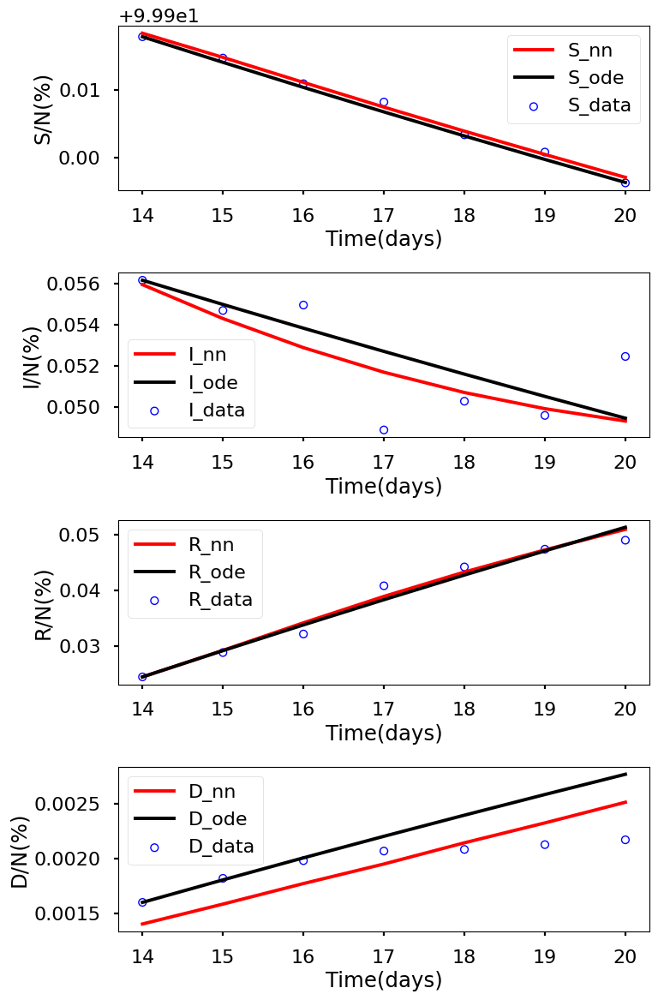

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.125e+00, GE_loss: 2.12823e+00,OB_loss: 9.96631e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 5.59, cumulative_time: 5.59
It: 10000, Loss: 5.005e-07, GE_loss: 2.74169e-07,OB_loss: 2.26356e-07, Beta: 1.03691e+00,gamma: 9.59992e-01,mu: 9.59893e-01, Time: 30.81, cumulative_time: 36.40
It: 20000, Loss: 2.900e-07, GE_loss: 8.87818e-08,OB_loss: 2.01217e-07, Beta: 1.06458e+00,gamma: 9.31077e-01,mu: 9.25978e-01, Time: 30.25, cumulative_time: 66.65
It: 30000, Loss: 2.474e-10, GE_loss: 4.17690e-11,OB_loss: 2.05586e-10, Beta: 1.11085e-01,gamma: 3.75094e-02,mu: 8.18637e-03, Time: 29.44, cumulative_time: 96.09
It: 40000, Loss: 1.876e-10, GE_loss: 3.76735e-11,OB_loss: 1.49901e-10, Beta: 1.09779e-01,gamma: 3.68173e-02,mu: 5.95606e-03, Time: 29.23, cumulative_time: 125.32
beta:  [0.10944242]
gamma:  [0.0370153]
mu:  [0.00492048]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


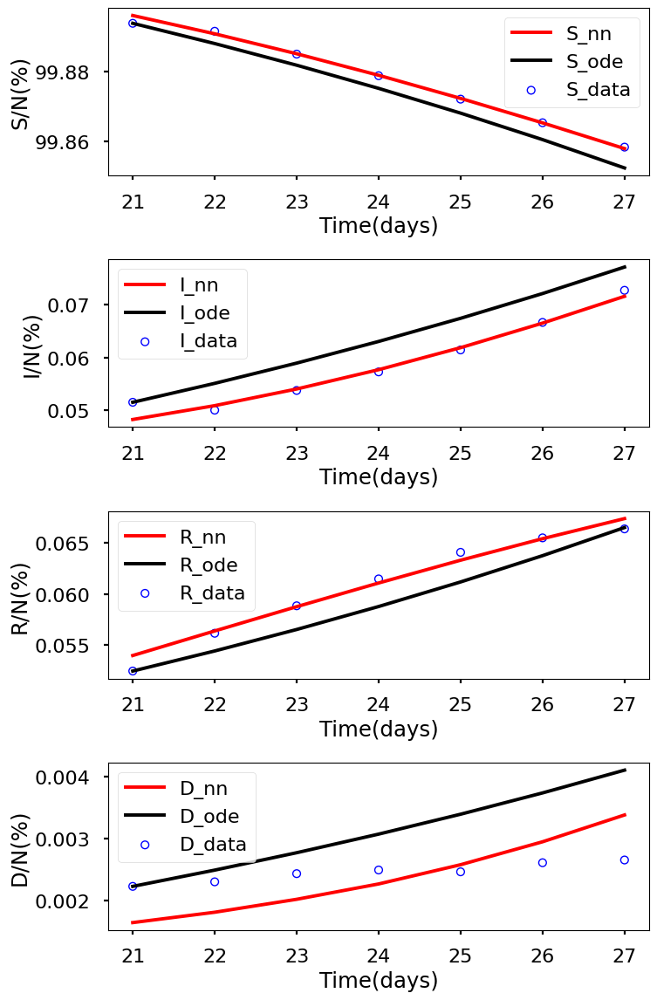

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.119e+00, GE_loss: 2.12288e+00,OB_loss: 9.95952e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 5.78, cumulative_time: 5.78
It: 10000, Loss: 7.360e-07, GE_loss: 2.54281e-07,OB_loss: 4.81703e-07, Beta: 1.03676e+00,gamma: 9.62454e-01,mu: 9.62418e-01, Time: 30.60, cumulative_time: 36.38
It: 20000, Loss: 5.722e-07, GE_loss: 1.77598e-07,OB_loss: 3.94561e-07, Beta: 1.10754e+00,gamma: 9.00252e-01,mu: 8.92142e-01, Time: 29.66, cumulative_time: 66.04
It: 30000, Loss: 1.835e-09, GE_loss: 3.95732e-10,OB_loss: 1.43929e-09, Beta: 1.09197e-01,gamma: 2.92776e-02,mu: 5.99188e-03, Time: 29.32, cumulative_time: 95.36
It: 40000, Loss: 1.709e-09, GE_loss: 4.34261e-10,OB_loss: 1.27429e-09, Beta: 1.08180e-01,gamma: 2.97163e-02,mu: 4.40898e-03, Time: 28.92, cumulative_time: 124.28
beta:  [0.10869547]
gamma:  [0.032705]
mu:  [0.00311975]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


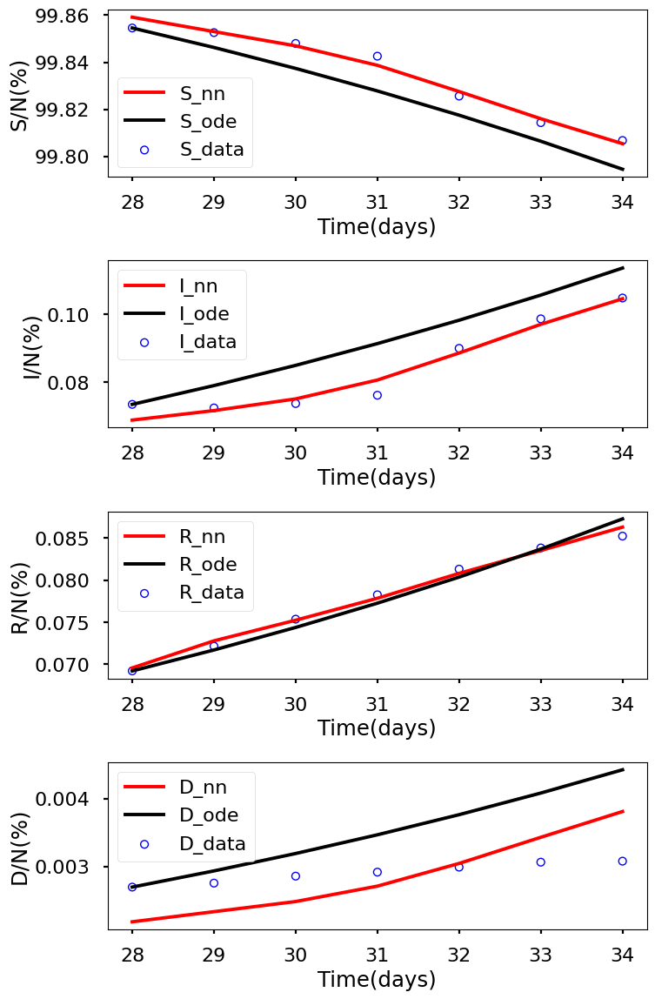

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.067e+00, GE_loss: 2.07746e+00,OB_loss: 9.89795e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 5.66, cumulative_time: 5.66
It: 10000, Loss: 1.163e-06, GE_loss: 4.52094e-07,OB_loss: 7.11016e-07, Beta: 1.03842e+00,gamma: 9.56957e-01,mu: 9.57072e-01, Time: 30.14, cumulative_time: 35.80
It: 20000, Loss: 8.794e-07, GE_loss: 2.77560e-07,OB_loss: 6.01829e-07, Beta: 1.05902e+00,gamma: 8.71846e-01,mu: 8.60492e-01, Time: 29.09, cumulative_time: 64.89
It: 30000, Loss: 1.288e-10, GE_loss: 2.33564e-11,OB_loss: 1.05399e-10, Beta: 3.90539e-02,gamma: 3.49720e-02,mu: 1.71004e-03, Time: 31.96, cumulative_time: 96.86
It: 40000, Loss: 1.001e-10, GE_loss: 8.25897e-12,OB_loss: 9.18756e-11, Beta: 3.82644e-02,gamma: 3.42897e-02,mu: 1.32863e-03, Time: 28.72, cumulative_time: 125.57
beta:  [0.03805157]
gamma:  [0.03418975]
mu:  [0.00116833]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


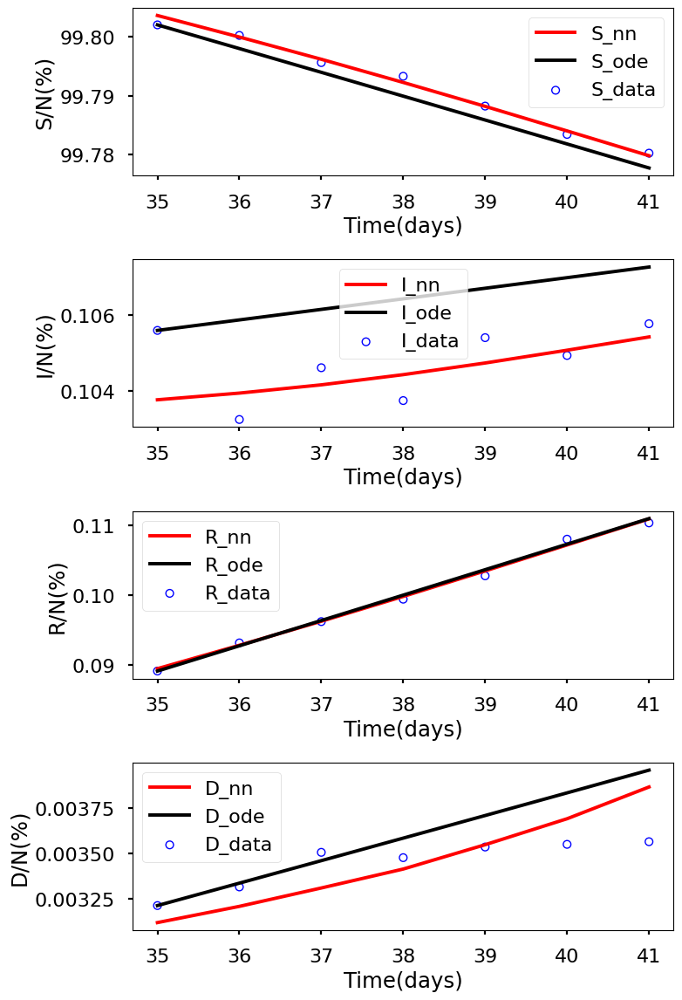

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.031e+00, GE_loss: 2.03983e+00,OB_loss: 9.91388e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 5.55, cumulative_time: 5.55
It: 10000, Loss: 1.105e-06, GE_loss: 3.17507e-07,OB_loss: 7.87276e-07, Beta: 1.03429e+00,gamma: 9.64708e-01,mu: 9.64704e-01, Time: 29.00, cumulative_time: 34.55
It: 20000, Loss: 9.565e-07, GE_loss: 3.12512e-07,OB_loss: 6.43975e-07, Beta: 1.05668e+00,gamma: 8.58292e-01,mu: 8.44837e-01, Time: 28.81, cumulative_time: 63.36
It: 30000, Loss: 2.249e-10, GE_loss: 1.71632e-11,OB_loss: 2.07786e-10, Beta: 3.90486e-02,gamma: 3.71029e-02,mu: 2.27960e-03, Time: 28.90, cumulative_time: 92.25
It: 40000, Loss: 1.658e-10, GE_loss: 1.78764e-11,OB_loss: 1.47920e-10, Beta: 3.92715e-02,gamma: 3.77881e-02,mu: 1.44029e-03, Time: 28.30, cumulative_time: 120.56
beta:  [0.03953677]
gamma:  [0.03810062]
mu:  [0.00115276]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


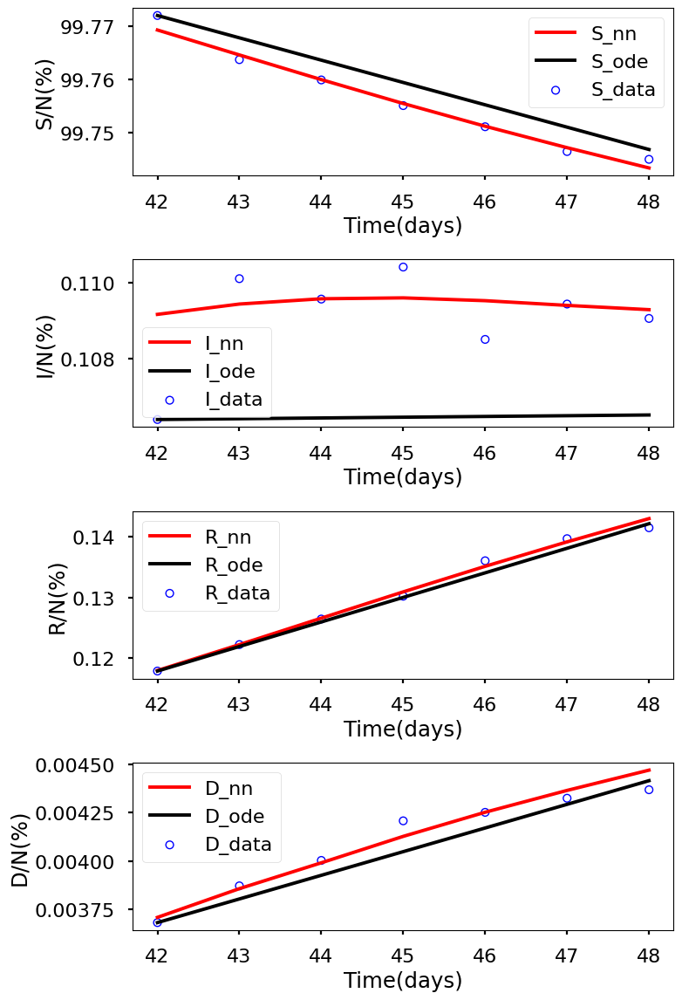

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.103e+00, GE_loss: 2.11413e+00,OB_loss: 9.88621e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 6.02, cumulative_time: 6.02
It: 10000, Loss: 9.369e-07, GE_loss: 3.15810e-07,OB_loss: 6.21075e-07, Beta: 1.03279e+00,gamma: 9.64466e-01,mu: 9.64319e-01, Time: 27.81, cumulative_time: 33.83
It: 20000, Loss: 7.817e-07, GE_loss: 2.46664e-07,OB_loss: 5.35020e-07, Beta: 1.06039e+00,gamma: 8.80465e-01,mu: 8.62911e-01, Time: 27.96, cumulative_time: 61.79
It: 30000, Loss: 2.771e-09, GE_loss: 9.33214e-10,OB_loss: 1.83804e-09, Beta: 5.50492e-02,gamma: 6.85413e-02,mu: 4.73181e-03, Time: 28.44, cumulative_time: 90.23
It: 40000, Loss: 2.689e-09, GE_loss: 1.05009e-09,OB_loss: 1.63895e-09, Beta: 5.28202e-02,gamma: 6.80180e-02,mu: 3.39832e-03, Time: 27.82, cumulative_time: 118.05
beta:  [0.05242979]
gamma:  [0.06815666]
mu:  [0.00282757]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


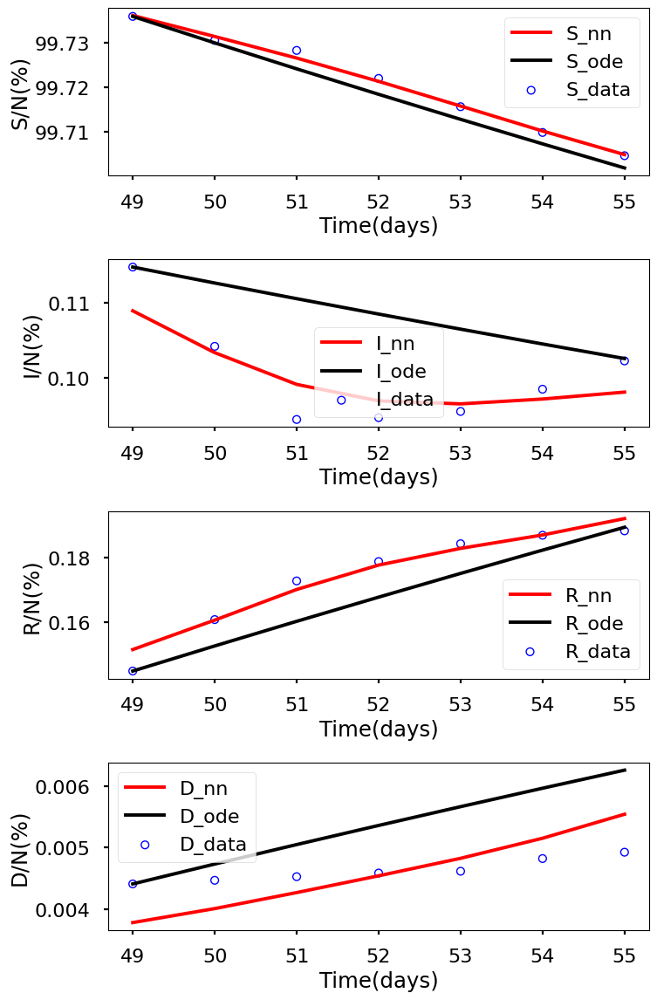

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.104e+00, GE_loss: 2.11549e+00,OB_loss: 9.88659e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 5.57, cumulative_time: 5.57
It: 10000, Loss: 9.957e-07, GE_loss: 3.57314e-07,OB_loss: 6.38388e-07, Beta: 1.03774e+00,gamma: 9.60392e-01,mu: 9.60040e-01, Time: 29.75, cumulative_time: 35.32
It: 20000, Loss: 8.268e-07, GE_loss: 2.69042e-07,OB_loss: 5.57713e-07, Beta: 1.06240e+00,gamma: 8.79371e-01,mu: 8.57505e-01, Time: 28.75, cumulative_time: 64.06
It: 30000, Loss: 1.252e-09, GE_loss: 2.74601e-10,OB_loss: 9.77173e-10, Beta: 5.82354e-02,gamma: 5.97471e-02,mu: 4.09963e-03, Time: 28.62, cumulative_time: 92.69
It: 40000, Loss: 1.251e-09, GE_loss: 4.10999e-10,OB_loss: 8.39573e-10, Beta: 5.76052e-02,gamma: 5.85414e-02,mu: 3.01549e-03, Time: 27.99, cumulative_time: 120.68
beta:  [0.05766978]
gamma:  [0.05849288]
mu:  [0.0023581]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


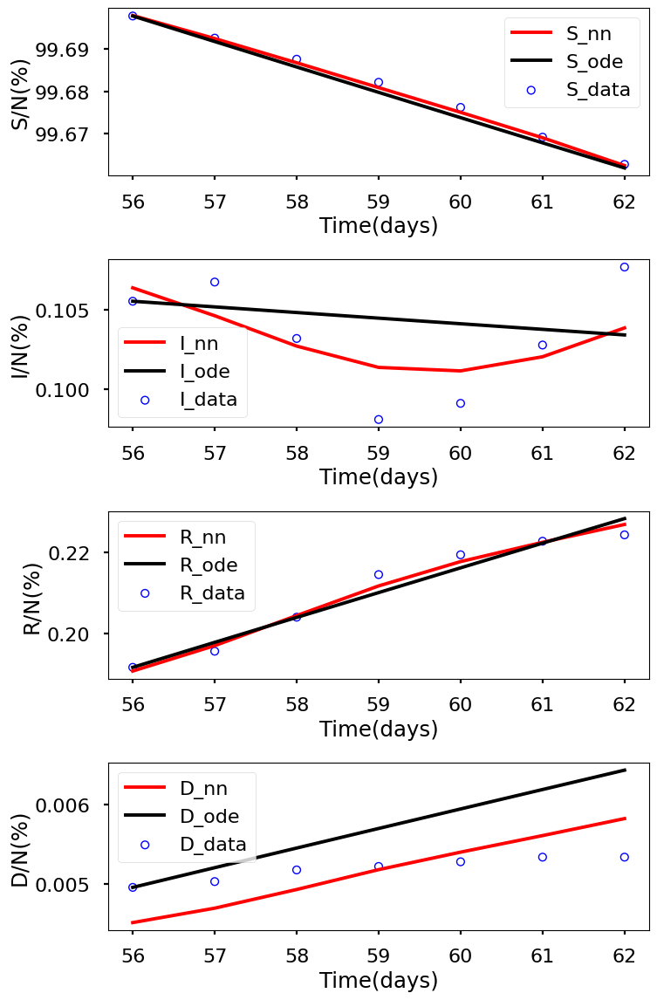

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.076e+00, GE_loss: 2.08981e+00,OB_loss: 9.86061e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 5.94, cumulative_time: 5.94
It: 10000, Loss: 1.298e-06, GE_loss: 3.79902e-07,OB_loss: 9.18083e-07, Beta: 1.03376e+00,gamma: 9.63452e-01,mu: 9.63269e-01, Time: 28.74, cumulative_time: 34.68
It: 20000, Loss: 1.116e-06, GE_loss: 3.68819e-07,OB_loss: 7.47132e-07, Beta: 1.05658e+00,gamma: 8.37750e-01,mu: 8.13128e-01, Time: 28.92, cumulative_time: 63.60
It: 30000, Loss: 5.496e-10, GE_loss: 8.80236e-11,OB_loss: 4.61622e-10, Beta: 5.45893e-02,gamma: 3.55321e-02,mu: 3.23240e-03, Time: 30.27, cumulative_time: 93.87
It: 40000, Loss: 5.264e-10, GE_loss: 6.74079e-11,OB_loss: 4.59018e-10, Beta: 5.42285e-02,gamma: 3.54868e-02,mu: 2.45349e-03, Time: 29.30, cumulative_time: 123.17
beta:  [0.05424022]
gamma:  [0.03557909]
mu:  [0.0021698]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


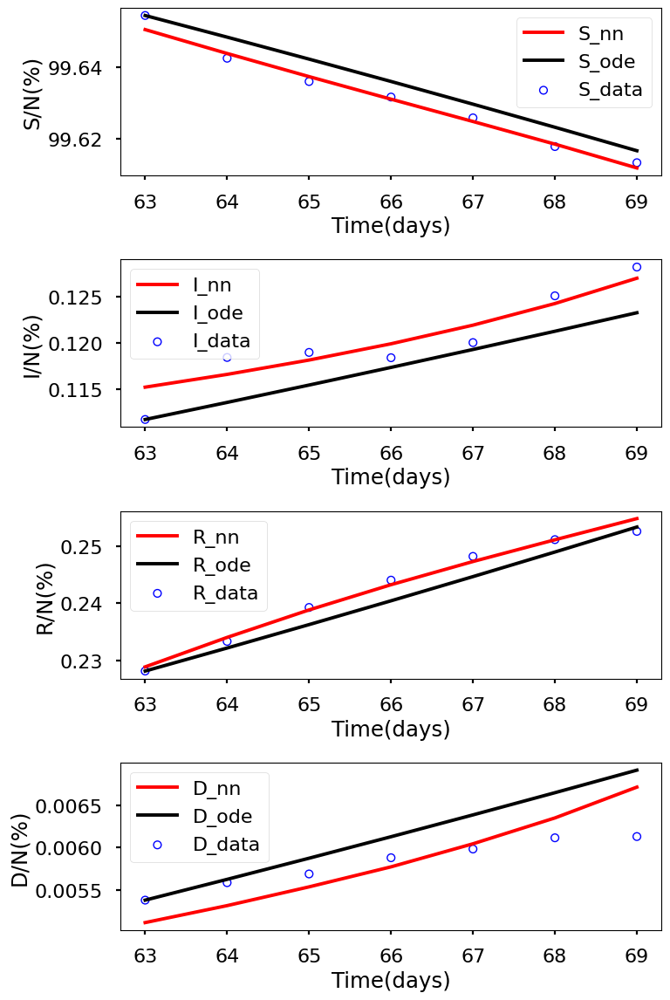

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.056e+00, GE_loss: 2.07288e+00,OB_loss: 9.83421e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 5.83, cumulative_time: 5.83
It: 10000, Loss: 1.621e-06, GE_loss: 5.24941e-07,OB_loss: 1.09622e-06, Beta: 1.03617e+00,gamma: 9.62436e-01,mu: 9.62169e-01, Time: 28.94, cumulative_time: 34.78
It: 20000, Loss: 1.330e-06, GE_loss: 4.55735e-07,OB_loss: 8.73792e-07, Beta: 1.05119e+00,gamma: 8.01321e-01,mu: 7.70256e-01, Time: 28.16, cumulative_time: 62.93
It: 30000, Loss: 9.500e-10, GE_loss: 1.98695e-10,OB_loss: 7.51286e-10, Beta: 5.90939e-02,gamma: 4.56138e-02,mu: 2.74685e-03, Time: 28.11, cumulative_time: 91.05
It: 40000, Loss: 8.142e-10, GE_loss: 1.67159e-10,OB_loss: 6.47065e-10, Beta: 5.82555e-02,gamma: 4.51274e-02,mu: 1.87922e-03, Time: 28.30, cumulative_time: 119.34
beta:  [0.05812694]
gamma:  [0.04480778]
mu:  [0.00162404]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


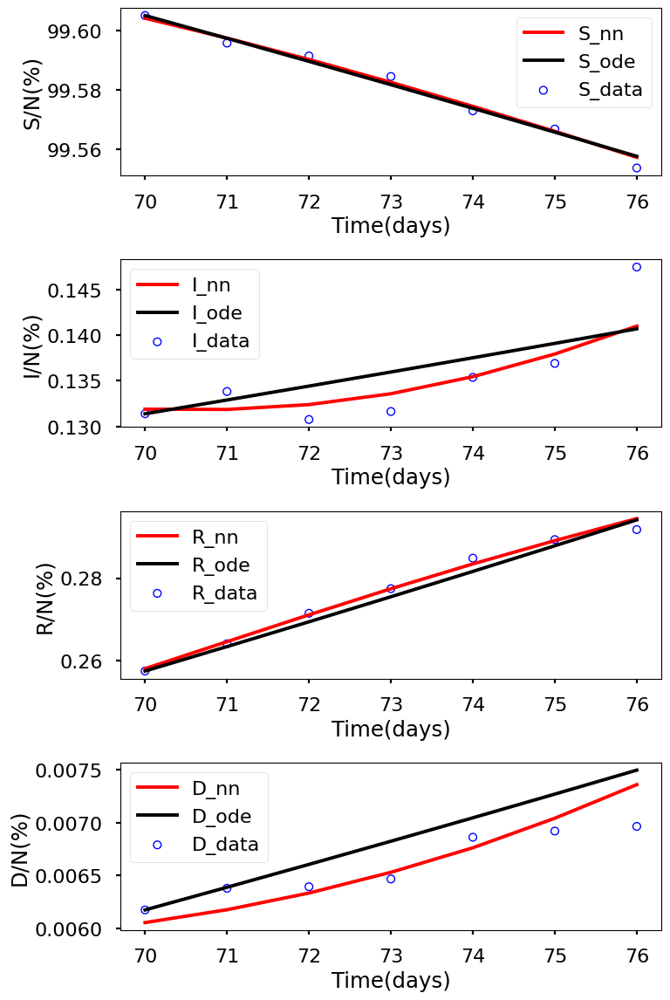

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.055e+00, GE_loss: 2.07303e+00,OB_loss: 9.82016e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 5.90, cumulative_time: 5.90
It: 10000, Loss: 2.140e-06, GE_loss: 6.19090e-07,OB_loss: 1.52104e-06, Beta: 1.03825e+00,gamma: 9.59965e-01,mu: 9.59607e-01, Time: 28.07, cumulative_time: 33.96
It: 20000, Loss: 1.597e-06, GE_loss: 5.97305e-07,OB_loss: 1.00017e-06, Beta: 9.97182e-01,gamma: 7.54094e-01,mu: 7.00414e-01, Time: 27.86, cumulative_time: 61.82
It: 30000, Loss: 2.606e-09, GE_loss: 4.50758e-10,OB_loss: 2.15549e-09, Beta: 6.17689e-02,gamma: 4.90004e-02,mu: 2.35843e-03, Time: 28.32, cumulative_time: 90.15
It: 40000, Loss: 2.728e-09, GE_loss: 8.20702e-10,OB_loss: 1.90699e-09, Beta: 6.09249e-02,gamma: 4.81531e-02,mu: 5.28956e-04, Time: 28.48, cumulative_time: 118.63
beta:  [0.0610109]
gamma:  [0.04782134]
mu:  [0.00054794]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


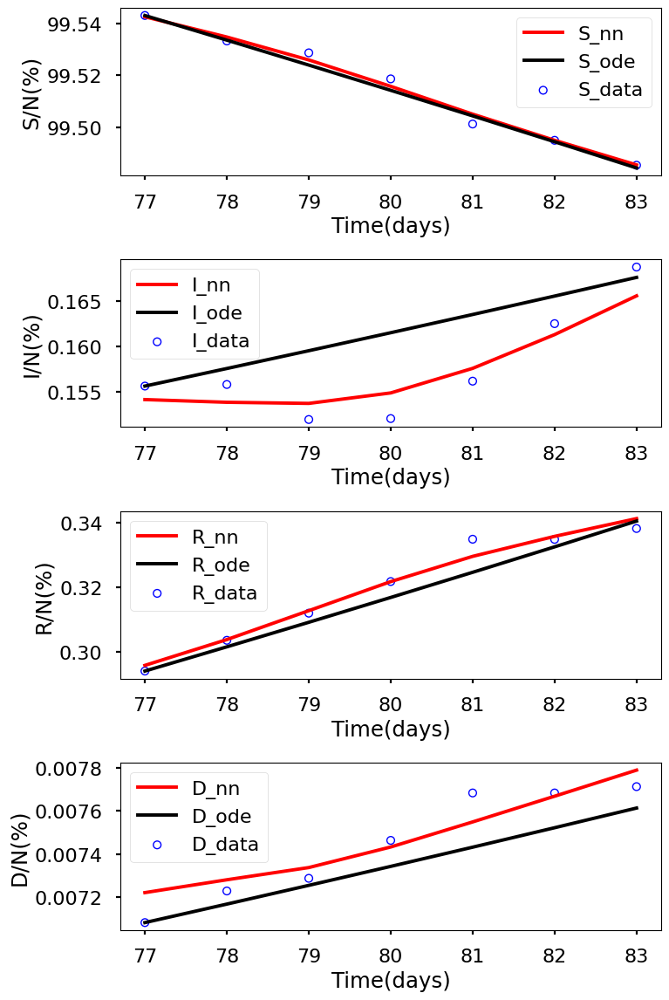

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.078e+00, GE_loss: 2.09199e+00,OB_loss: 9.86061e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 6.24, cumulative_time: 6.24
It: 10000, Loss: 2.941e-06, GE_loss: 9.16100e-07,OB_loss: 2.02522e-06, Beta: 1.04066e+00,gamma: 9.55695e-01,mu: 9.54985e-01, Time: 30.25, cumulative_time: 36.49
It: 20000, Loss: 1.911e-06, GE_loss: 7.99045e-07,OB_loss: 1.11211e-06, Beta: 9.40181e-01,gamma: 6.51127e-01,mu: 6.08872e-01, Time: 28.86, cumulative_time: 65.36
It: 30000, Loss: 1.447e-09, GE_loss: 1.89610e-10,OB_loss: 1.25743e-09, Beta: 8.45108e-02,gamma: 4.21344e-02,mu: 3.33827e-03, Time: 29.09, cumulative_time: 94.44
It: 40000, Loss: 1.381e-09, GE_loss: 1.87540e-10,OB_loss: 1.19311e-09, Beta: 8.40538e-02,gamma: 4.23310e-02,mu: 2.20744e-03, Time: 29.31, cumulative_time: 123.75
beta:  [0.08390939]
gamma:  [0.04256049]
mu:  [0.00170602]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


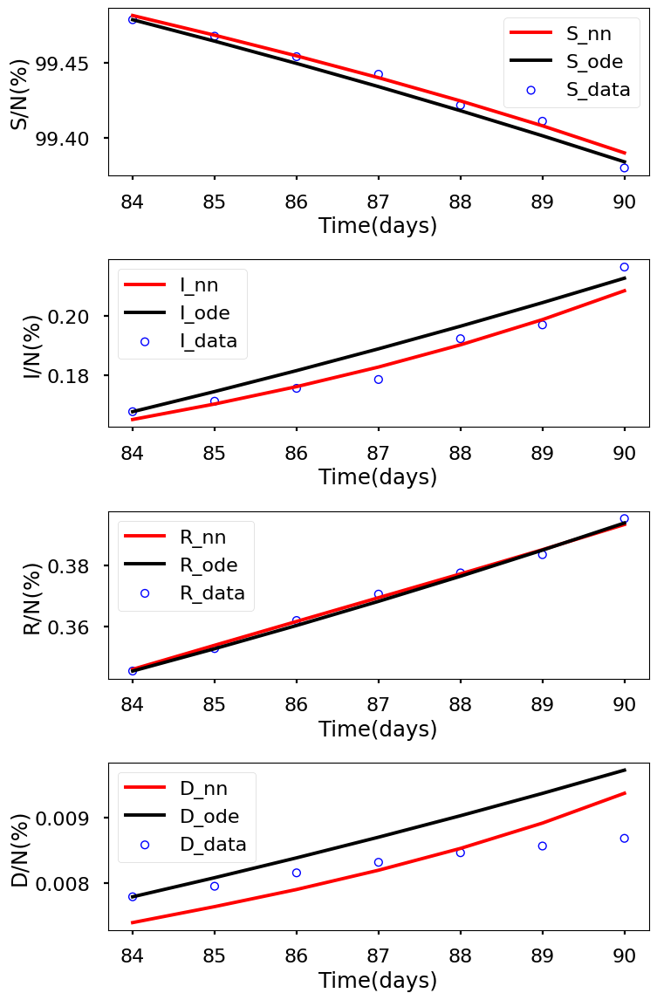

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.038e+00, GE_loss: 2.06013e+00,OB_loss: 9.78302e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 5.88, cumulative_time: 5.88
It: 10000, Loss: 6.367e-06, GE_loss: 1.80989e-06,OB_loss: 4.55685e-06, Beta: 1.03660e+00,gamma: 9.62801e-01,mu: 9.62076e-01, Time: 28.66, cumulative_time: 34.54
It: 20000, Loss: 1.314e-07, GE_loss: 9.49716e-08,OB_loss: 3.63996e-08, Beta: 1.81398e-01,gamma: 1.19654e-01,mu: 6.36473e-02, Time: 29.25, cumulative_time: 63.79
It: 30000, Loss: 2.845e-09, GE_loss: 1.01683e-09,OB_loss: 1.82847e-09, Beta: 8.04659e-02,gamma: 2.81428e-02,mu: 1.38090e-03, Time: 31.10, cumulative_time: 94.90
It: 40000, Loss: 2.637e-09, GE_loss: 9.29082e-10,OB_loss: 1.70785e-09, Beta: 8.03064e-02,gamma: 2.83262e-02,mu: 6.85015e-04, Time: 28.67, cumulative_time: 123.57
beta:  [0.08032316]
gamma:  [0.02835179]
mu:  [0.00064903]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


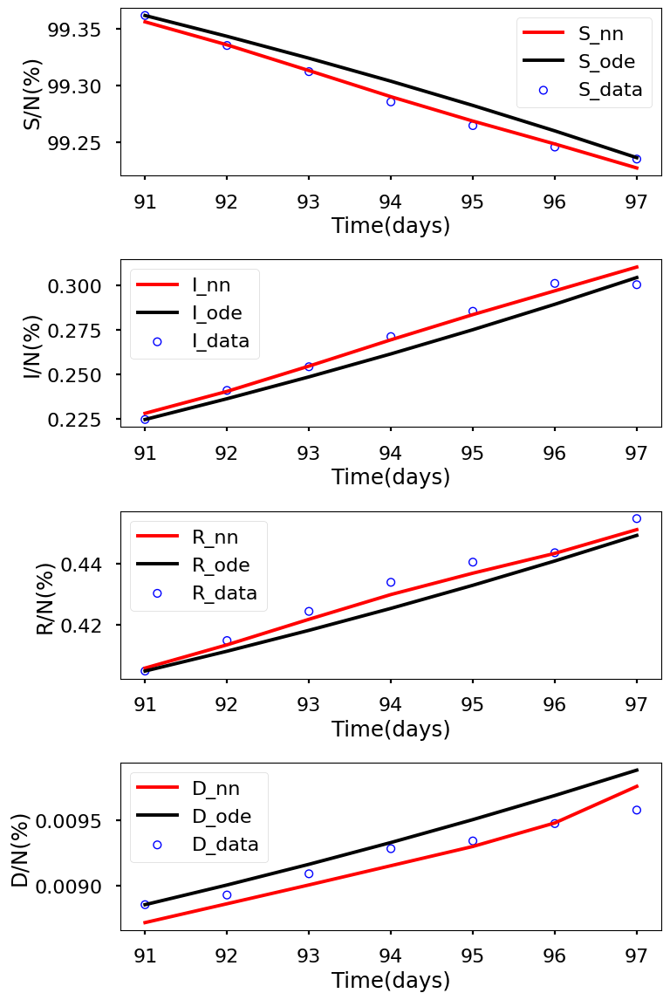

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.041e+00, GE_loss: 2.06168e+00,OB_loss: 9.79491e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 5.93, cumulative_time: 5.93
It: 10000, Loss: 1.073e-05, GE_loss: 3.15966e-06,OB_loss: 7.56923e-06, Beta: 1.04541e+00,gamma: 9.52441e-01,mu: 9.51487e-01, Time: 28.49, cumulative_time: 34.42
It: 20000, Loss: 7.621e-09, GE_loss: 2.35085e-09,OB_loss: 5.27021e-09, Beta: 7.84270e-02,gamma: 4.50675e-02,mu: 4.44368e-03, Time: 28.52, cumulative_time: 62.94
It: 30000, Loss: 3.929e-09, GE_loss: 6.76187e-10,OB_loss: 3.25310e-09, Beta: 7.17161e-02,gamma: 3.36077e-02,mu: 1.73521e-03, Time: 29.03, cumulative_time: 91.97
It: 40000, Loss: 3.811e-09, GE_loss: 7.50390e-10,OB_loss: 3.06095e-09, Beta: 7.13120e-02,gamma: 3.36040e-02,mu: 7.96224e-04, Time: 29.24, cumulative_time: 121.21
beta:  [0.07130598]
gamma:  [0.03361229]
mu:  [0.00076955]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


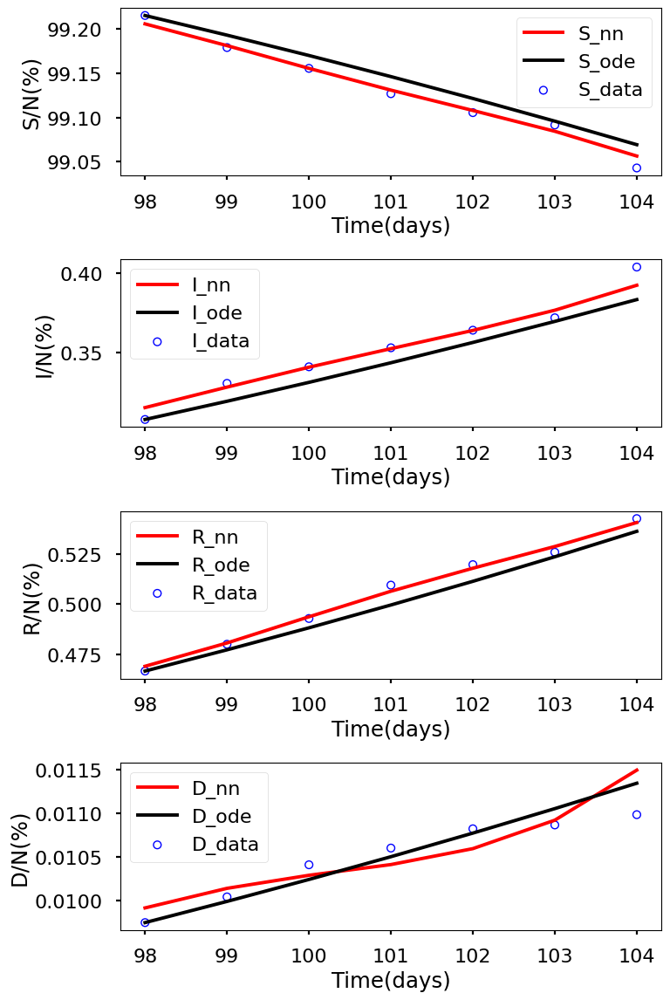

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.033e+00, GE_loss: 2.06306e+00,OB_loss: 9.70227e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 6.07, cumulative_time: 6.07
It: 10000, Loss: 1.710e-05, GE_loss: 4.99374e-06,OB_loss: 1.21052e-05, Beta: 1.04577e+00,gamma: 9.50886e-01,mu: 9.49148e-01, Time: 28.93, cumulative_time: 35.00
It: 20000, Loss: 6.379e-09, GE_loss: 1.31031e-09,OB_loss: 5.06906e-09, Beta: 7.51303e-02,gamma: 3.82842e-02,mu: 4.68709e-03, Time: 29.14, cumulative_time: 64.15
It: 30000, Loss: 4.138e-09, GE_loss: 1.12029e-09,OB_loss: 3.01798e-09, Beta: 7.28564e-02,gamma: 3.84386e-02,mu: 8.78638e-04, Time: 29.41, cumulative_time: 93.56
It: 40000, Loss: 3.951e-09, GE_loss: 1.25003e-09,OB_loss: 2.70089e-09, Beta: 7.29050e-02,gamma: 3.86366e-02,mu: 7.14763e-04, Time: 30.14, cumulative_time: 123.70
beta:  [0.07291089]
gamma:  [0.03867448]
mu:  [0.00068777]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


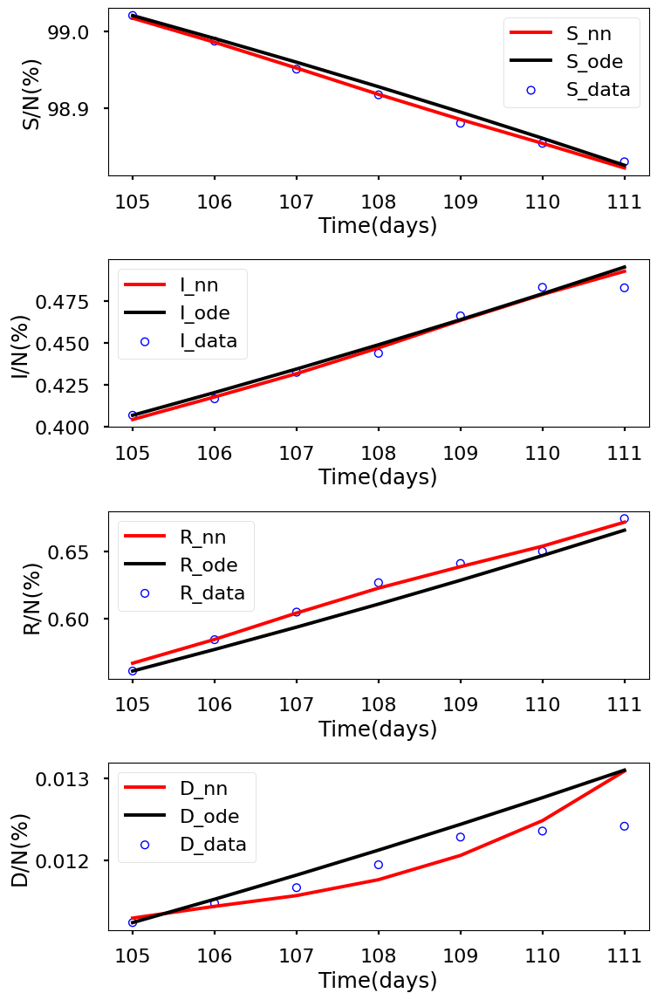

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.068e+00, GE_loss: 2.10131e+00,OB_loss: 9.66237e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 6.43, cumulative_time: 6.43
It: 10000, Loss: 2.318e-05, GE_loss: 6.81514e-06,OB_loss: 1.63647e-05, Beta: 1.04984e+00,gamma: 9.48437e-01,mu: 9.46077e-01, Time: 28.45, cumulative_time: 34.88
It: 20000, Loss: 1.043e-08, GE_loss: 3.50908e-09,OB_loss: 6.92373e-09, Beta: 6.93920e-02,gamma: 3.85649e-02,mu: 3.85314e-03, Time: 28.20, cumulative_time: 63.09
It: 30000, Loss: 6.645e-09, GE_loss: 1.74881e-09,OB_loss: 4.89665e-09, Beta: 6.90486e-02,gamma: 3.88363e-02,mu: 1.96113e-03, Time: 28.81, cumulative_time: 91.89
It: 40000, Loss: 7.255e-09, GE_loss: 2.67644e-09,OB_loss: 4.57903e-09, Beta: 6.87217e-02,gamma: 3.89123e-02,mu: 1.14583e-03, Time: 28.97, cumulative_time: 120.86
beta:  [0.06860139]
gamma:  [0.03889535]
mu:  [0.00080845]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


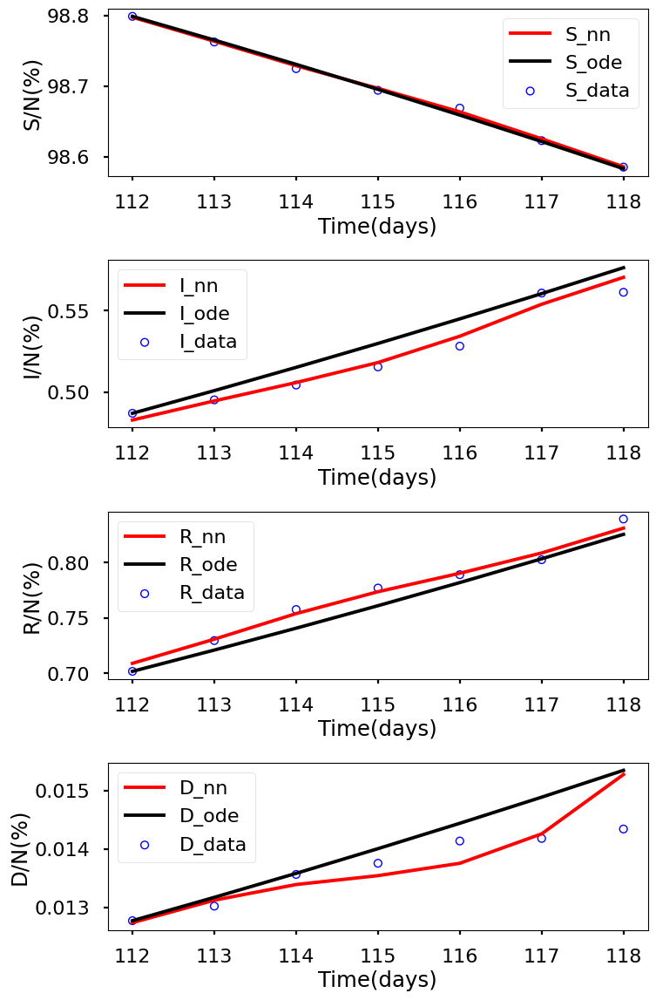

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.054e+00, GE_loss: 2.08947e+00,OB_loss: 9.64927e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 6.20, cumulative_time: 6.20
It: 10000, Loss: 2.739e-05, GE_loss: 8.13708e-06,OB_loss: 1.92510e-05, Beta: 1.05281e+00,gamma: 9.44215e-01,mu: 9.41821e-01, Time: 29.48, cumulative_time: 35.67
It: 20000, Loss: 1.336e-08, GE_loss: 2.37362e-09,OB_loss: 1.09816e-08, Beta: 5.65609e-02,gamma: 4.42138e-02,mu: 3.01351e-03, Time: 32.00, cumulative_time: 67.68
It: 30000, Loss: 1.239e-08, GE_loss: 4.95233e-09,OB_loss: 7.43751e-09, Beta: 5.44395e-02,gamma: 4.40102e-02,mu: 6.92282e-04, Time: 29.71, cumulative_time: 97.38
It: 40000, Loss: 1.607e-08, GE_loss: 7.75994e-09,OB_loss: 8.31294e-09, Beta: 5.44878e-02,gamma: 4.40381e-02,mu: 5.57235e-04, Time: 29.51, cumulative_time: 126.89
beta:  [0.05443528]
gamma:  [0.04405743]
mu:  [0.00053376]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


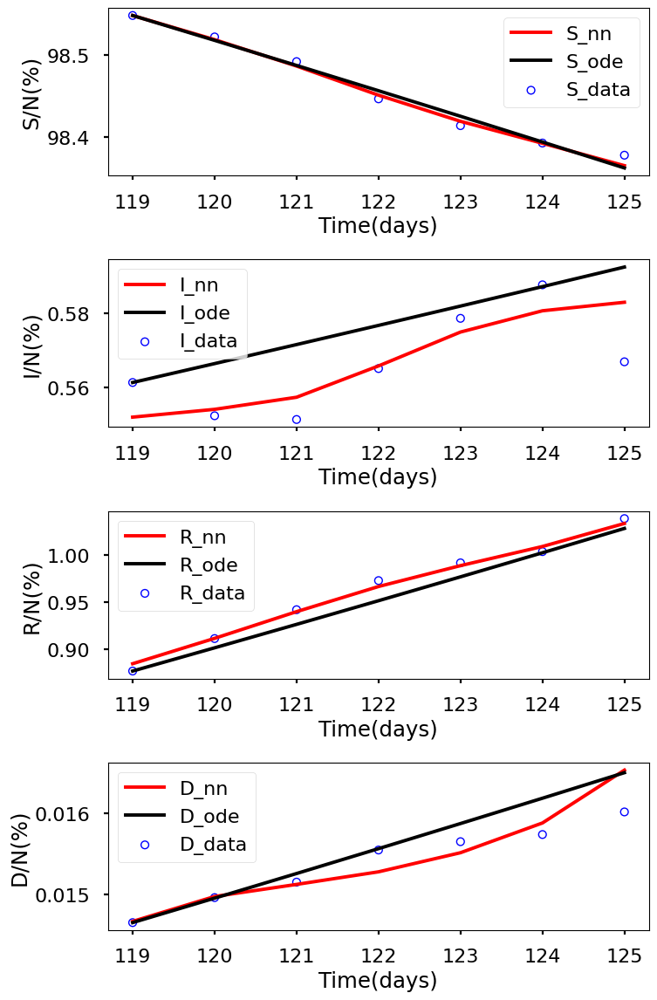

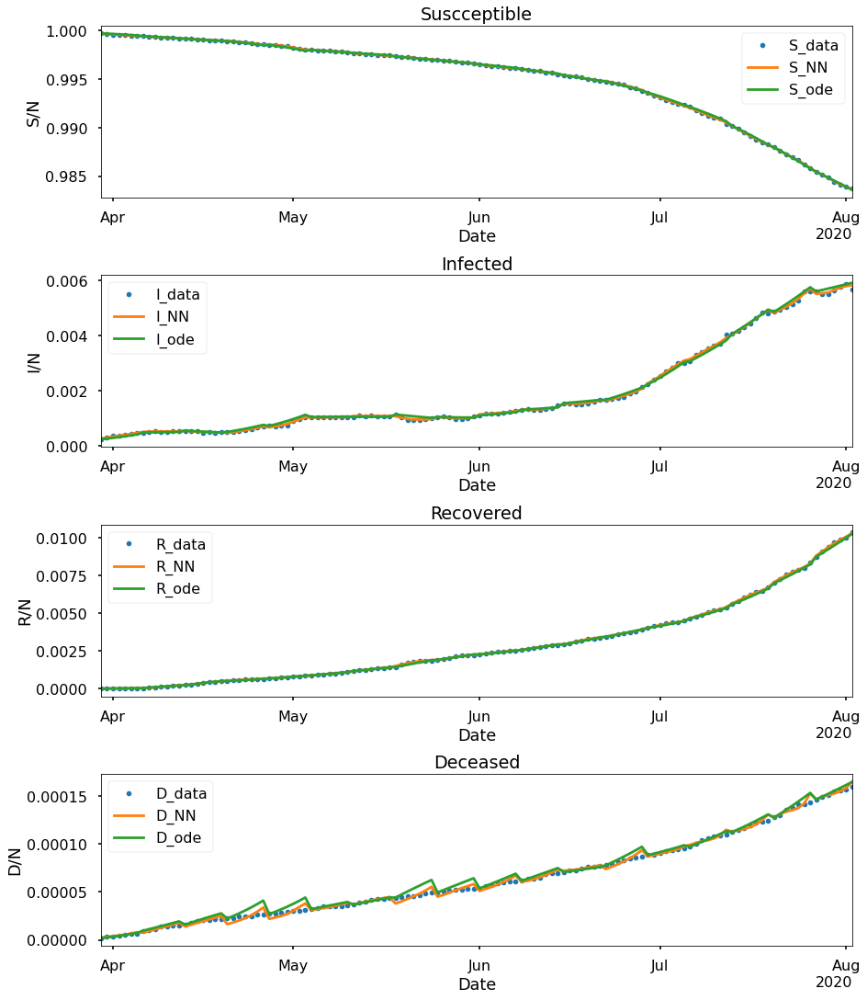

+---------------------+-------------+--------------+--------------+--------------+--------------+--------------+--------------+--------------+--------------+--------------+-------------+---------------+--------------+--------------+---------------+---------------+--------------+--------------+
|      Paramaters     |    Week 1   |    Week 2    |    Week 3    |    Week 4    |    Week 5    |    Week 6    |    Week 7    |    Week 8    |    Week 9    |   Week 10    |   Week 11   |    Week 12    |   Week 13    |   Week 14    |    Week 15    |    Week 16    |   Week 17    |   Week 18    |
+---------------------+-------------+--------------+--------------+--------------+--------------+--------------+--------------+--------------+--------------+--------------+-------------+---------------+--------------+--------------+---------------+---------------+--------------+--------------+
|         beta        |  0.10690616 |  0.0681381   | 0.067488365  |  0.10944242  |  0.10869547  | 0.038051568  | 0.

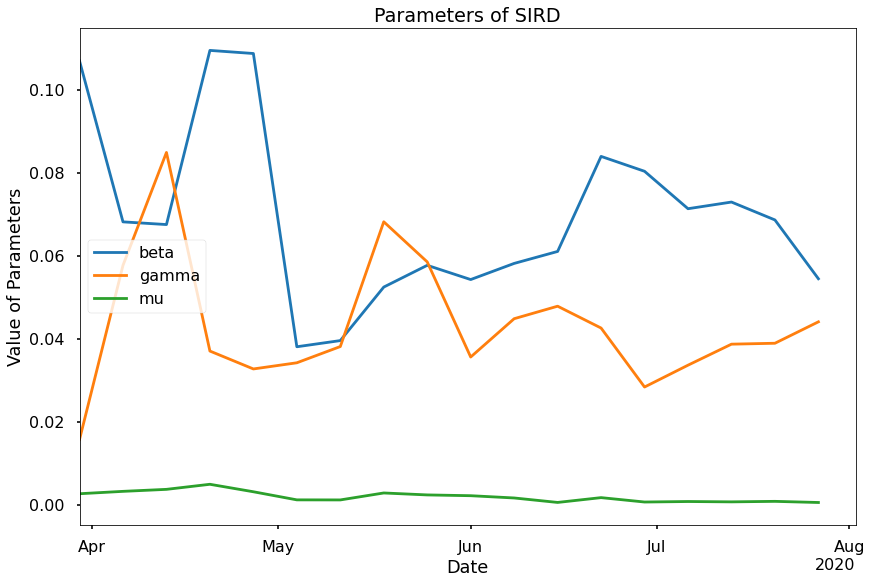

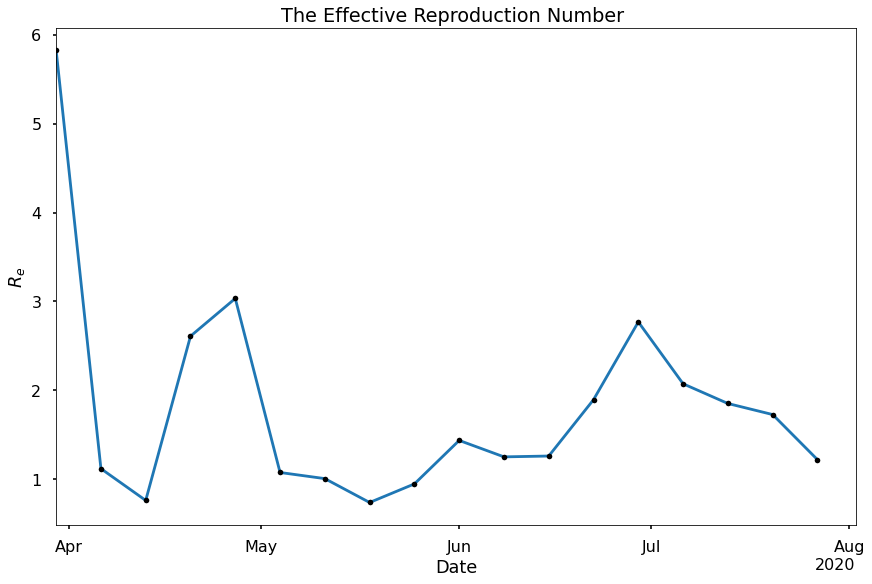

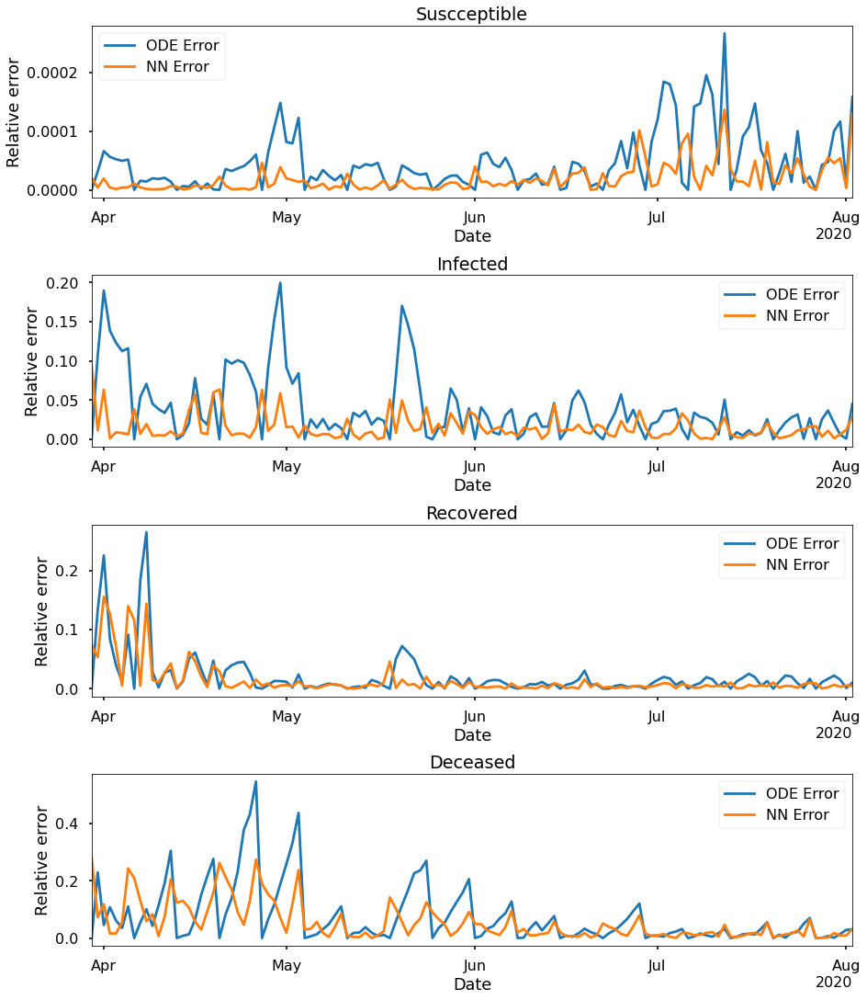

In [ ]:
layers432 = [1,32,32,32,32,4]
S432_ode,I432_ode,R432_ode,D432_ode,S432_learned,I432_learned,R432_learned,D432_learned,beta432,gamma432,mu432,S_errnn432,I_errnn432,R_errnn432,D_errnn432,S_erode432,I_errode432,R_errode432,D_errode432,time432 = sum_all(
    layers432,length,SS,II,RC,DC,N0,0.1,50000)

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.082e+00, GE_loss: 2.09166e+00,OB_loss: 9.90300e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 6.18, cumulative_time: 6.18
It: 10000, Loss: 5.724e-07, GE_loss: 2.07497e-07,OB_loss: 3.64898e-07, Beta: 1.03068e+00,gamma: 9.67069e-01,mu: 9.66841e-01, Time: 32.85, cumulative_time: 39.03
It: 20000, Loss: 1.319e-07, GE_loss: 3.80866e-08,OB_loss: 9.38615e-08, Beta: 1.04114e+00,gamma: 9.53574e-01,mu: 9.53451e-01, Time: 32.20, cumulative_time: 71.23
It: 30000, Loss: 5.503e-10, GE_loss: 7.43759e-11,OB_loss: 4.75897e-10, Beta: 1.01819e-01,gamma: 1.53470e-02,mu: 3.92857e-03, Time: 34.31, cumulative_time: 105.54
It: 40000, Loss: 3.523e-10, GE_loss: 8.49489e-11,OB_loss: 2.67347e-10, Beta: 1.07169e-01,gamma: 1.56899e-02,mu: 3.30855e-03, Time: 38.59, cumulative_time: 144.13
beta:  [0.10771886]
gamma:  [0.01541535]
mu:  [0.00294372]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


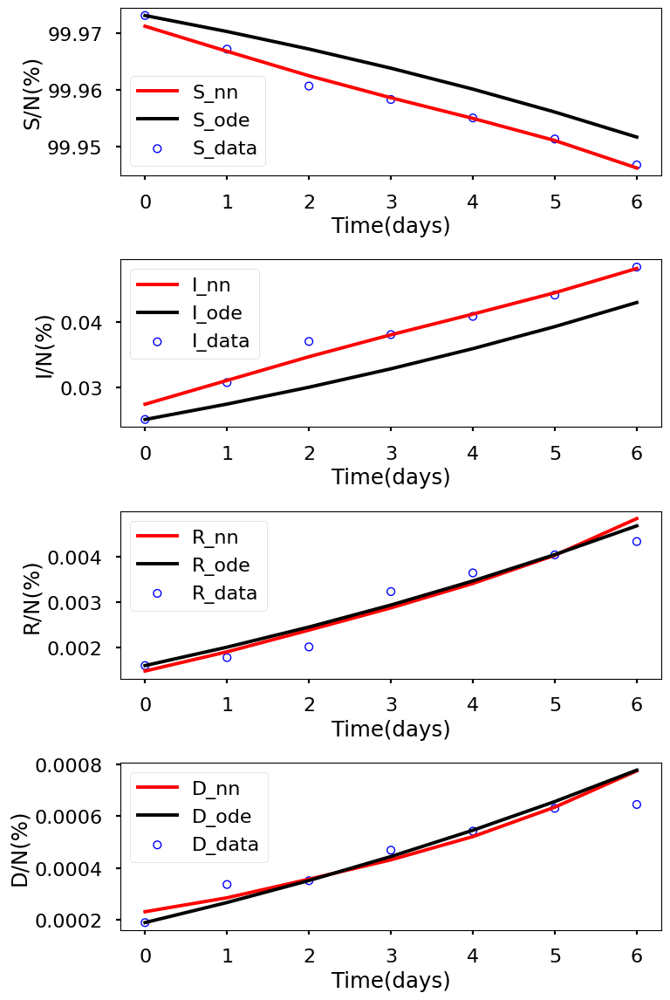

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.089e+00, GE_loss: 2.09717e+00,OB_loss: 9.91559e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 6.34, cumulative_time: 6.34
It: 10000, Loss: 5.254e-07, GE_loss: 1.84650e-07,OB_loss: 3.40761e-07, Beta: 1.02968e+00,gamma: 9.67612e-01,mu: 9.67686e-01, Time: 31.73, cumulative_time: 38.06
It: 20000, Loss: 2.429e-07, GE_loss: 7.20277e-08,OB_loss: 1.70871e-07, Beta: 1.04780e+00,gamma: 9.41786e-01,mu: 9.40570e-01, Time: 31.35, cumulative_time: 69.42
It: 30000, Loss: 2.786e-10, GE_loss: 9.93615e-11,OB_loss: 1.79256e-10, Beta: 6.55003e-02,gamma: 5.31129e-02,mu: 5.53946e-03, Time: 31.93, cumulative_time: 101.35
It: 40000, Loss: 1.254e-10, GE_loss: 3.82024e-11,OB_loss: 8.71496e-11, Beta: 6.77275e-02,gamma: 5.58579e-02,mu: 4.43424e-03, Time: 31.70, cumulative_time: 133.05
beta:  [0.06812039]
gamma:  [0.05646456]
mu:  [0.00431551]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


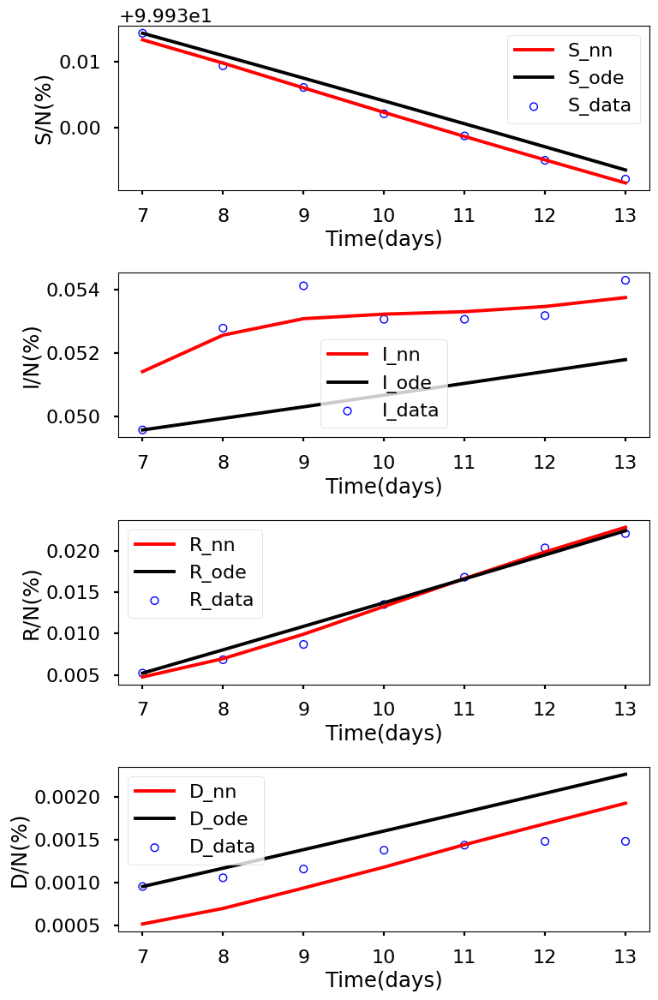

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.069e+00, GE_loss: 2.07772e+00,OB_loss: 9.91455e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 6.51, cumulative_time: 6.51
It: 10000, Loss: 4.688e-07, GE_loss: 1.75970e-07,OB_loss: 2.92828e-07, Beta: 1.02982e+00,gamma: 9.68071e-01,mu: 9.68142e-01, Time: 31.84, cumulative_time: 38.35
It: 20000, Loss: 2.339e-07, GE_loss: 6.94771e-08,OB_loss: 1.64376e-07, Beta: 1.05311e+00,gamma: 9.43942e-01,mu: 9.40402e-01, Time: 32.37, cumulative_time: 70.73
It: 30000, Loss: 4.521e-10, GE_loss: 2.71206e-11,OB_loss: 4.24975e-10, Beta: 6.93785e-02,gamma: 8.53445e-02,mu: 5.34268e-03, Time: 32.47, cumulative_time: 103.19
It: 40000, Loss: 4.234e-10, GE_loss: 3.47367e-11,OB_loss: 3.88637e-10, Beta: 6.74855e-02,gamma: 8.34730e-02,mu: 4.67962e-03, Time: 32.92, cumulative_time: 136.11
beta:  [0.06779373]
gamma:  [0.08345724]
mu:  [0.00418387]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


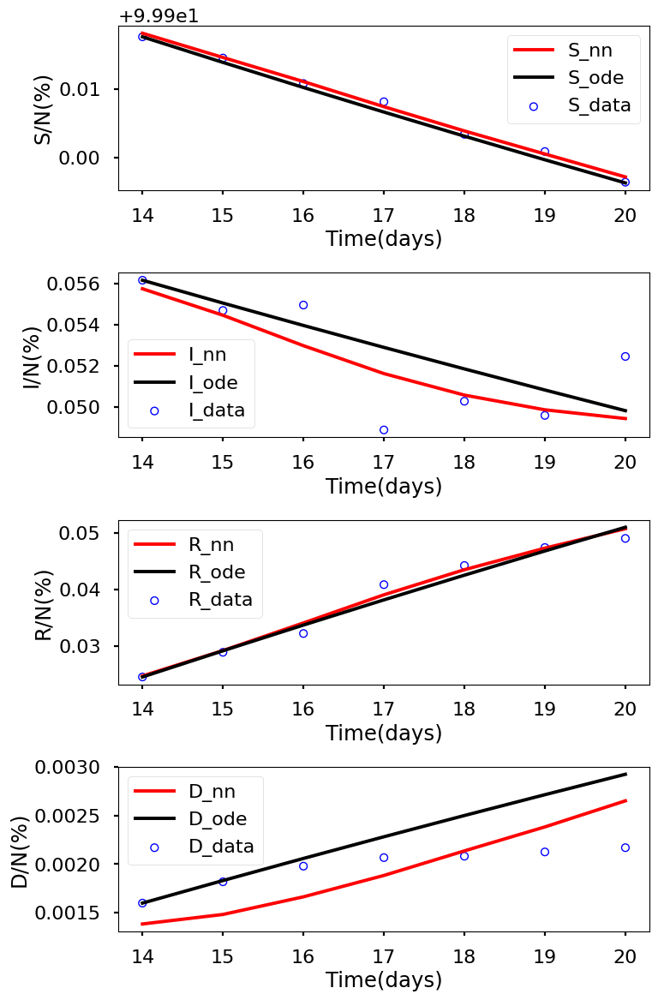

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.070e+00, GE_loss: 2.07826e+00,OB_loss: 9.91259e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 6.46, cumulative_time: 6.46
It: 10000, Loss: 5.111e-07, GE_loss: 2.69839e-07,OB_loss: 2.41277e-07, Beta: 1.03253e+00,gamma: 9.63367e-01,mu: 9.63537e-01, Time: 32.05, cumulative_time: 38.51
It: 20000, Loss: 2.909e-07, GE_loss: 8.91652e-08,OB_loss: 2.01747e-07, Beta: 1.06612e+00,gamma: 9.32114e-01,mu: 9.27704e-01, Time: 31.80, cumulative_time: 70.31
It: 30000, Loss: 2.250e-10, GE_loss: 2.47716e-11,OB_loss: 2.00247e-10, Beta: 1.10449e-01,gamma: 3.65051e-02,mu: 7.32281e-03, Time: 31.87, cumulative_time: 102.18
It: 40000, Loss: 1.863e-10, GE_loss: 3.39906e-11,OB_loss: 1.52344e-10, Beta: 1.09623e-01,gamma: 3.64101e-02,mu: 5.76063e-03, Time: 31.54, cumulative_time: 133.71
beta:  [0.10930917]
gamma:  [0.03652985]
mu:  [0.00494563]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


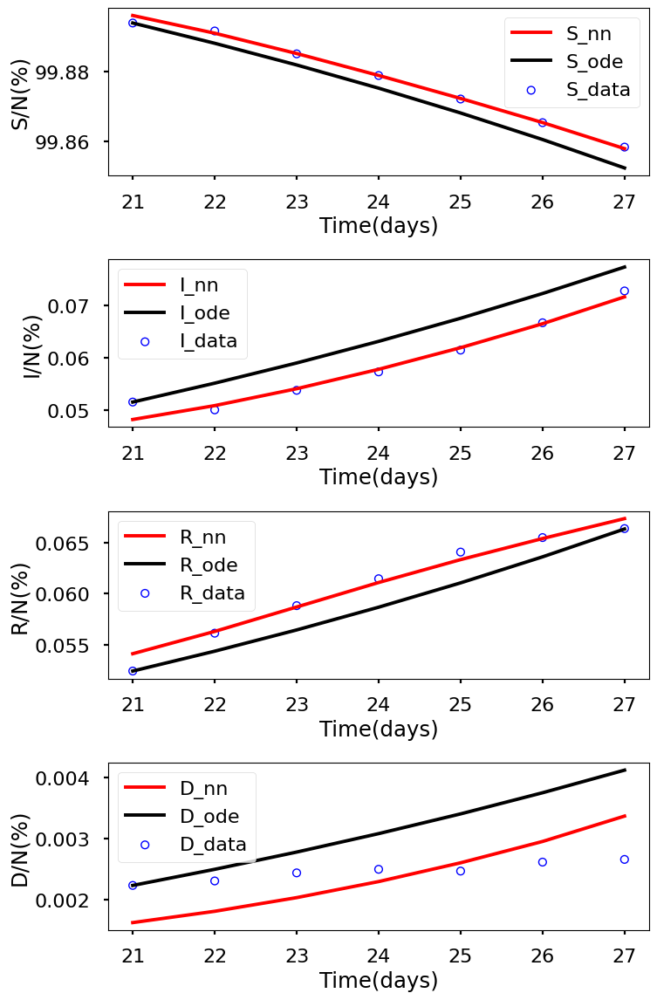

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.077e+00, GE_loss: 2.08541e+00,OB_loss: 9.91191e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 6.63, cumulative_time: 6.63
It: 10000, Loss: 7.581e-07, GE_loss: 2.93983e-07,OB_loss: 4.64099e-07, Beta: 1.03094e+00,gamma: 9.64826e-01,mu: 9.64945e-01, Time: 34.10, cumulative_time: 40.74
It: 20000, Loss: 5.731e-07, GE_loss: 1.79402e-07,OB_loss: 3.93726e-07, Beta: 1.08946e+00,gamma: 8.98832e-01,mu: 8.88378e-01, Time: 32.39, cumulative_time: 73.13
It: 30000, Loss: 1.825e-09, GE_loss: 3.77594e-10,OB_loss: 1.44732e-09, Beta: 1.09737e-01,gamma: 2.98856e-02,mu: 5.59628e-03, Time: 32.44, cumulative_time: 105.56
It: 40000, Loss: 1.697e-09, GE_loss: 4.46532e-10,OB_loss: 1.25007e-09, Beta: 1.08363e-01,gamma: 3.06867e-02,mu: 3.88960e-03, Time: 31.59, cumulative_time: 137.15
beta:  [0.10741878]
gamma:  [0.03188375]
mu:  [0.00271743]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


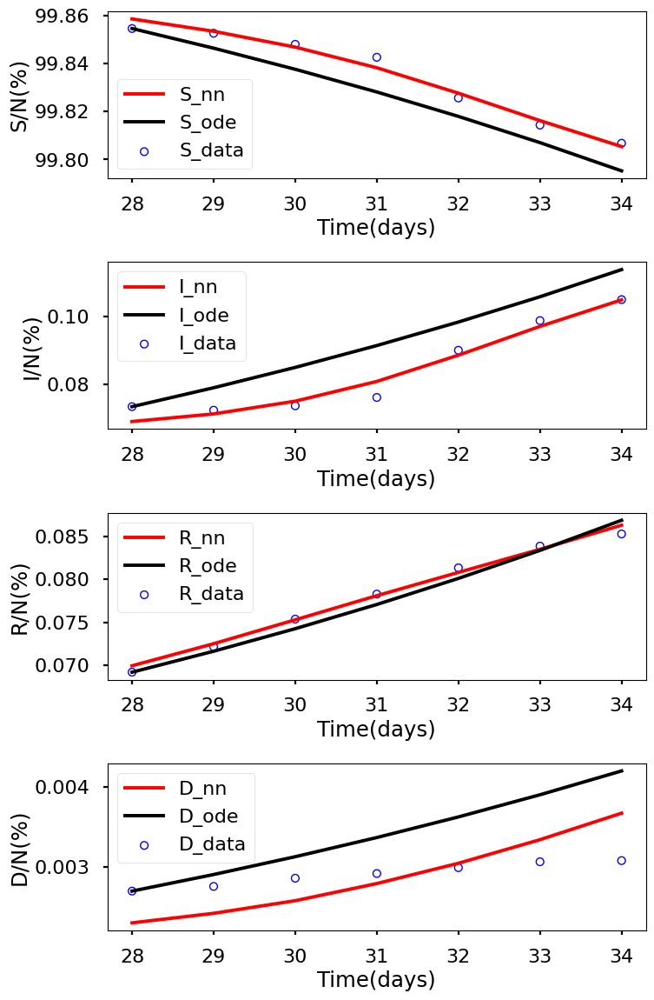

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.083e+00, GE_loss: 2.09341e+00,OB_loss: 9.89974e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 6.61, cumulative_time: 6.61
It: 10000, Loss: 1.058e-06, GE_loss: 3.48655e-07,OB_loss: 7.09600e-07, Beta: 1.03064e+00,gamma: 9.65772e-01,mu: 9.65885e-01, Time: 34.55, cumulative_time: 41.16
It: 20000, Loss: 8.730e-07, GE_loss: 2.80827e-07,OB_loss: 5.92171e-07, Beta: 1.05506e+00,gamma: 8.64182e-01,mu: 8.52306e-01, Time: 32.14, cumulative_time: 73.30
It: 30000, Loss: 1.270e-10, GE_loss: 1.79921e-11,OB_loss: 1.09024e-10, Beta: 3.85283e-02,gamma: 3.40703e-02,mu: 2.70161e-03, Time: 32.03, cumulative_time: 105.33
It: 40000, Loss: 1.025e-10, GE_loss: 9.19488e-12,OB_loss: 9.32946e-11, Beta: 3.82883e-02,gamma: 3.41984e-02,mu: 1.96525e-03, Time: 31.65, cumulative_time: 136.97
beta:  [0.03820769]
gamma:  [0.03427007]
mu:  [0.00169994]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


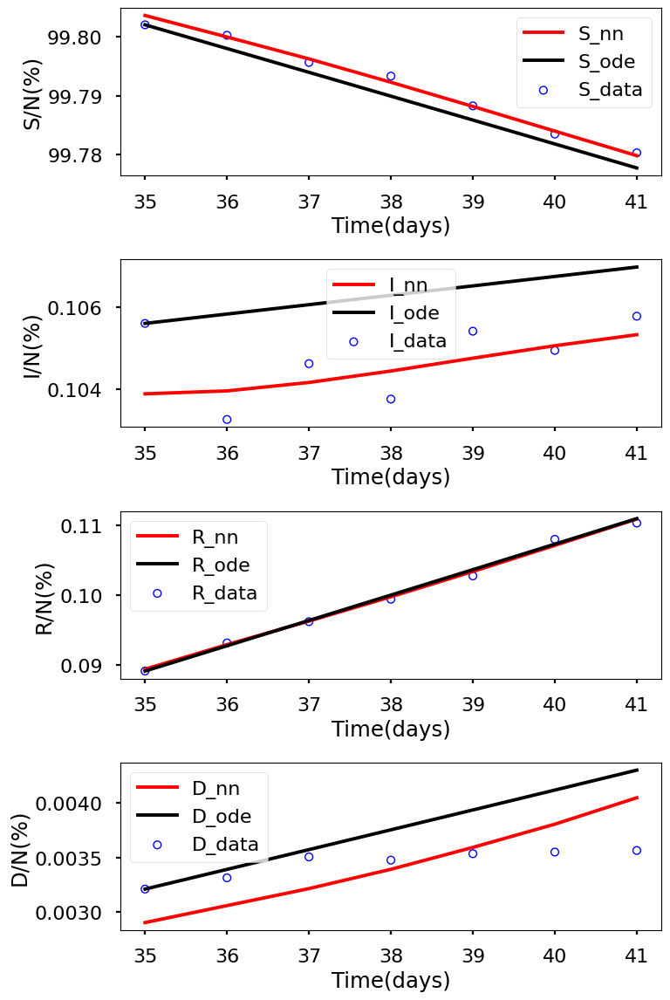

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.087e+00, GE_loss: 2.09667e+00,OB_loss: 9.90151e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 6.70, cumulative_time: 6.70
It: 10000, Loss: 1.219e-06, GE_loss: 4.43751e-07,OB_loss: 7.75210e-07, Beta: 1.03005e+00,gamma: 9.64480e-01,mu: 9.64637e-01, Time: 32.29, cumulative_time: 38.99
It: 20000, Loss: 9.462e-07, GE_loss: 3.03503e-07,OB_loss: 6.42703e-07, Beta: 1.06178e+00,gamma: 8.52752e-01,mu: 8.37614e-01, Time: 32.69, cumulative_time: 71.68
It: 30000, Loss: 2.110e-10, GE_loss: 2.48843e-11,OB_loss: 1.86096e-10, Beta: 4.10460e-02,gamma: 3.85538e-02,mu: 2.75581e-03, Time: 31.60, cumulative_time: 103.28
It: 40000, Loss: 1.904e-10, GE_loss: 2.18653e-11,OB_loss: 1.68497e-10, Beta: 4.02281e-02,gamma: 3.81006e-02,mu: 2.33063e-03, Time: 30.95, cumulative_time: 134.23
beta:  [0.03996261]
gamma:  [0.03799908]
mu:  [0.00211274]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


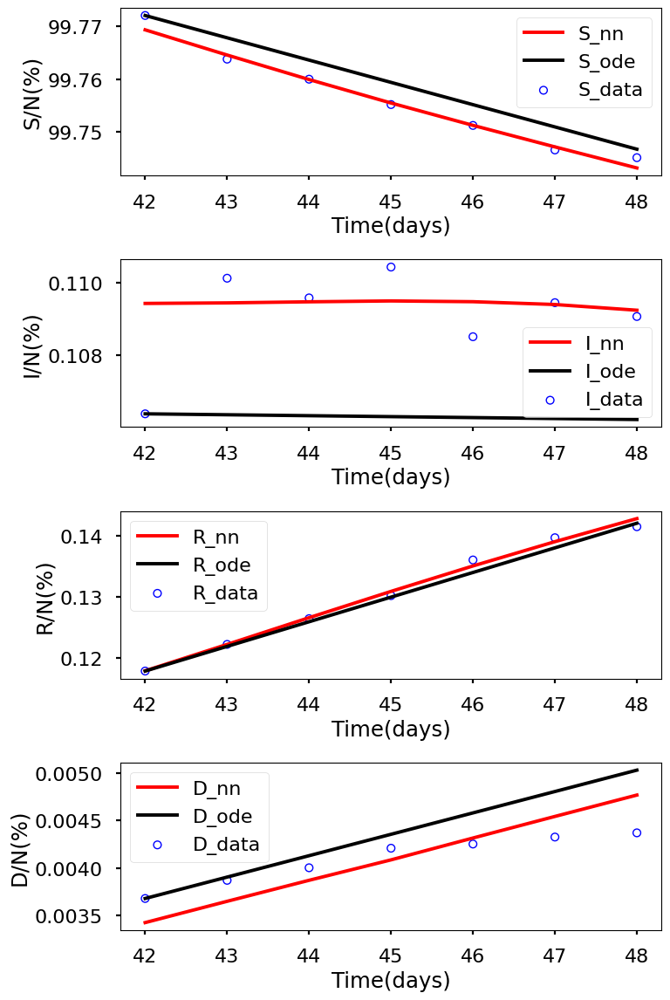

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.039e+00, GE_loss: 2.05241e+00,OB_loss: 9.86408e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 6.66, cumulative_time: 6.66
It: 10000, Loss: 9.767e-07, GE_loss: 3.48479e-07,OB_loss: 6.28247e-07, Beta: 1.02991e+00,gamma: 9.65711e-01,mu: 9.65654e-01, Time: 32.45, cumulative_time: 39.11
It: 20000, Loss: 7.393e-07, GE_loss: 2.44115e-07,OB_loss: 4.95153e-07, Beta: 1.05491e+00,gamma: 8.74357e-01,mu: 8.52755e-01, Time: 31.55, cumulative_time: 70.66
It: 30000, Loss: 2.596e-09, GE_loss: 9.89256e-10,OB_loss: 1.60712e-09, Beta: 5.28415e-02,gamma: 6.78601e-02,mu: 3.68394e-03, Time: 31.75, cumulative_time: 102.41
It: 40000, Loss: 2.434e-09, GE_loss: 1.03062e-09,OB_loss: 1.40305e-09, Beta: 5.28403e-02,gamma: 6.83845e-02,mu: 2.11570e-03, Time: 33.33, cumulative_time: 135.74
beta:  [0.05269637]
gamma:  [0.06870082]
mu:  [0.00165444]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


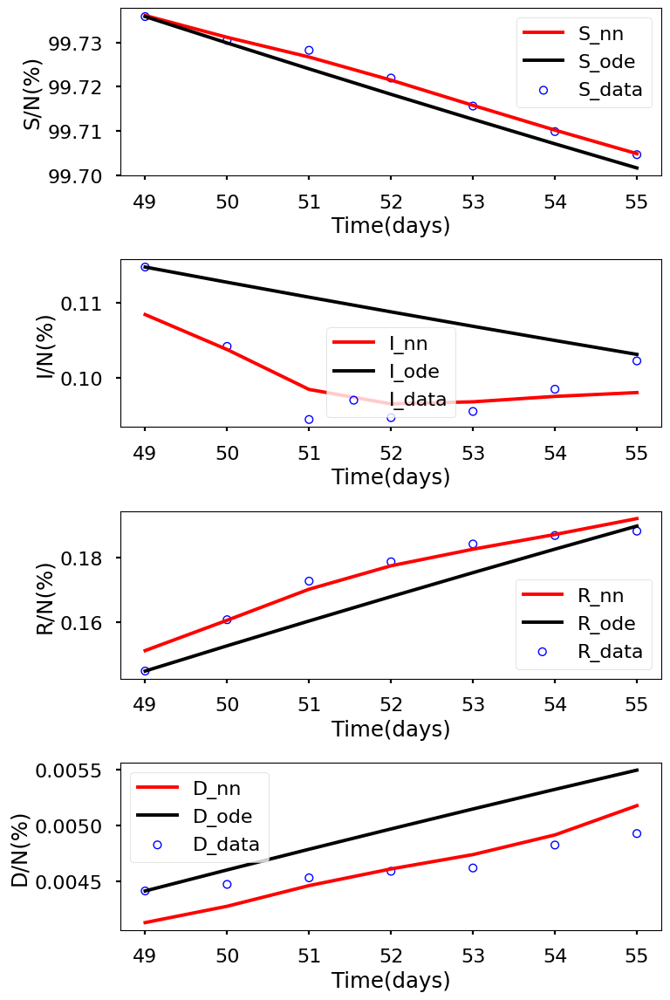

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.057e+00, GE_loss: 2.06830e+00,OB_loss: 9.88789e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 6.79, cumulative_time: 6.79
It: 10000, Loss: 9.792e-07, GE_loss: 3.31665e-07,OB_loss: 6.47495e-07, Beta: 1.03147e+00,gamma: 9.64432e-01,mu: 9.64350e-01, Time: 31.51, cumulative_time: 38.31
It: 20000, Loss: 8.072e-07, GE_loss: 2.61809e-07,OB_loss: 5.45387e-07, Beta: 1.07167e+00,gamma: 8.69329e-01,mu: 8.47731e-01, Time: 31.41, cumulative_time: 69.72
It: 30000, Loss: 1.169e-09, GE_loss: 3.45408e-10,OB_loss: 8.23287e-10, Beta: 5.78255e-02,gamma: 5.84687e-02,mu: 3.77841e-03, Time: 31.37, cumulative_time: 101.09
It: 40000, Loss: 9.906e-10, GE_loss: 4.04548e-10,OB_loss: 5.86073e-10, Beta: 5.83959e-02,gamma: 5.86107e-02,mu: 2.37374e-03, Time: 32.12, cumulative_time: 133.22
beta:  [0.05800866]
gamma:  [0.059057]
mu:  [0.00148539]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


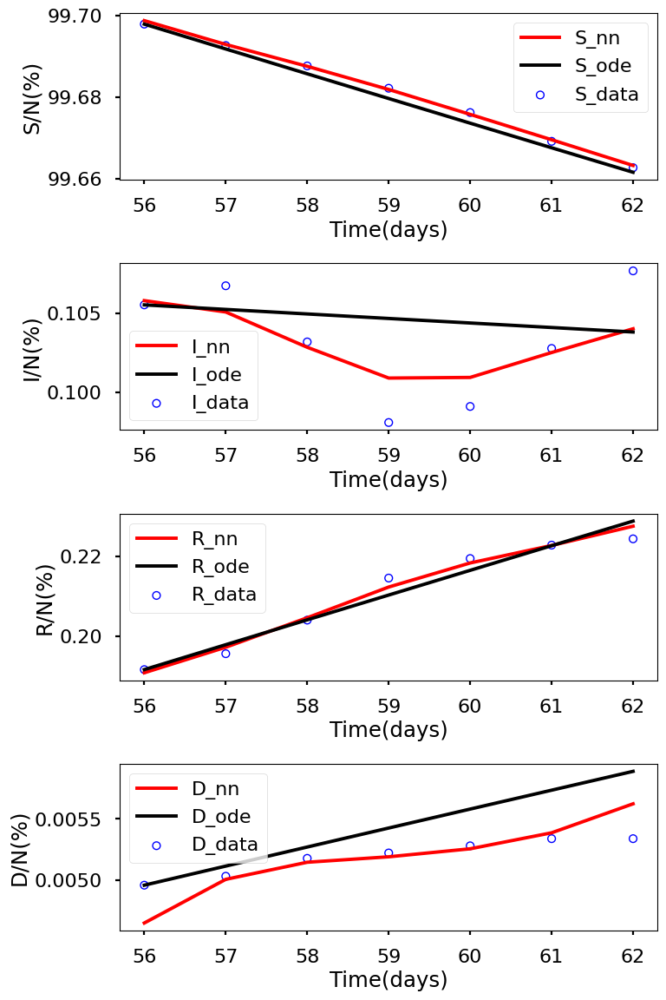

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.066e+00, GE_loss: 2.07983e+00,OB_loss: 9.85742e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 7.11, cumulative_time: 7.11
It: 10000, Loss: 1.344e-06, GE_loss: 3.84470e-07,OB_loss: 9.59349e-07, Beta: 1.03077e+00,gamma: 9.66388e-01,mu: 9.66153e-01, Time: 32.19, cumulative_time: 39.30
It: 20000, Loss: 1.099e-06, GE_loss: 3.69447e-07,OB_loss: 7.29790e-07, Beta: 1.04502e+00,gamma: 8.33252e-01,mu: 8.04271e-01, Time: 32.26, cumulative_time: 71.56
It: 30000, Loss: 5.686e-10, GE_loss: 7.15170e-11,OB_loss: 4.97059e-10, Beta: 5.46752e-02,gamma: 3.59427e-02,mu: 2.91176e-03, Time: 32.90, cumulative_time: 104.46
It: 40000, Loss: 5.326e-10, GE_loss: 7.35748e-11,OB_loss: 4.58986e-10, Beta: 5.46805e-02,gamma: 3.58557e-02,mu: 2.39686e-03, Time: 32.21, cumulative_time: 136.66
beta:  [0.05461646]
gamma:  [0.03574648]
mu:  [0.00221748]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


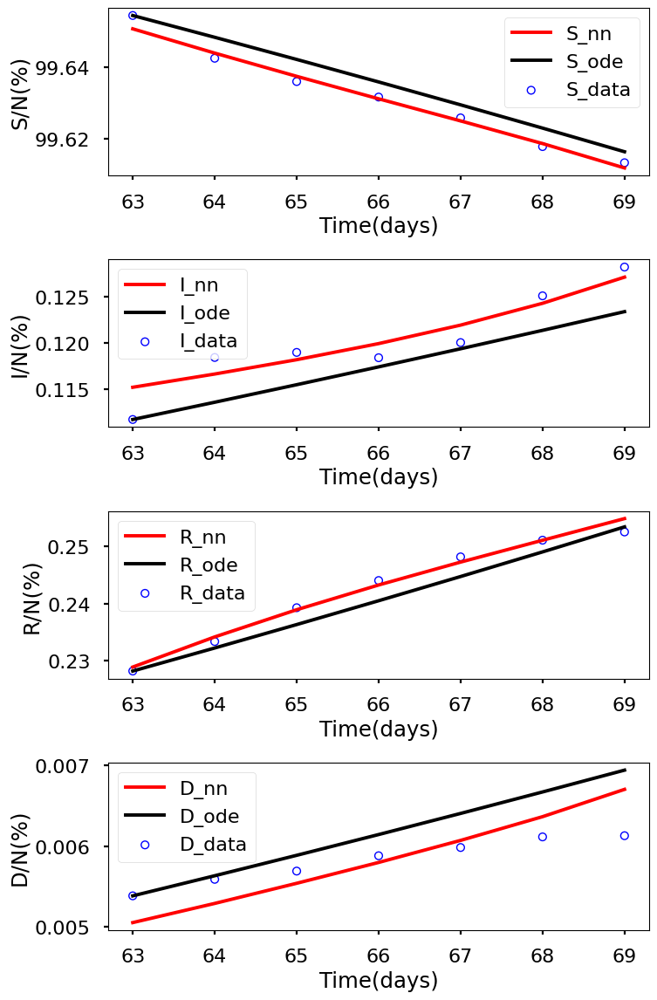

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.069e+00, GE_loss: 2.08468e+00,OB_loss: 9.83921e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 6.85, cumulative_time: 6.85
It: 10000, Loss: 1.666e-06, GE_loss: 4.77063e-07,OB_loss: 1.18901e-06, Beta: 1.03096e+00,gamma: 9.65953e-01,mu: 9.65824e-01, Time: 31.34, cumulative_time: 38.19
It: 20000, Loss: 1.251e-06, GE_loss: 4.42345e-07,OB_loss: 8.08310e-07, Beta: 1.01025e+00,gamma: 8.01032e-01,mu: 7.55288e-01, Time: 31.61, cumulative_time: 69.80
It: 30000, Loss: 1.176e-09, GE_loss: 3.37264e-10,OB_loss: 8.38906e-10, Beta: 5.96375e-02,gamma: 4.49654e-02,mu: 3.76688e-03, Time: 31.54, cumulative_time: 101.35
It: 40000, Loss: 8.234e-10, GE_loss: 1.64289e-10,OB_loss: 6.59149e-10, Beta: 5.86900e-02,gamma: 4.45583e-02,mu: 2.84306e-03, Time: 31.92, cumulative_time: 133.27
beta:  [0.05851305]
gamma:  [0.04455553]
mu:  [0.00239126]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


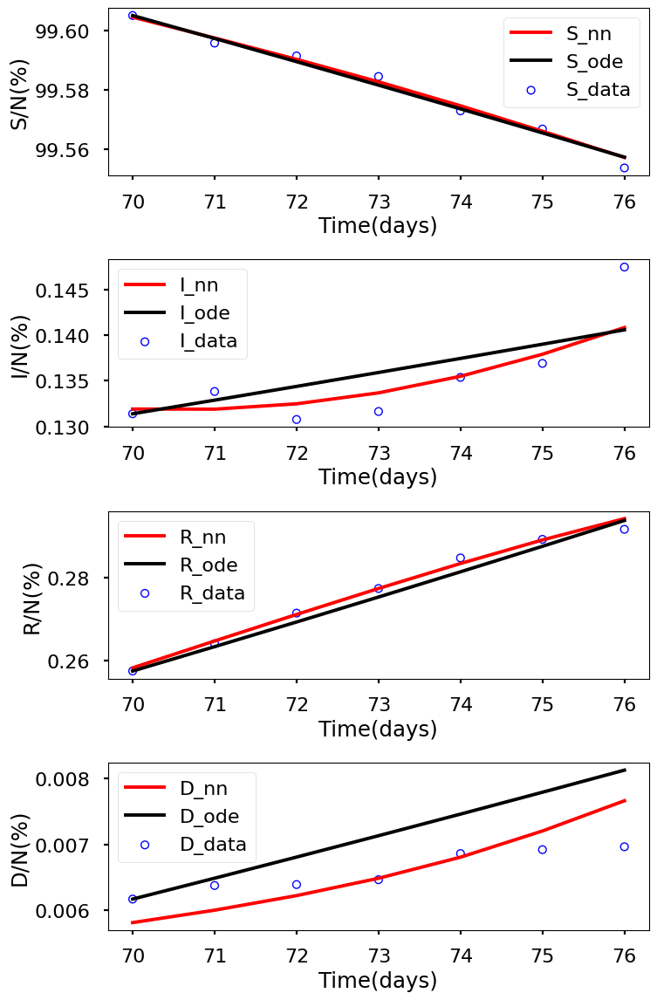

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.002e+00, GE_loss: 2.01870e+00,OB_loss: 9.83163e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 6.99, cumulative_time: 6.99
It: 10000, Loss: 2.214e-06, GE_loss: 6.46336e-07,OB_loss: 1.56755e-06, Beta: 1.03155e+00,gamma: 9.65928e-01,mu: 9.65999e-01, Time: 31.94, cumulative_time: 38.93
It: 20000, Loss: 1.488e-06, GE_loss: 5.93707e-07,OB_loss: 8.94406e-07, Beta: 9.54450e-01,gamma: 6.89338e-01,mu: 6.42661e-01, Time: 32.23, cumulative_time: 71.16
It: 30000, Loss: 2.644e-09, GE_loss: 6.72147e-10,OB_loss: 1.97174e-09, Beta: 6.17549e-02,gamma: 4.73234e-02,mu: 2.81839e-03, Time: 32.92, cumulative_time: 104.08
It: 40000, Loss: 2.375e-09, GE_loss: 6.12577e-10,OB_loss: 1.76291e-09, Beta: 6.15001e-02,gamma: 4.74183e-02,mu: 2.16899e-03, Time: 32.86, cumulative_time: 136.94
beta:  [0.06171934]
gamma:  [0.0477807]
mu:  [0.00181682]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


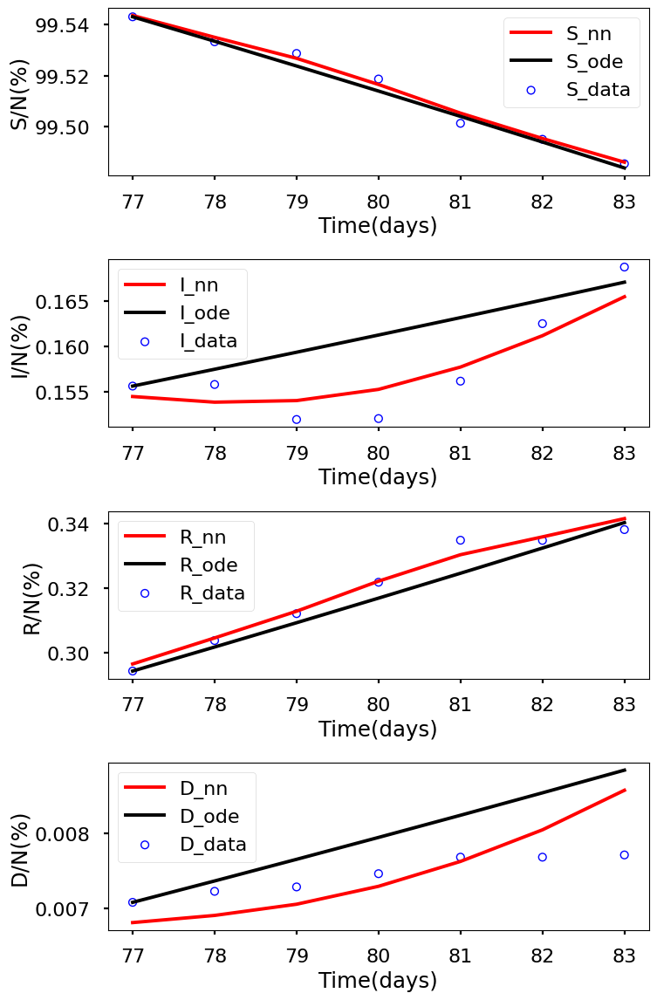

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.070e+00, GE_loss: 2.08956e+00,OB_loss: 9.80584e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 7.09, cumulative_time: 7.09
It: 10000, Loss: 3.046e-06, GE_loss: 8.14530e-07,OB_loss: 2.23110e-06, Beta: 1.03073e+00,gamma: 9.65143e-01,mu: 9.64949e-01, Time: 33.30, cumulative_time: 40.39
It: 20000, Loss: 1.652e-06, GE_loss: 7.56019e-07,OB_loss: 8.96461e-07, Beta: 8.37083e-01,gamma: 5.95685e-01,mu: 5.20393e-01, Time: 31.60, cumulative_time: 72.00
It: 30000, Loss: 1.393e-09, GE_loss: 1.94962e-10,OB_loss: 1.19816e-09, Beta: 8.41041e-02,gamma: 4.25287e-02,mu: 2.57433e-03, Time: 31.03, cumulative_time: 103.03
It: 40000, Loss: 1.366e-09, GE_loss: 2.12185e-10,OB_loss: 1.15409e-09, Beta: 8.37999e-02,gamma: 4.28113e-02,mu: 1.48489e-03, Time: 31.60, cumulative_time: 134.62
beta:  [0.08372371]
gamma:  [0.04292668]
mu:  [0.00108507]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


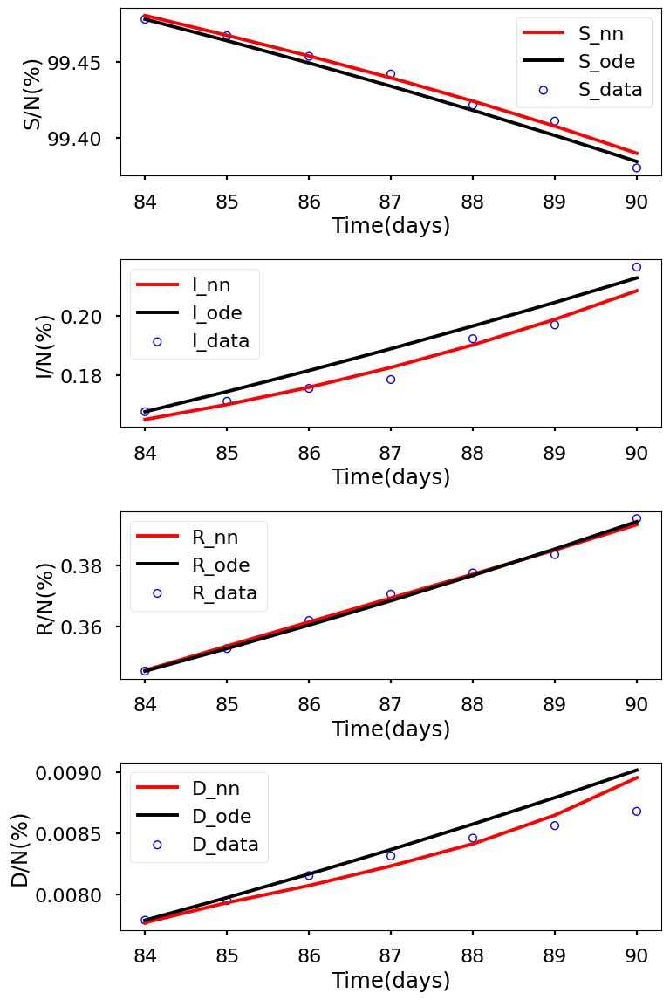

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.061e+00, GE_loss: 2.08012e+00,OB_loss: 9.80488e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 6.99, cumulative_time: 6.99
It: 10000, Loss: 6.470e-06, GE_loss: 1.81317e-06,OB_loss: 4.65723e-06, Beta: 1.03450e+00,gamma: 9.61402e-01,mu: 9.60750e-01, Time: 31.71, cumulative_time: 38.70
It: 20000, Loss: 1.666e-07, GE_loss: 1.23631e-07,OB_loss: 4.29322e-08, Beta: 1.93463e-01,gamma: 1.36960e-01,mu: 6.98060e-02, Time: 33.26, cumulative_time: 71.96
It: 30000, Loss: 2.765e-09, GE_loss: 9.10332e-10,OB_loss: 1.85502e-09, Beta: 8.07047e-02,gamma: 2.79396e-02,mu: 2.09021e-03, Time: 31.46, cumulative_time: 103.41
It: 40000, Loss: 2.693e-09, GE_loss: 9.17366e-10,OB_loss: 1.77602e-09, Beta: 8.05047e-02,gamma: 2.81543e-02,mu: 1.36635e-03, Time: 31.56, cumulative_time: 134.98
beta:  [0.08043735]
gamma:  [0.02826343]
mu:  [0.00106654]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


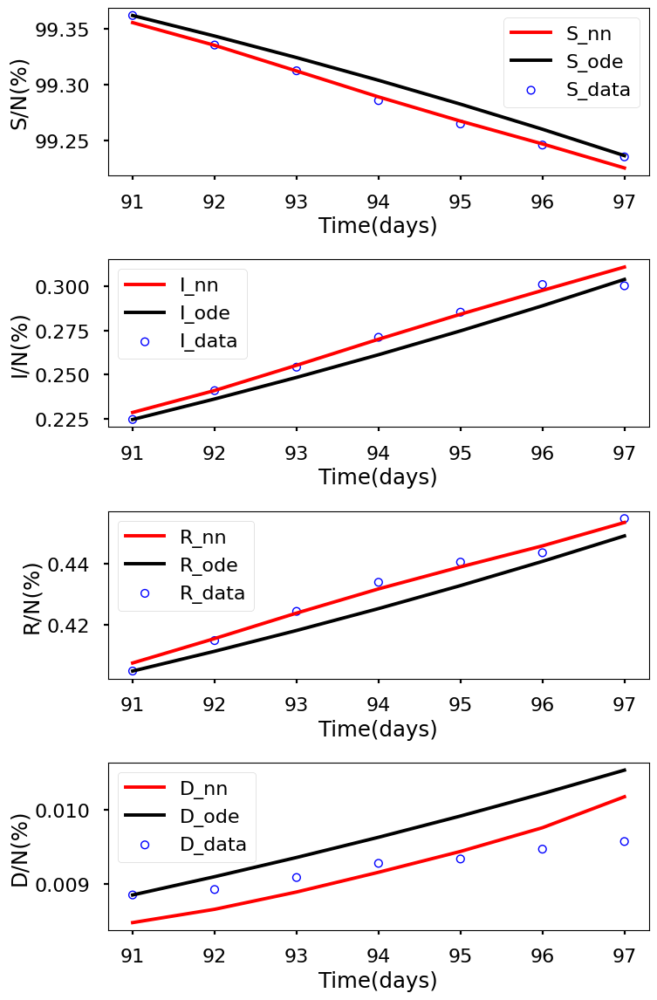

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.043e+00, GE_loss: 2.06831e+00,OB_loss: 9.74382e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 7.29, cumulative_time: 7.29
It: 10000, Loss: 1.083e-05, GE_loss: 3.13926e-06,OB_loss: 7.68674e-06, Beta: 1.03624e+00,gamma: 9.62687e-01,mu: 9.61619e-01, Time: 33.68, cumulative_time: 40.97
It: 20000, Loss: 5.278e-09, GE_loss: 9.55155e-10,OB_loss: 4.32317e-09, Beta: 7.40356e-02,gamma: 3.66375e-02,mu: 3.99556e-03, Time: 33.15, cumulative_time: 74.12
It: 30000, Loss: 3.949e-09, GE_loss: 6.72707e-10,OB_loss: 3.27600e-09, Beta: 7.16226e-02,gamma: 3.35986e-02,mu: 1.59959e-03, Time: 39.18, cumulative_time: 113.31
It: 40000, Loss: 3.914e-09, GE_loss: 7.95540e-10,OB_loss: 3.11858e-09, Beta: 7.13033e-02,gamma: 3.35969e-02,mu: 8.49561e-04, Time: 37.48, cumulative_time: 150.79
beta:  [0.07127208]
gamma:  [0.03362456]
mu:  [0.00067426]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


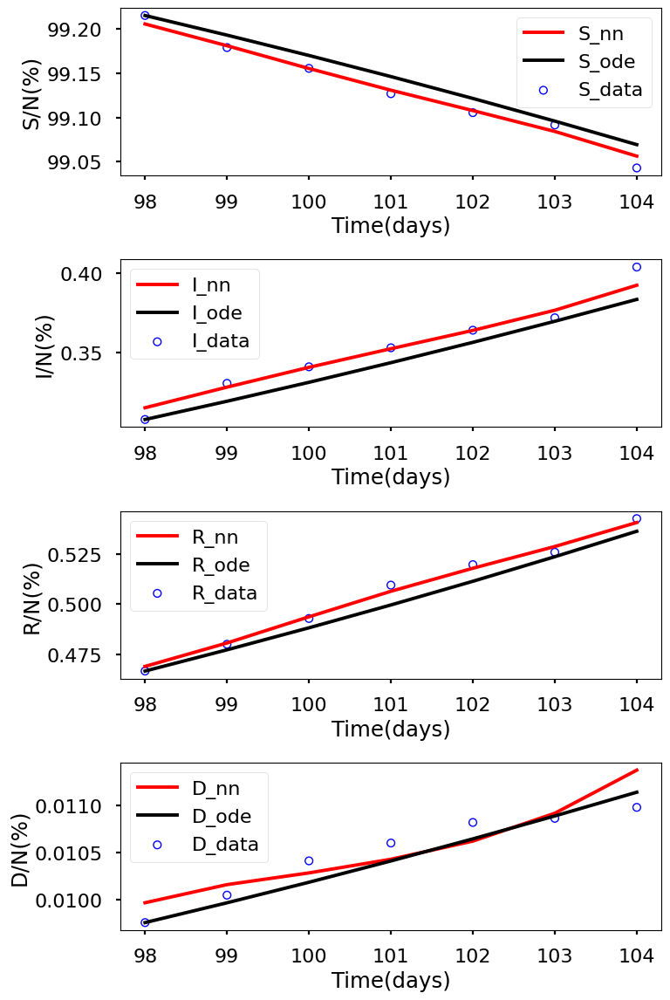

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.041e+00, GE_loss: 2.06961e+00,OB_loss: 9.71102e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 7.17, cumulative_time: 7.17
It: 10000, Loss: 1.731e-05, GE_loss: 5.10763e-06,OB_loss: 1.22052e-05, Beta: 1.04109e+00,gamma: 9.55938e-01,mu: 9.54148e-01, Time: 32.57, cumulative_time: 39.74
It: 20000, Loss: 6.339e-09, GE_loss: 1.69942e-09,OB_loss: 4.63977e-09, Beta: 7.52002e-02,gamma: 3.87507e-02,mu: 3.81679e-03, Time: 31.45, cumulative_time: 71.18
It: 30000, Loss: 4.334e-09, GE_loss: 1.13910e-09,OB_loss: 3.19518e-09, Beta: 7.31138e-02,gamma: 3.81905e-02,mu: 1.45322e-03, Time: 31.83, cumulative_time: 103.01
It: 40000, Loss: 4.079e-09, GE_loss: 1.17669e-09,OB_loss: 2.90240e-09, Beta: 7.28499e-02,gamma: 3.86498e-02,mu: 6.98046e-04, Time: 33.43, cumulative_time: 136.45
beta:  [0.07283583]
gamma:  [0.03883475]
mu:  [0.00066285]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


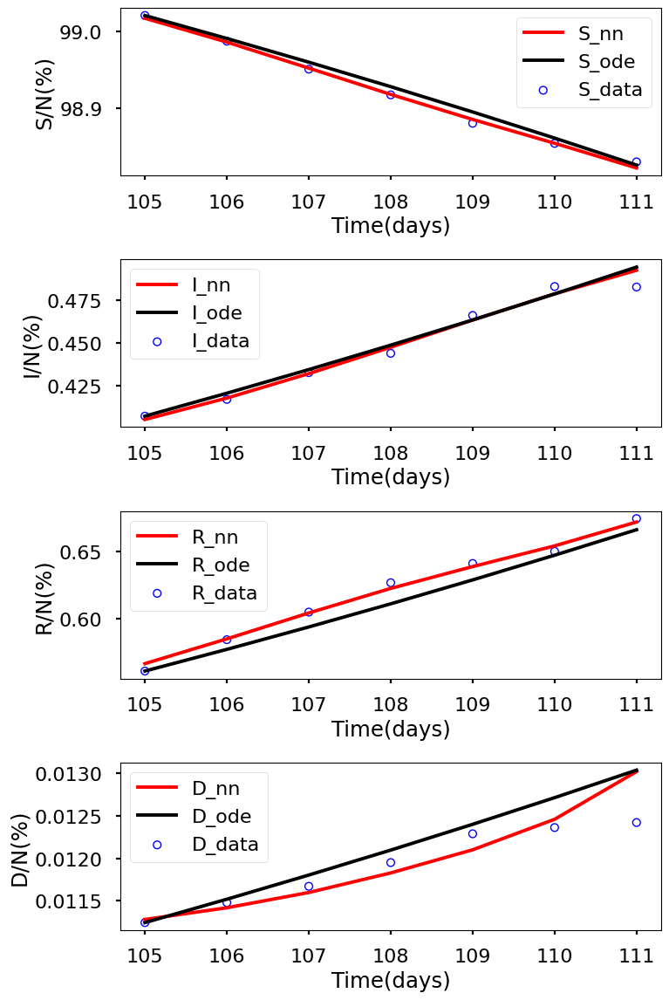

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.034e+00, GE_loss: 2.06510e+00,OB_loss: 9.68753e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 7.23, cumulative_time: 7.23
It: 10000, Loss: 2.342e-05, GE_loss: 7.04452e-06,OB_loss: 1.63800e-05, Beta: 1.04313e+00,gamma: 9.50265e-01,mu: 9.48679e-01, Time: 31.32, cumulative_time: 38.54
It: 20000, Loss: 8.142e-09, GE_loss: 1.53191e-09,OB_loss: 6.60967e-09, Beta: 6.93762e-02,gamma: 3.85998e-02,mu: 2.69484e-03, Time: 32.14, cumulative_time: 70.68
It: 30000, Loss: 2.103e-08, GE_loss: 1.15095e-08,OB_loss: 9.52244e-09, Beta: 6.88901e-02,gamma: 3.87593e-02,mu: 9.83205e-04, Time: 31.81, cumulative_time: 102.49
It: 40000, Loss: 6.285e-09, GE_loss: 1.77512e-09,OB_loss: 4.50986e-09, Beta: 6.85399e-02,gamma: 3.87841e-02,mu: 4.08399e-04, Time: 32.06, cumulative_time: 134.55
beta:  [0.06853791]
gamma:  [0.03878784]
mu:  [0.00059886]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


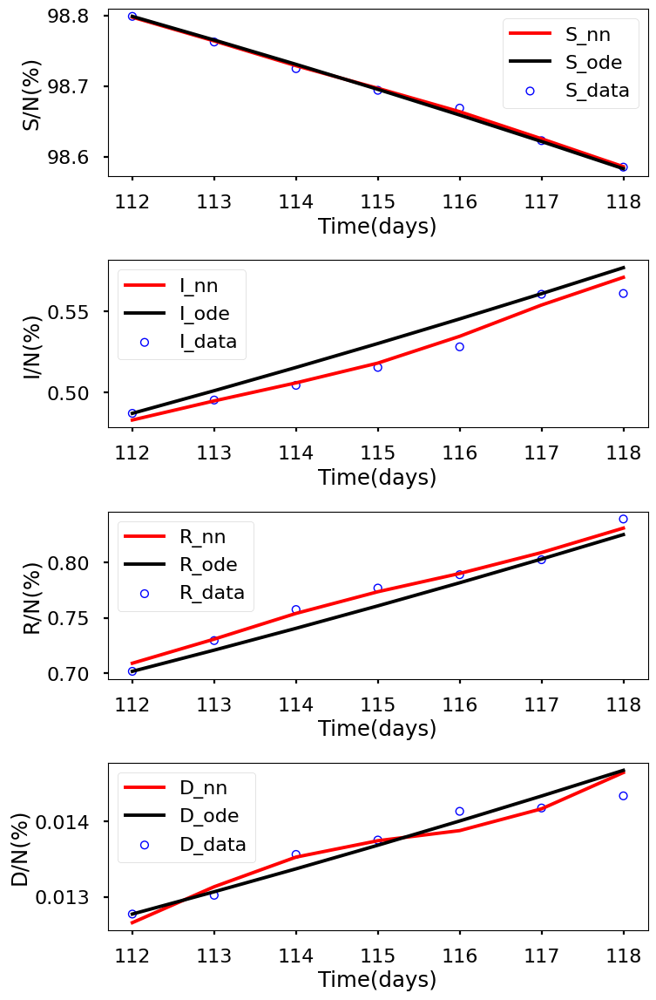

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.038e+00, GE_loss: 2.07697e+00,OB_loss: 9.61379e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 7.50, cumulative_time: 7.50
It: 10000, Loss: 2.758e-05, GE_loss: 8.15315e-06,OB_loss: 1.94264e-05, Beta: 1.05073e+00,gamma: 9.44921e-01,mu: 9.42475e-01, Time: 32.36, cumulative_time: 39.85
It: 20000, Loss: 2.022e-08, GE_loss: 7.52738e-09,OB_loss: 1.26910e-08, Beta: 5.54010e-02,gamma: 4.26174e-02,mu: 2.83988e-03, Time: 31.83, cumulative_time: 71.68
It: 30000, Loss: 1.065e-08, GE_loss: 2.89464e-09,OB_loss: 7.75477e-09, Beta: 5.48461e-02,gamma: 4.35206e-02,mu: 1.40760e-03, Time: 32.69, cumulative_time: 104.37
It: 40000, Loss: 1.011e-08, GE_loss: 3.36896e-09,OB_loss: 6.73998e-09, Beta: 5.45229e-02,gamma: 4.39899e-02,mu: 9.22895e-04, Time: 32.00, cumulative_time: 136.37
beta:  [0.05443842]
gamma:  [0.04406046]
mu:  [0.00065317]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


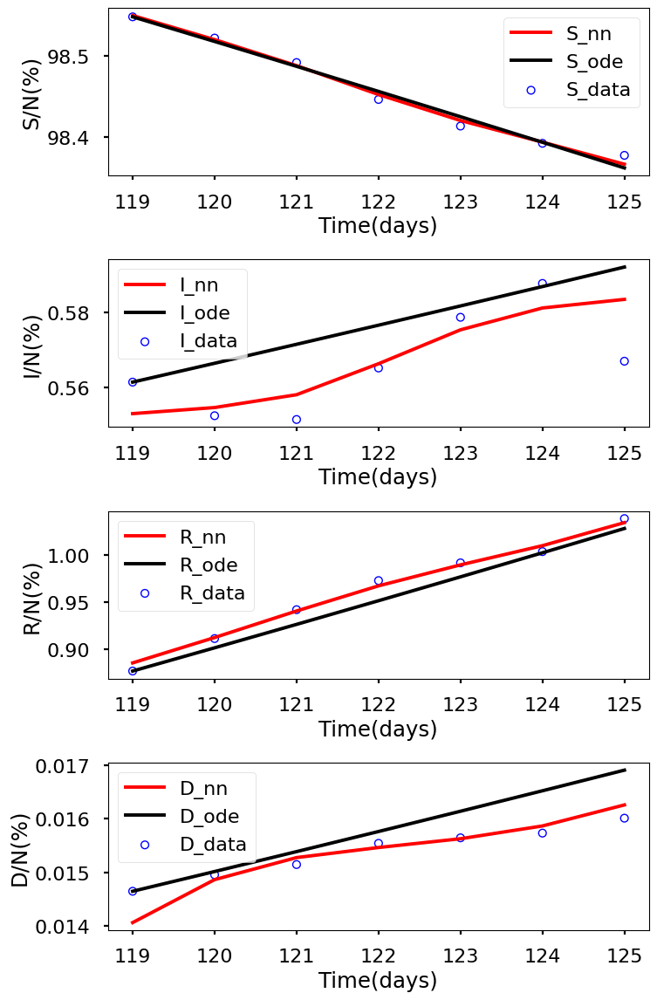

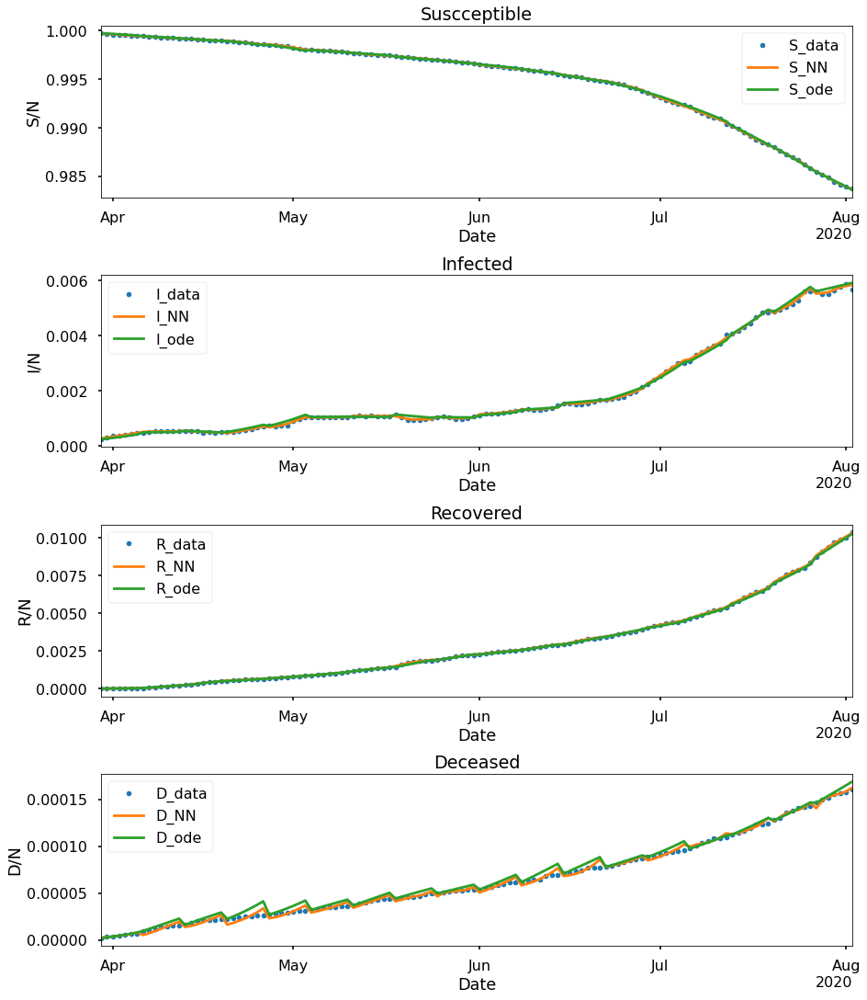

+---------------------+-------------+-------------+--------------+--------------+--------------+--------------+-------------+--------------+--------------+--------------+--------------+--------------+--------------+--------------+--------------+--------------+---------------+---------------+
|      Paramaters     |    Week 1   |    Week 2   |    Week 3    |    Week 4    |    Week 5    |    Week 6    |    Week 7   |    Week 8    |    Week 9    |   Week 10    |   Week 11    |   Week 12    |   Week 13    |   Week 14    |   Week 15    |   Week 16    |    Week 17    |    Week 18    |
+---------------------+-------------+-------------+--------------+--------------+--------------+--------------+-------------+--------------+--------------+--------------+--------------+--------------+--------------+--------------+--------------+--------------+---------------+---------------+
|         beta        |  0.10771886 |  0.06812039 |  0.06779373  |  0.10930917  |  0.10741878  |  0.03820769  | 0.0399626

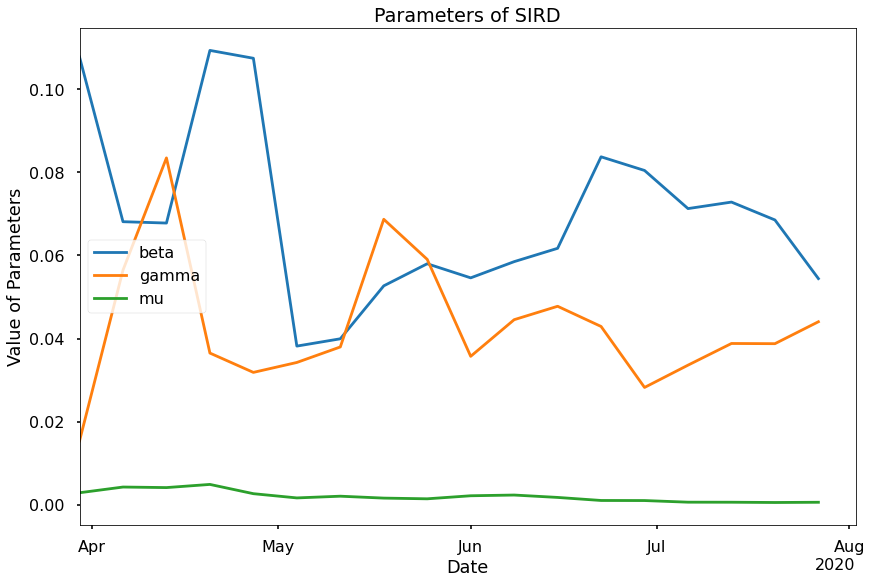

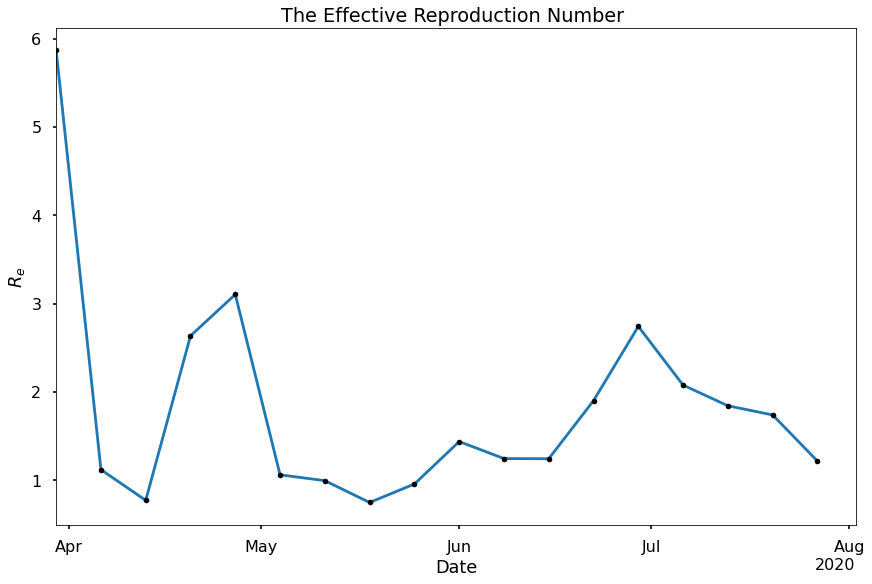

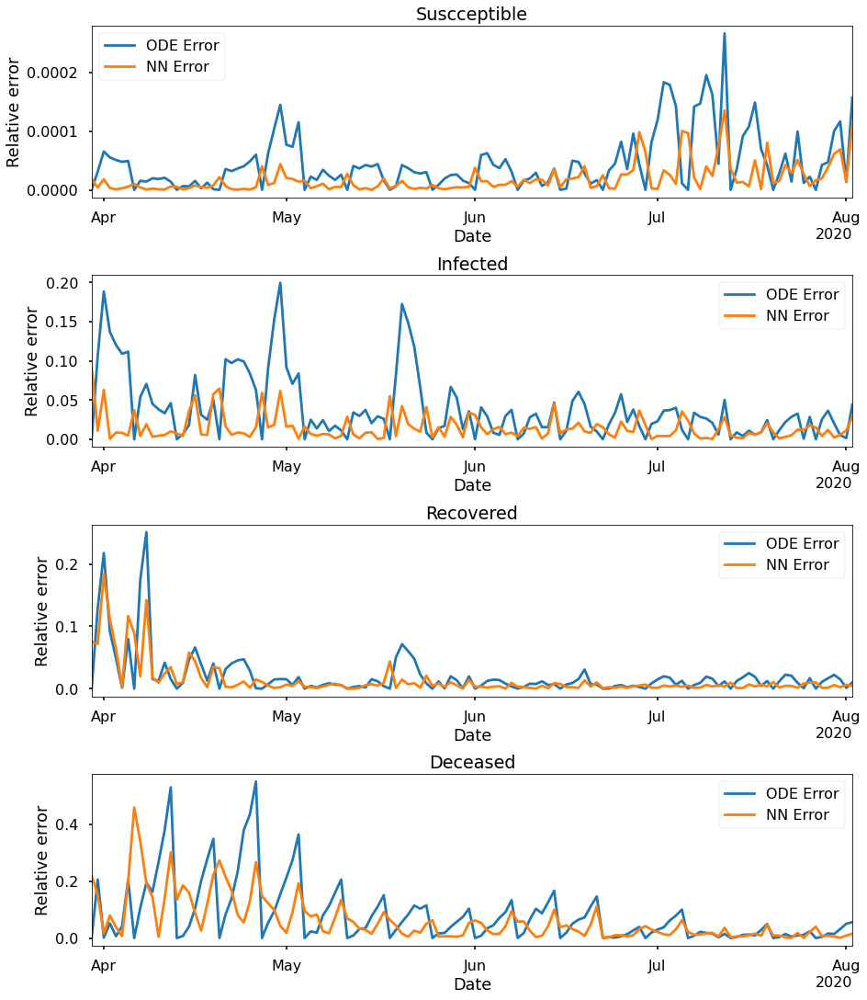

In [ ]:
layers532 = [1,32,32,32,32,32,4]
S532_ode,I532_ode,R532_ode,D532_ode,S532_learned,I532_learned,R532_learned,D532_learned,beta532,gamma532,mu532,S_errnn532,I_errnn532,R_errnn532,D_errnn532,S_erode532,I_errode532,R_errode532,D_errode532,time532 = sum_all(
    layers532,length,SS,II,RC,DC,N0,0.1,50000)

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.111e+00, GE_loss: 2.11499e+00,OB_loss: 9.96238e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 6.99, cumulative_time: 6.99
It: 10000, Loss: 3.116e-07, GE_loss: 1.13653e-07,OB_loss: 1.97905e-07, Beta: 1.04428e+00,gamma: 9.55198e-01,mu: 9.54987e-01, Time: 24.25, cumulative_time: 31.23
It: 20000, Loss: 1.235e-07, GE_loss: 3.46369e-08,OB_loss: 8.88906e-08, Beta: 1.05930e+00,gamma: 9.43641e-01,mu: 9.43115e-01, Time: 24.61, cumulative_time: 55.84
It: 30000, Loss: 7.245e-10, GE_loss: 5.97877e-11,OB_loss: 6.64761e-10, Beta: 1.09181e-01,gamma: 2.05668e-02,mu: 5.75045e-03, Time: 24.66, cumulative_time: 80.50
It: 40000, Loss: 4.515e-10, GE_loss: 4.22214e-11,OB_loss: 4.09237e-10, Beta: 1.04734e-01,gamma: 1.78267e-02,mu: 3.69843e-03, Time: 24.23, cumulative_time: 104.73
beta:  [0.10665017]
gamma:  [0.01627216]
mu:  [0.00397118]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


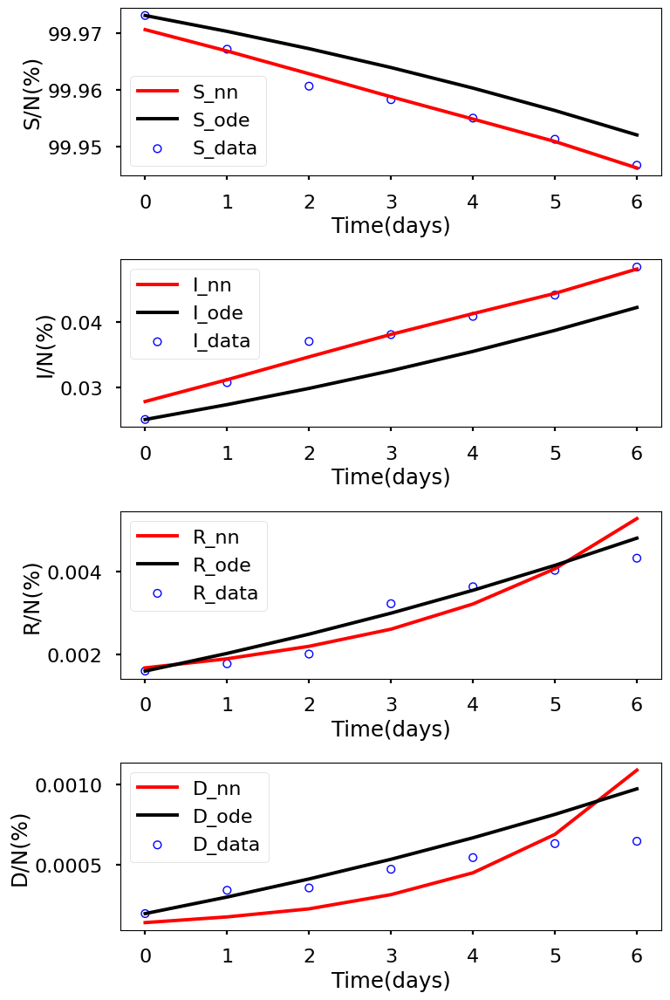

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.132e+00, GE_loss: 2.13783e+00,OB_loss: 9.94417e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 7.28, cumulative_time: 7.28
It: 10000, Loss: 3.351e-07, GE_loss: 1.37610e-07,OB_loss: 1.97473e-07, Beta: 1.04387e+00,gamma: 9.54508e-01,mu: 9.54684e-01, Time: 24.99, cumulative_time: 32.26
It: 20000, Loss: 2.319e-07, GE_loss: 6.90775e-08,OB_loss: 1.62793e-07, Beta: 1.06050e+00,gamma: 9.33493e-01,mu: 9.31213e-01, Time: 25.09, cumulative_time: 57.36
It: 30000, Loss: 6.120e-10, GE_loss: 2.25798e-10,OB_loss: 3.86229e-10, Beta: 6.61425e-02,gamma: 5.16544e-02,mu: 4.95434e-03, Time: 25.15, cumulative_time: 82.51
It: 40000, Loss: 5.102e-10, GE_loss: 1.90657e-10,OB_loss: 3.19572e-10, Beta: 6.61259e-02,gamma: 5.29749e-02,mu: 4.32761e-03, Time: 25.90, cumulative_time: 108.41
beta:  [0.06612557]
gamma:  [0.05362276]
mu:  [0.00419984]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


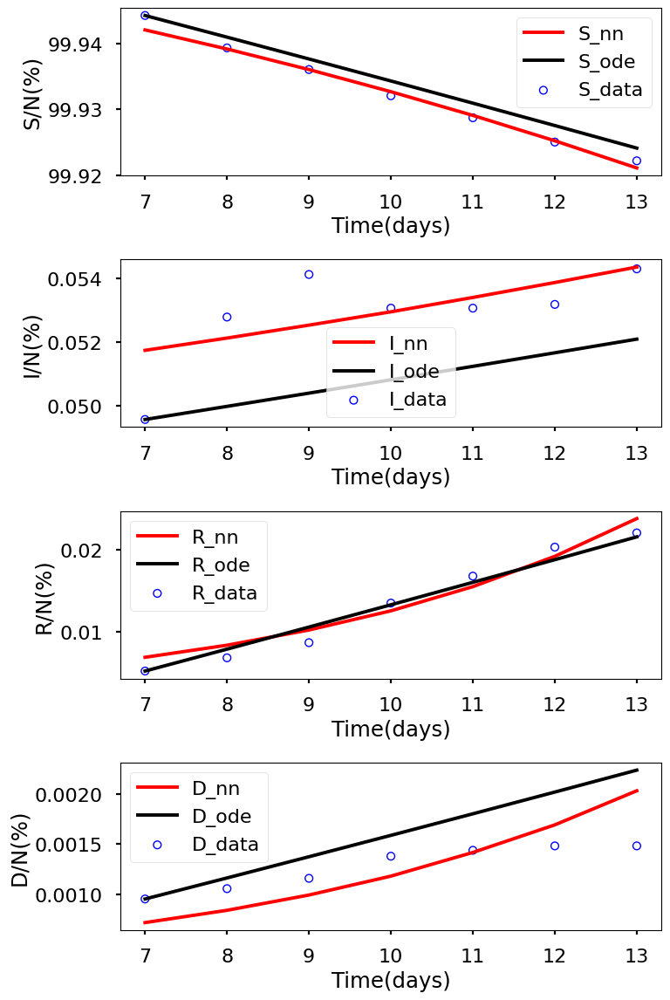

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.042e+00, GE_loss: 2.04554e+00,OB_loss: 9.96346e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 7.44, cumulative_time: 7.44
It: 10000, Loss: 3.054e-07, GE_loss: 1.05502e-07,OB_loss: 1.99890e-07, Beta: 1.04151e+00,gamma: 9.58513e-01,mu: 9.58449e-01, Time: 25.07, cumulative_time: 32.51
It: 20000, Loss: 2.223e-07, GE_loss: 6.71672e-08,OB_loss: 1.55113e-07, Beta: 1.05829e+00,gamma: 9.36676e-01,mu: 9.32199e-01, Time: 26.19, cumulative_time: 58.70
It: 30000, Loss: 9.262e-10, GE_loss: 2.12141e-10,OB_loss: 7.14060e-10, Beta: 6.62975e-02,gamma: 7.91136e-02,mu: 4.55941e-03, Time: 24.60, cumulative_time: 83.30
It: 40000, Loss: 5.718e-10, GE_loss: 9.84991e-11,OB_loss: 4.73297e-10, Beta: 6.64924e-02,gamma: 8.23815e-02,mu: 2.45150e-03, Time: 24.75, cumulative_time: 108.04
beta:  [0.06748158]
gamma:  [0.08358339]
mu:  [0.0017275]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


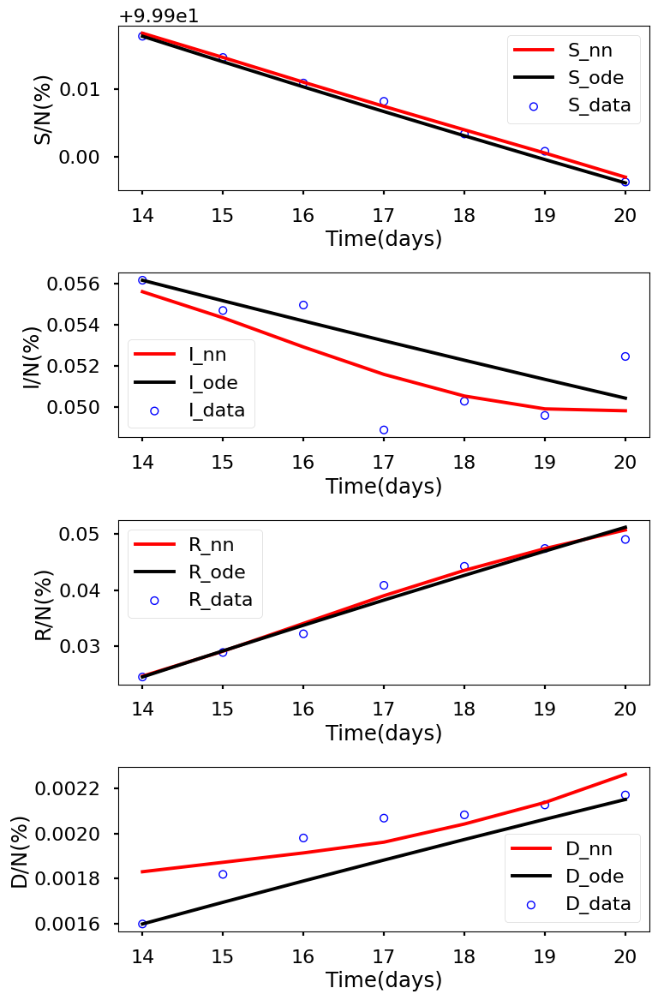

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.049e+00, GE_loss: 2.05456e+00,OB_loss: 9.94278e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 7.22, cumulative_time: 7.22
It: 10000, Loss: 3.733e-07, GE_loss: 1.49924e-07,OB_loss: 2.23339e-07, Beta: 1.04212e+00,gamma: 9.57223e-01,mu: 9.57345e-01, Time: 24.18, cumulative_time: 31.40
It: 20000, Loss: 2.822e-07, GE_loss: 8.33644e-08,OB_loss: 1.98850e-07, Beta: 1.07506e+00,gamma: 9.28019e-01,mu: 9.23513e-01, Time: 24.24, cumulative_time: 55.64
It: 30000, Loss: 2.572e-10, GE_loss: 3.32700e-11,OB_loss: 2.23908e-10, Beta: 1.12435e-01,gamma: 3.83578e-02,mu: 5.37755e-03, Time: 24.31, cumulative_time: 79.95
It: 40000, Loss: 1.992e-10, GE_loss: 8.91393e-12,OB_loss: 1.90323e-10, Beta: 1.10478e-01,gamma: 3.83046e-02,mu: 3.38303e-03, Time: 26.47, cumulative_time: 106.42
beta:  [0.11022009]
gamma:  [0.03837635]
mu:  [0.00284502]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


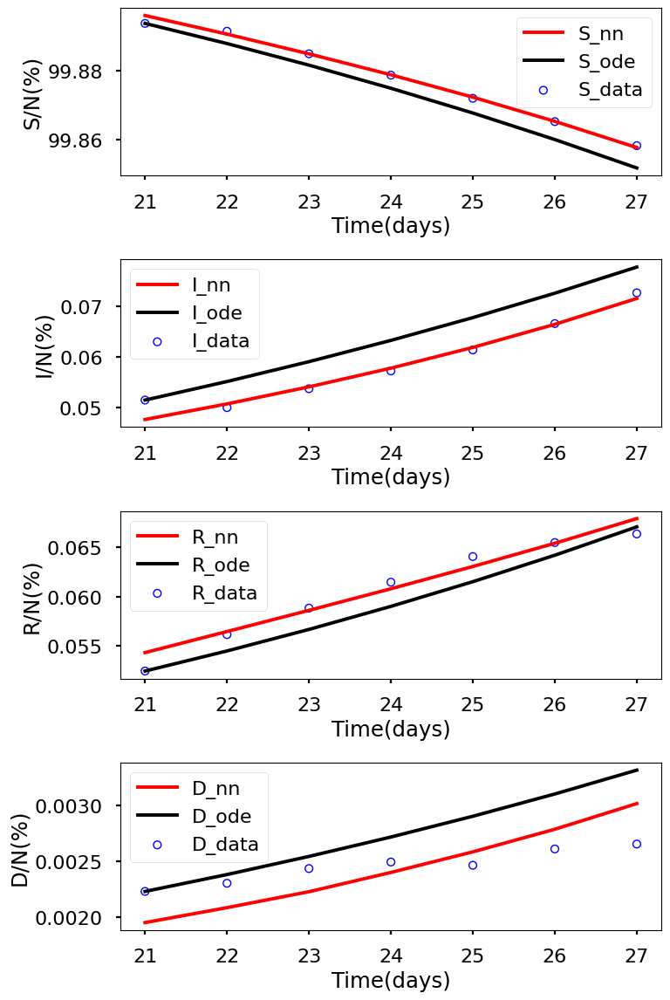

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.086e+00, GE_loss: 2.09462e+00,OB_loss: 9.91159e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 7.49, cumulative_time: 7.49
It: 10000, Loss: 6.543e-07, GE_loss: 2.15102e-07,OB_loss: 4.39209e-07, Beta: 1.04399e+00,gamma: 9.55925e-01,mu: 9.55719e-01, Time: 24.74, cumulative_time: 32.23
It: 20000, Loss: 5.625e-07, GE_loss: 1.70115e-07,OB_loss: 3.92412e-07, Beta: 1.10117e+00,gamma: 8.96317e-01,mu: 8.89723e-01, Time: 25.32, cumulative_time: 57.54
It: 30000, Loss: 2.041e-09, GE_loss: 1.99633e-10,OB_loss: 1.84118e-09, Beta: 1.14051e-01,gamma: 3.08781e-02,mu: 5.90101e-03, Time: 25.32, cumulative_time: 82.87
It: 40000, Loss: 1.769e-09, GE_loss: 3.87005e-10,OB_loss: 1.38213e-09, Beta: 1.08261e-01,gamma: 2.97471e-02,mu: 3.16457e-03, Time: 25.13, cumulative_time: 108.00
beta:  [0.1076784]
gamma:  [0.03050625]
mu:  [0.00182719]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


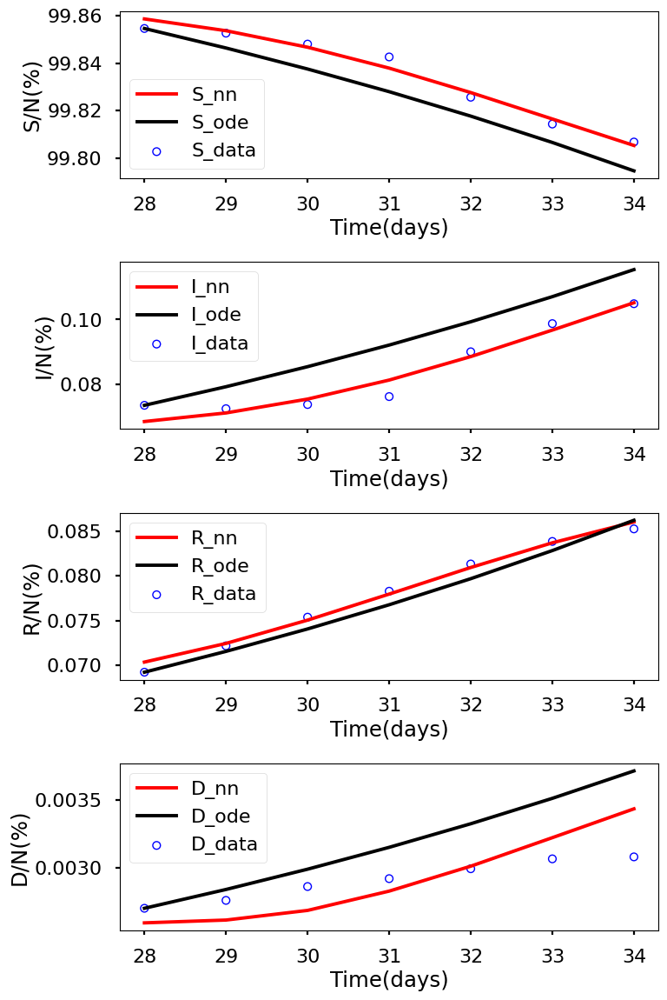

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.084e+00, GE_loss: 2.09343e+00,OB_loss: 9.90590e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 7.40, cumulative_time: 7.40
It: 10000, Loss: 1.013e-06, GE_loss: 2.78061e-07,OB_loss: 7.35367e-07, Beta: 1.04172e+00,gamma: 9.58866e-01,mu: 9.58551e-01, Time: 24.04, cumulative_time: 31.44
It: 20000, Loss: 8.720e-07, GE_loss: 2.74623e-07,OB_loss: 5.97396e-07, Beta: 1.06083e+00,gamma: 8.69648e-01,mu: 8.59407e-01, Time: 24.97, cumulative_time: 56.40
It: 30000, Loss: 1.351e-10, GE_loss: 2.25009e-11,OB_loss: 1.12604e-10, Beta: 3.91562e-02,gamma: 3.40590e-02,mu: 2.51915e-03, Time: 24.30, cumulative_time: 80.70
It: 40000, Loss: 9.916e-11, GE_loss: 1.00449e-11,OB_loss: 8.91190e-11, Beta: 3.83037e-02,gamma: 3.42194e-02,mu: 1.36563e-03, Time: 24.12, cumulative_time: 104.82
beta:  [0.03808299]
gamma:  [0.03428479]
mu:  [0.00103853]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


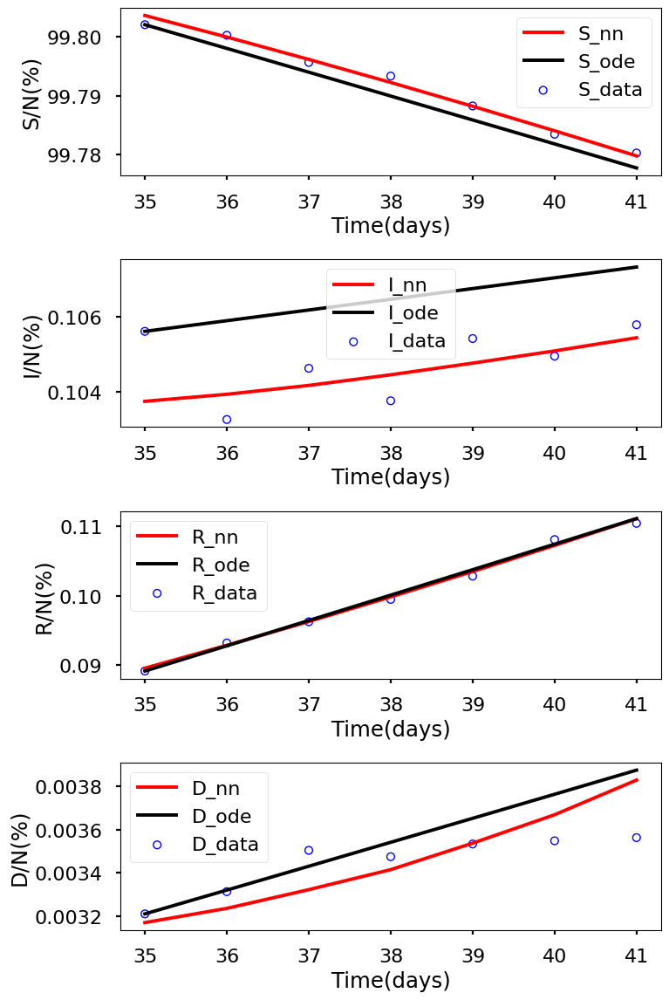

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.060e+00, GE_loss: 2.06659e+00,OB_loss: 9.93377e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 7.46, cumulative_time: 7.46
It: 10000, Loss: 1.081e-06, GE_loss: 3.26838e-07,OB_loss: 7.53898e-07, Beta: 1.04214e+00,gamma: 9.57597e-01,mu: 9.57254e-01, Time: 24.10, cumulative_time: 31.56
It: 20000, Loss: 9.419e-07, GE_loss: 3.00413e-07,OB_loss: 6.41468e-07, Beta: 1.05524e+00,gamma: 8.58732e-01,mu: 8.45489e-01, Time: 24.63, cumulative_time: 56.19
It: 30000, Loss: 2.017e-10, GE_loss: 1.85873e-11,OB_loss: 1.83159e-10, Beta: 4.10626e-02,gamma: 3.84448e-02,mu: 2.50717e-03, Time: 24.33, cumulative_time: 80.52
It: 40000, Loss: 1.717e-10, GE_loss: 1.62731e-11,OB_loss: 1.55412e-10, Beta: 4.03556e-02,gamma: 3.85345e-02,mu: 1.54270e-03, Time: 24.48, cumulative_time: 105.00
beta:  [0.04010951]
gamma:  [0.0385146]
mu:  [0.00129498]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


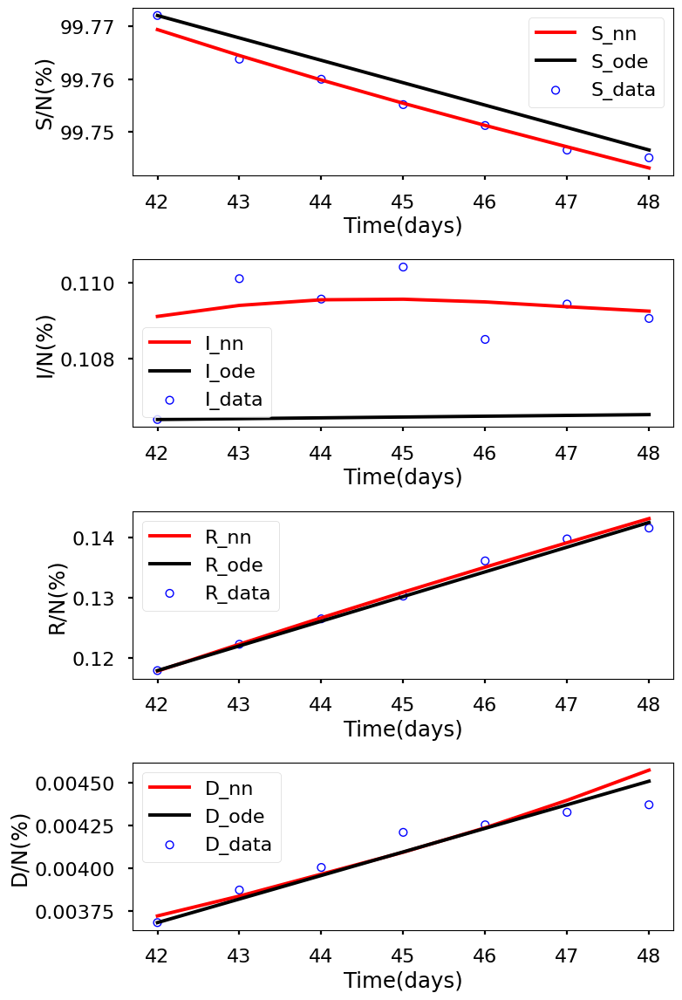

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.105e+00, GE_loss: 2.11411e+00,OB_loss: 9.91199e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 7.52, cumulative_time: 7.52
It: 10000, Loss: 9.262e-07, GE_loss: 3.14114e-07,OB_loss: 6.12134e-07, Beta: 1.04561e+00,gamma: 9.52958e-01,mu: 9.53124e-01, Time: 25.07, cumulative_time: 32.58
It: 20000, Loss: 7.794e-07, GE_loss: 2.44650e-07,OB_loss: 5.34709e-07, Beta: 1.06644e+00,gamma: 8.78791e-01,mu: 8.68089e-01, Time: 27.29, cumulative_time: 59.88
It: 30000, Loss: 2.884e-09, GE_loss: 1.07599e-09,OB_loss: 1.80807e-09, Beta: 5.41046e-02,gamma: 6.80772e-02,mu: 3.35354e-03, Time: 25.46, cumulative_time: 85.34
It: 40000, Loss: 2.867e-09, GE_loss: 1.13350e-09,OB_loss: 1.73307e-09, Beta: 5.29301e-02,gamma: 6.90872e-02,mu: 1.17435e-03, Time: 24.33, cumulative_time: 109.66
beta:  [0.05240416]
gamma:  [0.06936021]
mu:  [0.00088238]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


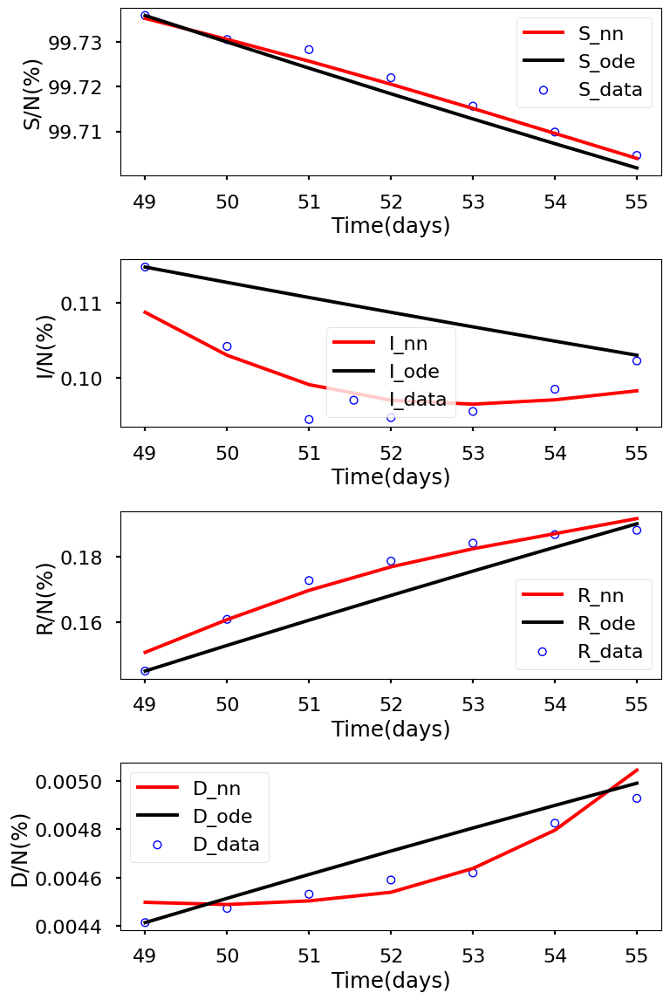

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.072e+00, GE_loss: 2.08208e+00,OB_loss: 9.90301e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 7.63, cumulative_time: 7.63
It: 10000, Loss: 9.613e-07, GE_loss: 3.04590e-07,OB_loss: 6.56739e-07, Beta: 1.04295e+00,gamma: 9.56842e-01,mu: 9.56622e-01, Time: 25.65, cumulative_time: 33.28
It: 20000, Loss: 8.267e-07, GE_loss: 2.61369e-07,OB_loss: 5.65292e-07, Beta: 1.07064e+00,gamma: 8.73198e-01,mu: 8.57442e-01, Time: 24.58, cumulative_time: 57.85
It: 30000, Loss: 1.240e-09, GE_loss: 2.97744e-10,OB_loss: 9.41930e-10, Beta: 5.90408e-02,gamma: 5.98109e-02,mu: 3.60124e-03, Time: 24.39, cumulative_time: 82.24
It: 40000, Loss: 1.171e-09, GE_loss: 3.58064e-10,OB_loss: 8.12840e-10, Beta: 5.74843e-02,gamma: 5.92784e-02,mu: 7.59048e-04, Time: 24.31, cumulative_time: 106.55
beta:  [0.05756522]
gamma:  [0.05904295]
mu:  [0.00065966]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


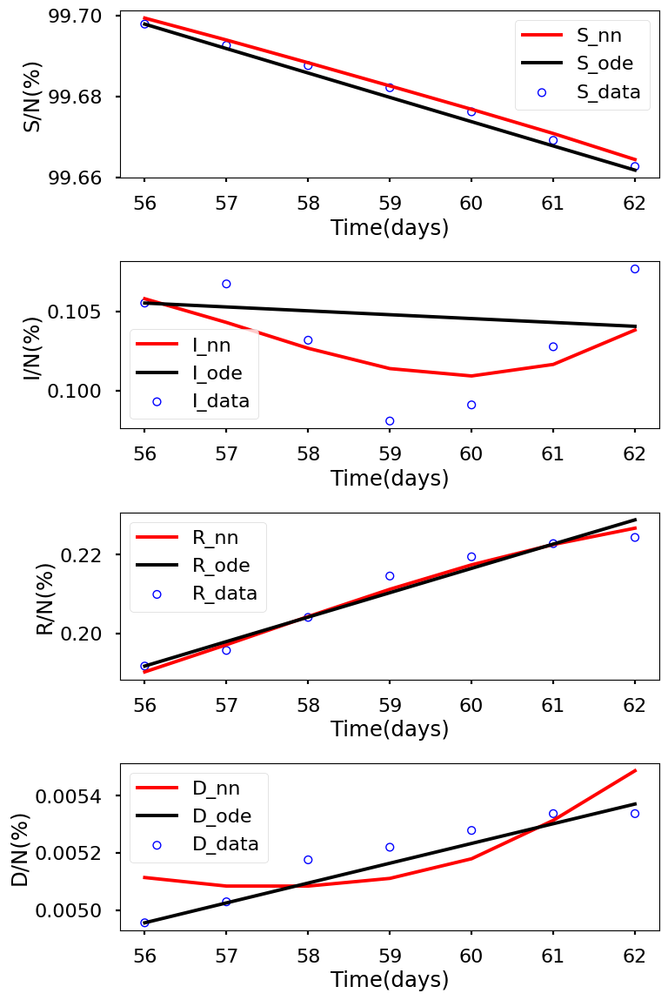

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.127e+00, GE_loss: 2.13675e+00,OB_loss: 9.90023e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 7.76, cumulative_time: 7.76
It: 10000, Loss: 1.335e-06, GE_loss: 4.22749e-07,OB_loss: 9.11894e-07, Beta: 1.04611e+00,gamma: 9.53272e-01,mu: 9.53316e-01, Time: 24.40, cumulative_time: 32.16
It: 20000, Loss: 1.104e-06, GE_loss: 3.58212e-07,OB_loss: 7.46199e-07, Beta: 1.06937e+00,gamma: 8.38260e-01,mu: 8.29594e-01, Time: 24.53, cumulative_time: 56.69
It: 30000, Loss: 9.766e-10, GE_loss: 3.67139e-10,OB_loss: 6.09440e-10, Beta: 5.42750e-02,gamma: 3.54165e-02,mu: 2.57305e-03, Time: 24.03, cumulative_time: 80.72
It: 40000, Loss: 5.161e-10, GE_loss: 7.37559e-11,OB_loss: 4.42300e-10, Beta: 5.40108e-02,gamma: 3.57445e-02,mu: 1.54044e-03, Time: 24.05, cumulative_time: 104.77
beta:  [0.0542254]
gamma:  [0.03599722]
mu:  [0.00125571]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


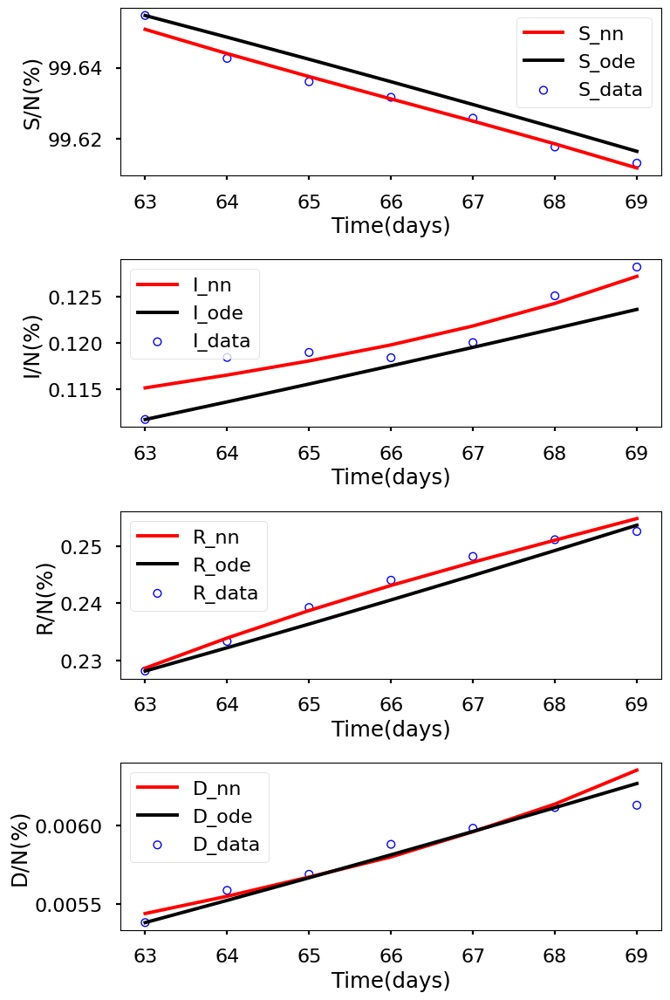

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.098e+00, GE_loss: 2.10928e+00,OB_loss: 9.88427e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 7.52, cumulative_time: 7.52
It: 10000, Loss: 1.600e-06, GE_loss: 4.59790e-07,OB_loss: 1.14014e-06, Beta: 1.04514e+00,gamma: 9.54577e-01,mu: 9.54320e-01, Time: 25.30, cumulative_time: 32.82
It: 20000, Loss: 1.335e-06, GE_loss: 4.48768e-07,OB_loss: 8.86151e-07, Beta: 1.05327e+00,gamma: 8.07425e-01,mu: 7.90590e-01, Time: 23.73, cumulative_time: 56.55
It: 30000, Loss: 8.090e-10, GE_loss: 1.80003e-10,OB_loss: 6.29031e-10, Beta: 5.89270e-02,gamma: 4.52521e-02,mu: 1.63927e-03, Time: 24.40, cumulative_time: 80.95
It: 40000, Loss: 8.543e-10, GE_loss: 2.23911e-10,OB_loss: 6.30386e-10, Beta: 5.82858e-02,gamma: 4.50733e-02,mu: 1.03807e-03, Time: 25.21, cumulative_time: 106.16
beta:  [0.05820058]
gamma:  [0.04499021]
mu:  [0.00102529]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


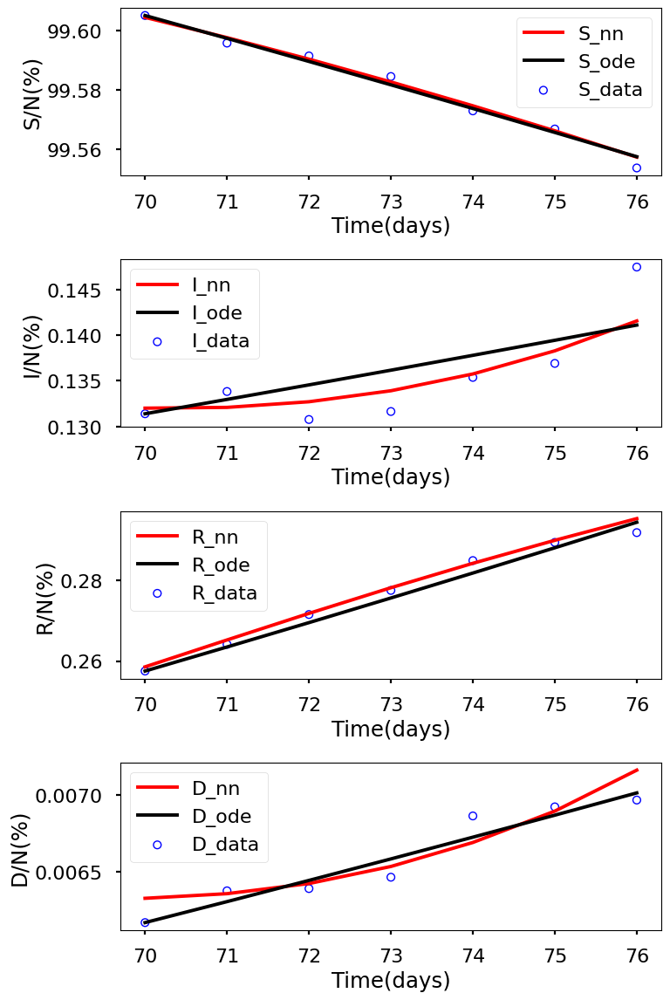

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.075e+00, GE_loss: 2.08979e+00,OB_loss: 9.85493e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 7.88, cumulative_time: 7.88
It: 10000, Loss: 2.112e-06, GE_loss: 5.92336e-07,OB_loss: 1.51937e-06, Beta: 1.04659e+00,gamma: 9.52480e-01,mu: 9.52086e-01, Time: 29.57, cumulative_time: 37.45
It: 20000, Loss: 1.657e-06, GE_loss: 6.05747e-07,OB_loss: 1.05174e-06, Beta: 1.01533e+00,gamma: 7.50729e-01,mu: 7.27670e-01, Time: 24.10, cumulative_time: 61.55
It: 30000, Loss: 2.819e-09, GE_loss: 8.23312e-10,OB_loss: 1.99575e-09, Beta: 6.17991e-02,gamma: 4.83914e-02,mu: 1.17369e-03, Time: 24.26, cumulative_time: 85.81
It: 40000, Loss: 2.457e-09, GE_loss: 5.82266e-10,OB_loss: 1.87427e-09, Beta: 6.10947e-02,gamma: 4.80598e-02,mu: 8.09783e-04, Time: 23.85, cumulative_time: 109.66
beta:  [0.06105587]
gamma:  [0.04802296]
mu:  [0.00078393]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


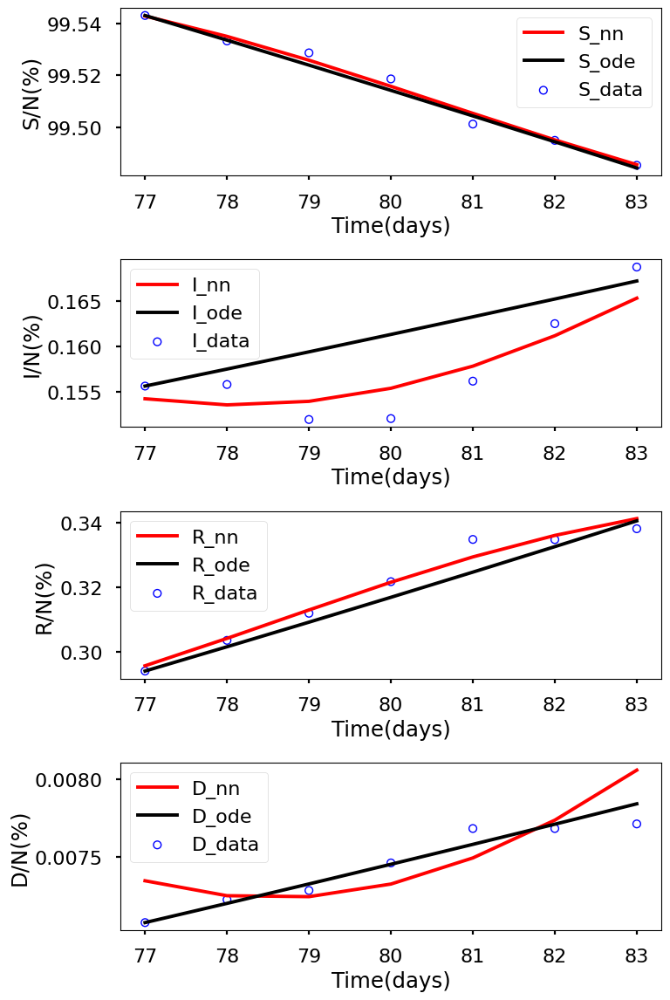

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.060e+00, GE_loss: 2.07395e+00,OB_loss: 9.85581e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 8.08, cumulative_time: 8.08
It: 10000, Loss: 2.902e-06, GE_loss: 7.91651e-07,OB_loss: 2.11039e-06, Beta: 1.04484e+00,gamma: 9.54923e-01,mu: 9.54354e-01, Time: 25.03, cumulative_time: 33.12
It: 20000, Loss: 1.894e-06, GE_loss: 8.04044e-07,OB_loss: 1.08974e-06, Beta: 9.36779e-01,gamma: 6.39418e-01,mu: 5.98240e-01, Time: 26.97, cumulative_time: 60.09
It: 30000, Loss: 1.357e-09, GE_loss: 1.94189e-10,OB_loss: 1.16324e-09, Beta: 8.38583e-02,gamma: 4.31058e-02,mu: 1.00511e-03, Time: 25.01, cumulative_time: 85.10
It: 40000, Loss: 1.352e-09, GE_loss: 1.95690e-10,OB_loss: 1.15649e-09, Beta: 8.36707e-02,gamma: 4.31111e-02,mu: 7.24606e-04, Time: 24.67, cumulative_time: 109.77
beta:  [0.08365566]
gamma:  [0.04310139]
mu:  [0.00072267]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


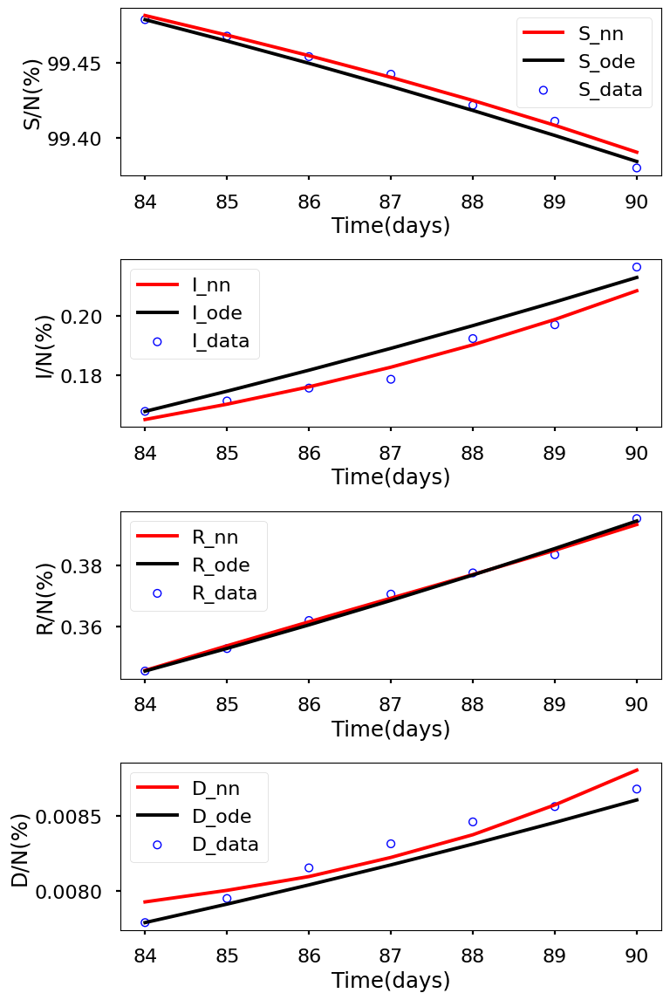

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.088e+00, GE_loss: 2.10807e+00,OB_loss: 9.80331e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 7.94, cumulative_time: 7.94
It: 10000, Loss: 6.214e-06, GE_loss: 1.75315e-06,OB_loss: 4.46054e-06, Beta: 1.04918e+00,gamma: 9.50711e-01,mu: 9.49891e-01, Time: 24.32, cumulative_time: 32.26
It: 20000, Loss: 7.104e-07, GE_loss: 4.94236e-07,OB_loss: 2.16188e-07, Beta: 3.42166e-01,gamma: 2.30699e-01,mu: 1.72815e-01, Time: 24.20, cumulative_time: 56.46
It: 30000, Loss: 2.924e-09, GE_loss: 8.83379e-10,OB_loss: 2.04055e-09, Beta: 8.11051e-02,gamma: 2.83702e-02,mu: 1.59329e-03, Time: 24.22, cumulative_time: 80.68
It: 40000, Loss: 2.724e-09, GE_loss: 9.11024e-10,OB_loss: 1.81308e-09, Beta: 8.05169e-02,gamma: 2.84339e-02,mu: 8.77640e-04, Time: 26.15, cumulative_time: 106.83
beta:  [0.08041053]
gamma:  [0.02836571]
mu:  [0.0007391]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


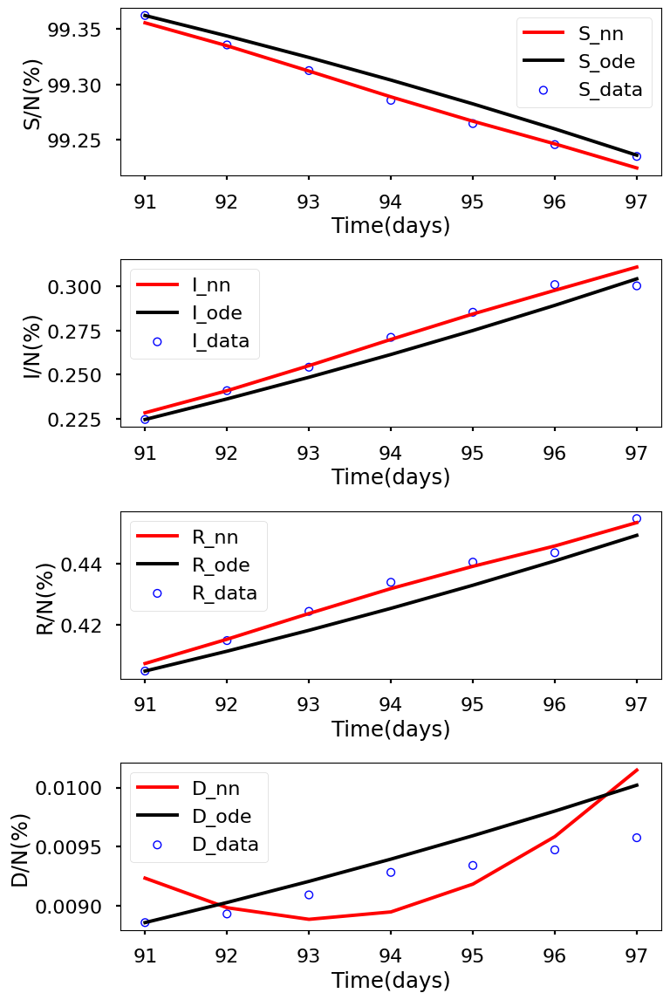

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.055e+00, GE_loss: 2.07597e+00,OB_loss: 9.79034e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 7.85, cumulative_time: 7.85
It: 10000, Loss: 1.063e-05, GE_loss: 3.04708e-06,OB_loss: 7.58085e-06, Beta: 1.04830e+00,gamma: 9.52467e-01,mu: 9.51408e-01, Time: 24.58, cumulative_time: 32.43
It: 20000, Loss: 9.346e-09, GE_loss: 3.81063e-09,OB_loss: 5.53577e-09, Beta: 8.14985e-02,gamma: 4.51807e-02,mu: 6.58252e-03, Time: 24.66, cumulative_time: 57.09
It: 30000, Loss: 4.216e-09, GE_loss: 5.51906e-10,OB_loss: 3.66398e-09, Beta: 7.12471e-02,gamma: 3.44460e-02,mu: 7.44249e-04, Time: 24.51, cumulative_time: 81.60
It: 40000, Loss: 3.957e-09, GE_loss: 7.08296e-10,OB_loss: 3.24836e-09, Beta: 7.13375e-02,gamma: 3.41342e-02,mu: 6.29415e-04, Time: 24.46, cumulative_time: 106.06
beta:  [0.07138672]
gamma:  [0.03386376]
mu:  [0.00064856]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


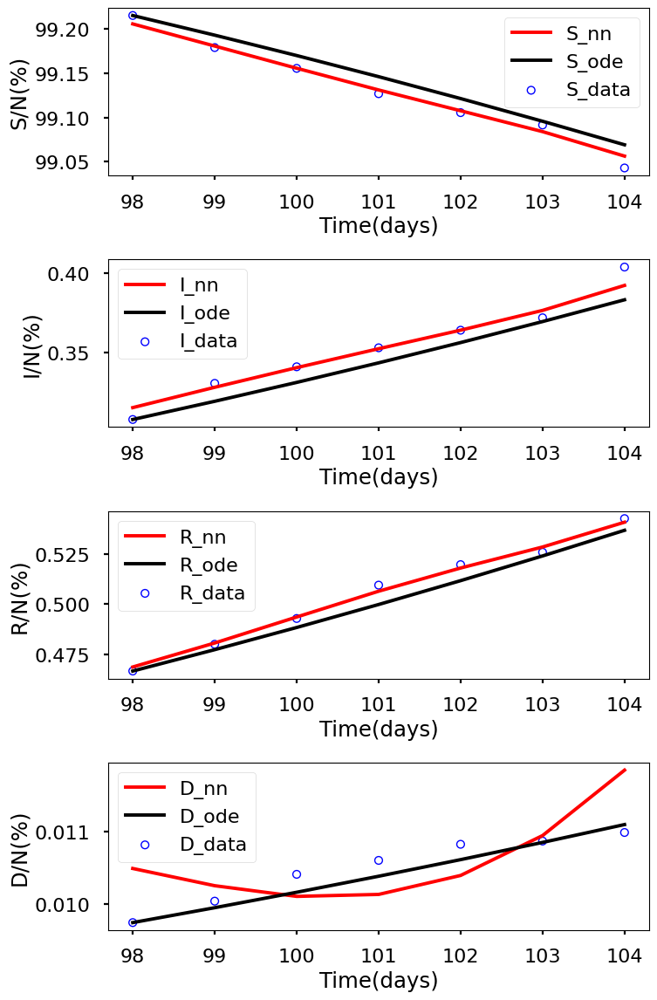

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.050e+00, GE_loss: 2.07661e+00,OB_loss: 9.73802e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 8.22, cumulative_time: 8.22
It: 10000, Loss: 1.692e-05, GE_loss: 4.88832e-06,OB_loss: 1.20311e-05, Beta: 1.05248e+00,gamma: 9.45942e-01,mu: 9.44578e-01, Time: 24.59, cumulative_time: 32.81
It: 20000, Loss: 6.459e-09, GE_loss: 1.45380e-09,OB_loss: 5.00490e-09, Beta: 7.61953e-02,gamma: 3.84927e-02,mu: 4.46972e-03, Time: 25.06, cumulative_time: 57.87
It: 30000, Loss: 4.357e-09, GE_loss: 1.05652e-09,OB_loss: 3.30042e-09, Beta: 7.29946e-02,gamma: 3.83091e-02,mu: 8.08097e-04, Time: 25.23, cumulative_time: 83.10
It: 40000, Loss: 4.248e-09, GE_loss: 1.21632e-09,OB_loss: 3.03132e-09, Beta: 7.29239e-02,gamma: 3.86238e-02,mu: 6.13765e-04, Time: 24.79, cumulative_time: 107.89
beta:  [0.07287635]
gamma:  [0.0387296]
mu:  [0.00057553]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


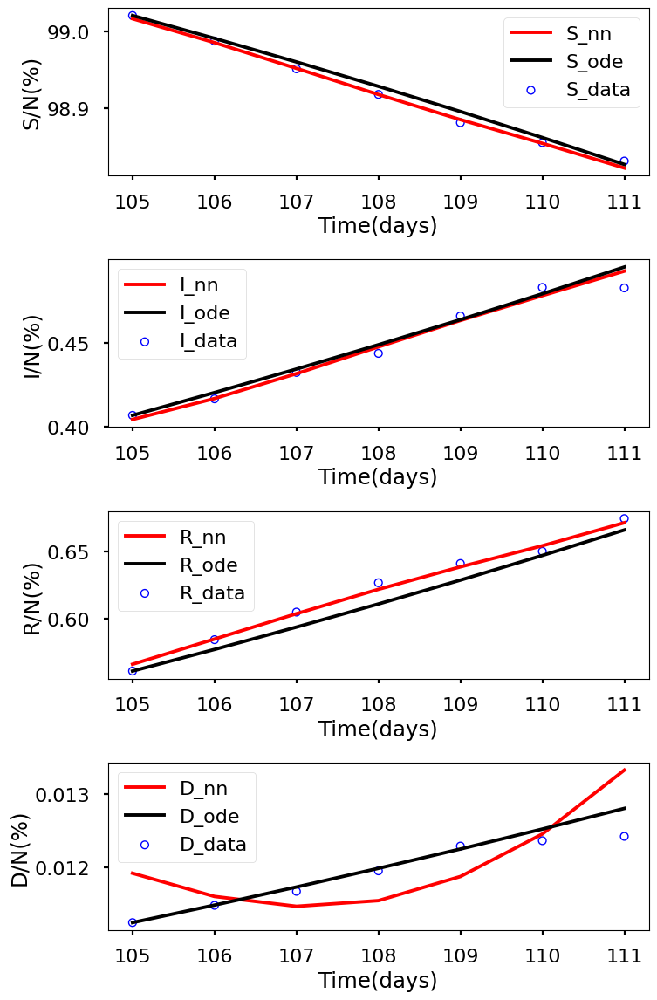

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.074e+00, GE_loss: 2.10321e+00,OB_loss: 9.70596e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 8.20, cumulative_time: 8.20
It: 10000, Loss: 2.290e-05, GE_loss: 6.64033e-06,OB_loss: 1.62570e-05, Beta: 1.05496e+00,gamma: 9.43045e-01,mu: 9.40901e-01, Time: 23.83, cumulative_time: 32.03
It: 20000, Loss: 7.997e-09, GE_loss: 1.76894e-09,OB_loss: 6.22844e-09, Beta: 6.94146e-02,gamma: 3.82832e-02,mu: 2.50710e-03, Time: 23.78, cumulative_time: 55.81
It: 30000, Loss: 8.745e-09, GE_loss: 2.46796e-09,OB_loss: 6.27665e-09, Beta: 6.87608e-02,gamma: 3.90886e-02,mu: 5.90028e-04, Time: 23.93, cumulative_time: 79.73
It: 40000, Loss: 7.274e-09, GE_loss: 1.42928e-09,OB_loss: 5.84462e-09, Beta: 6.87336e-02,gamma: 3.91652e-02,mu: 5.36986e-04, Time: 23.91, cumulative_time: 103.65
beta:  [0.06875962]
gamma:  [0.03918686]
mu:  [0.00048944]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


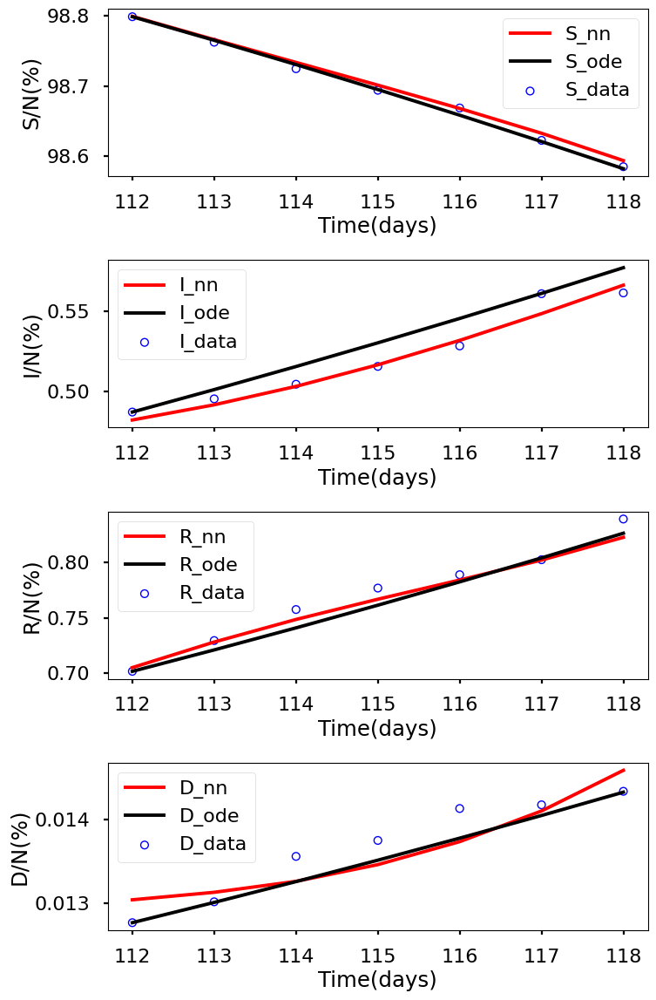

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.039e+00, GE_loss: 2.07072e+00,OB_loss: 9.68358e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 8.13, cumulative_time: 8.13
It: 10000, Loss: 2.704e-05, GE_loss: 7.89065e-06,OB_loss: 1.91469e-05, Beta: 1.05428e+00,gamma: 9.43031e-01,mu: 9.40905e-01, Time: 26.85, cumulative_time: 34.98
It: 20000, Loss: 1.314e-08, GE_loss: 2.17303e-09,OB_loss: 1.09720e-08, Beta: 5.56184e-02,gamma: 4.29635e-02,mu: 2.75347e-03, Time: 24.44, cumulative_time: 59.41
It: 30000, Loss: 1.165e-08, GE_loss: 3.00248e-09,OB_loss: 8.65048e-09, Beta: 5.43152e-02,gamma: 4.40139e-02,mu: 3.89247e-04, Time: 25.35, cumulative_time: 84.76
It: 40000, Loss: 1.108e-08, GE_loss: 2.96774e-09,OB_loss: 8.11024e-09, Beta: 5.42847e-02,gamma: 4.40209e-02,mu: 3.84763e-04, Time: 24.67, cumulative_time: 109.43
beta:  [0.05429952]
gamma:  [0.04406999]
mu:  [0.00036132]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


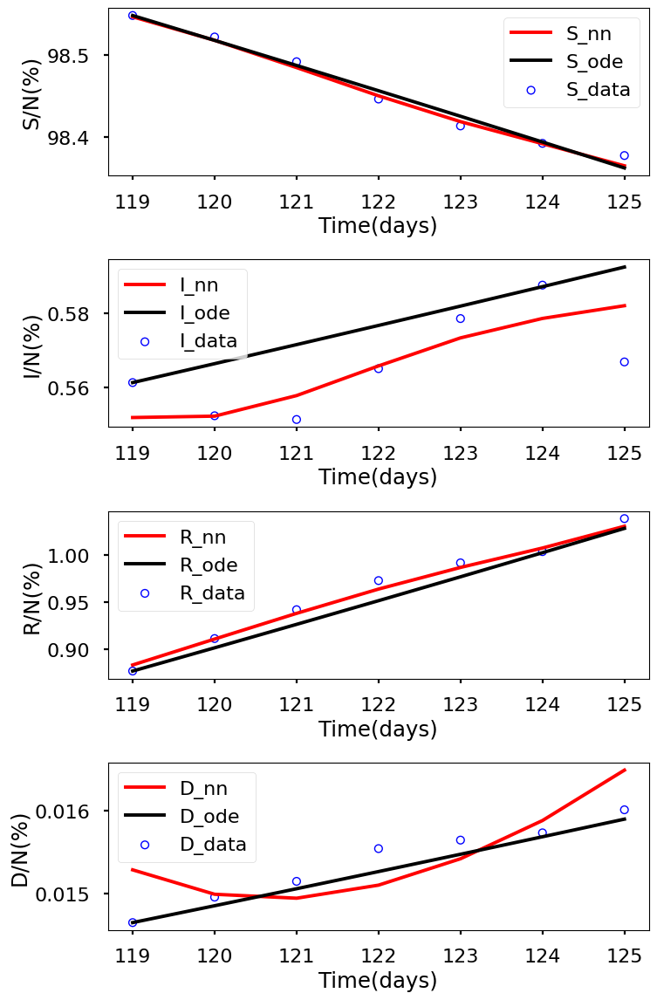

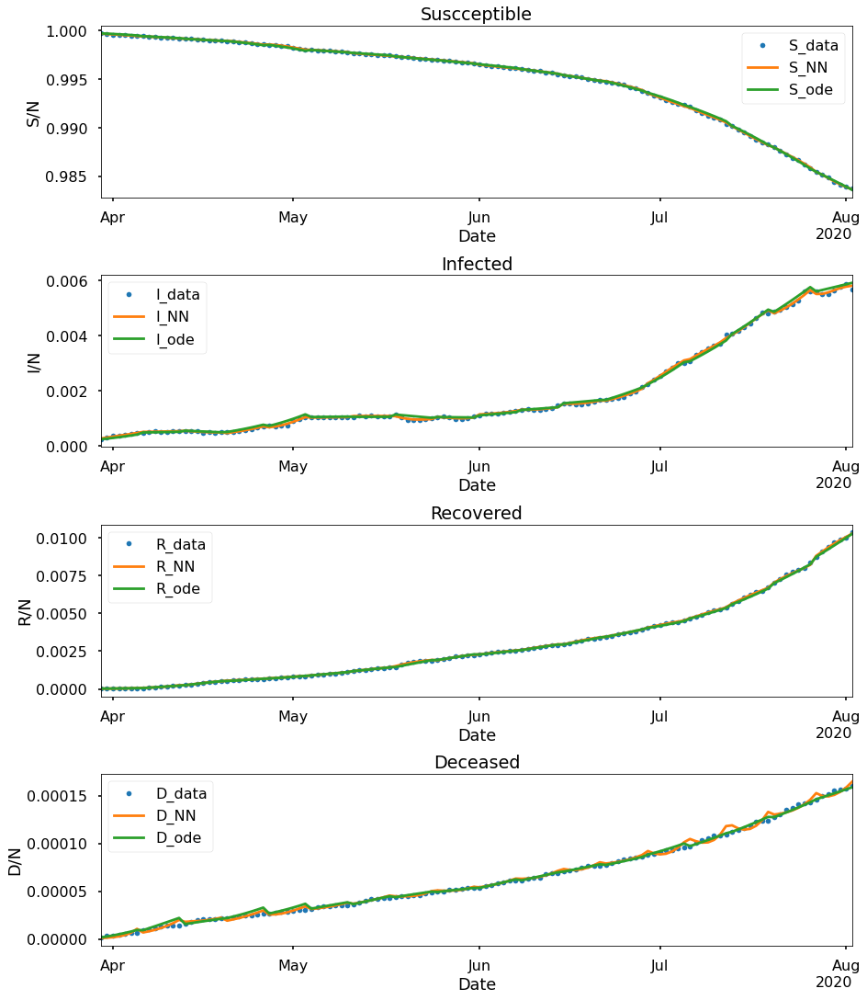

+---------------------+--------------+--------------+--------------+-------------+--------------+-------------+--------------+--------------+---------------+-------------+--------------+---------------+---------------+---------------+--------------+--------------+--------------+---------------+
|      Paramaters     |    Week 1    |    Week 2    |    Week 3    |    Week 4   |    Week 5    |    Week 6   |    Week 7    |    Week 8    |     Week 9    |   Week 10   |   Week 11    |    Week 12    |    Week 13    |    Week 14    |   Week 15    |   Week 16    |   Week 17    |    Week 18    |
+---------------------+--------------+--------------+--------------+-------------+--------------+-------------+--------------+--------------+---------------+-------------+--------------+---------------+---------------+---------------+--------------+--------------+--------------+---------------+
|         beta        |  0.10665017  |  0.06612557  | 0.067481585  |  0.11022009 |  0.1076784   | 0.038082987 | 

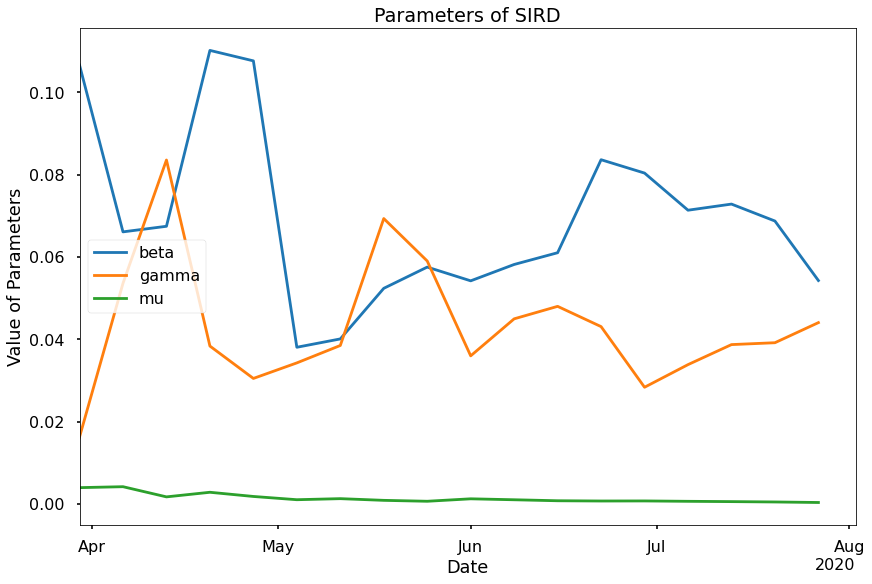

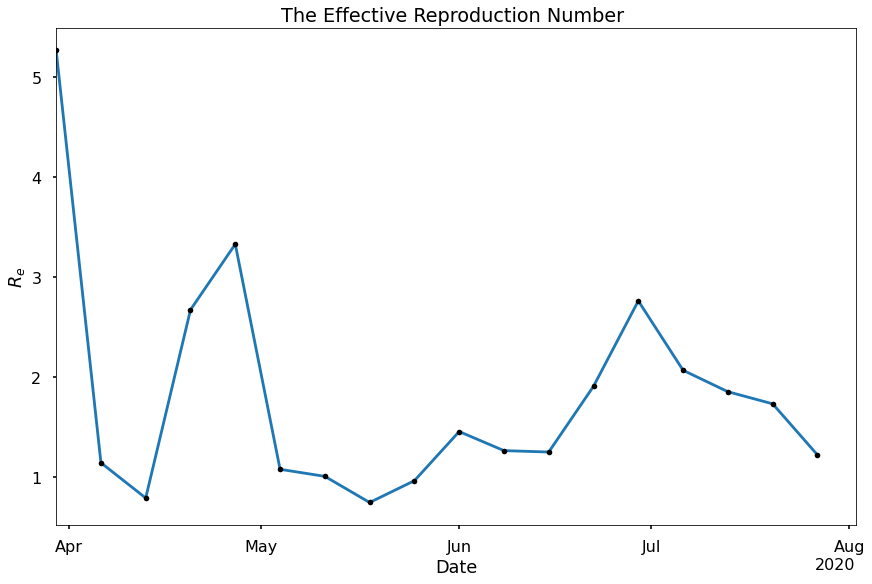

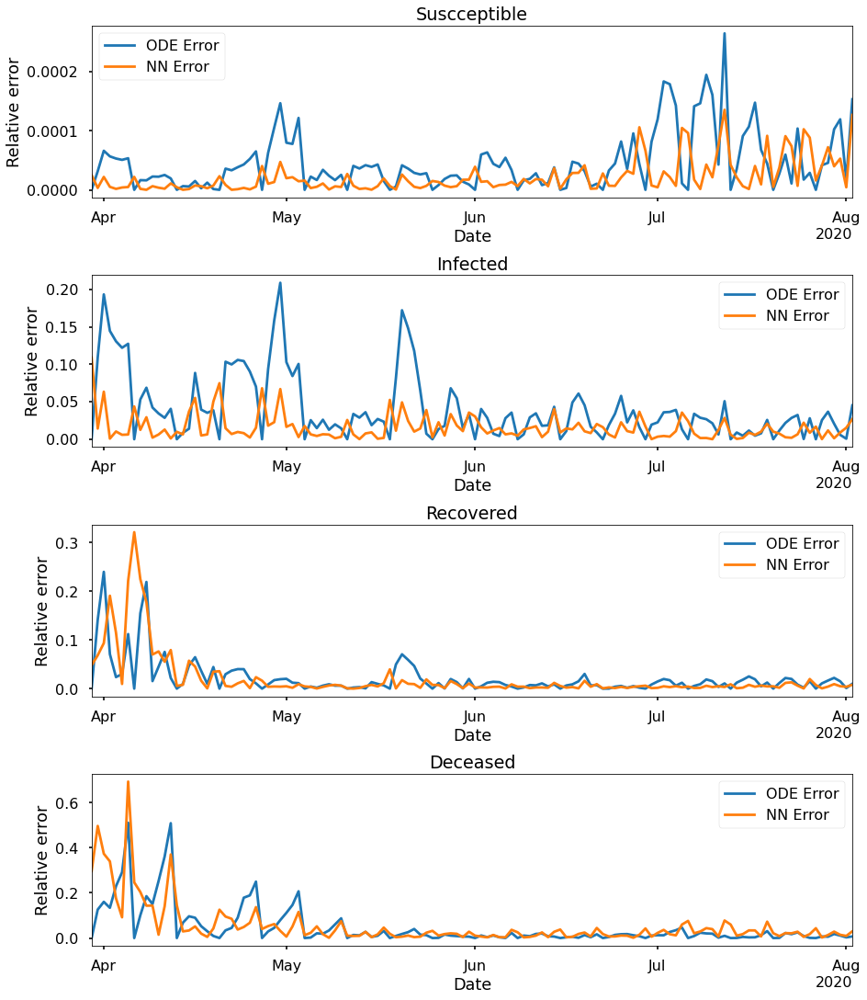

In [ ]:
layers264 = [1,64,64,4]
S264_ode,I264_ode,R264_ode,D264_ode,S264_learned,I264_learned,R264_learned,D264_learned,beta264,gamma264,mu264,S_errnn264,I_errnn264,R_errnn264,D_errnn264,S_erode264,I_errode264,R_errode264,D_errode264,time264 = sum_all(
    layers264,length,SS,II,RC,DC,N0,0.1,50000)

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.041e+00, GE_loss: 2.04875e+00,OB_loss: 9.92281e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 8.20, cumulative_time: 8.20
It: 10000, Loss: 2.136e-07, GE_loss: 5.83792e-08,OB_loss: 1.55225e-07, Beta: 1.02991e+00,gamma: 9.70397e-01,mu: 9.70196e-01, Time: 28.36, cumulative_time: 36.56
It: 20000, Loss: 1.253e-07, GE_loss: 3.50795e-08,OB_loss: 9.01899e-08, Beta: 1.04979e+00,gamma: 9.55352e-01,mu: 9.55049e-01, Time: 28.52, cumulative_time: 65.08
It: 30000, Loss: 8.503e-10, GE_loss: 8.33144e-11,OB_loss: 7.66965e-10, Beta: 1.04712e-01,gamma: 1.55564e-02,mu: 4.30374e-03, Time: 31.76, cumulative_time: 96.83
It: 40000, Loss: 3.994e-10, GE_loss: 5.89798e-11,OB_loss: 3.40416e-10, Beta: 1.06287e-01,gamma: 1.49469e-02,mu: 4.99188e-03, Time: 29.10, cumulative_time: 125.93
beta:  [0.1073673]
gamma:  [0.01297692]
mu:  [0.004669]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


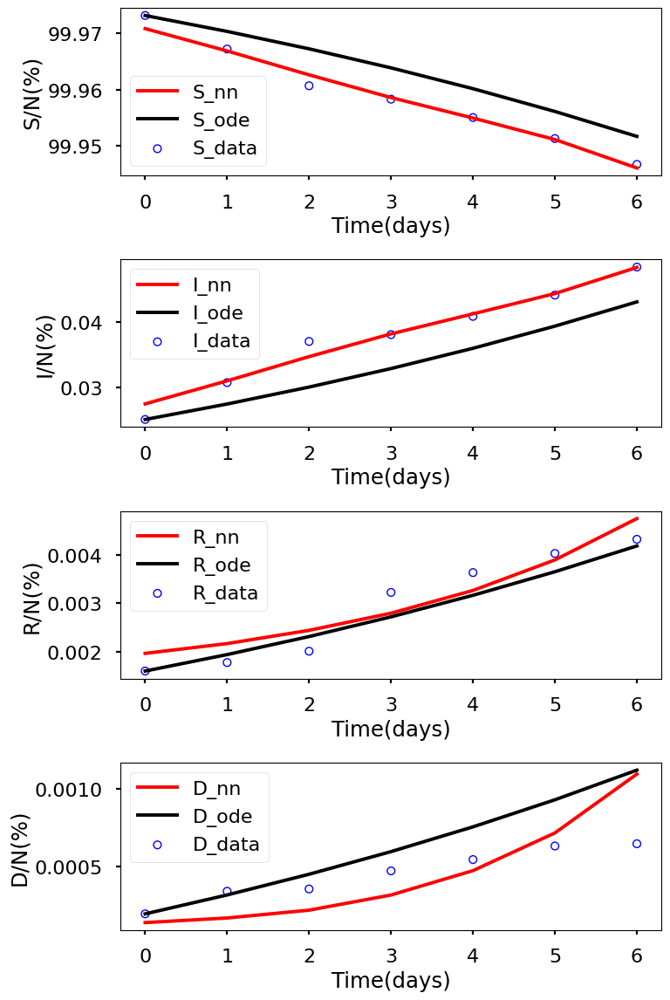

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.048e+00, GE_loss: 2.05791e+00,OB_loss: 9.89851e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 8.31, cumulative_time: 8.31
It: 10000, Loss: 2.632e-07, GE_loss: 7.99606e-08,OB_loss: 1.83194e-07, Beta: 1.03026e+00,gamma: 9.69760e-01,mu: 9.69901e-01, Time: 28.27, cumulative_time: 36.58
It: 20000, Loss: 2.336e-07, GE_loss: 6.98637e-08,OB_loss: 1.63714e-07, Beta: 1.05521e+00,gamma: 9.41714e-01,mu: 9.39707e-01, Time: 28.13, cumulative_time: 64.71
It: 30000, Loss: 7.019e-10, GE_loss: 2.60894e-10,OB_loss: 4.40960e-10, Beta: 6.55681e-02,gamma: 5.09348e-02,mu: 5.29969e-03, Time: 28.31, cumulative_time: 93.02
It: 40000, Loss: 3.322e-10, GE_loss: 1.18542e-10,OB_loss: 2.13654e-10, Beta: 6.57580e-02,gamma: 5.40380e-02,mu: 4.57582e-03, Time: 30.68, cumulative_time: 123.70
beta:  [0.06674003]
gamma:  [0.05660035]
mu:  [0.00446747]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


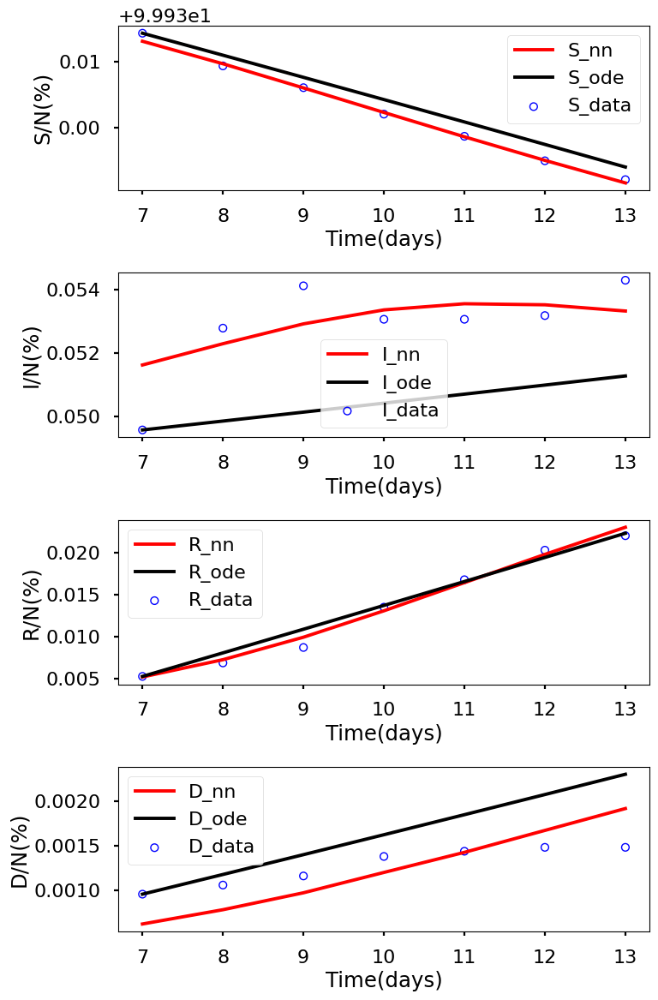

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.055e+00, GE_loss: 2.06479e+00,OB_loss: 9.89993e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 8.45, cumulative_time: 8.45
It: 10000, Loss: 2.615e-07, GE_loss: 8.93805e-08,OB_loss: 1.72160e-07, Beta: 1.03066e+00,gamma: 9.69455e-01,mu: 9.69486e-01, Time: 28.20, cumulative_time: 36.65
It: 20000, Loss: 2.238e-07, GE_loss: 6.73587e-08,OB_loss: 1.56396e-07, Beta: 1.05175e+00,gamma: 9.44088e-01,mu: 9.39437e-01, Time: 28.20, cumulative_time: 64.85
It: 30000, Loss: 5.014e-10, GE_loss: 4.53630e-11,OB_loss: 4.55998e-10, Beta: 7.19950e-02,gamma: 8.71762e-02,mu: 5.13932e-03, Time: 28.69, cumulative_time: 93.54
It: 40000, Loss: 4.249e-10, GE_loss: 3.16288e-11,OB_loss: 3.93308e-10, Beta: 6.84321e-02,gamma: 8.51709e-02,mu: 3.16446e-03, Time: 27.85, cumulative_time: 121.39
beta:  [0.06793877]
gamma:  [0.08444838]
mu:  [0.0026174]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


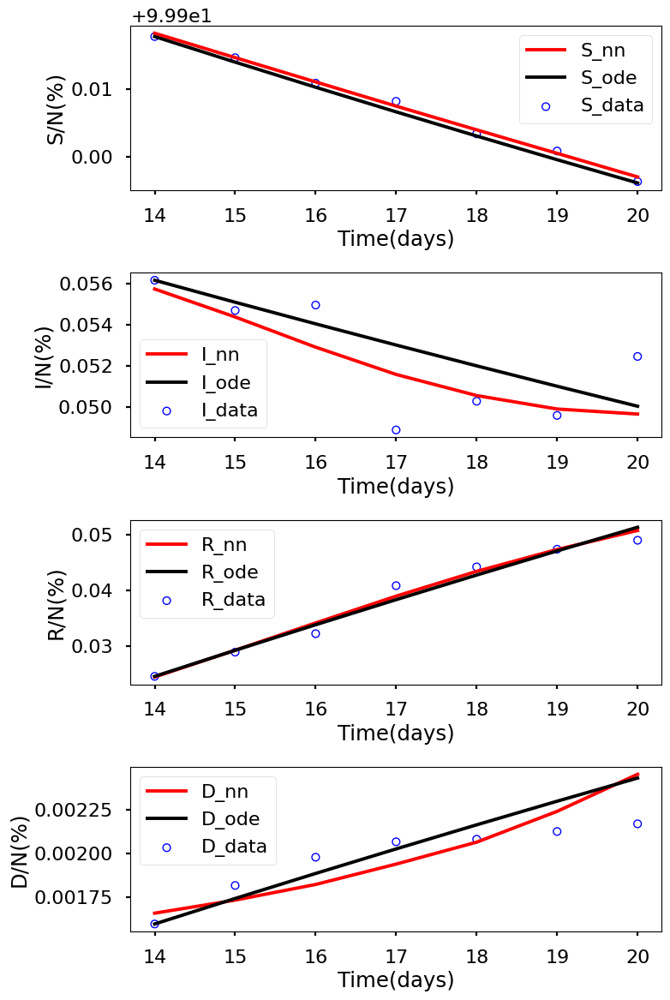

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.003e+00, GE_loss: 2.00634e+00,OB_loss: 9.97037e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 8.26, cumulative_time: 8.26
It: 10000, Loss: 3.536e-07, GE_loss: 8.90714e-08,OB_loss: 2.64507e-07, Beta: 1.02983e+00,gamma: 9.70562e-01,mu: 9.70638e-01, Time: 28.12, cumulative_time: 36.38
It: 20000, Loss: 2.857e-07, GE_loss: 8.46404e-08,OB_loss: 2.01023e-07, Beta: 1.07058e+00,gamma: 9.34888e-01,mu: 9.28739e-01, Time: 28.31, cumulative_time: 64.68
It: 30000, Loss: 2.132e-10, GE_loss: 5.08504e-11,OB_loss: 1.62398e-10, Beta: 1.10282e-01,gamma: 3.57495e-02,mu: 7.57761e-03, Time: 27.80, cumulative_time: 92.48
It: 40000, Loss: 1.699e-10, GE_loss: 3.84369e-11,OB_loss: 1.31478e-10, Beta: 1.09220e-01,gamma: 3.65568e-02,mu: 4.45728e-03, Time: 27.66, cumulative_time: 120.14
beta:  [0.10886467]
gamma:  [0.03694051]
mu:  [0.00321146]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


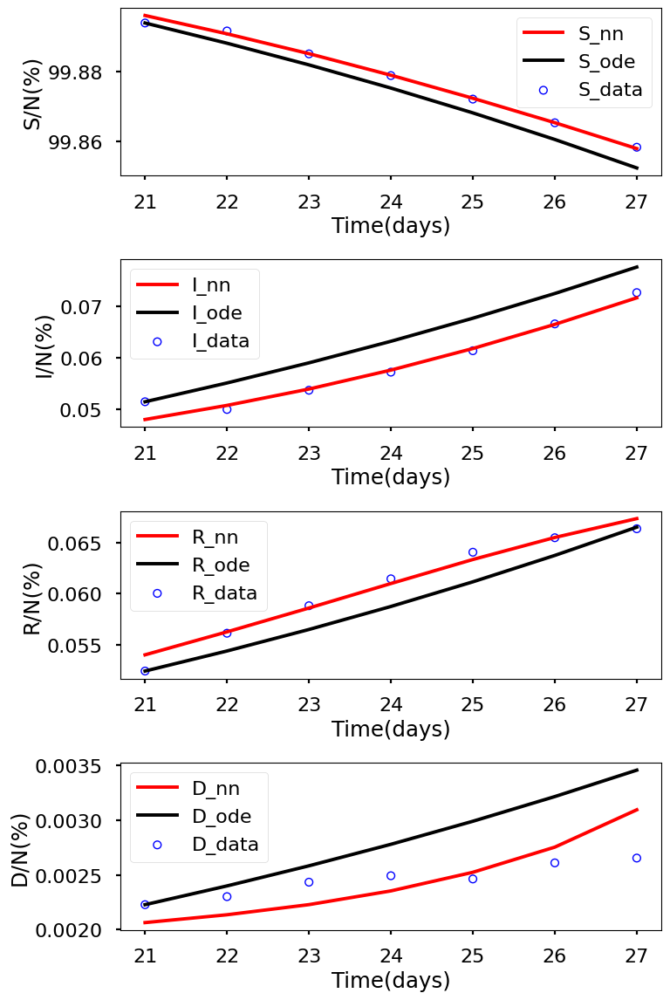

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.071e+00, GE_loss: 2.08046e+00,OB_loss: 9.90940e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 8.61, cumulative_time: 8.61
It: 10000, Loss: 6.293e-07, GE_loss: 1.70626e-07,OB_loss: 4.58685e-07, Beta: 1.03370e+00,gamma: 9.66402e-01,mu: 9.66279e-01, Time: 29.98, cumulative_time: 38.59
It: 20000, Loss: 5.634e-07, GE_loss: 1.72209e-07,OB_loss: 3.91150e-07, Beta: 1.10304e+00,gamma: 8.99373e-01,mu: 8.89947e-01, Time: 28.80, cumulative_time: 67.39
It: 30000, Loss: 1.720e-09, GE_loss: 4.33016e-10,OB_loss: 1.28725e-09, Beta: 1.08406e-01,gamma: 3.03868e-02,mu: 3.90803e-03, Time: 29.26, cumulative_time: 96.65
It: 40000, Loss: 1.611e-09, GE_loss: 4.74343e-10,OB_loss: 1.13652e-09, Beta: 1.07587e-01,gamma: 3.21601e-02,mu: 2.05041e-03, Time: 29.02, cumulative_time: 125.68
beta:  [0.10808419]
gamma:  [0.03309319]
mu:  [0.00163336]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


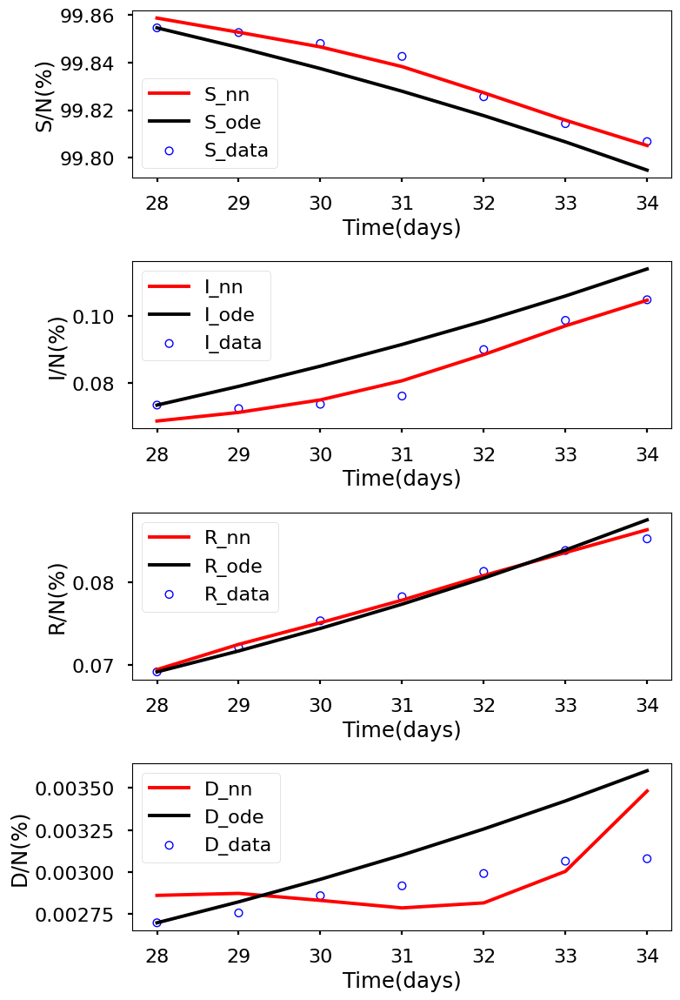

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.111e+00, GE_loss: 2.11976e+00,OB_loss: 9.90996e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 8.78, cumulative_time: 8.78
It: 10000, Loss: 9.665e-07, GE_loss: 2.58253e-07,OB_loss: 7.08226e-07, Beta: 1.03181e+00,gamma: 9.68530e-01,mu: 9.68421e-01, Time: 28.96, cumulative_time: 37.73
It: 20000, Loss: 8.672e-07, GE_loss: 2.76835e-07,OB_loss: 5.90355e-07, Beta: 1.05670e+00,gamma: 8.65870e-01,mu: 8.52312e-01, Time: 28.14, cumulative_time: 65.87
It: 30000, Loss: 1.170e-10, GE_loss: 1.24822e-11,OB_loss: 1.04523e-10, Beta: 3.89220e-02,gamma: 3.44718e-02,mu: 2.43788e-03, Time: 28.06, cumulative_time: 93.94
It: 40000, Loss: 1.060e-10, GE_loss: 1.29221e-11,OB_loss: 9.30893e-11, Beta: 3.82641e-02,gamma: 3.43588e-02,mu: 1.50652e-03, Time: 28.22, cumulative_time: 122.16
beta:  [0.03801793]
gamma:  [0.03435342]
mu:  [0.00114784]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


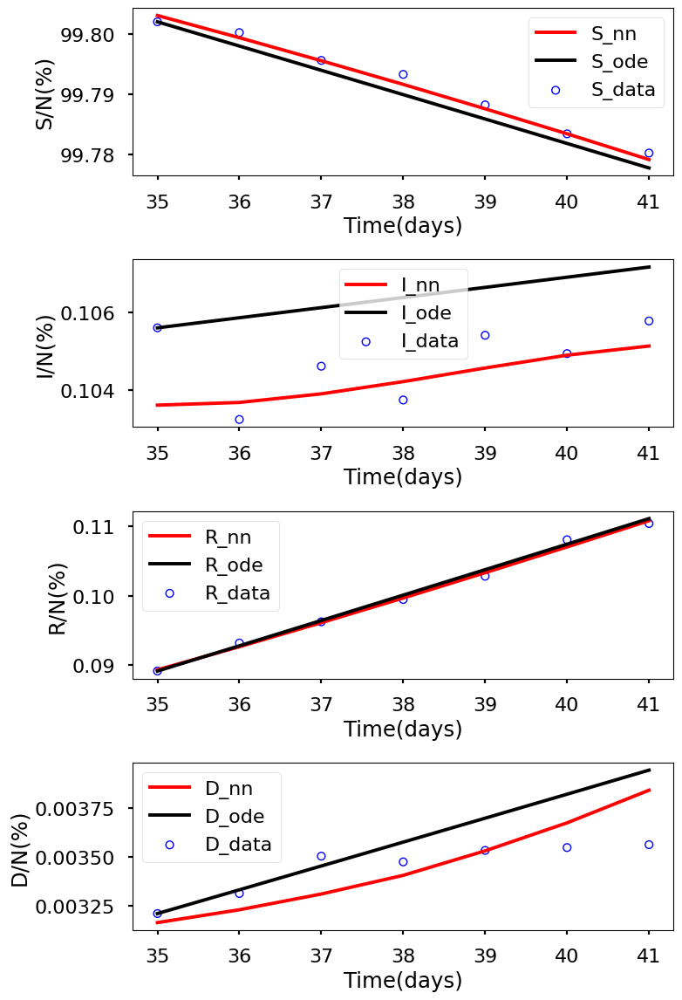

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.082e+00, GE_loss: 2.09216e+00,OB_loss: 9.89502e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 8.49, cumulative_time: 8.49
It: 10000, Loss: 1.047e-06, GE_loss: 2.97632e-07,OB_loss: 7.49827e-07, Beta: 1.03503e+00,gamma: 9.64450e-01,mu: 9.64437e-01, Time: 28.64, cumulative_time: 37.13
It: 20000, Loss: 9.417e-07, GE_loss: 3.01124e-07,OB_loss: 6.40625e-07, Beta: 1.05272e+00,gamma: 8.60590e-01,mu: 8.48892e-01, Time: 29.14, cumulative_time: 66.27
It: 30000, Loss: 1.893e-10, GE_loss: 1.89679e-11,OB_loss: 1.70294e-10, Beta: 3.98877e-02,gamma: 3.86065e-02,mu: 1.96320e-03, Time: 28.18, cumulative_time: 94.45
It: 40000, Loss: 1.745e-10, GE_loss: 1.82278e-11,OB_loss: 1.56267e-10, Beta: 3.96040e-02,gamma: 3.84855e-02,mu: 1.14816e-03, Time: 27.96, cumulative_time: 122.41
beta:  [0.03959864]
gamma:  [0.0384104]
mu:  [0.00104952]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


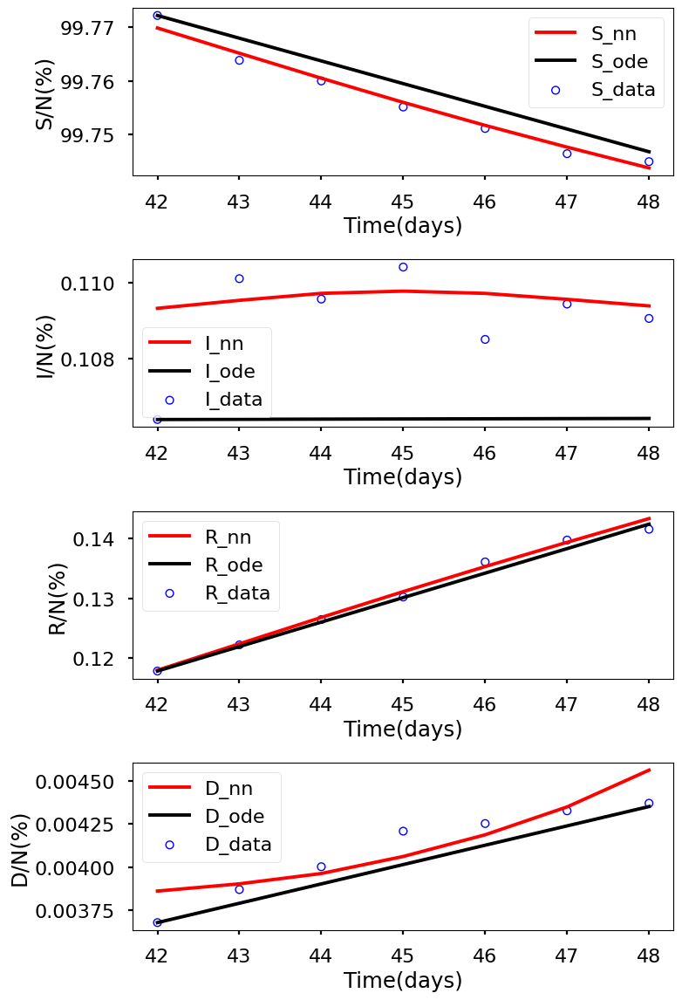

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.036e+00, GE_loss: 2.04617e+00,OB_loss: 9.89741e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 9.32, cumulative_time: 9.32
It: 10000, Loss: 8.628e-07, GE_loss: 2.47951e-07,OB_loss: 6.14889e-07, Beta: 1.03370e+00,gamma: 9.65962e-01,mu: 9.65981e-01, Time: 30.42, cumulative_time: 39.74
It: 20000, Loss: 7.386e-07, GE_loss: 2.38734e-07,OB_loss: 4.99870e-07, Beta: 1.05039e+00,gamma: 8.75936e-01,mu: 8.60283e-01, Time: 29.39, cumulative_time: 69.13
It: 30000, Loss: 2.731e-09, GE_loss: 9.82383e-10,OB_loss: 1.74887e-09, Beta: 5.30930e-02,gamma: 6.79151e-02,mu: 2.56842e-03, Time: 28.92, cumulative_time: 98.06
It: 40000, Loss: 2.682e-09, GE_loss: 9.97420e-10,OB_loss: 1.68411e-09, Beta: 5.26533e-02,gamma: 6.85840e-02,mu: 1.03083e-03, Time: 29.57, cumulative_time: 127.63
beta:  [0.05258486]
gamma:  [0.06856734]
mu:  [0.0009854]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


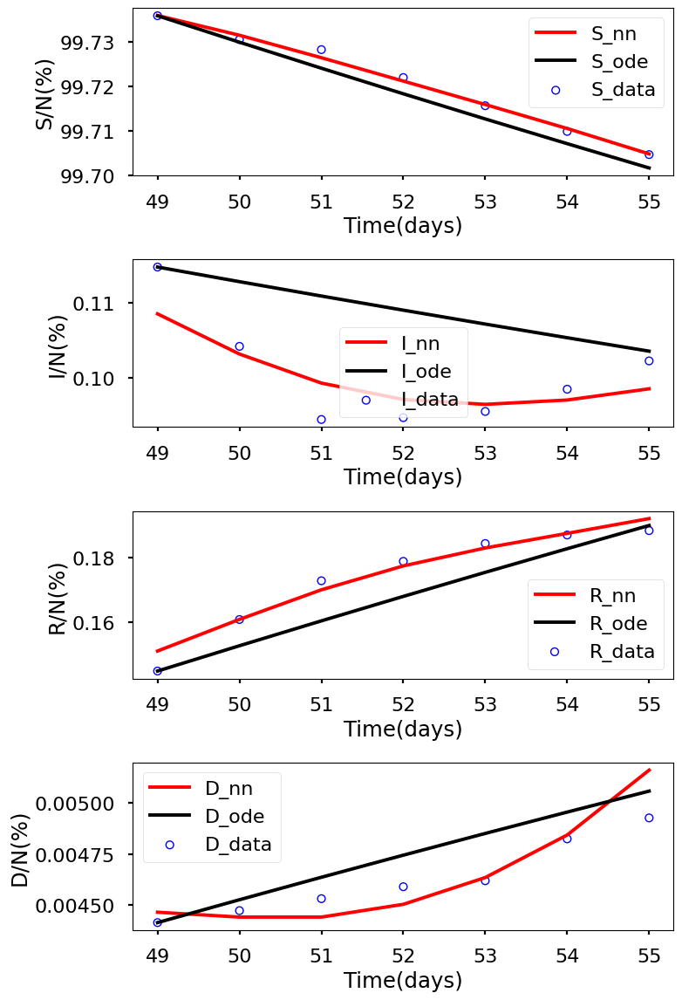

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.095e+00, GE_loss: 2.10917e+00,OB_loss: 9.86266e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 8.69, cumulative_time: 8.69
It: 10000, Loss: 9.212e-07, GE_loss: 2.60911e-07,OB_loss: 6.60334e-07, Beta: 1.03278e+00,gamma: 9.67068e-01,mu: 9.66914e-01, Time: 27.76, cumulative_time: 36.44
It: 20000, Loss: 8.178e-07, GE_loss: 2.60703e-07,OB_loss: 5.57139e-07, Beta: 1.06733e+00,gamma: 8.69205e-01,mu: 8.52933e-01, Time: 27.91, cumulative_time: 64.35
It: 30000, Loss: 1.256e-09, GE_loss: 2.80880e-10,OB_loss: 9.74673e-10, Beta: 5.74768e-02,gamma: 6.06314e-02,mu: 2.24779e-03, Time: 29.36, cumulative_time: 93.71
It: 40000, Loss: 1.159e-09, GE_loss: 3.29357e-10,OB_loss: 8.29407e-10, Beta: 5.74230e-02,gamma: 5.99099e-02,mu: 1.08182e-03, Time: 27.38, cumulative_time: 121.09
beta:  [0.05761087]
gamma:  [0.05926234]
mu:  [0.00088326]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


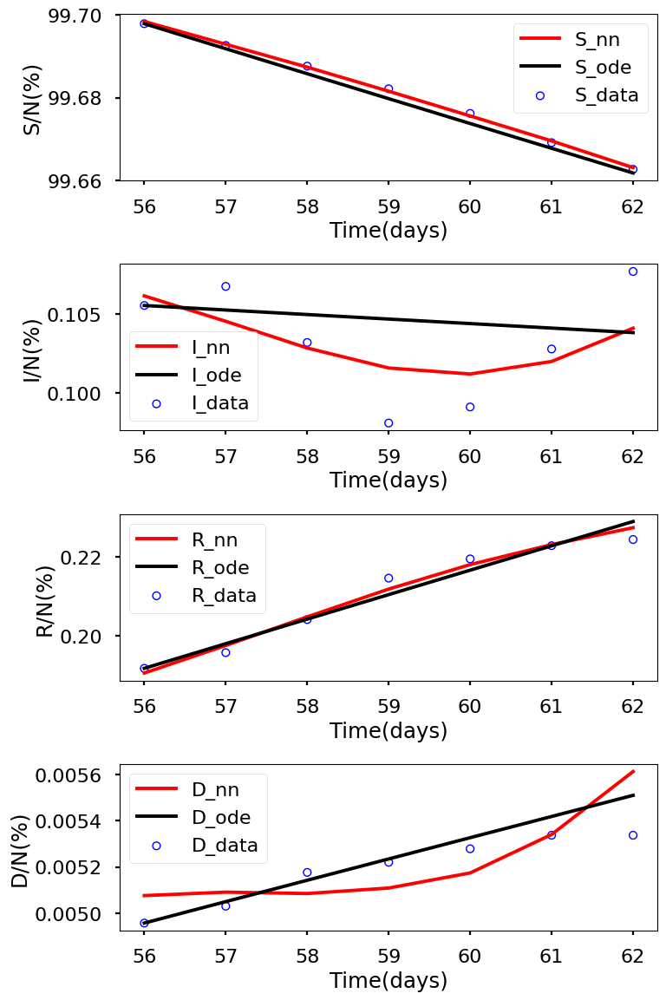

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.046e+00, GE_loss: 2.06296e+00,OB_loss: 9.83503e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 8.66, cumulative_time: 8.66
It: 10000, Loss: 1.279e-06, GE_loss: 3.50051e-07,OB_loss: 9.29281e-07, Beta: 1.03107e+00,gamma: 9.69278e-01,mu: 9.69065e-01, Time: 31.05, cumulative_time: 39.71
It: 20000, Loss: 1.087e-06, GE_loss: 3.62027e-07,OB_loss: 7.24959e-07, Beta: 1.06160e+00,gamma: 8.23164e-01,mu: 8.04040e-01, Time: 28.34, cumulative_time: 68.04
It: 30000, Loss: 5.486e-10, GE_loss: 8.69817e-11,OB_loss: 4.61626e-10, Beta: 5.52455e-02,gamma: 3.51896e-02,mu: 3.67187e-03, Time: 28.30, cumulative_time: 96.34
It: 40000, Loss: 5.248e-10, GE_loss: 9.29300e-11,OB_loss: 4.31892e-10, Beta: 5.47490e-02,gamma: 3.56782e-02,mu: 2.20109e-03, Time: 29.23, cumulative_time: 125.57
beta:  [0.05463162]
gamma:  [0.03582123]
mu:  [0.0016991]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


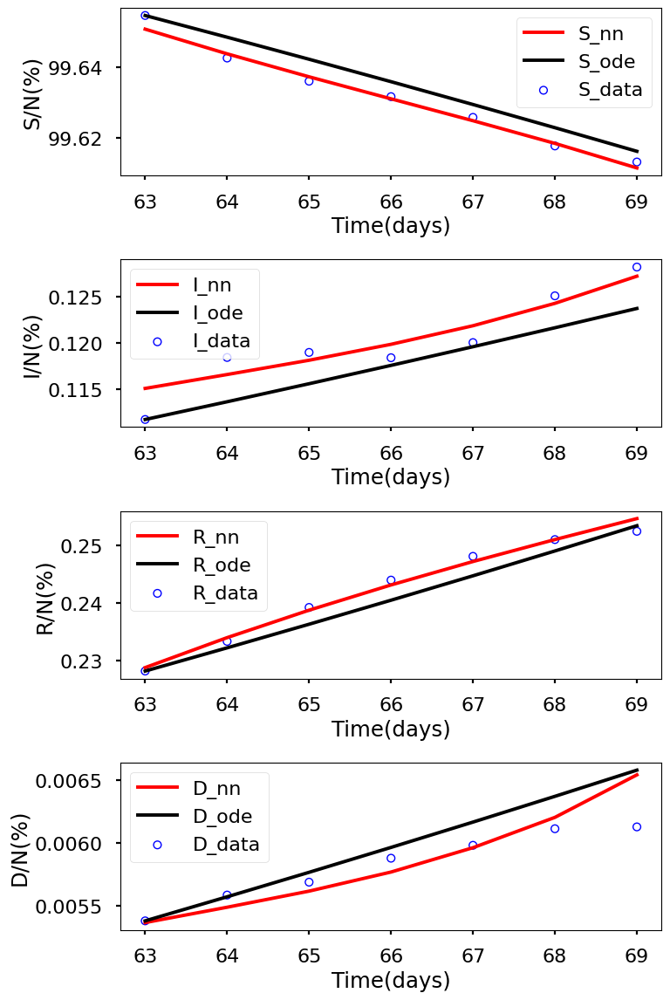

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.076e+00, GE_loss: 2.08951e+00,OB_loss: 9.86051e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 8.58, cumulative_time: 8.58
It: 10000, Loss: 1.572e-06, GE_loss: 4.33292e-07,OB_loss: 1.13901e-06, Beta: 1.03215e+00,gamma: 9.68685e-01,mu: 9.68501e-01, Time: 30.10, cumulative_time: 38.68
It: 20000, Loss: 1.262e-06, GE_loss: 4.53224e-07,OB_loss: 8.08891e-07, Beta: 1.04193e+00,gamma: 7.81533e-01,mu: 7.56129e-01, Time: 30.22, cumulative_time: 68.90
It: 30000, Loss: 7.967e-10, GE_loss: 1.87818e-10,OB_loss: 6.08931e-10, Beta: 5.83464e-02,gamma: 4.47731e-02,mu: 1.33042e-03, Time: 30.12, cumulative_time: 99.02
It: 40000, Loss: 7.940e-10, GE_loss: 1.92114e-10,OB_loss: 6.01881e-10, Beta: 5.83721e-02,gamma: 4.46988e-02,mu: 1.11780e-03, Time: 29.71, cumulative_time: 128.73
beta:  [0.05838755]
gamma:  [0.04465117]
mu:  [0.00109211]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


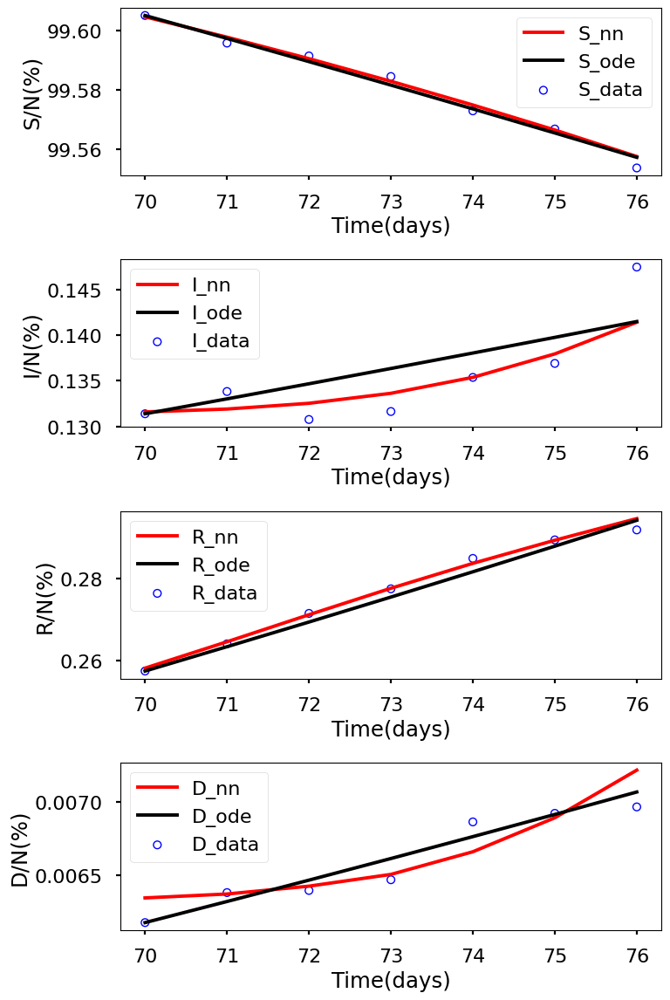

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.023e+00, GE_loss: 2.03656e+00,OB_loss: 9.85989e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 8.83, cumulative_time: 8.83
It: 10000, Loss: 2.135e-06, GE_loss: 5.97656e-07,OB_loss: 1.53720e-06, Beta: 1.03353e+00,gamma: 9.66852e-01,mu: 9.66608e-01, Time: 27.40, cumulative_time: 36.23
It: 20000, Loss: 1.528e-06, GE_loss: 5.98117e-07,OB_loss: 9.30205e-07, Beta: 9.69415e-01,gamma: 7.11116e-01,mu: 6.68531e-01, Time: 29.50, cumulative_time: 65.73
It: 30000, Loss: 2.763e-09, GE_loss: 7.65238e-10,OB_loss: 1.99808e-09, Beta: 6.13379e-02,gamma: 4.81276e-02,mu: 1.39191e-03, Time: 27.24, cumulative_time: 92.97
It: 40000, Loss: 2.483e-09, GE_loss: 5.84953e-10,OB_loss: 1.89781e-09, Beta: 6.10937e-02,gamma: 4.80477e-02,mu: 9.05648e-04, Time: 27.50, cumulative_time: 120.46
beta:  [0.0610903]
gamma:  [0.04794507]
mu:  [0.00085947]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


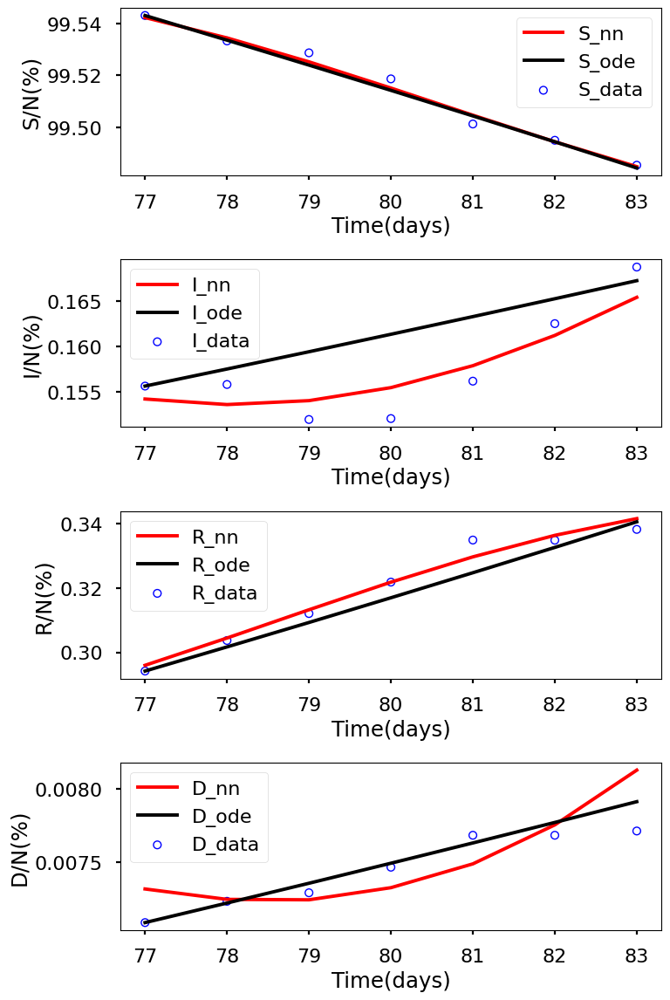

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.020e+00, GE_loss: 2.03384e+00,OB_loss: 9.85939e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 8.77, cumulative_time: 8.77
It: 10000, Loss: 2.908e-06, GE_loss: 8.32922e-07,OB_loss: 2.07485e-06, Beta: 1.03550e+00,gamma: 9.65104e-01,mu: 9.64625e-01, Time: 27.46, cumulative_time: 36.24
It: 20000, Loss: 1.730e-06, GE_loss: 7.78560e-07,OB_loss: 9.51167e-07, Beta: 8.70333e-01,gamma: 5.97289e-01,mu: 5.50862e-01, Time: 27.78, cumulative_time: 64.01
It: 30000, Loss: 1.345e-09, GE_loss: 2.11030e-10,OB_loss: 1.13353e-09, Beta: 8.38551e-02,gamma: 4.28228e-02,mu: 1.37027e-03, Time: 30.28, cumulative_time: 94.29
It: 40000, Loss: 1.349e-09, GE_loss: 2.14396e-10,OB_loss: 1.13442e-09, Beta: 8.37440e-02,gamma: 4.30117e-02,mu: 9.22878e-04, Time: 27.72, cumulative_time: 122.01
beta:  [0.08373135]
gamma:  [0.04303161]
mu:  [0.00088729]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


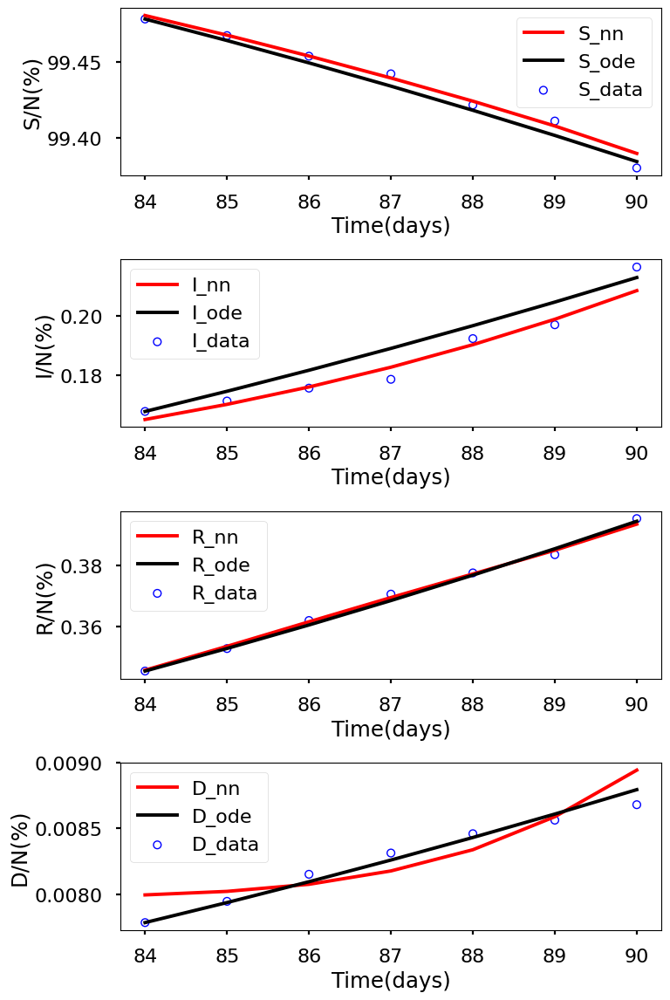

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.039e+00, GE_loss: 2.05822e+00,OB_loss: 9.80625e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 9.08, cumulative_time: 9.08
It: 10000, Loss: 6.281e-06, GE_loss: 1.78677e-06,OB_loss: 4.49435e-06, Beta: 1.03682e+00,gamma: 9.64786e-01,mu: 9.63818e-01, Time: 27.64, cumulative_time: 36.72
It: 20000, Loss: 9.365e-08, GE_loss: 6.79284e-08,OB_loss: 2.57264e-08, Beta: 1.65000e-01,gamma: 1.08317e-01,mu: 5.19954e-02, Time: 27.48, cumulative_time: 64.20
It: 30000, Loss: 2.967e-09, GE_loss: 9.64570e-10,OB_loss: 2.00195e-09, Beta: 8.03301e-02,gamma: 2.83240e-02,mu: 7.03457e-04, Time: 27.72, cumulative_time: 91.92
It: 40000, Loss: 3.441e-09, GE_loss: 1.46400e-09,OB_loss: 1.97741e-09, Beta: 8.03596e-02,gamma: 2.83358e-02,mu: 6.73829e-04, Time: 30.16, cumulative_time: 122.07
beta:  [0.08035639]
gamma:  [0.02833695]
mu:  [0.00067931]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


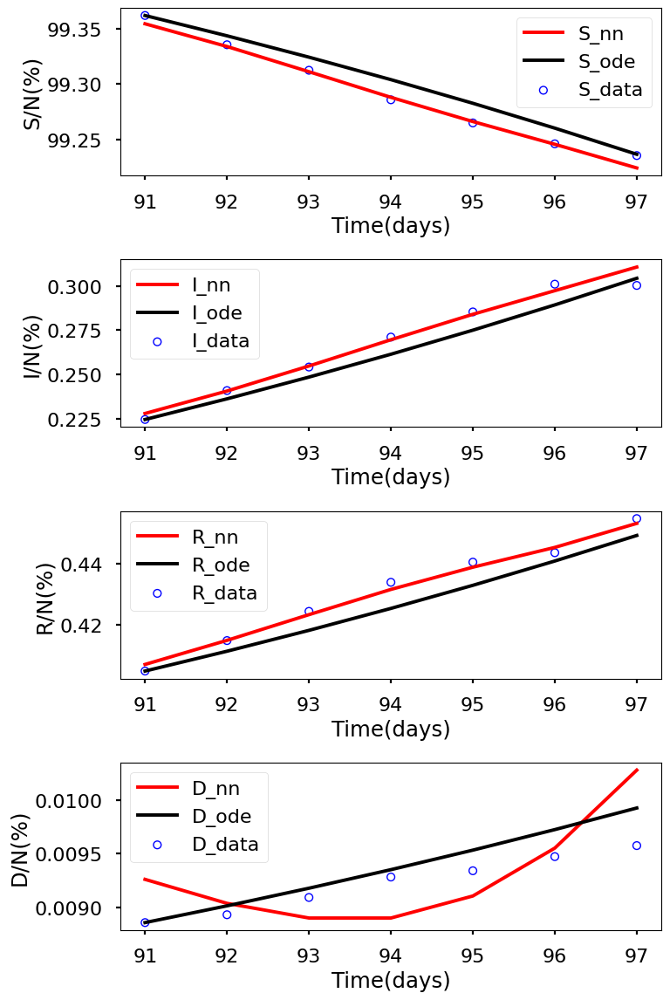

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.029e+00, GE_loss: 2.05286e+00,OB_loss: 9.76608e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 9.24, cumulative_time: 9.24
It: 10000, Loss: 1.066e-05, GE_loss: 3.05231e-06,OB_loss: 7.60533e-06, Beta: 1.03874e+00,gamma: 9.61657e-01,mu: 9.60597e-01, Time: 28.37, cumulative_time: 37.60
It: 20000, Loss: 7.096e-09, GE_loss: 1.39672e-09,OB_loss: 5.69903e-09, Beta: 7.45609e-02,gamma: 3.84241e-02,mu: 4.94075e-03, Time: 28.68, cumulative_time: 66.28
It: 30000, Loss: 3.932e-09, GE_loss: 7.04054e-10,OB_loss: 3.22746e-09, Beta: 7.14651e-02,gamma: 3.41858e-02,mu: 8.55717e-04, Time: 27.81, cumulative_time: 94.09
It: 40000, Loss: 3.897e-09, GE_loss: 8.10711e-10,OB_loss: 3.08652e-09, Beta: 7.14075e-02,gamma: 3.37589e-02,mu: 6.57701e-04, Time: 28.85, cumulative_time: 122.94
beta:  [0.07134651]
gamma:  [0.03370778]
mu:  [0.00061141]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


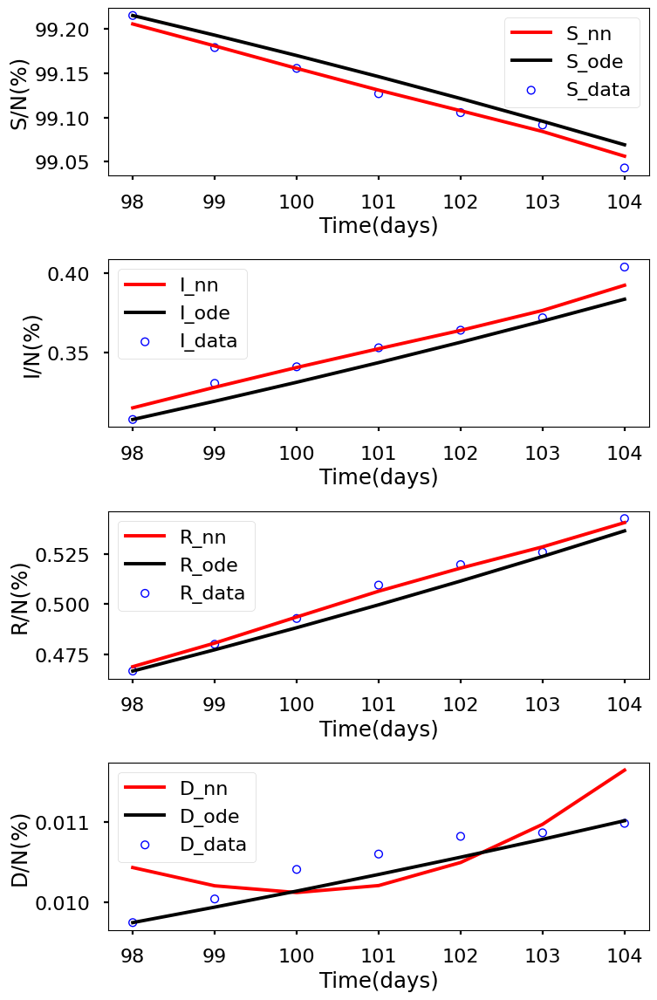

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.054e+00, GE_loss: 2.08163e+00,OB_loss: 9.72307e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 9.28, cumulative_time: 9.28
It: 10000, Loss: 1.714e-05, GE_loss: 4.94550e-06,OB_loss: 1.21971e-05, Beta: 1.04472e+00,gamma: 9.57481e-01,mu: 9.55633e-01, Time: 28.50, cumulative_time: 37.79
It: 20000, Loss: 1.538e-08, GE_loss: 8.34378e-09,OB_loss: 7.04009e-09, Beta: 7.36732e-02,gamma: 3.79697e-02,mu: 3.12801e-03, Time: 28.19, cumulative_time: 65.98
It: 30000, Loss: 3.967e-09, GE_loss: 1.24458e-09,OB_loss: 2.72232e-09, Beta: 7.28753e-02,gamma: 3.86520e-02,mu: 6.88829e-04, Time: 28.51, cumulative_time: 94.49
It: 40000, Loss: 4.305e-09, GE_loss: 1.54015e-09,OB_loss: 2.76489e-09, Beta: 7.28863e-02,gamma: 3.86885e-02,mu: 6.81151e-04, Time: 28.46, cumulative_time: 122.96
beta:  [0.07289107]
gamma:  [0.03871441]
mu:  [0.00066587]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


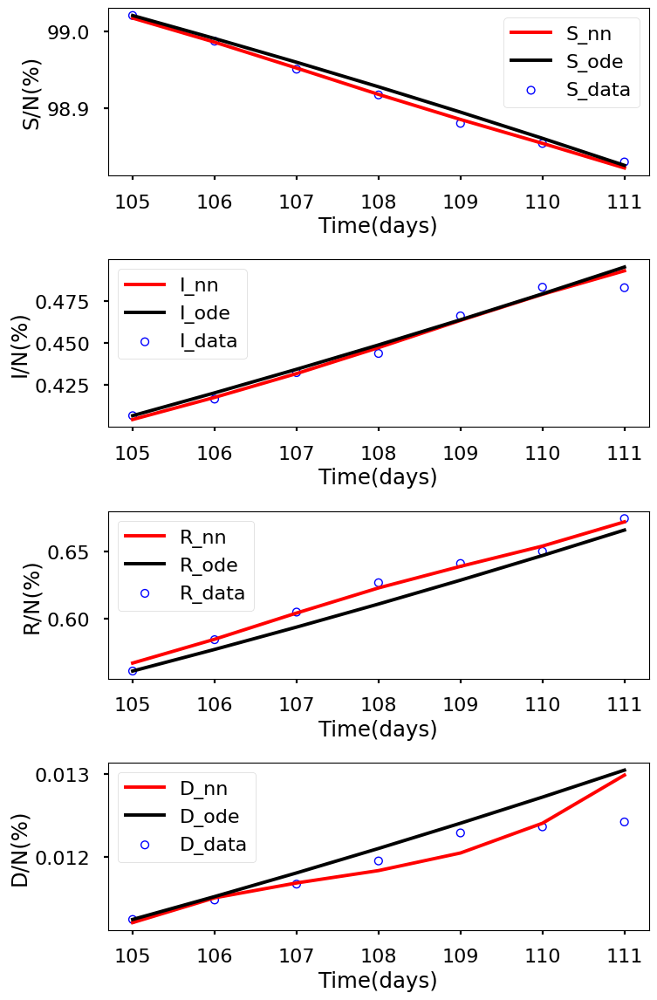

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.036e+00, GE_loss: 2.07012e+00,OB_loss: 9.65946e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 9.35, cumulative_time: 9.35
It: 10000, Loss: 2.310e-05, GE_loss: 6.68871e-06,OB_loss: 1.64112e-05, Beta: 1.04652e+00,gamma: 9.52655e-01,mu: 9.49859e-01, Time: 28.09, cumulative_time: 37.44
It: 20000, Loss: 8.086e-09, GE_loss: 1.56200e-09,OB_loss: 6.52413e-09, Beta: 6.97568e-02,gamma: 3.81283e-02,mu: 2.91652e-03, Time: 28.43, cumulative_time: 65.87
It: 30000, Loss: 7.336e-09, GE_loss: 1.38576e-09,OB_loss: 5.95054e-09, Beta: 6.87298e-02,gamma: 3.89773e-02,mu: 5.28850e-04, Time: 28.81, cumulative_time: 94.68
It: 40000, Loss: 5.613e-08, GE_loss: 3.61389e-08,OB_loss: 1.99873e-08, Beta: 6.87629e-02,gamma: 3.90377e-02,mu: 5.58228e-04, Time: 28.13, cumulative_time: 122.81
beta:  [0.06874226]
gamma:  [0.03905275]
mu:  [0.00059537]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


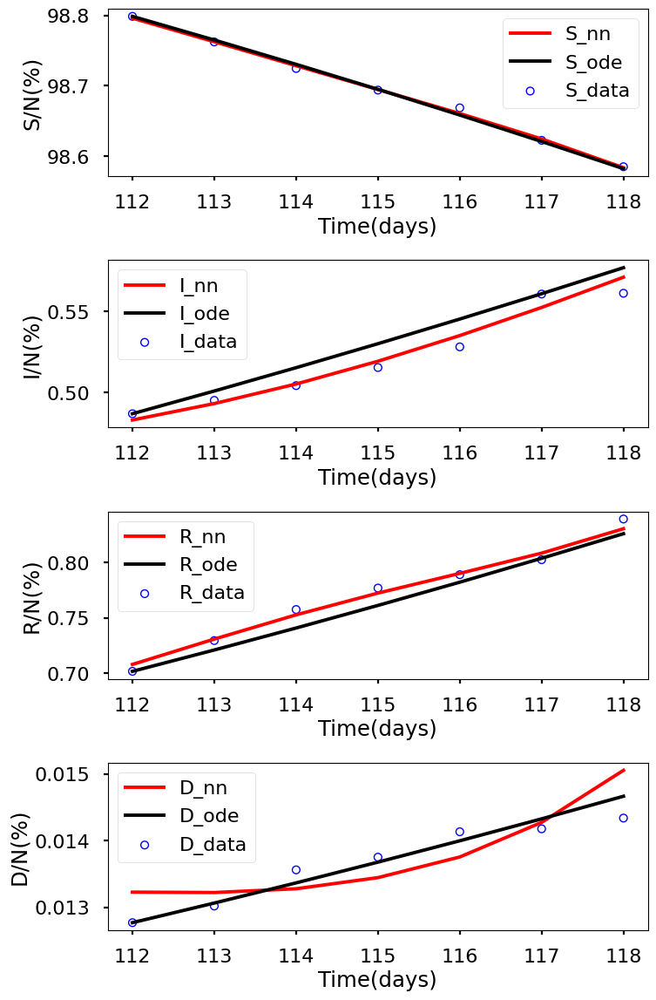

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.048e+00, GE_loss: 2.08544e+00,OB_loss: 9.62334e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 9.19, cumulative_time: 9.19
It: 10000, Loss: 2.719e-05, GE_loss: 7.93686e-06,OB_loss: 1.92489e-05, Beta: 1.04789e+00,gamma: 9.48921e-01,mu: 9.46138e-01, Time: 29.29, cumulative_time: 38.48
It: 20000, Loss: 1.301e-08, GE_loss: 2.36848e-09,OB_loss: 1.06431e-08, Beta: 5.56056e-02,gamma: 4.26809e-02,mu: 3.59353e-03, Time: 29.51, cumulative_time: 68.00
It: 30000, Loss: 1.188e-08, GE_loss: 3.48374e-09,OB_loss: 8.39205e-09, Beta: 5.42715e-02,gamma: 4.41225e-02,mu: 3.98298e-04, Time: 29.30, cumulative_time: 97.30
It: 40000, Loss: 1.055e-08, GE_loss: 3.31566e-09,OB_loss: 7.23858e-09, Beta: 5.43377e-02,gamma: 4.41888e-02,mu: 4.46673e-04, Time: 29.71, cumulative_time: 127.00
beta:  [0.05435543]
gamma:  [0.04414948]
mu:  [0.00049754]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


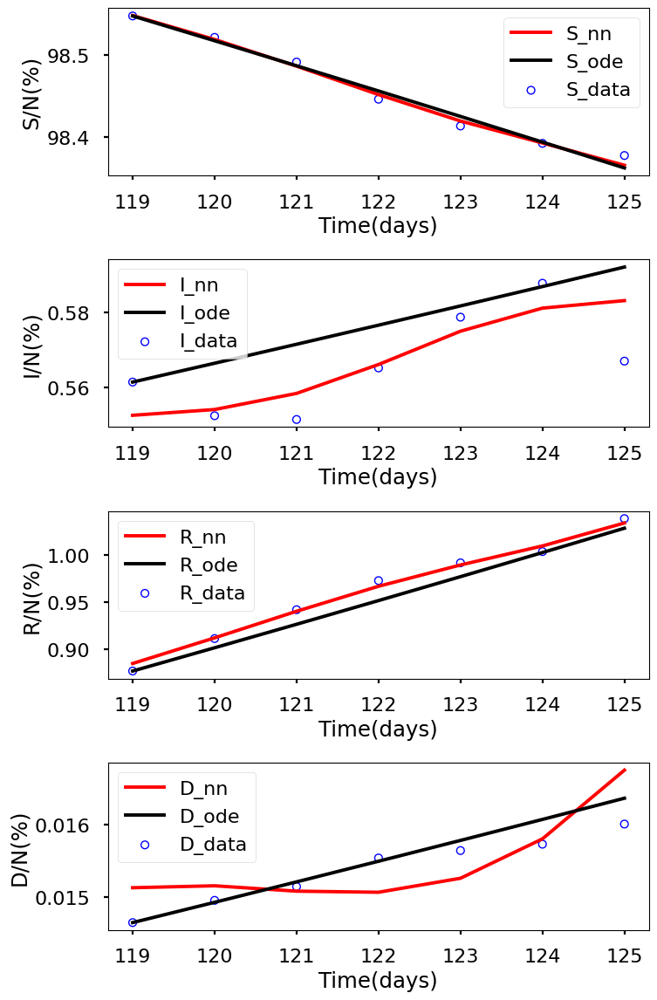

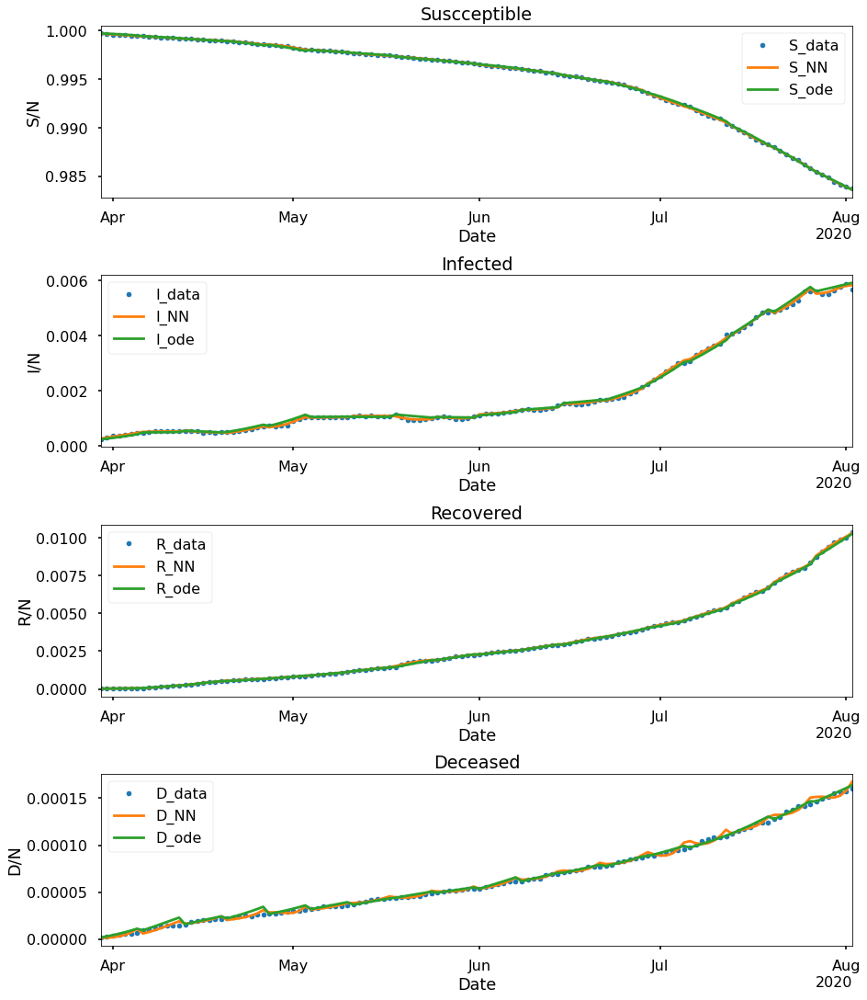

+---------------------+-------------+-------------+-------------+--------------+--------------+--------------+--------------+--------------+---------------+--------------+--------------+--------------+---------------+---------------+---------------+-------------+--------------+--------------+
|      Paramaters     |    Week 1   |    Week 2   |    Week 3   |    Week 4    |    Week 5    |    Week 6    |    Week 7    |    Week 8    |     Week 9    |   Week 10    |   Week 11    |   Week 12    |    Week 13    |    Week 14    |    Week 15    |   Week 16   |   Week 17    |   Week 18    |
+---------------------+-------------+-------------+-------------+--------------+--------------+--------------+--------------+--------------+---------------+--------------+--------------+--------------+---------------+---------------+---------------+-------------+--------------+--------------+
|         beta        |  0.1073673  |  0.06674003 | 0.067938775 | 0.108864665  | 0.108084194  | 0.038017932  | 0.03959

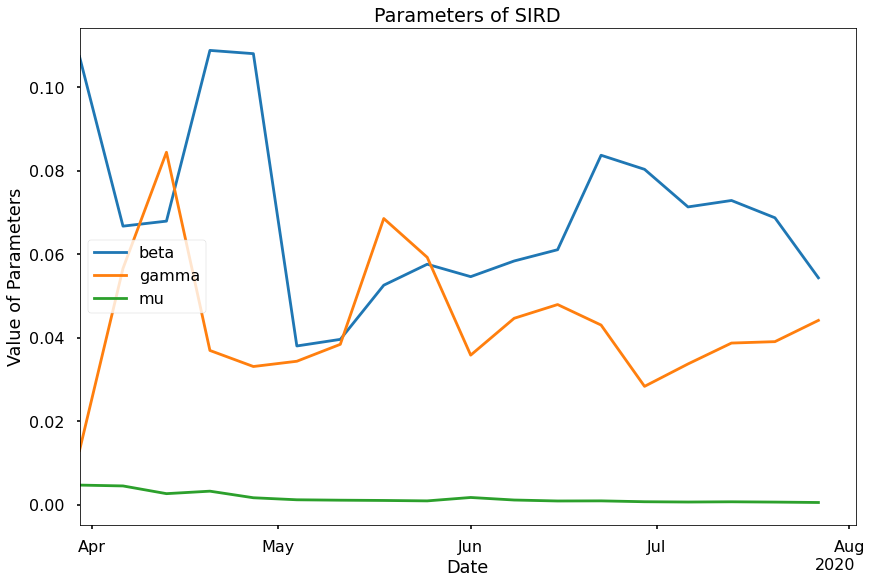

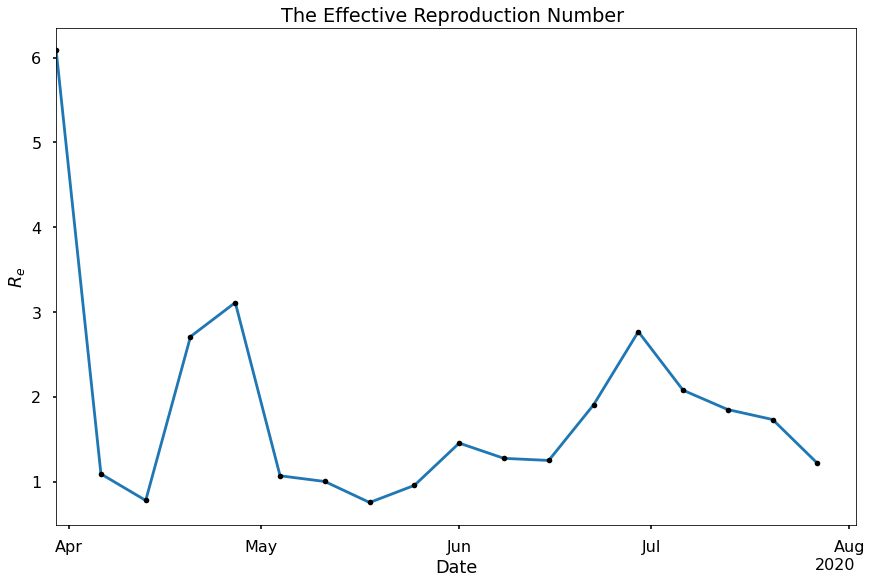

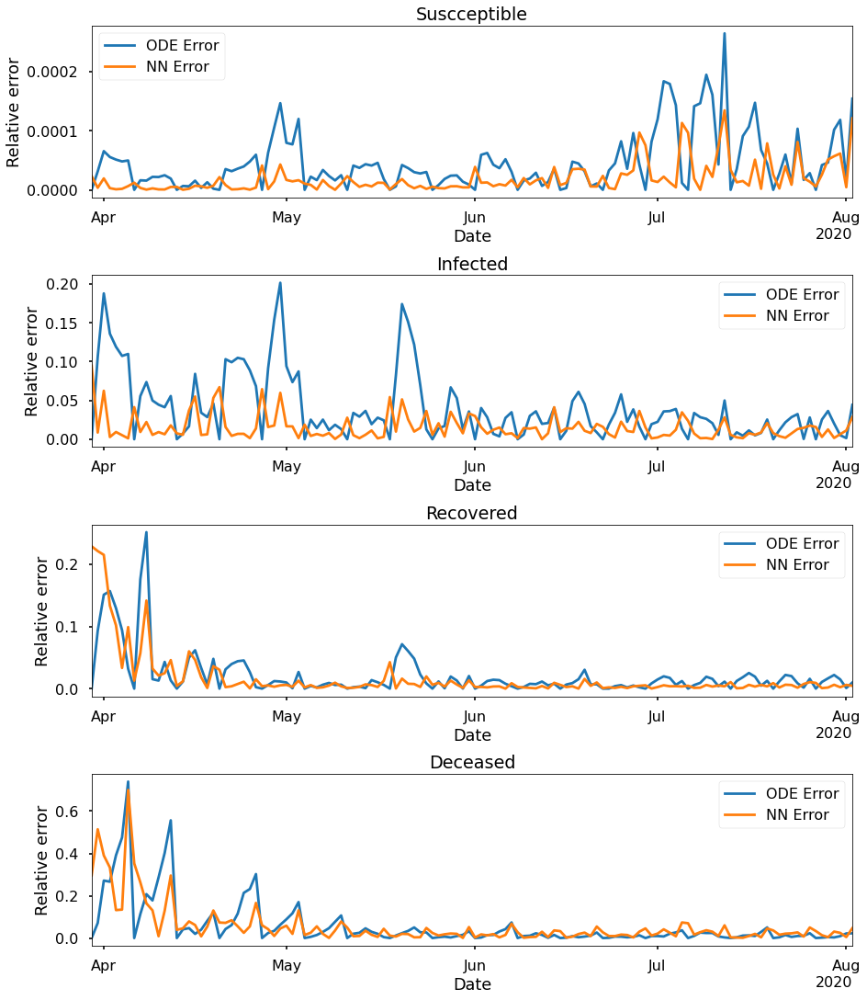

In [ ]:
layers364 = [1,64,64,64,4]
S364_ode,I364_ode,R364_ode,D364_ode,S364_learned,I364_learned,R364_learned,D364_learned,beta364,gamma364,mu364,S_errnn364,I_errnn364,R_errnn364,D_errnn364,S_erode364,I_errode364,R_errode264,D_errode364,time364 = sum_all(
    layers364,length,SS,II,RC,DC,N0,0.1,50000)

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.060e+00, GE_loss: 2.07167e+00,OB_loss: 9.87911e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 9.50, cumulative_time: 9.50
It: 10000, Loss: 1.908e-07, GE_loss: 5.09791e-08,OB_loss: 1.39840e-07, Beta: 1.02591e+00,gamma: 9.74333e-01,mu: 9.74265e-01, Time: 32.05, cumulative_time: 41.55
It: 20000, Loss: 1.266e-07, GE_loss: 3.58326e-08,OB_loss: 9.07494e-08, Beta: 1.04633e+00,gamma: 9.58348e-01,mu: 9.58054e-01, Time: 32.92, cumulative_time: 74.47
It: 30000, Loss: 8.997e-10, GE_loss: 8.90250e-11,OB_loss: 8.10678e-10, Beta: 1.05027e-01,gamma: 1.53919e-02,mu: 3.87943e-03, Time: 33.22, cumulative_time: 107.69
It: 40000, Loss: 3.524e-10, GE_loss: 8.01642e-11,OB_loss: 2.72250e-10, Beta: 1.06390e-01,gamma: 1.37260e-02,mu: 2.81939e-03, Time: 32.16, cumulative_time: 139.85
beta:  [0.10772967]
gamma:  [0.01443356]
mu:  [0.00246704]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


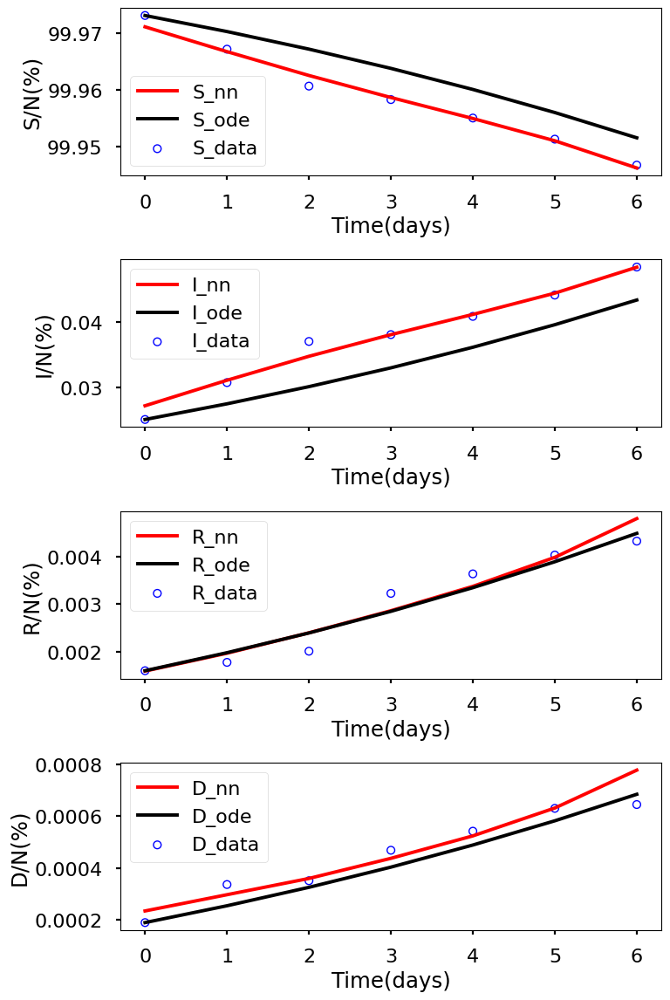

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.038e+00, GE_loss: 2.05008e+00,OB_loss: 9.88356e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 9.54, cumulative_time: 9.54
It: 10000, Loss: 2.797e-07, GE_loss: 9.11712e-08,OB_loss: 1.88513e-07, Beta: 1.02659e+00,gamma: 9.73273e-01,mu: 9.73232e-01, Time: 33.19, cumulative_time: 42.73
It: 20000, Loss: 2.360e-07, GE_loss: 7.10320e-08,OB_loss: 1.64989e-07, Beta: 1.05287e+00,gamma: 9.44332e-01,mu: 9.40449e-01, Time: 33.26, cumulative_time: 75.99
It: 30000, Loss: 1.293e-10, GE_loss: 3.39090e-11,OB_loss: 9.54364e-11, Beta: 6.73052e-02,gamma: 5.65815e-02,mu: 4.50881e-03, Time: 33.83, cumulative_time: 109.82
It: 40000, Loss: 1.131e-10, GE_loss: 2.75348e-11,OB_loss: 8.55892e-11, Beta: 6.84322e-02,gamma: 5.72868e-02,mu: 4.08473e-03, Time: 33.11, cumulative_time: 142.93
beta:  [0.06848286]
gamma:  [0.05737796]
mu:  [0.0037637]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


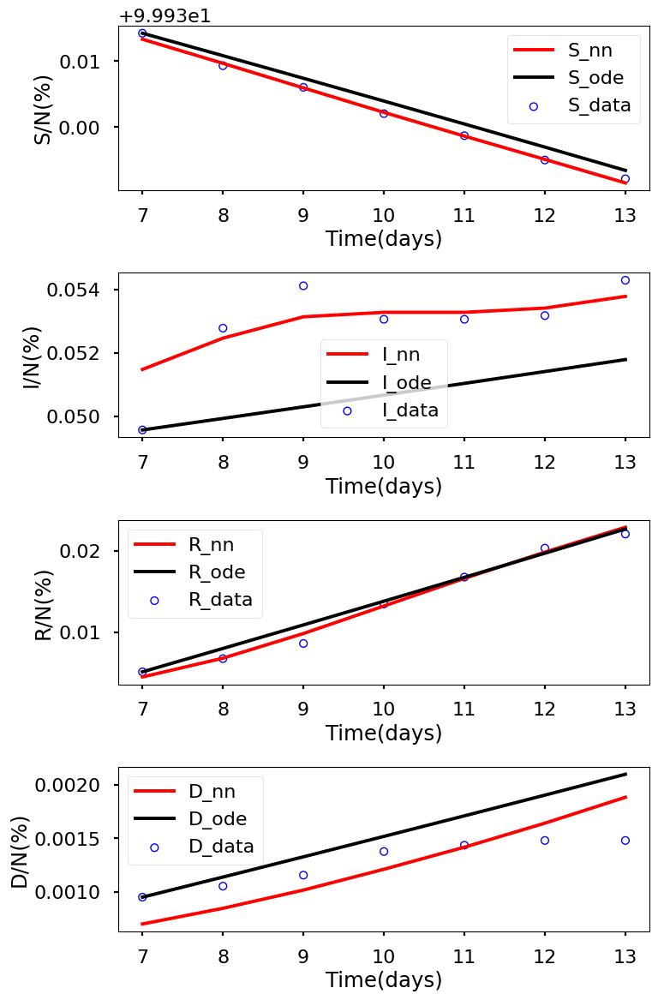

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.031e+00, GE_loss: 2.04465e+00,OB_loss: 9.86672e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 9.58, cumulative_time: 9.58
It: 10000, Loss: 2.591e-07, GE_loss: 8.48488e-08,OB_loss: 1.74225e-07, Beta: 1.02631e+00,gamma: 9.73879e-01,mu: 9.73935e-01, Time: 32.40, cumulative_time: 41.98
It: 20000, Loss: 2.250e-07, GE_loss: 6.80202e-08,OB_loss: 1.57006e-07, Beta: 1.05009e+00,gamma: 9.45603e-01,mu: 9.40865e-01, Time: 31.92, cumulative_time: 73.90
It: 30000, Loss: 4.816e-10, GE_loss: 2.74427e-11,OB_loss: 4.54192e-10, Beta: 7.03605e-02,gamma: 8.63744e-02,mu: 5.39325e-03, Time: 31.98, cumulative_time: 105.88
It: 40000, Loss: 4.311e-10, GE_loss: 2.96803e-11,OB_loss: 4.01439e-10, Beta: 6.82543e-02,gamma: 8.46491e-02,mu: 4.21925e-03, Time: 32.23, cumulative_time: 138.10
beta:  [0.06809339]
gamma:  [0.08408806]
mu:  [0.00383553]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


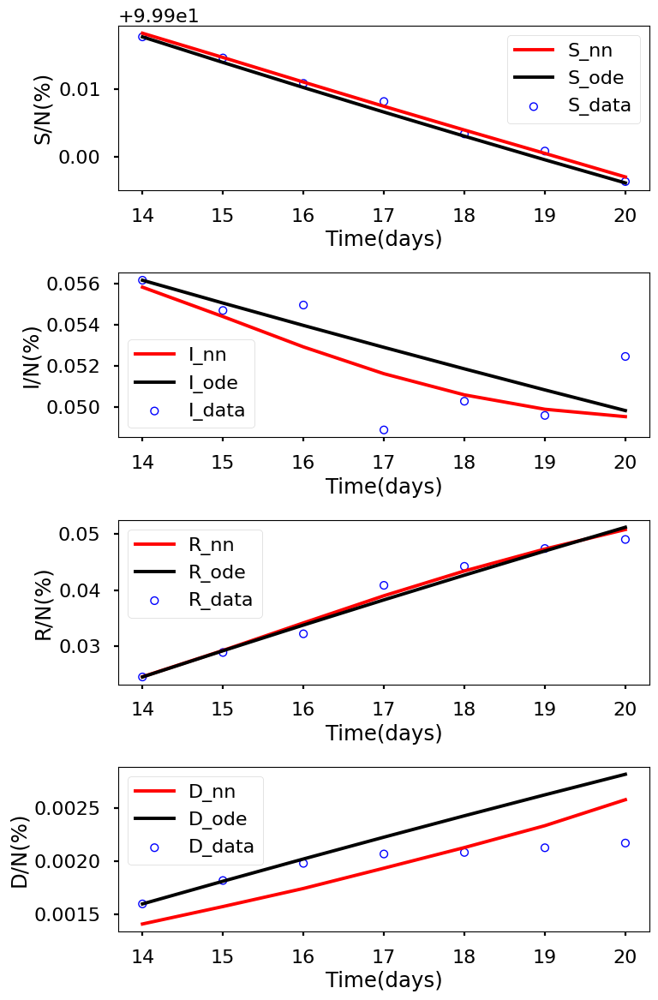

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.025e+00, GE_loss: 2.03944e+00,OB_loss: 9.85423e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 9.58, cumulative_time: 9.58
It: 10000, Loss: 3.139e-07, GE_loss: 1.02061e-07,OB_loss: 2.11815e-07, Beta: 1.02657e+00,gamma: 9.73486e-01,mu: 9.73353e-01, Time: 32.20, cumulative_time: 41.77
It: 20000, Loss: 2.869e-07, GE_loss: 8.55336e-08,OB_loss: 2.01338e-07, Beta: 1.06965e+00,gamma: 9.36433e-01,mu: 9.29437e-01, Time: 31.99, cumulative_time: 73.76
It: 30000, Loss: 2.275e-10, GE_loss: 3.87035e-11,OB_loss: 1.88800e-10, Beta: 1.11407e-01,gamma: 3.88300e-02,mu: 6.55730e-03, Time: 32.68, cumulative_time: 106.44
It: 40000, Loss: 1.762e-10, GE_loss: 3.70690e-11,OB_loss: 1.39147e-10, Beta: 1.09560e-01,gamma: 3.80041e-02,mu: 4.43322e-03, Time: 31.51, cumulative_time: 137.95
beta:  [0.10898096]
gamma:  [0.03794157]
mu:  [0.00353356]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


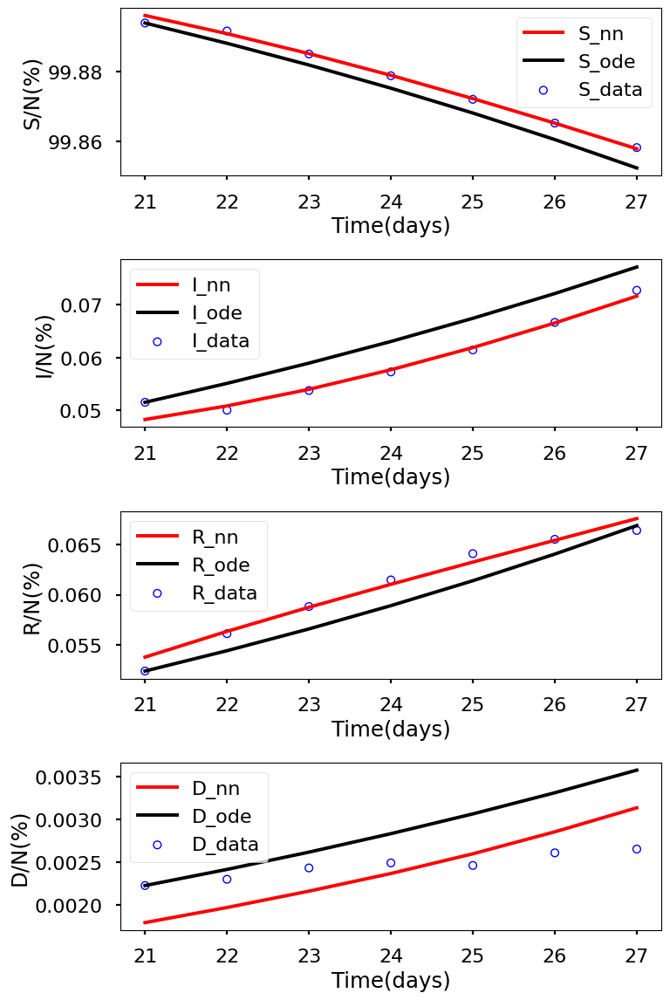

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.025e+00, GE_loss: 2.03775e+00,OB_loss: 9.87128e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 9.73, cumulative_time: 9.73
It: 10000, Loss: 6.243e-07, GE_loss: 1.62780e-07,OB_loss: 4.61546e-07, Beta: 1.02664e+00,gamma: 9.73591e-01,mu: 9.73556e-01, Time: 32.43, cumulative_time: 42.15
It: 20000, Loss: 5.585e-07, GE_loss: 1.72280e-07,OB_loss: 3.86207e-07, Beta: 1.10820e+00,gamma: 8.91293e-01,mu: 8.82480e-01, Time: 31.83, cumulative_time: 73.98
It: 30000, Loss: 1.764e-09, GE_loss: 4.31206e-10,OB_loss: 1.33232e-09, Beta: 1.09740e-01,gamma: 3.13817e-02,mu: 5.15859e-03, Time: 33.23, cumulative_time: 107.21
It: 40000, Loss: 1.662e-09, GE_loss: 4.83406e-10,OB_loss: 1.17857e-09, Beta: 1.08965e-01,gamma: 3.27664e-02,mu: 2.78598e-03, Time: 32.56, cumulative_time: 139.77
beta:  [0.10776882]
gamma:  [0.03215095]
mu:  [0.00127457]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


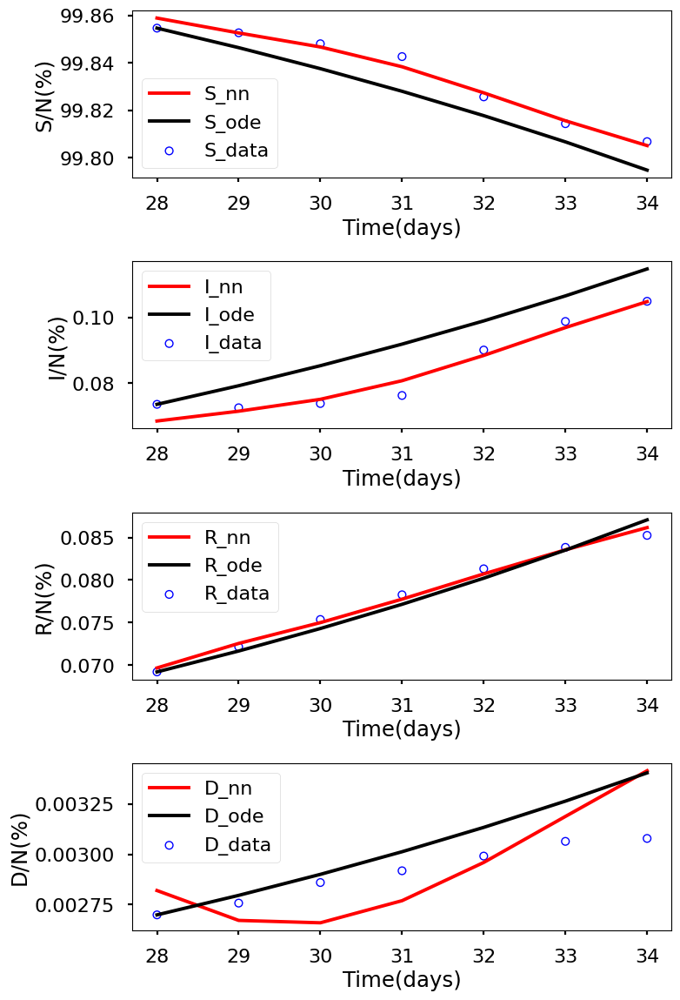

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.006e+00, GE_loss: 2.02019e+00,OB_loss: 9.85436e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 9.78, cumulative_time: 9.78
It: 10000, Loss: 9.662e-07, GE_loss: 2.60919e-07,OB_loss: 7.05294e-07, Beta: 1.02610e+00,gamma: 9.74337e-01,mu: 9.74192e-01, Time: 32.22, cumulative_time: 42.00
It: 20000, Loss: 8.548e-07, GE_loss: 2.77338e-07,OB_loss: 5.77468e-07, Beta: 1.05389e+00,gamma: 8.50404e-01,mu: 8.36992e-01, Time: 32.76, cumulative_time: 74.76
It: 30000, Loss: 1.108e-10, GE_loss: 1.75004e-11,OB_loss: 9.32607e-11, Beta: 3.78000e-02,gamma: 3.45669e-02,mu: 1.35495e-03, Time: 31.89, cumulative_time: 106.65
It: 40000, Loss: 1.158e-10, GE_loss: 2.23325e-11,OB_loss: 9.34531e-11, Beta: 3.76975e-02,gamma: 3.46604e-02,mu: 6.91077e-04, Time: 32.24, cumulative_time: 138.89
beta:  [0.03769531]
gamma:  [0.03469182]
mu:  [0.00054615]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


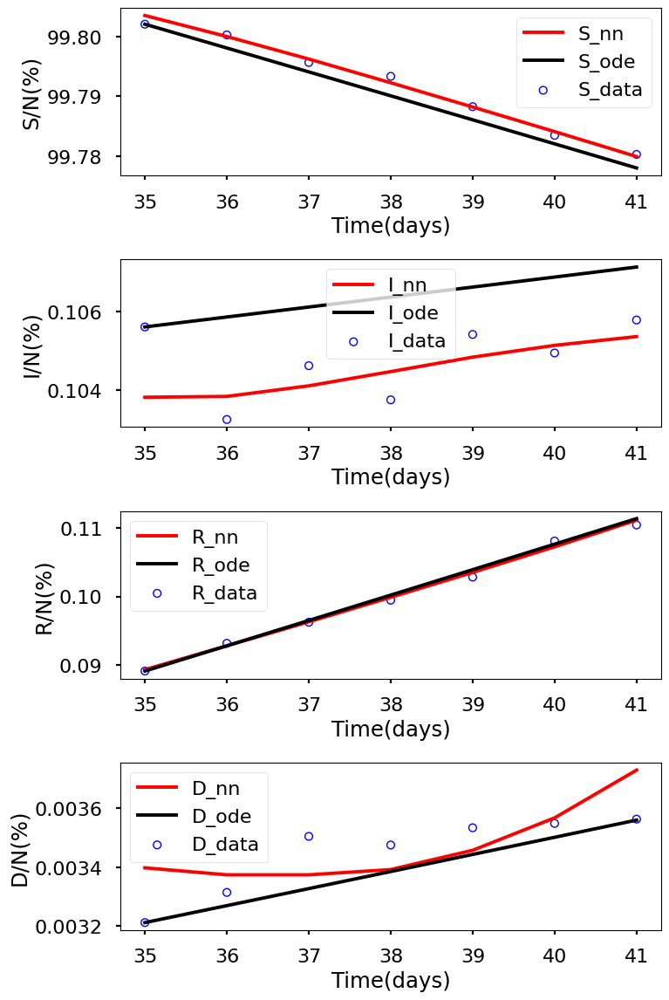

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.028e+00, GE_loss: 2.04392e+00,OB_loss: 9.83651e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 9.42, cumulative_time: 9.42
It: 10000, Loss: 1.052e-06, GE_loss: 2.84435e-07,OB_loss: 7.67103e-07, Beta: 1.02540e+00,gamma: 9.75043e-01,mu: 9.74865e-01, Time: 31.11, cumulative_time: 40.52
It: 20000, Loss: 9.201e-07, GE_loss: 3.05771e-07,OB_loss: 6.14313e-07, Beta: 1.04494e+00,gamma: 8.34899e-01,mu: 8.20683e-01, Time: 32.56, cumulative_time: 73.09
It: 30000, Loss: 1.807e-10, GE_loss: 2.05183e-11,OB_loss: 1.60169e-10, Beta: 4.00835e-02,gamma: 3.79299e-02,mu: 2.39632e-03, Time: 32.28, cumulative_time: 105.37
It: 40000, Loss: 1.660e-10, GE_loss: 2.15531e-11,OB_loss: 1.44454e-10, Beta: 3.99236e-02,gamma: 3.78204e-02,mu: 1.69973e-03, Time: 31.84, cumulative_time: 137.21
beta:  [0.03988483]
gamma:  [0.03778031]
mu:  [0.0014602]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


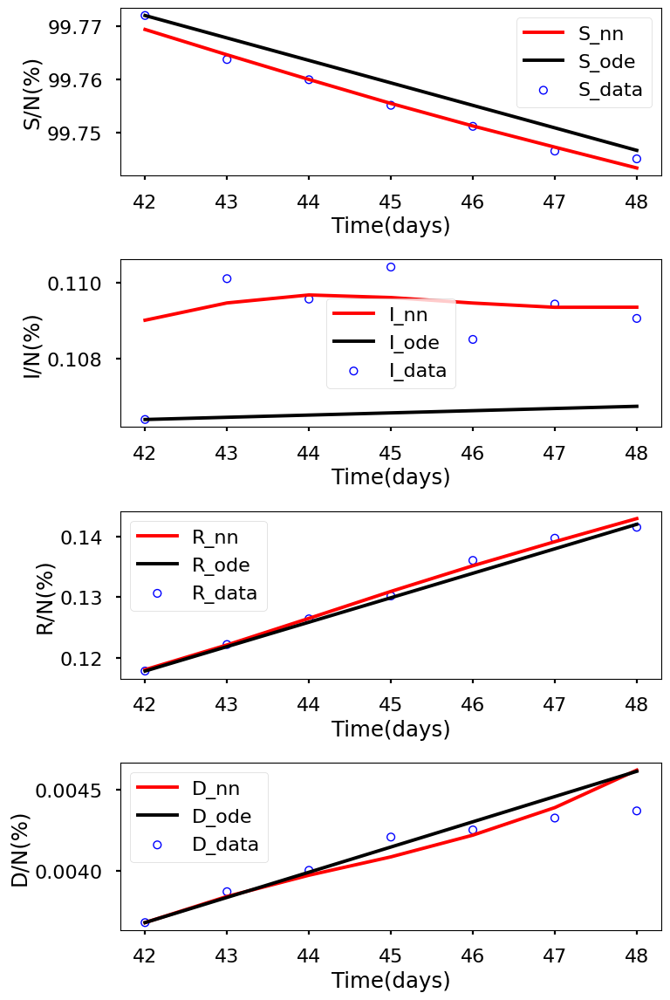

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.039e+00, GE_loss: 2.05261e+00,OB_loss: 9.86202e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 9.99, cumulative_time: 9.99
It: 10000, Loss: 8.628e-07, GE_loss: 2.41672e-07,OB_loss: 6.21111e-07, Beta: 1.02751e+00,gamma: 9.72367e-01,mu: 9.72255e-01, Time: 33.25, cumulative_time: 43.24
It: 20000, Loss: 7.568e-07, GE_loss: 2.42631e-07,OB_loss: 5.14207e-07, Beta: 1.05212e+00,gamma: 8.68099e-01,mu: 8.49872e-01, Time: 32.19, cumulative_time: 75.43
It: 30000, Loss: 2.545e-09, GE_loss: 1.00135e-09,OB_loss: 1.54410e-09, Beta: 5.39813e-02,gamma: 6.78600e-02,mu: 3.95013e-03, Time: 32.01, cumulative_time: 107.44
It: 40000, Loss: 2.409e-09, GE_loss: 1.02036e-09,OB_loss: 1.38894e-09, Beta: 5.30160e-02,gamma: 6.87296e-02,mu: 1.86067e-03, Time: 32.36, cumulative_time: 139.80
beta:  [0.05276224]
gamma:  [0.06881618]
mu:  [0.00156461]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


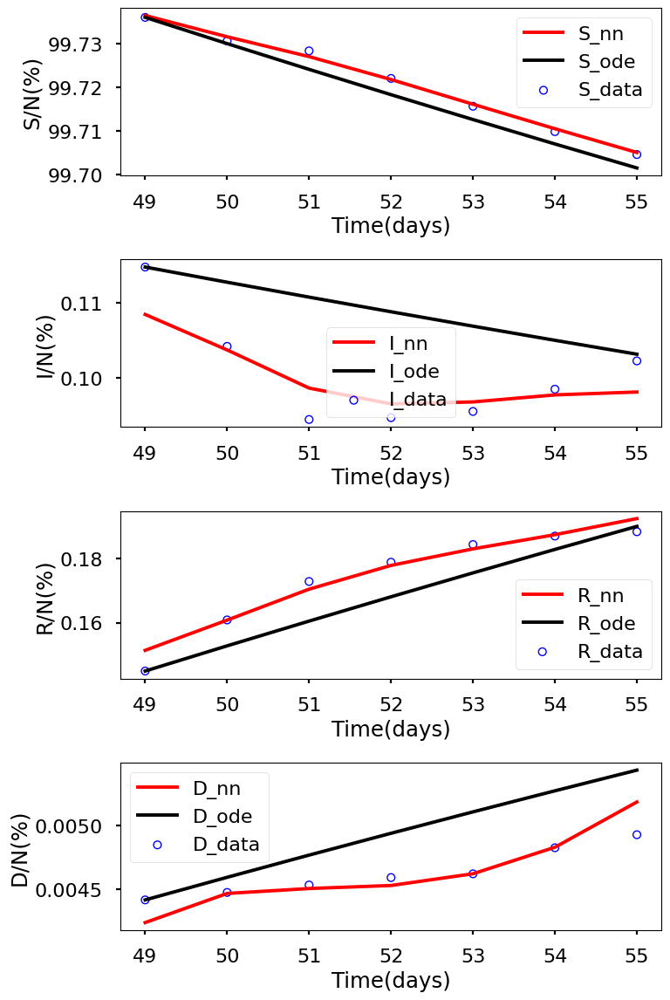

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.041e+00, GE_loss: 2.05543e+00,OB_loss: 9.85503e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 9.76, cumulative_time: 9.76
It: 10000, Loss: 9.189e-07, GE_loss: 2.49192e-07,OB_loss: 6.69729e-07, Beta: 1.02657e+00,gamma: 9.73276e-01,mu: 9.73109e-01, Time: 32.19, cumulative_time: 41.95
It: 20000, Loss: 7.776e-07, GE_loss: 2.55577e-07,OB_loss: 5.22038e-07, Beta: 1.05451e+00,gamma: 8.58193e-01,mu: 8.35211e-01, Time: 30.95, cumulative_time: 72.90
It: 30000, Loss: 1.077e-09, GE_loss: 3.67891e-10,OB_loss: 7.09585e-10, Beta: 5.86491e-02,gamma: 5.79152e-02,mu: 3.81324e-03, Time: 31.24, cumulative_time: 104.14
It: 40000, Loss: 1.042e-09, GE_loss: 3.91302e-10,OB_loss: 6.50961e-10, Beta: 5.83551e-02,gamma: 5.81907e-02,mu: 2.39655e-03, Time: 33.13, cumulative_time: 137.27
beta:  [0.05826288]
gamma:  [0.05847418]
mu:  [0.00183619]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


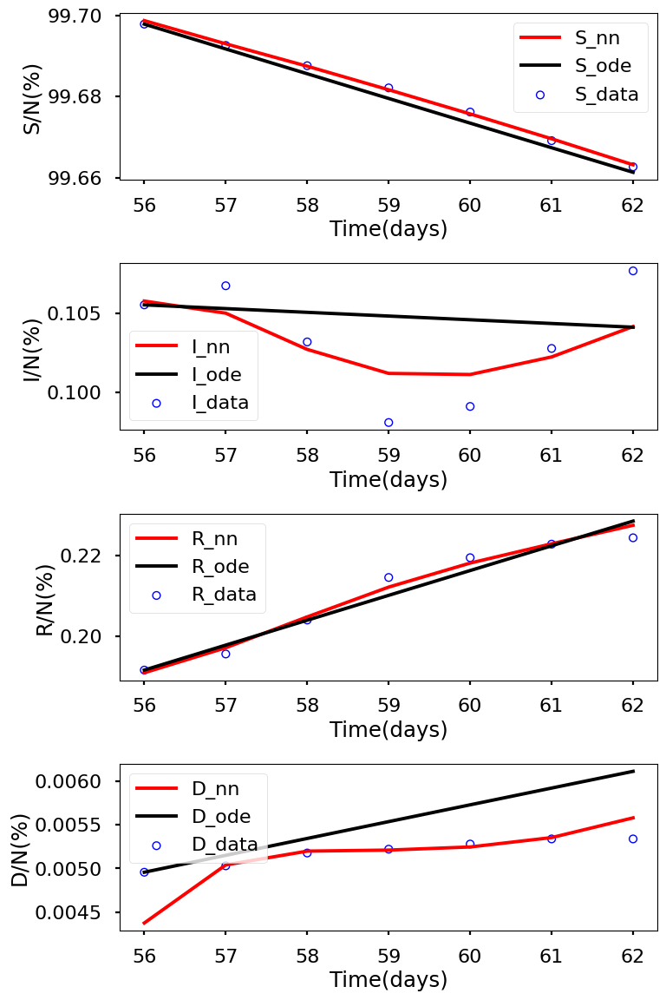

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.032e+00, GE_loss: 2.04197e+00,OB_loss: 9.89764e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 9.91, cumulative_time: 9.91
It: 10000, Loss: 1.264e-06, GE_loss: 3.50802e-07,OB_loss: 9.13123e-07, Beta: 1.02780e+00,gamma: 9.71893e-01,mu: 9.71512e-01, Time: 31.42, cumulative_time: 41.33
It: 20000, Loss: 1.036e-06, GE_loss: 3.56450e-07,OB_loss: 6.79385e-07, Beta: 1.04994e+00,gamma: 8.10795e-01,mu: 7.85251e-01, Time: 31.25, cumulative_time: 72.58
It: 30000, Loss: 1.131e-09, GE_loss: 4.94416e-10,OB_loss: 6.36192e-10, Beta: 5.51067e-02,gamma: 3.51402e-02,mu: 3.36394e-03, Time: 31.43, cumulative_time: 104.01
It: 40000, Loss: 5.199e-10, GE_loss: 1.11605e-10,OB_loss: 4.08264e-10, Beta: 5.48865e-02,gamma: 3.51078e-02,mu: 2.35507e-03, Time: 34.10, cumulative_time: 138.11
beta:  [0.05490547]
gamma:  [0.03504702]
mu:  [0.00193443]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


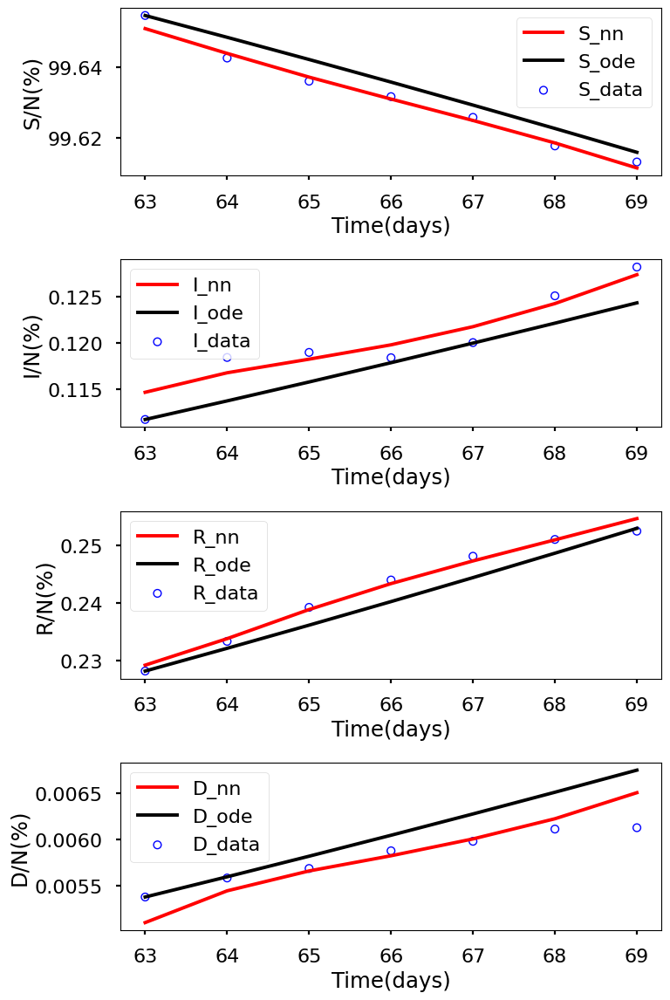

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.035e+00, GE_loss: 2.05339e+00,OB_loss: 9.81547e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 10.04, cumulative_time: 10.04
It: 10000, Loss: 1.570e-06, GE_loss: 4.44393e-07,OB_loss: 1.12600e-06, Beta: 1.02749e+00,gamma: 9.72958e-01,mu: 9.72758e-01, Time: 31.83, cumulative_time: 41.87
It: 20000, Loss: 1.205e-06, GE_loss: 4.38922e-07,OB_loss: 7.65910e-07, Beta: 1.01230e+00,gamma: 7.67829e-01,mu: 7.31426e-01, Time: 31.42, cumulative_time: 73.30
It: 30000, Loss: 8.961e-10, GE_loss: 2.24598e-10,OB_loss: 6.71551e-10, Beta: 5.87334e-02,gamma: 4.47578e-02,mu: 2.43081e-03, Time: 31.69, cumulative_time: 104.98
It: 40000, Loss: 8.055e-10, GE_loss: 1.86343e-10,OB_loss: 6.19194e-10, Beta: 5.83507e-02,gamma: 4.47648e-02,mu: 1.48365e-03, Time: 33.74, cumulative_time: 138.72
beta:  [0.05824519]
gamma:  [0.04471366]
mu:  [0.00125462]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


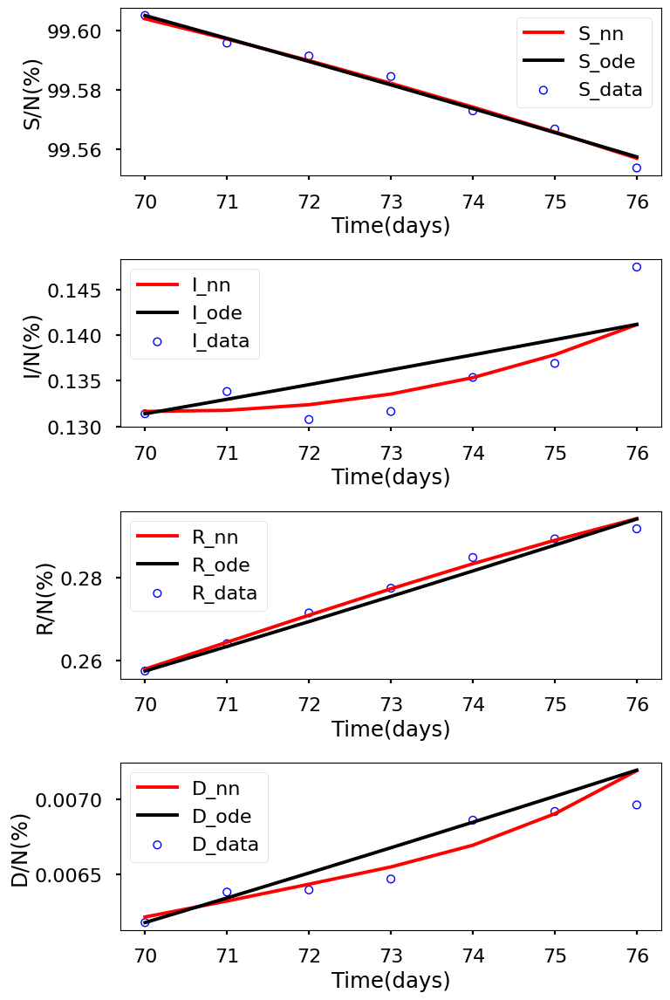

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.023e+00, GE_loss: 2.04215e+00,OB_loss: 9.80496e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 10.27, cumulative_time: 10.27
It: 10000, Loss: 2.132e-06, GE_loss: 6.10546e-07,OB_loss: 1.52185e-06, Beta: 1.02847e+00,gamma: 9.71775e-01,mu: 9.71342e-01, Time: 31.67, cumulative_time: 41.93
It: 20000, Loss: 1.450e-06, GE_loss: 5.84809e-07,OB_loss: 8.65167e-07, Beta: 9.35947e-01,gamma: 6.89853e-01,mu: 6.38062e-01, Time: 31.95, cumulative_time: 73.88
It: 30000, Loss: 2.336e-09, GE_loss: 6.36867e-10,OB_loss: 1.69933e-09, Beta: 6.21524e-02,gamma: 4.74259e-02,mu: 2.22736e-03, Time: 33.36, cumulative_time: 107.24
It: 40000, Loss: 2.169e-09, GE_loss: 6.43498e-10,OB_loss: 1.52563e-09, Beta: 6.15488e-02,gamma: 4.78445e-02,mu: 1.13424e-03, Time: 35.02, cumulative_time: 142.26
beta:  [0.06161404]
gamma:  [0.04804217]
mu:  [0.00115213]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


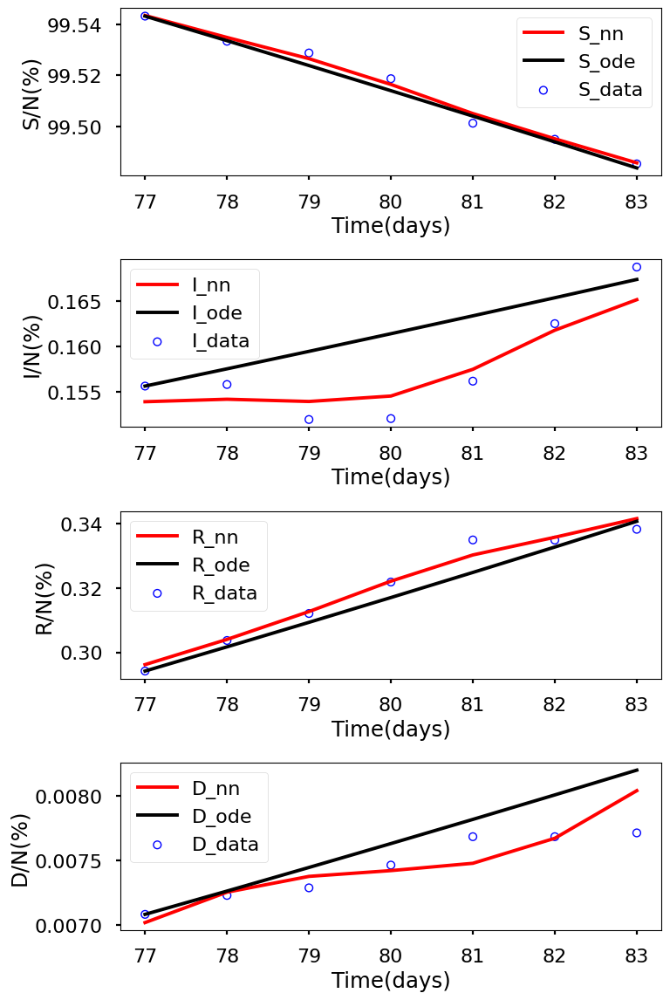

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.031e+00, GE_loss: 2.05097e+00,OB_loss: 9.80077e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 10.26, cumulative_time: 10.26
It: 10000, Loss: 2.923e-06, GE_loss: 8.49450e-07,OB_loss: 2.07327e-06, Beta: 1.03168e+00,gamma: 9.68908e-01,mu: 9.68591e-01, Time: 31.67, cumulative_time: 41.93
It: 20000, Loss: 1.600e-06, GE_loss: 7.49415e-07,OB_loss: 8.51064e-07, Beta: 8.19165e-01,gamma: 5.78003e-01,mu: 5.19388e-01, Time: 31.98, cumulative_time: 73.92
It: 30000, Loss: 1.298e-09, GE_loss: 2.13486e-10,OB_loss: 1.08443e-09, Beta: 8.40177e-02,gamma: 4.27619e-02,mu: 1.54132e-03, Time: 33.31, cumulative_time: 107.23
It: 40000, Loss: 1.285e-09, GE_loss: 2.11585e-10,OB_loss: 1.07313e-09, Beta: 8.39210e-02,gamma: 4.28966e-02,mu: 1.26201e-03, Time: 31.76, cumulative_time: 138.99
beta:  [0.08388048]
gamma:  [0.04294993]
mu:  [0.00118587]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


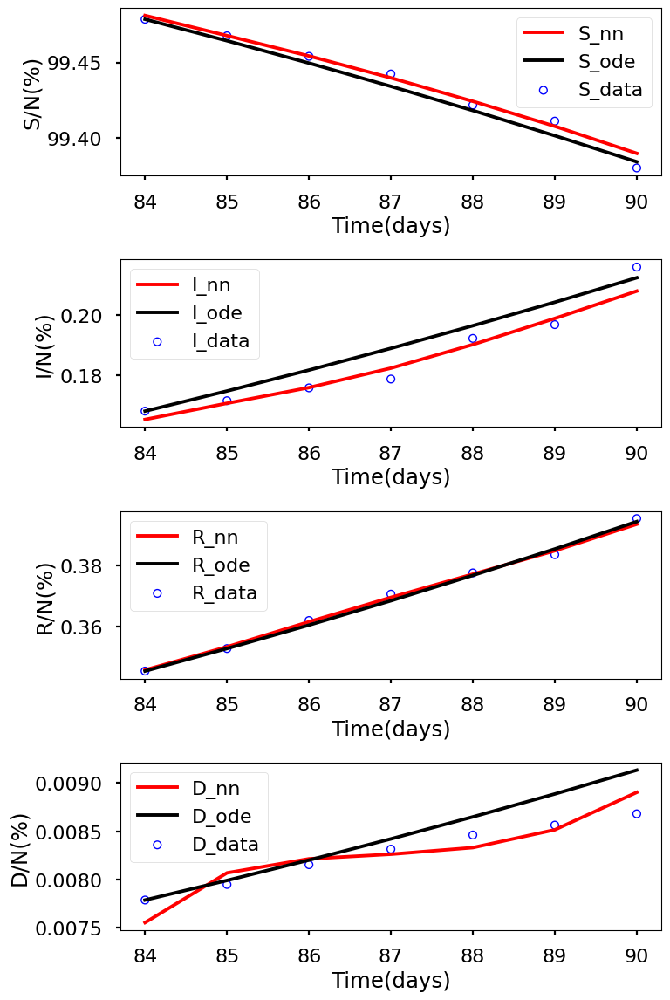

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.033e+00, GE_loss: 2.05336e+00,OB_loss: 9.79297e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 10.07, cumulative_time: 10.07
It: 10000, Loss: 6.286e-06, GE_loss: 1.78786e-06,OB_loss: 4.49822e-06, Beta: 1.03292e+00,gamma: 9.67644e-01,mu: 9.67048e-01, Time: 31.34, cumulative_time: 41.41
It: 20000, Loss: 7.512e-08, GE_loss: 5.32261e-08,OB_loss: 2.18924e-08, Beta: 1.46286e-01,gamma: 9.10555e-02,mu: 4.15243e-02, Time: 32.05, cumulative_time: 73.46
It: 30000, Loss: 2.853e-09, GE_loss: 1.02406e-09,OB_loss: 1.82932e-09, Beta: 8.02624e-02,gamma: 2.80971e-02,mu: 7.75661e-04, Time: 35.59, cumulative_time: 109.05
It: 40000, Loss: 2.830e-09, GE_loss: 1.02024e-09,OB_loss: 1.81009e-09, Beta: 8.03131e-02,gamma: 2.82026e-02,mu: 7.44657e-04, Time: 32.45, cumulative_time: 141.50
beta:  [0.08033043]
gamma:  [0.02827718]
mu:  [0.00076638]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


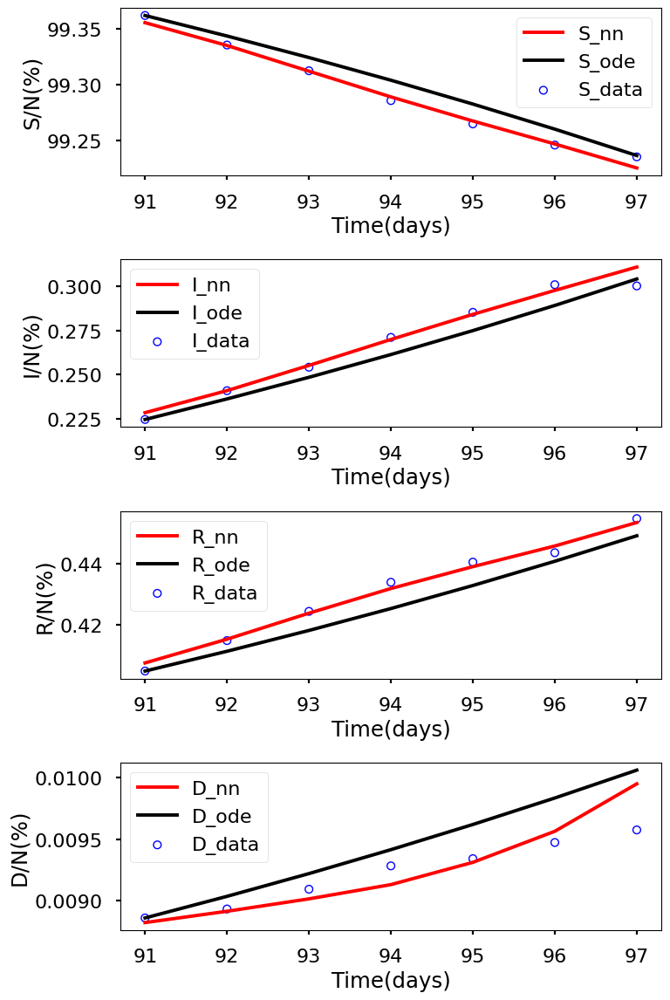

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.030e+00, GE_loss: 2.05366e+00,OB_loss: 9.76027e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 10.24, cumulative_time: 10.24
It: 10000, Loss: 1.071e-05, GE_loss: 3.08778e-06,OB_loss: 7.62259e-06, Beta: 1.03585e+00,gamma: 9.64684e-01,mu: 9.63149e-01, Time: 31.97, cumulative_time: 42.21
It: 20000, Loss: 5.159e-09, GE_loss: 1.00055e-09,OB_loss: 4.15845e-09, Beta: 7.39323e-02,gamma: 3.56316e-02,mu: 3.85860e-03, Time: 33.12, cumulative_time: 75.33
It: 30000, Loss: 1.325e-08, GE_loss: 7.42631e-09,OB_loss: 5.82402e-09, Beta: 7.12027e-02,gamma: 3.34658e-02,mu: 9.47781e-04, Time: 31.07, cumulative_time: 106.41
It: 40000, Loss: 3.769e-09, GE_loss: 7.66447e-10,OB_loss: 3.00220e-09, Beta: 7.12828e-02,gamma: 3.37015e-02,mu: 6.40640e-04, Time: 31.43, cumulative_time: 137.83
beta:  [0.07126975]
gamma:  [0.03374141]
mu:  [0.00059139]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


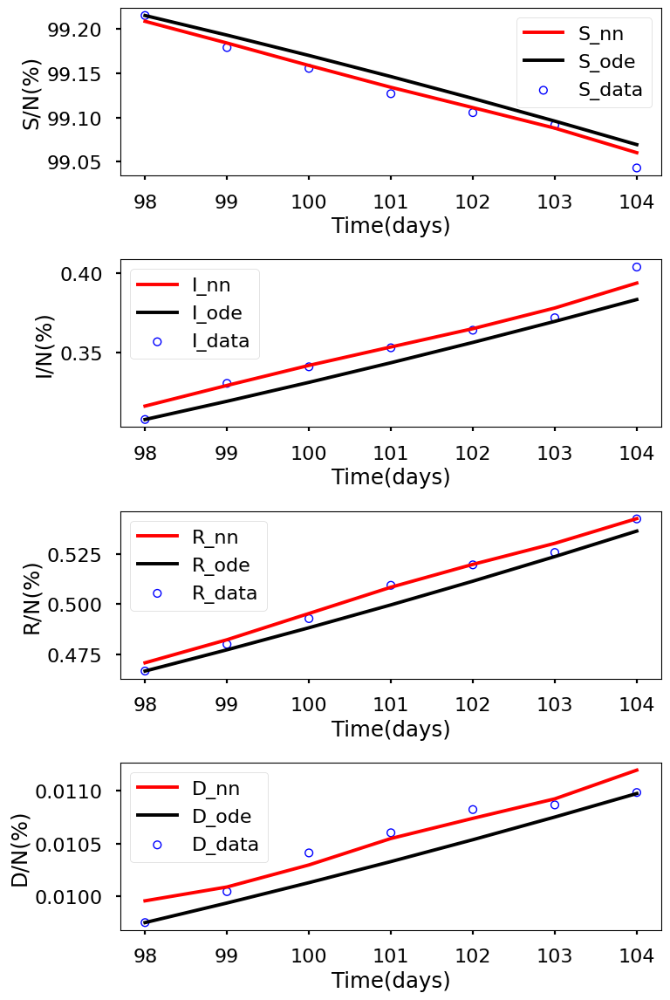

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.038e+00, GE_loss: 2.06760e+00,OB_loss: 9.70203e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 10.32, cumulative_time: 10.32
It: 10000, Loss: 1.712e-05, GE_loss: 4.95654e-06,OB_loss: 1.21668e-05, Beta: 1.04014e+00,gamma: 9.60045e-01,mu: 9.57477e-01, Time: 31.88, cumulative_time: 42.20
It: 20000, Loss: 4.939e-09, GE_loss: 1.24750e-09,OB_loss: 3.69169e-09, Beta: 7.36409e-02,gamma: 3.76027e-02,mu: 3.24502e-03, Time: 32.66, cumulative_time: 74.85
It: 30000, Loss: 4.517e-09, GE_loss: 1.53431e-09,OB_loss: 2.98312e-09, Beta: 7.28564e-02,gamma: 3.85156e-02,mu: 6.73803e-04, Time: 31.88, cumulative_time: 106.73
It: 40000, Loss: 3.938e-09, GE_loss: 1.26995e-09,OB_loss: 2.66840e-09, Beta: 7.29002e-02,gamma: 3.86871e-02,mu: 6.88230e-04, Time: 31.13, cumulative_time: 137.87
beta:  [0.07289404]
gamma:  [0.03868458]
mu:  [0.00068072]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


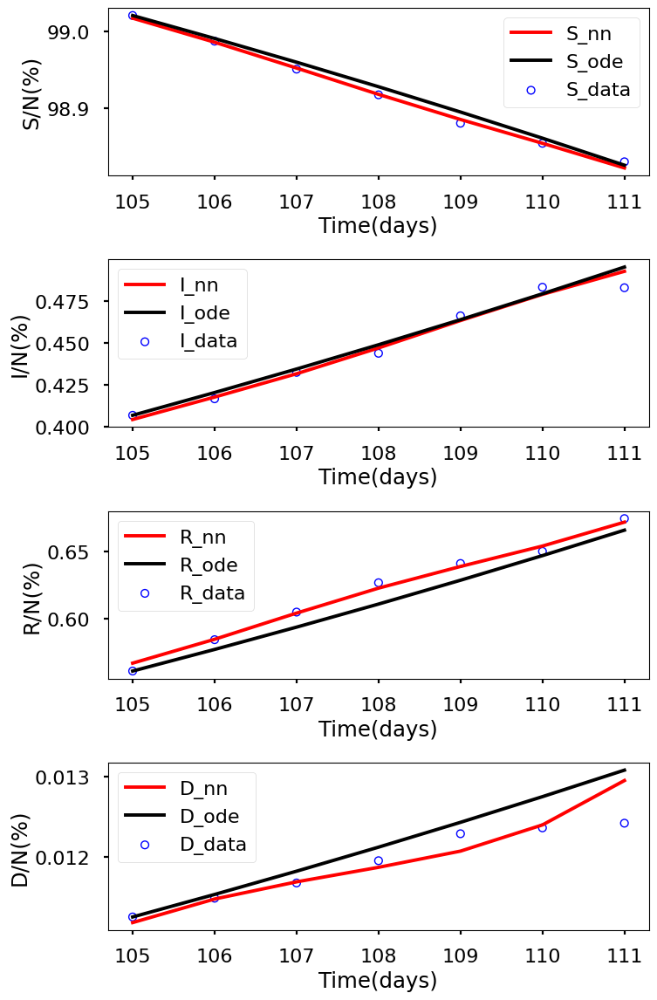

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.026e+00, GE_loss: 2.06345e+00,OB_loss: 9.62436e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 10.33, cumulative_time: 10.33
It: 10000, Loss: 2.307e-05, GE_loss: 6.68488e-06,OB_loss: 1.63899e-05, Beta: 1.04400e+00,gamma: 9.55121e-01,mu: 9.52339e-01, Time: 33.22, cumulative_time: 43.54
It: 20000, Loss: 7.599e-09, GE_loss: 1.45597e-09,OB_loss: 6.14294e-09, Beta: 6.89334e-02,gamma: 3.84002e-02,mu: 2.29788e-03, Time: 33.10, cumulative_time: 76.64
It: 30000, Loss: 6.768e-09, GE_loss: 1.57398e-09,OB_loss: 5.19360e-09, Beta: 6.87188e-02,gamma: 3.90259e-02,mu: 6.42451e-04, Time: 34.63, cumulative_time: 111.27
It: 40000, Loss: 6.341e-09, GE_loss: 2.04964e-09,OB_loss: 4.29168e-09, Beta: 6.85414e-02,gamma: 3.89579e-02,mu: 5.00705e-04, Time: 30.94, cumulative_time: 142.21
beta:  [0.06853343]
gamma:  [0.03895184]
mu:  [0.00056788]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


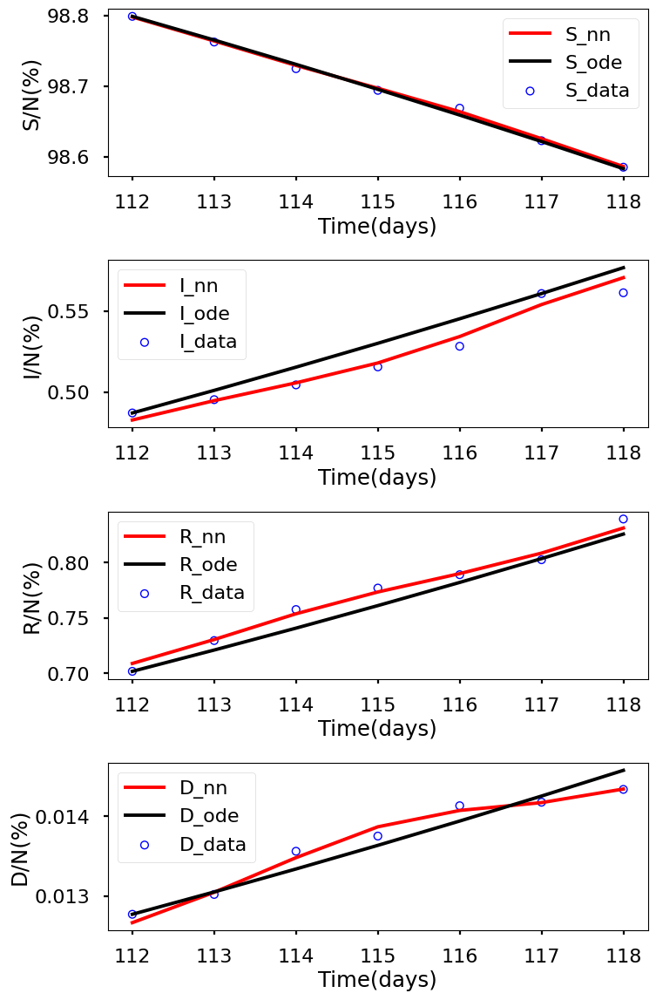

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.002e+00, GE_loss: 2.04147e+00,OB_loss: 9.60666e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 10.25, cumulative_time: 10.25
It: 10000, Loss: 2.703e-05, GE_loss: 7.94599e-06,OB_loss: 1.90800e-05, Beta: 1.04601e+00,gamma: 9.51478e-01,mu: 9.48515e-01, Time: 33.54, cumulative_time: 43.79
It: 20000, Loss: 4.353e-08, GE_loss: 2.68313e-08,OB_loss: 1.66938e-08, Beta: 5.45608e-02,gamma: 4.38763e-02,mu: 1.31620e-03, Time: 32.02, cumulative_time: 75.82
It: 30000, Loss: 1.058e-08, GE_loss: 3.37576e-09,OB_loss: 7.20852e-09, Beta: 5.43669e-02,gamma: 4.41431e-02,mu: 6.40657e-04, Time: 31.29, cumulative_time: 107.11
It: 40000, Loss: 3.315e-08, GE_loss: 1.98837e-08,OB_loss: 1.32638e-08, Beta: 5.43710e-02,gamma: 4.41201e-02,mu: 7.17267e-04, Time: 31.16, cumulative_time: 138.27
beta:  [0.05446062]
gamma:  [0.04402183]
mu:  [0.00075442]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


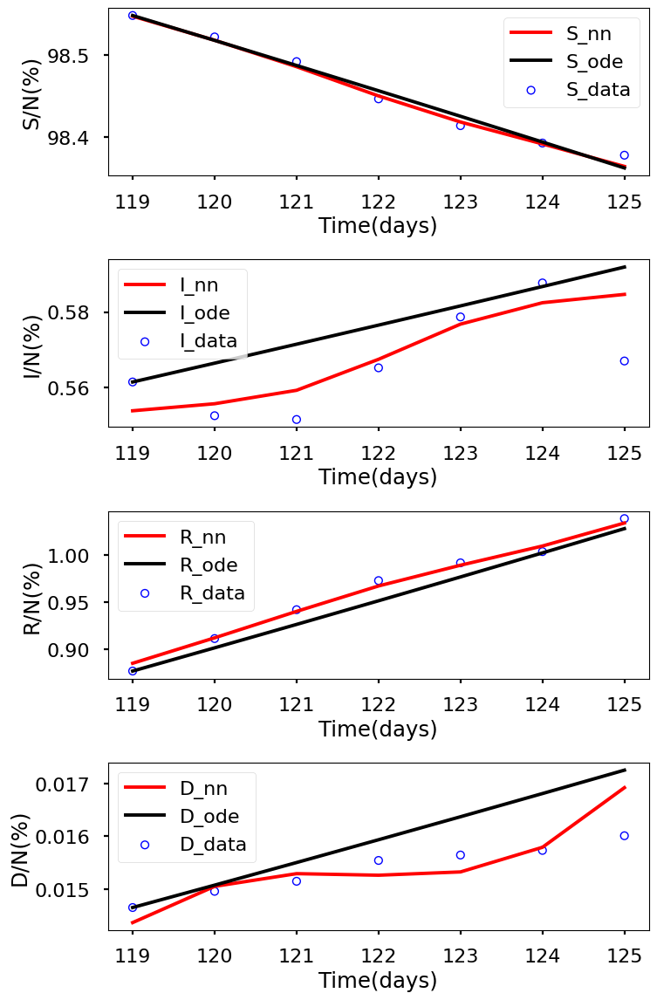

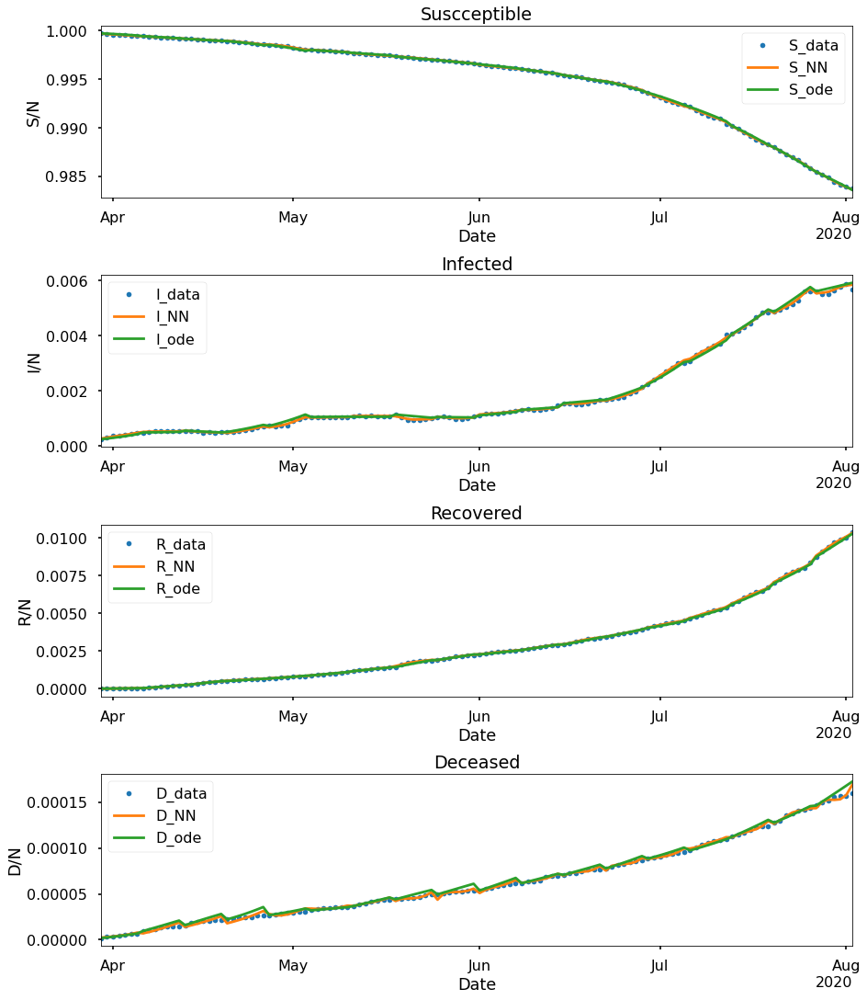

+---------------------+--------------+--------------+--------------+--------------+--------------+--------------+--------------+--------------+--------------+--------------+--------------+--------------+-------------+---------------+-------------+--------------+--------------+--------------+
|      Paramaters     |    Week 1    |    Week 2    |    Week 3    |    Week 4    |    Week 5    |    Week 6    |    Week 7    |    Week 8    |    Week 9    |   Week 10    |   Week 11    |   Week 12    |   Week 13   |    Week 14    |   Week 15   |   Week 16    |   Week 17    |   Week 18    |
+---------------------+--------------+--------------+--------------+--------------+--------------+--------------+--------------+--------------+--------------+--------------+--------------+--------------+-------------+---------------+-------------+--------------+--------------+--------------+
|         beta        |  0.10772967  |  0.06848286  |  0.06809339  |  0.10898096  |  0.10776882  | 0.037695315  | 0.03988

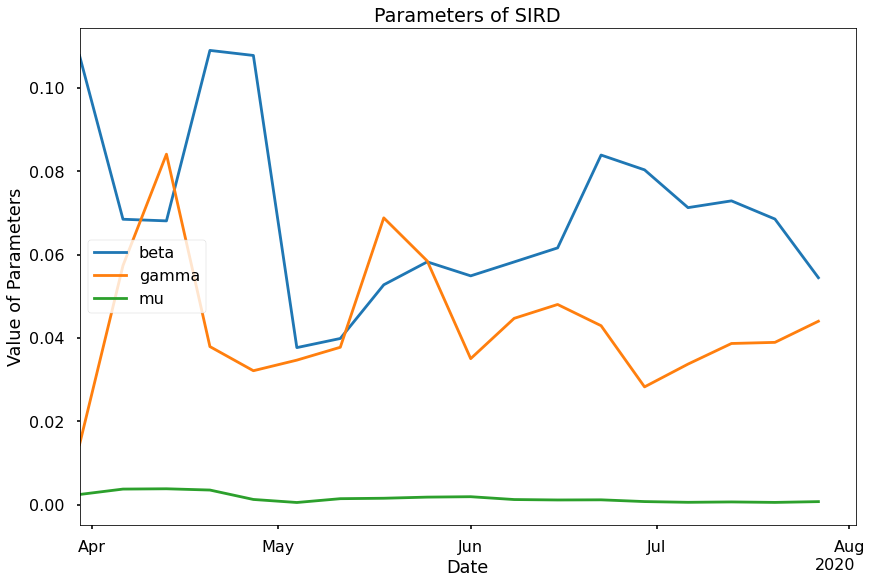

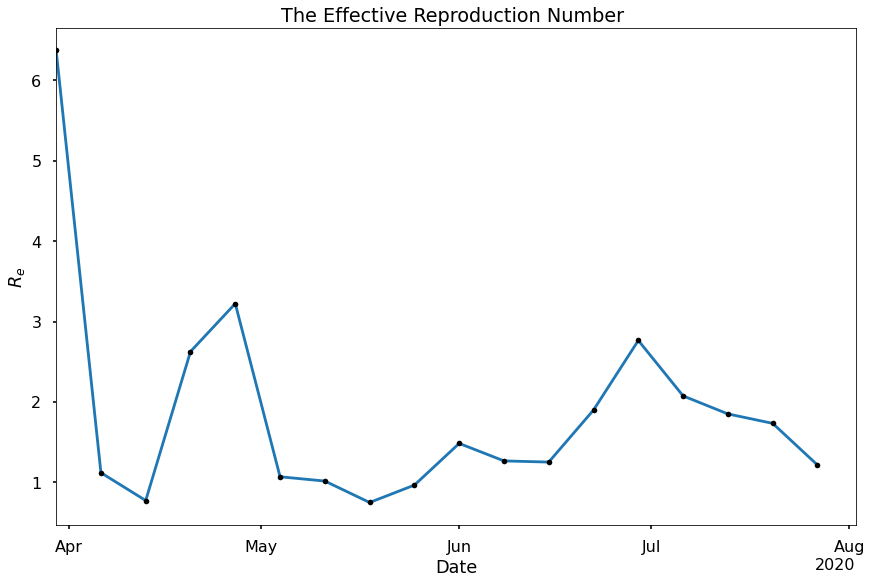

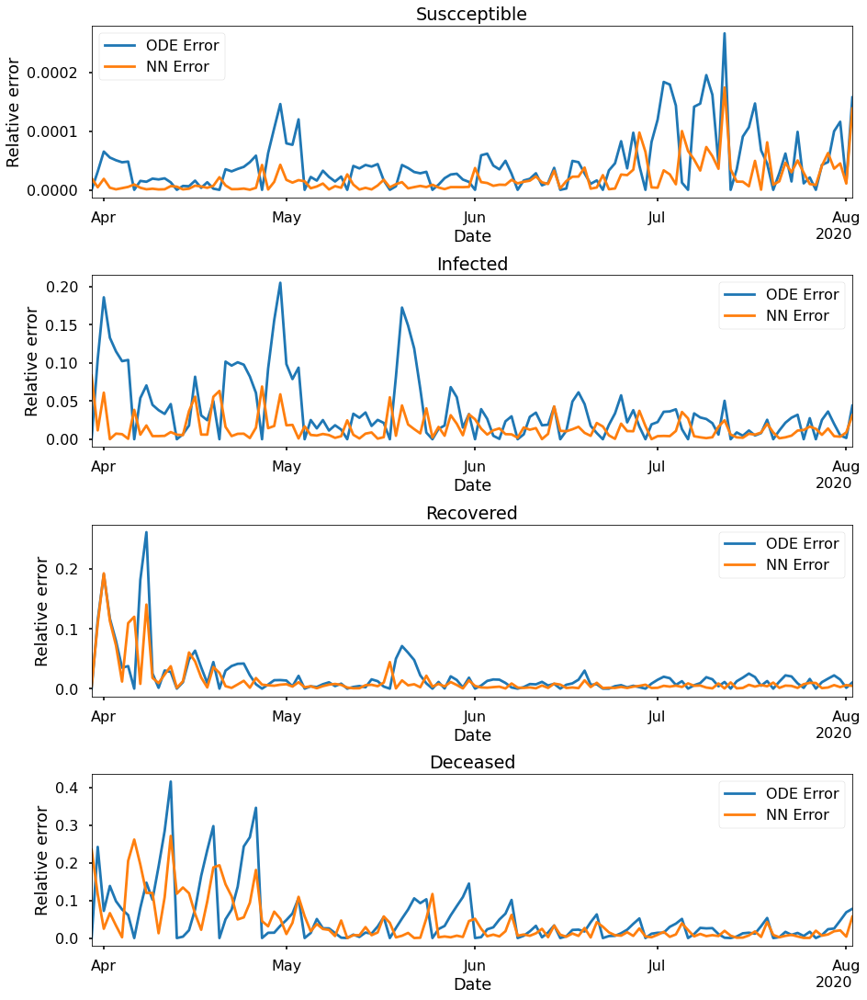

In [ ]:
layers464 = [1,64,64,64,64,4]
S464_ode,I464_ode,R464_ode,D464_ode,S464_learned,I464_learned,R464_learned,D464_learned,beta464,gamma464,mu464,S_errnn464,I_errnn464,R_errnn464,D_errnn464,S_erode464,I_errode464,R_errode464,D_errode464,time464 = sum_all(
    layers464,length,SS,II,RC,DC,N0,0.1,50000)

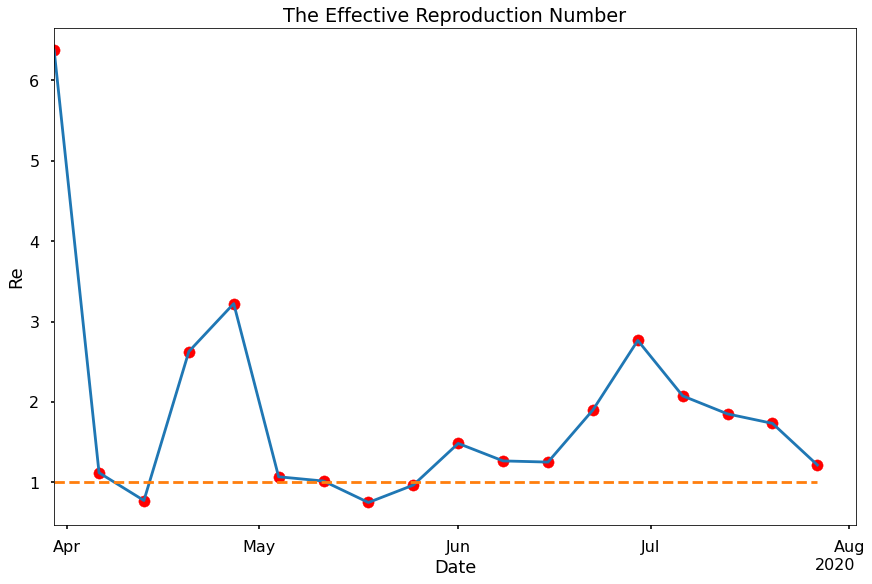

In [ ]:
R0 = beta464/(mu464+gamma464)
date_begin1 = dt.datetime(2020,3,30)
date_end1 = dt.datetime(2020,8,3)
delta1 = dt.timedelta(days=7)
dates1 = mpl.dates.drange(date_begin1, date_end1, delta1)
fig, axs = plt.subplots(constrained_layout=True, figsize=(12, 8))
lims1 = (np.datetime64('2020-03-30'), np.datetime64('2020-08-02'))
ones = [1]*(R0.shape[0])
ones = np.array(ones).reshape(len(ones),1)
locator = mdates.AutoDateLocator(minticks=3, maxticks=7)
formatter = mdates.ConciseDateFormatter(locator)
axs.xaxis.set_major_locator(locator)
axs.xaxis.set_major_formatter(formatter)
axs.plot(dates1, R0)
axs.scatter(dates1, R0,c='red')
axs.plot(dates1,ones,'--')
axs.set_xlabel("Date")
axs.set_ylabel("Re")
axs.set_xlim(lims1)
axs.set_title("The Effective Reproduction Number")
plt.show()

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 2.988e+00, GE_loss: 2.00191e+00,OB_loss: 9.86110e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 10.44, cumulative_time: 10.44
It: 10000, Loss: 2.114e-07, GE_loss: 6.37404e-08,OB_loss: 1.47669e-07, Beta: 1.02194e+00,gamma: 9.77977e-01,mu: 9.77985e-01, Time: 35.05, cumulative_time: 45.49
It: 20000, Loss: 1.282e-07, GE_loss: 3.63026e-08,OB_loss: 9.19214e-08, Beta: 1.04435e+00,gamma: 9.59598e-01,mu: 9.59679e-01, Time: 35.55, cumulative_time: 81.04
It: 30000, Loss: 3.563e-10, GE_loss: 1.01072e-10,OB_loss: 2.55206e-10, Beta: 1.08164e-01,gamma: 1.84745e-02,mu: 3.58025e-03, Time: 34.50, cumulative_time: 115.53
It: 40000, Loss: 3.247e-10, GE_loss: 1.05568e-10,OB_loss: 2.19180e-10, Beta: 1.07720e-01,gamma: 1.53745e-02,mu: 2.85128e-03, Time: 34.83, cumulative_time: 150.37
beta:  [0.10738456]
gamma:  [0.01444537]
mu:  [0.00268556]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


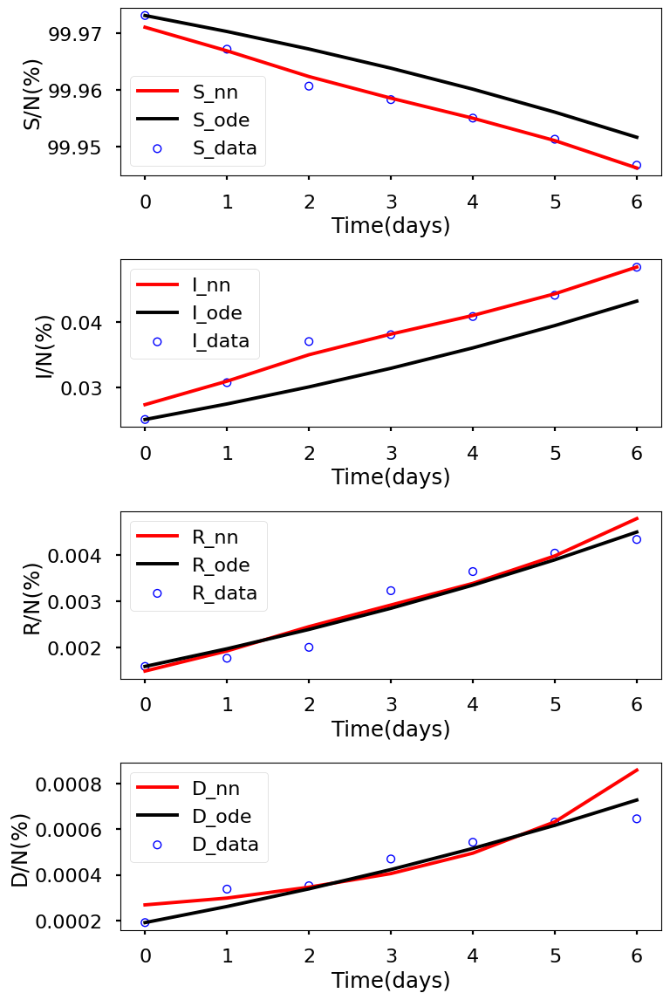

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.021e+00, GE_loss: 2.03597e+00,OB_loss: 9.85246e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 10.42, cumulative_time: 10.42
It: 10000, Loss: 2.857e-07, GE_loss: 9.30469e-08,OB_loss: 1.92613e-07, Beta: 1.02314e+00,gamma: 9.76656e-01,mu: 9.76700e-01, Time: 35.13, cumulative_time: 45.55
It: 20000, Loss: 2.367e-07, GE_loss: 7.11793e-08,OB_loss: 1.65539e-07, Beta: 1.04930e+00,gamma: 9.44453e-01,mu: 9.41015e-01, Time: 34.56, cumulative_time: 80.11
It: 30000, Loss: 1.532e-10, GE_loss: 4.23717e-11,OB_loss: 1.10843e-10, Beta: 6.74395e-02,gamma: 5.66677e-02,mu: 5.57540e-03, Time: 35.43, cumulative_time: 115.54
It: 40000, Loss: 1.220e-10, GE_loss: 3.10849e-11,OB_loss: 9.09087e-11, Beta: 6.83054e-02,gamma: 5.69491e-02,mu: 4.56186e-03, Time: 34.17, cumulative_time: 149.71
beta:  [0.06836197]
gamma:  [0.05703655]
mu:  [0.00415523]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


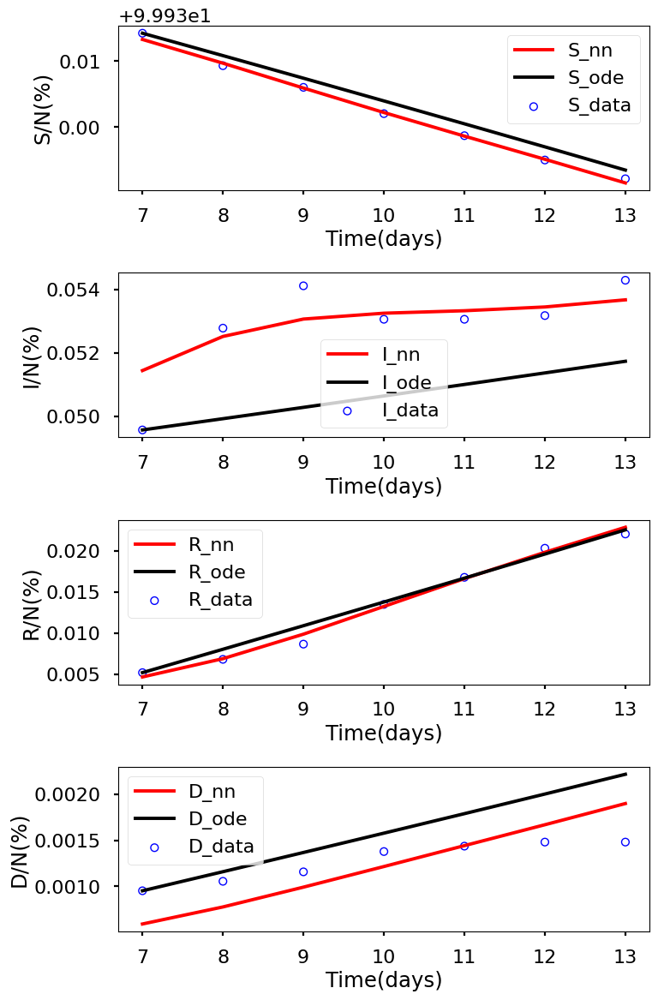

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.026e+00, GE_loss: 2.03939e+00,OB_loss: 9.86466e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 10.36, cumulative_time: 10.36
It: 10000, Loss: 2.706e-07, GE_loss: 9.48610e-08,OB_loss: 1.75712e-07, Beta: 1.02293e+00,gamma: 9.76023e-01,mu: 9.76047e-01, Time: 35.17, cumulative_time: 45.53
It: 20000, Loss: 2.233e-07, GE_loss: 6.65565e-08,OB_loss: 1.56732e-07, Beta: 1.04791e+00,gamma: 9.46262e-01,mu: 9.40552e-01, Time: 34.54, cumulative_time: 80.07
It: 30000, Loss: 4.239e-10, GE_loss: 3.44417e-11,OB_loss: 3.89424e-10, Beta: 6.73348e-02,gamma: 8.43849e-02,mu: 4.06235e-03, Time: 35.44, cumulative_time: 115.51
It: 40000, Loss: 3.907e-10, GE_loss: 6.12777e-11,OB_loss: 3.29439e-10, Beta: 6.84398e-02,gamma: 8.30292e-02,mu: 3.70302e-03, Time: 34.75, cumulative_time: 150.26
beta:  [0.06866527]
gamma:  [0.08273446]
mu:  [0.00343084]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


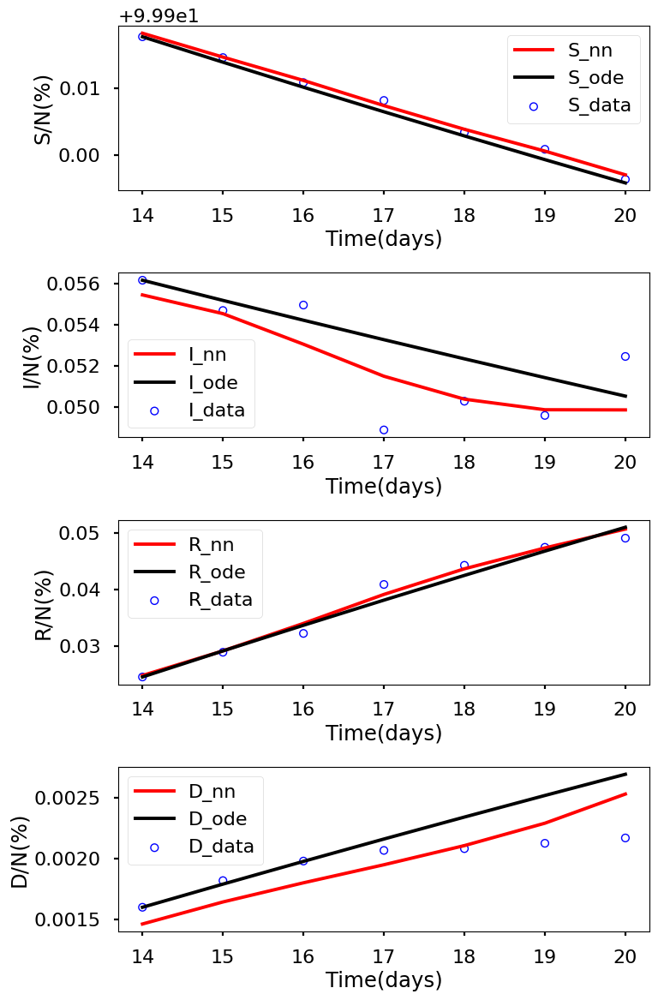

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.049e+00, GE_loss: 2.06420e+00,OB_loss: 9.84663e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 10.84, cumulative_time: 10.84
It: 10000, Loss: 3.116e-07, GE_loss: 1.00488e-07,OB_loss: 2.11082e-07, Beta: 1.02418e+00,gamma: 9.75521e-01,mu: 9.75444e-01, Time: 35.21, cumulative_time: 46.05
It: 20000, Loss: 2.849e-07, GE_loss: 8.41531e-08,OB_loss: 2.00766e-07, Beta: 1.06966e+00,gamma: 9.36622e-01,mu: 9.30025e-01, Time: 35.15, cumulative_time: 81.20
It: 30000, Loss: 2.044e-10, GE_loss: 4.45874e-11,OB_loss: 1.59805e-10, Beta: 1.09901e-01,gamma: 3.68903e-02,mu: 6.96679e-03, Time: 36.04, cumulative_time: 117.23
It: 40000, Loss: 1.637e-10, GE_loss: 4.12898e-11,OB_loss: 1.22440e-10, Beta: 1.08930e-01,gamma: 3.70771e-02,mu: 4.04769e-03, Time: 36.54, cumulative_time: 153.78
beta:  [0.10852949]
gamma:  [0.03737218]
mu:  [0.00289892]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


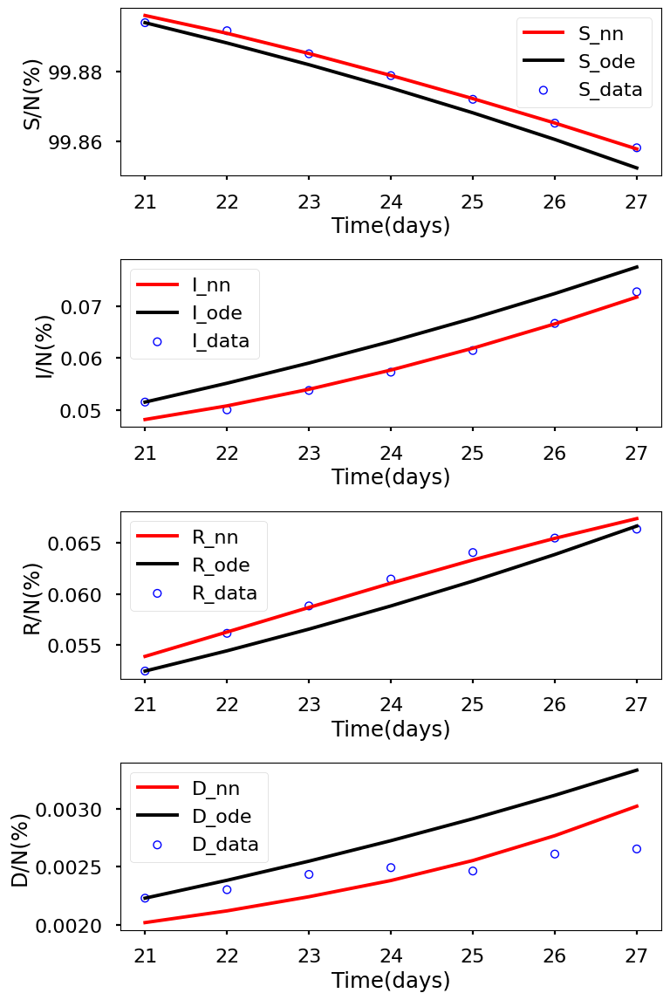

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.012e+00, GE_loss: 2.02189e+00,OB_loss: 9.90585e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 10.92, cumulative_time: 10.92
It: 10000, Loss: 6.309e-07, GE_loss: 1.74774e-07,OB_loss: 4.56107e-07, Beta: 1.02374e+00,gamma: 9.75938e-01,mu: 9.75929e-01, Time: 35.00, cumulative_time: 45.92
It: 20000, Loss: 5.566e-07, GE_loss: 1.72463e-07,OB_loss: 3.84092e-07, Beta: 1.11181e+00,gamma: 8.87431e-01,mu: 8.77677e-01, Time: 35.67, cumulative_time: 81.58
It: 30000, Loss: 1.638e-09, GE_loss: 4.53471e-10,OB_loss: 1.18472e-09, Beta: 1.09337e-01,gamma: 3.25354e-02,mu: 4.22745e-03, Time: 34.89, cumulative_time: 116.47
It: 40000, Loss: 1.620e-09, GE_loss: 5.84348e-10,OB_loss: 1.03577e-09, Beta: 1.07767e-01,gamma: 3.20282e-02,mu: 2.03817e-03, Time: 35.89, cumulative_time: 152.37
beta:  [0.10793435]
gamma:  [0.0325602]
mu:  [0.00131141]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


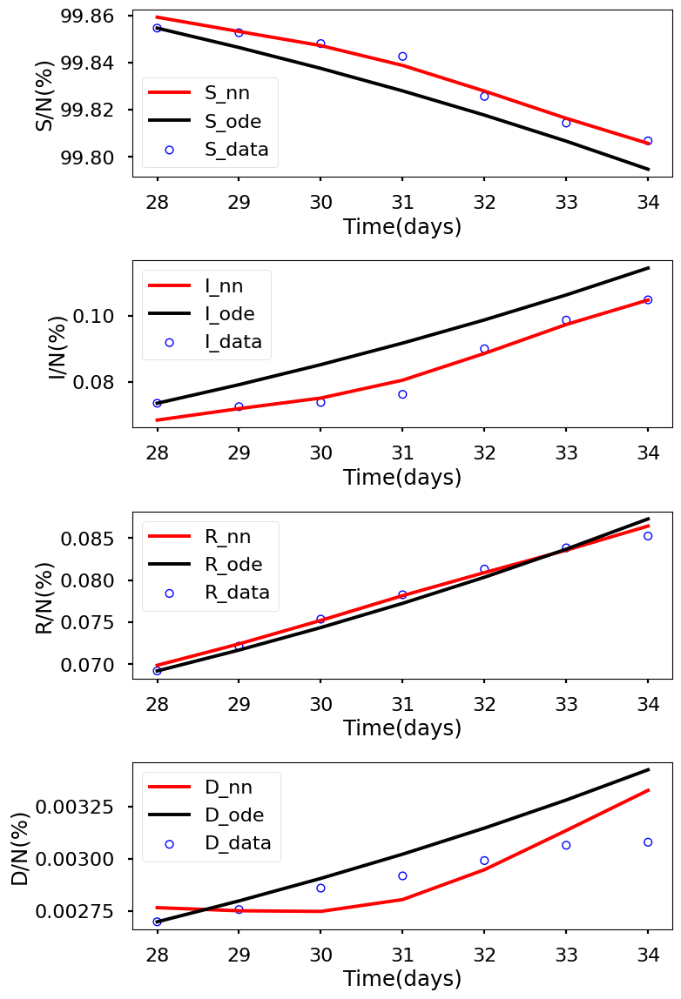

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.026e+00, GE_loss: 2.03719e+00,OB_loss: 9.88516e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 10.98, cumulative_time: 10.98
It: 10000, Loss: 9.719e-07, GE_loss: 2.58053e-07,OB_loss: 7.13820e-07, Beta: 1.02490e+00,gamma: 9.75009e-01,mu: 9.75054e-01, Time: 36.81, cumulative_time: 47.78
It: 20000, Loss: 8.214e-07, GE_loss: 2.70414e-07,OB_loss: 5.50977e-07, Beta: 1.04751e+00,gamma: 8.47610e-01,mu: 8.32953e-01, Time: 35.42, cumulative_time: 83.21
It: 30000, Loss: 1.294e-10, GE_loss: 1.23373e-11,OB_loss: 1.17085e-10, Beta: 3.87793e-02,gamma: 3.42262e-02,mu: 2.89355e-03, Time: 37.41, cumulative_time: 120.62
It: 40000, Loss: 1.150e-10, GE_loss: 1.45881e-11,OB_loss: 1.00445e-10, Beta: 3.83249e-02,gamma: 3.40917e-02,mu: 2.13169e-03, Time: 35.23, cumulative_time: 155.85
beta:  [0.03821972]
gamma:  [0.03416047]
mu:  [0.00179243]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


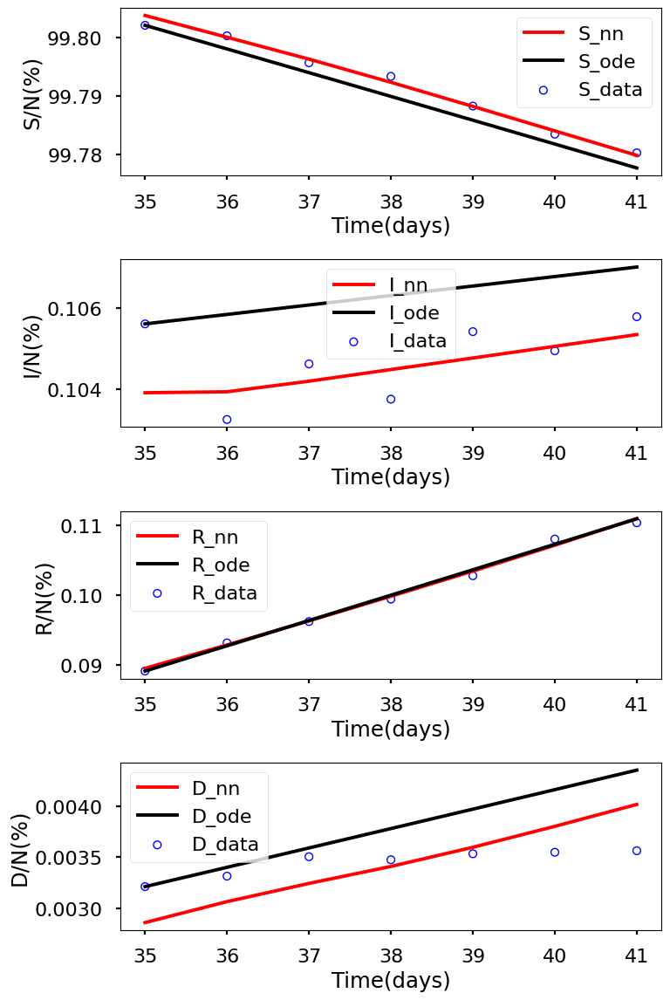

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.031e+00, GE_loss: 2.04333e+00,OB_loss: 9.87555e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 10.95, cumulative_time: 10.95
It: 10000, Loss: 1.063e-06, GE_loss: 2.95088e-07,OB_loss: 7.67469e-07, Beta: 1.02502e+00,gamma: 9.73805e-01,mu: 9.73622e-01, Time: 34.90, cumulative_time: 45.85
It: 20000, Loss: 8.993e-07, GE_loss: 2.97382e-07,OB_loss: 6.01896e-07, Beta: 1.04100e+00,gamma: 8.40198e-01,mu: 8.24997e-01, Time: 38.38, cumulative_time: 84.23
It: 30000, Loss: 2.153e-10, GE_loss: 4.93167e-11,OB_loss: 1.65992e-10, Beta: 4.05065e-02,gamma: 3.74669e-02,mu: 2.87166e-03, Time: 37.48, cumulative_time: 121.71
It: 40000, Loss: 1.863e-10, GE_loss: 4.01884e-11,OB_loss: 1.46150e-10, Beta: 3.99622e-02,gamma: 3.76736e-02,mu: 1.69405e-03, Time: 36.52, cumulative_time: 158.23
beta:  [0.03984305]
gamma:  [0.03778221]
mu:  [0.00139564]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


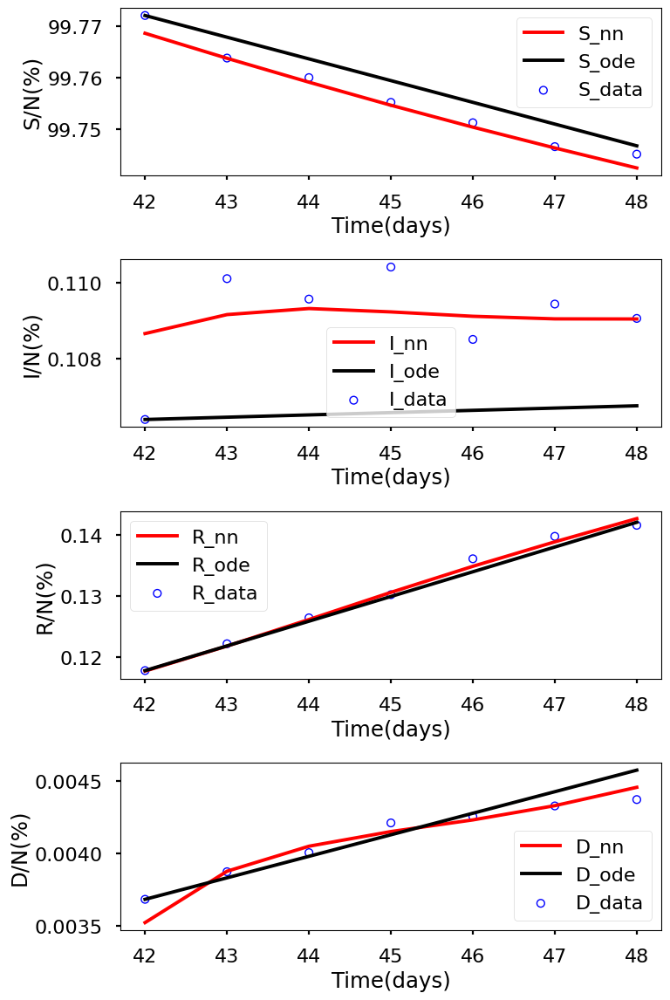

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.003e+00, GE_loss: 2.01663e+00,OB_loss: 9.85909e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 11.23, cumulative_time: 11.23
It: 10000, Loss: 8.675e-07, GE_loss: 2.34187e-07,OB_loss: 6.33308e-07, Beta: 1.02351e+00,gamma: 9.76055e-01,mu: 9.75969e-01, Time: 36.69, cumulative_time: 47.92
It: 20000, Loss: 7.142e-07, GE_loss: 2.38962e-07,OB_loss: 4.75262e-07, Beta: 1.03833e+00,gamma: 8.61173e-01,mu: 8.31801e-01, Time: 34.31, cumulative_time: 82.23
It: 30000, Loss: 2.519e-09, GE_loss: 1.00548e-09,OB_loss: 1.51401e-09, Beta: 5.42447e-02,gamma: 6.69540e-02,mu: 5.01583e-03, Time: 34.47, cumulative_time: 116.70
It: 40000, Loss: 2.482e-09, GE_loss: 1.07706e-09,OB_loss: 1.40445e-09, Beta: 5.31874e-02,gamma: 6.80260e-02,mu: 3.34613e-03, Time: 34.64, cumulative_time: 151.34
beta:  [0.05285833]
gamma:  [0.06849033]
mu:  [0.00245137]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


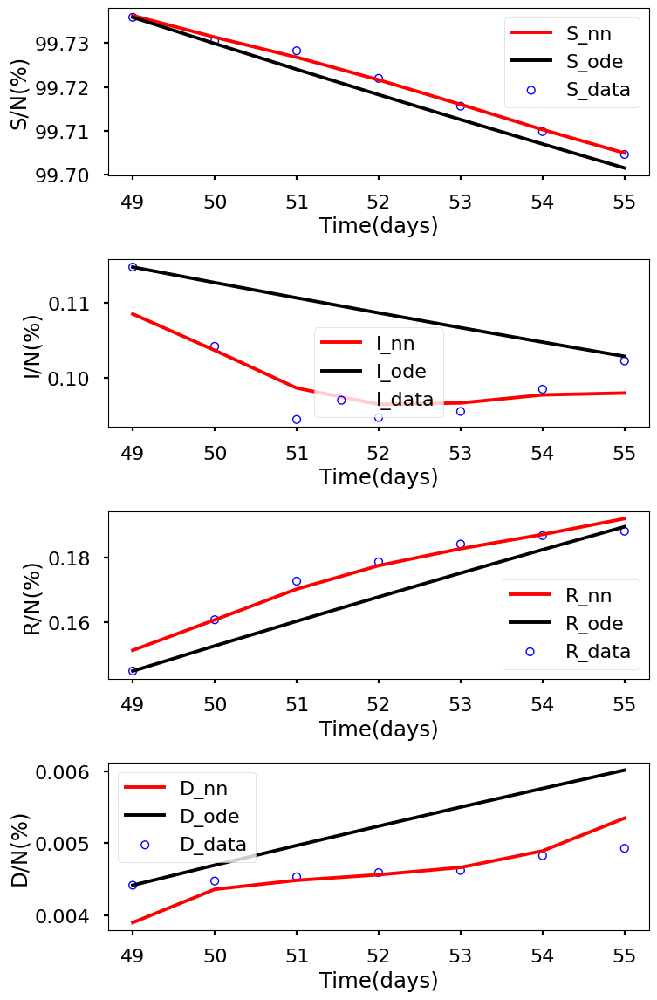

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.022e+00, GE_loss: 2.03971e+00,OB_loss: 9.82541e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 11.10, cumulative_time: 11.10
It: 10000, Loss: 9.240e-07, GE_loss: 2.55295e-07,OB_loss: 6.68722e-07, Beta: 1.02459e+00,gamma: 9.75112e-01,mu: 9.75075e-01, Time: 35.06, cumulative_time: 46.16
It: 20000, Loss: 7.676e-07, GE_loss: 2.52464e-07,OB_loss: 5.15160e-07, Beta: 1.04453e+00,gamma: 8.56942e-01,mu: 8.29359e-01, Time: 36.21, cumulative_time: 82.37
It: 30000, Loss: 2.220e-09, GE_loss: 1.20812e-09,OB_loss: 1.01209e-09, Beta: 5.84614e-02,gamma: 5.82571e-02,mu: 3.00746e-03, Time: 34.73, cumulative_time: 117.10
It: 40000, Loss: 9.911e-10, GE_loss: 4.04665e-10,OB_loss: 5.86426e-10, Beta: 5.80061e-02,gamma: 5.87194e-02,mu: 1.35423e-03, Time: 34.75, cumulative_time: 151.84
beta:  [0.05792826]
gamma:  [0.05886037]
mu:  [0.00119849]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


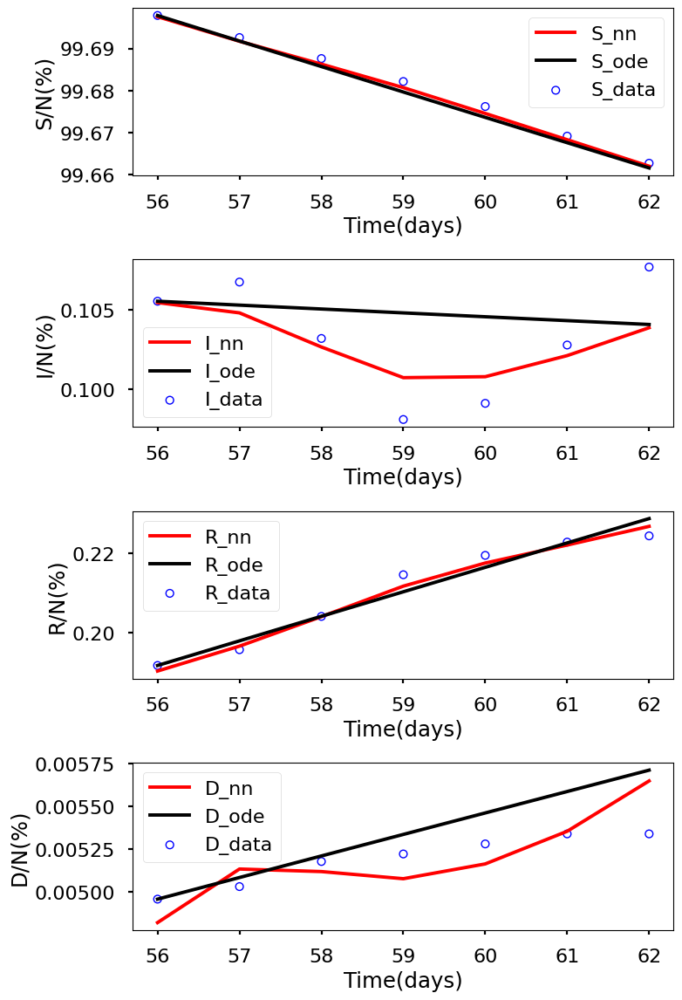

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.042e+00, GE_loss: 2.06133e+00,OB_loss: 9.81029e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 11.51, cumulative_time: 11.51
It: 10000, Loss: 1.272e-06, GE_loss: 3.61138e-07,OB_loss: 9.10530e-07, Beta: 1.02522e+00,gamma: 9.74223e-01,mu: 9.74189e-01, Time: 35.45, cumulative_time: 46.96
It: 20000, Loss: 1.016e-06, GE_loss: 3.51161e-07,OB_loss: 6.64370e-07, Beta: 1.03456e+00,gamma: 8.09174e-01,mu: 7.81211e-01, Time: 34.19, cumulative_time: 81.15
It: 30000, Loss: 5.212e-10, GE_loss: 7.25562e-11,OB_loss: 4.48616e-10, Beta: 5.46548e-02,gamma: 3.52858e-02,mu: 2.67850e-03, Time: 34.58, cumulative_time: 115.73
It: 40000, Loss: 6.361e-10, GE_loss: 1.91567e-10,OB_loss: 4.44524e-10, Beta: 5.48131e-02,gamma: 3.50440e-02,mu: 2.01860e-03, Time: 35.31, cumulative_time: 151.04
beta:  [0.05493335]
gamma:  [0.03491789]
mu:  [0.00178289]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


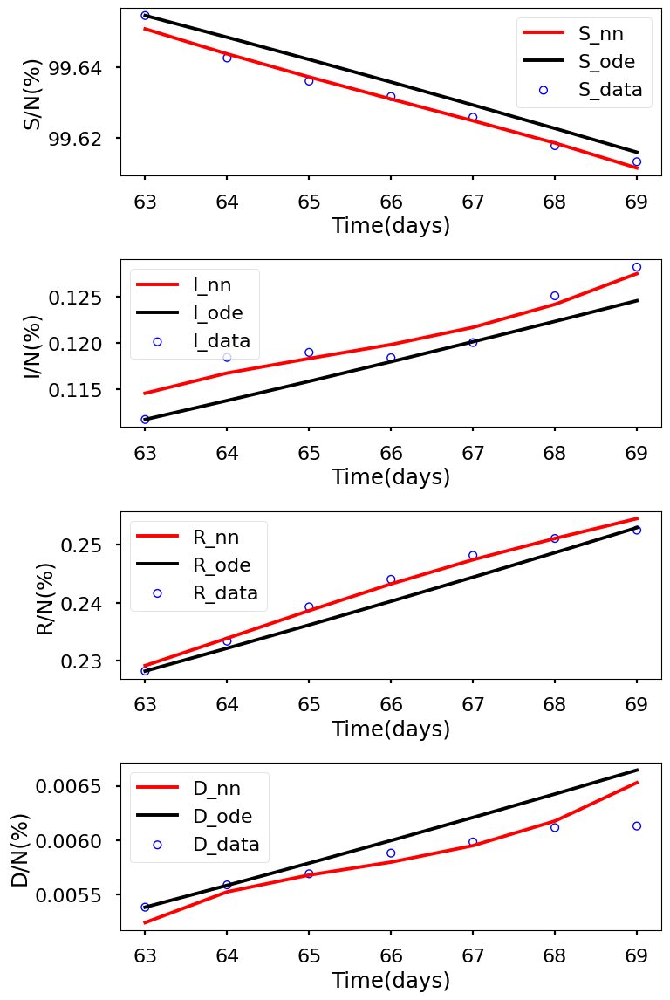

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 2.996e+00, GE_loss: 2.01633e+00,OB_loss: 9.79517e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 11.07, cumulative_time: 11.07
It: 10000, Loss: 1.581e-06, GE_loss: 4.36301e-07,OB_loss: 1.14436e-06, Beta: 1.02485e+00,gamma: 9.75053e-01,mu: 9.74934e-01, Time: 34.90, cumulative_time: 45.97
It: 20000, Loss: 1.162e-06, GE_loss: 4.32208e-07,OB_loss: 7.29835e-07, Beta: 9.83019e-01,gamma: 7.57140e-01,mu: 7.08569e-01, Time: 35.61, cumulative_time: 81.58
It: 30000, Loss: 7.535e-10, GE_loss: 1.90817e-10,OB_loss: 5.62689e-10, Beta: 5.88883e-02,gamma: 4.41955e-02,mu: 2.55462e-03, Time: 34.86, cumulative_time: 116.44
It: 40000, Loss: 1.106e-09, GE_loss: 4.75617e-10,OB_loss: 6.30478e-10, Beta: 5.85618e-02,gamma: 4.43585e-02,mu: 1.48888e-03, Time: 34.96, cumulative_time: 151.41
beta:  [0.05853759]
gamma:  [0.04446915]
mu:  [0.00135677]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


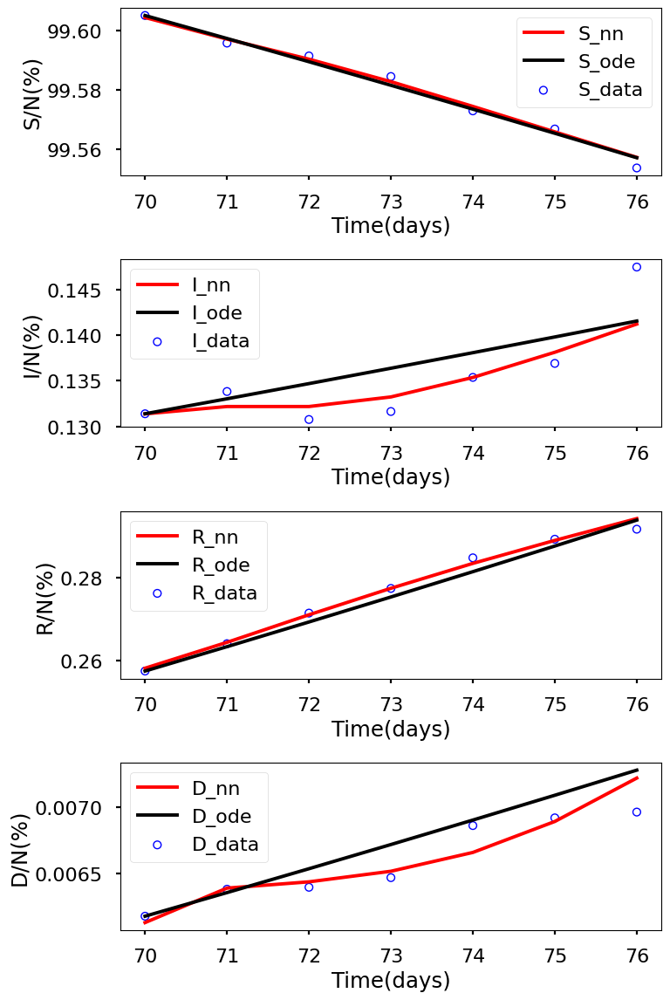

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.016e+00, GE_loss: 2.03549e+00,OB_loss: 9.80768e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 11.48, cumulative_time: 11.48
It: 10000, Loss: 2.142e-06, GE_loss: 6.10527e-07,OB_loss: 1.53152e-06, Beta: 1.02372e+00,gamma: 9.76464e-01,mu: 9.76166e-01, Time: 35.75, cumulative_time: 47.23
It: 20000, Loss: 1.321e-06, GE_loss: 5.73362e-07,OB_loss: 7.47343e-07, Beta: 8.58486e-01,gamma: 6.40235e-01,mu: 5.82791e-01, Time: 36.02, cumulative_time: 83.25
It: 30000, Loss: 2.313e-09, GE_loss: 6.48397e-10,OB_loss: 1.66426e-09, Beta: 6.22064e-02,gamma: 4.69262e-02,mu: 2.71805e-03, Time: 34.18, cumulative_time: 117.43
It: 40000, Loss: 7.121e-09, GE_loss: 4.10016e-09,OB_loss: 3.02055e-09, Beta: 6.17530e-02,gamma: 4.73290e-02,mu: 1.25608e-03, Time: 36.27, cumulative_time: 153.70
beta:  [0.06187261]
gamma:  [0.04766883]
mu:  [0.00144051]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


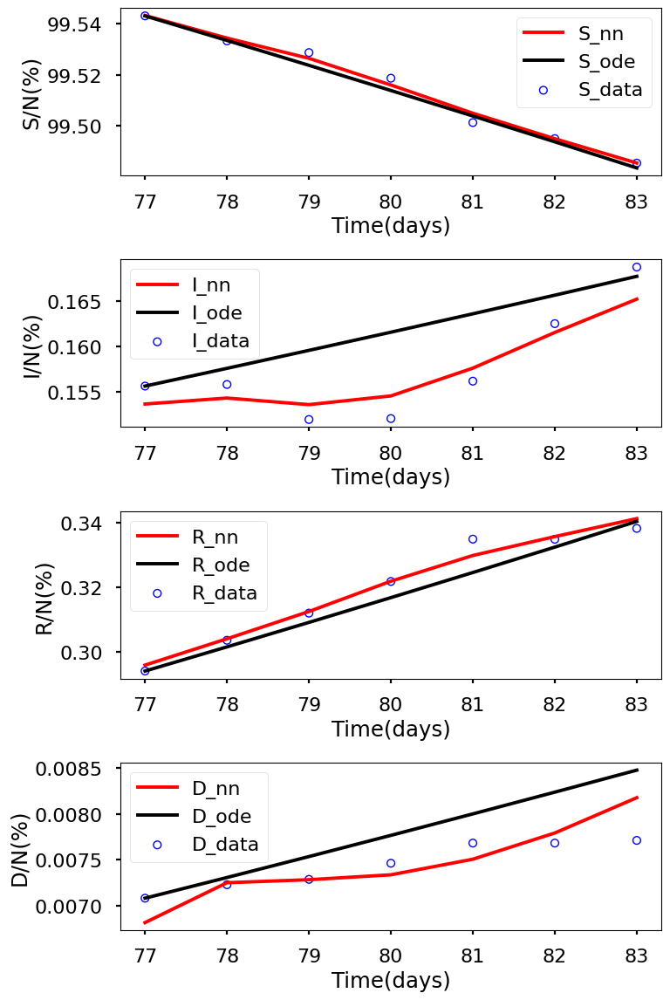

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.015e+00, GE_loss: 2.03435e+00,OB_loss: 9.80776e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 11.70, cumulative_time: 11.70
It: 10000, Loss: 2.935e-06, GE_loss: 8.46218e-07,OB_loss: 2.08852e-06, Beta: 1.02601e+00,gamma: 9.74127e-01,mu: 9.73706e-01, Time: 34.44, cumulative_time: 46.14
It: 20000, Loss: 1.252e-06, GE_loss: 6.58677e-07,OB_loss: 5.93155e-07, Beta: 6.77938e-01,gamma: 4.89651e-01,mu: 4.19420e-01, Time: 35.52, cumulative_time: 81.67
It: 30000, Loss: 1.372e-09, GE_loss: 2.48684e-10,OB_loss: 1.12341e-09, Beta: 8.39681e-02,gamma: 4.27066e-02,mu: 1.86897e-03, Time: 36.18, cumulative_time: 117.85
It: 40000, Loss: 1.278e-09, GE_loss: 2.02240e-10,OB_loss: 1.07540e-09, Beta: 8.38514e-02,gamma: 4.29585e-02,mu: 1.11126e-03, Time: 34.56, cumulative_time: 152.41
beta:  [0.08381476]
gamma:  [0.0430297]
mu:  [0.00098645]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


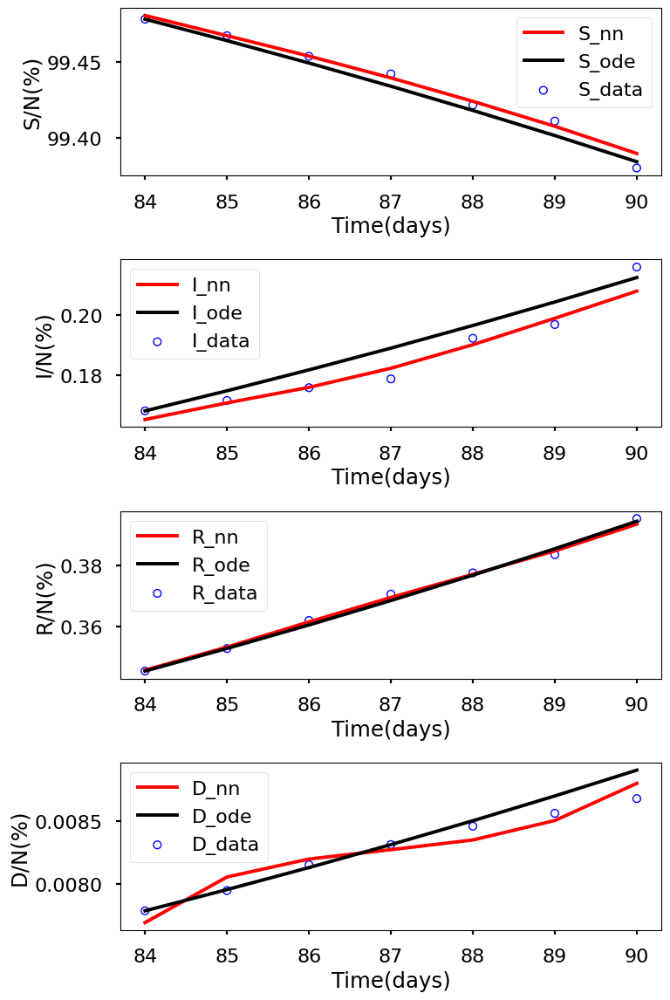

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.024e+00, GE_loss: 2.05092e+00,OB_loss: 9.72945e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 11.97, cumulative_time: 11.97
It: 10000, Loss: 6.343e-06, GE_loss: 1.81682e-06,OB_loss: 4.52649e-06, Beta: 1.02983e+00,gamma: 9.71413e-01,mu: 9.70533e-01, Time: 35.93, cumulative_time: 47.90
It: 20000, Loss: 1.923e-08, GE_loss: 1.27321e-08,OB_loss: 6.49309e-09, Beta: 1.12798e-01,gamma: 6.45297e-02,mu: 1.66417e-02, Time: 35.56, cumulative_time: 83.46
It: 30000, Loss: 2.657e-09, GE_loss: 9.06350e-10,OB_loss: 1.75015e-09, Beta: 8.04261e-02,gamma: 2.81777e-02,mu: 1.05309e-03, Time: 35.79, cumulative_time: 119.25
It: 40000, Loss: 2.657e-09, GE_loss: 9.50232e-10,OB_loss: 1.70675e-09, Beta: 8.04043e-02,gamma: 2.82732e-02,mu: 8.46050e-04, Time: 34.73, cumulative_time: 153.98
beta:  [0.08036626]
gamma:  [0.02827949]
mu:  [0.00079313]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


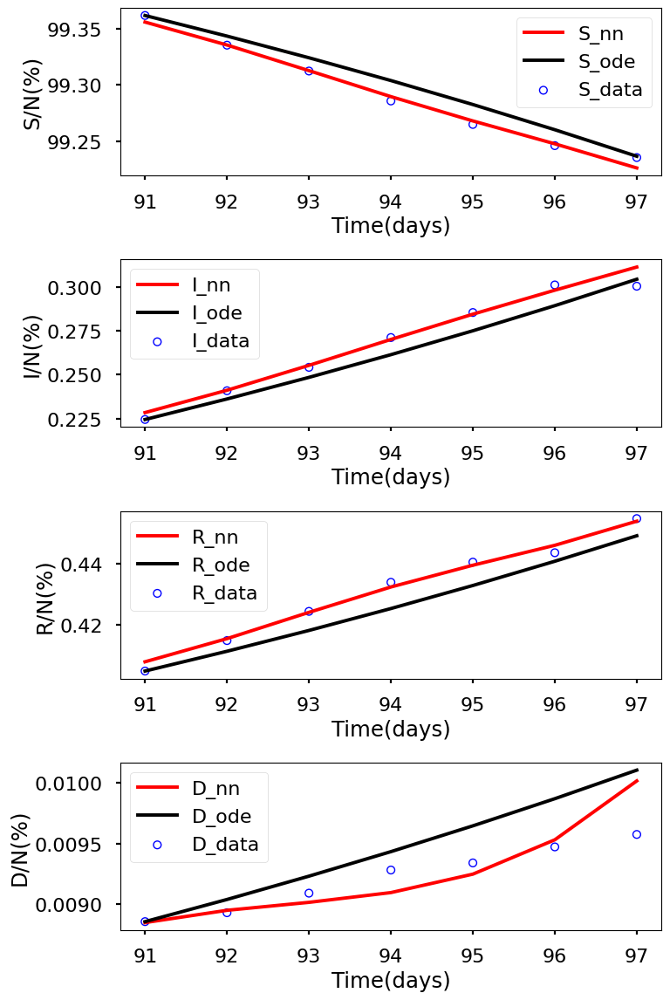

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.026e+00, GE_loss: 2.05270e+00,OB_loss: 9.73090e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 11.41, cumulative_time: 11.41
It: 10000, Loss: 1.074e-05, GE_loss: 3.11264e-06,OB_loss: 7.62706e-06, Beta: 1.03334e+00,gamma: 9.66316e-01,mu: 9.64761e-01, Time: 34.60, cumulative_time: 46.00
It: 20000, Loss: 4.558e-09, GE_loss: 8.39464e-10,OB_loss: 3.71893e-09, Beta: 7.31038e-02,gamma: 3.44501e-02,mu: 3.87081e-03, Time: 33.81, cumulative_time: 79.82
It: 30000, Loss: 7.263e-09, GE_loss: 3.23925e-09,OB_loss: 4.02409e-09, Beta: 7.13737e-02,gamma: 3.36666e-02,mu: 8.20623e-04, Time: 34.46, cumulative_time: 114.28
It: 40000, Loss: 3.742e-09, GE_loss: 7.66331e-10,OB_loss: 2.97604e-09, Beta: 7.13521e-02,gamma: 3.36625e-02,mu: 7.62928e-04, Time: 34.27, cumulative_time: 148.55
beta:  [0.07135186]
gamma:  [0.03369987]
mu:  [0.00079671]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


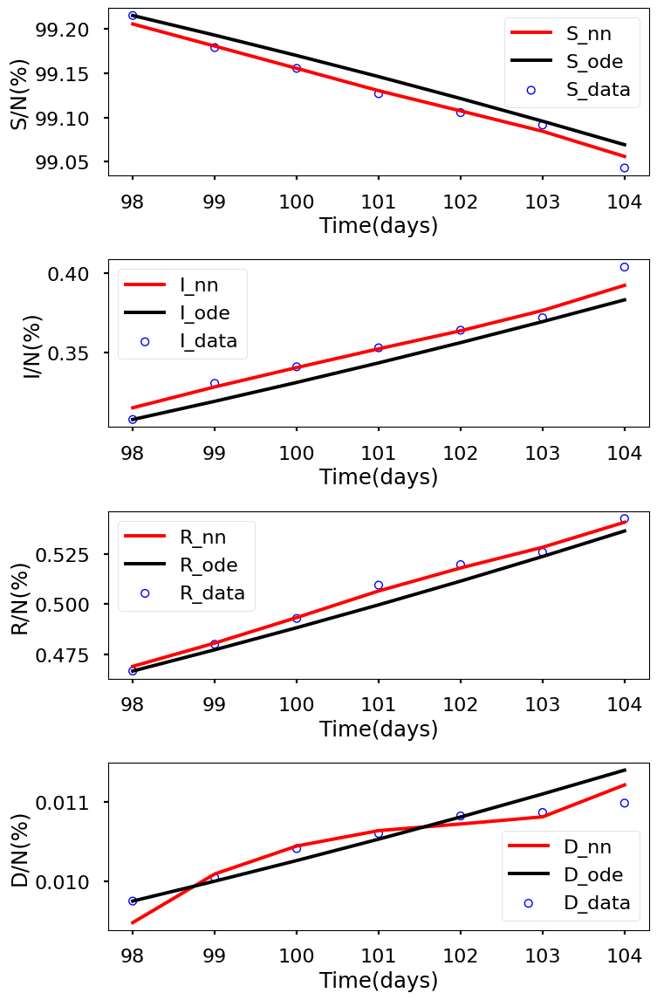

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.025e+00, GE_loss: 2.05706e+00,OB_loss: 9.67504e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 11.79, cumulative_time: 11.79
It: 10000, Loss: 1.721e-05, GE_loss: 4.99668e-06,OB_loss: 1.22166e-05, Beta: 1.03928e+00,gamma: 9.61540e-01,mu: 9.59638e-01, Time: 35.71, cumulative_time: 47.50
It: 20000, Loss: 4.652e-09, GE_loss: 1.19749e-09,OB_loss: 3.45493e-09, Beta: 7.37322e-02,gamma: 3.76496e-02,mu: 3.28614e-03, Time: 35.80, cumulative_time: 83.30
It: 30000, Loss: 4.112e-09, GE_loss: 1.33038e-09,OB_loss: 2.78149e-09, Beta: 7.29660e-02,gamma: 3.85438e-02,mu: 9.00595e-04, Time: 36.48, cumulative_time: 119.78
It: 40000, Loss: 3.904e-09, GE_loss: 1.29869e-09,OB_loss: 2.60506e-09, Beta: 7.29418e-02,gamma: 3.86929e-02,mu: 7.38315e-04, Time: 34.99, cumulative_time: 154.77
beta:  [0.07292692]
gamma:  [0.03872108]
mu:  [0.00072172]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


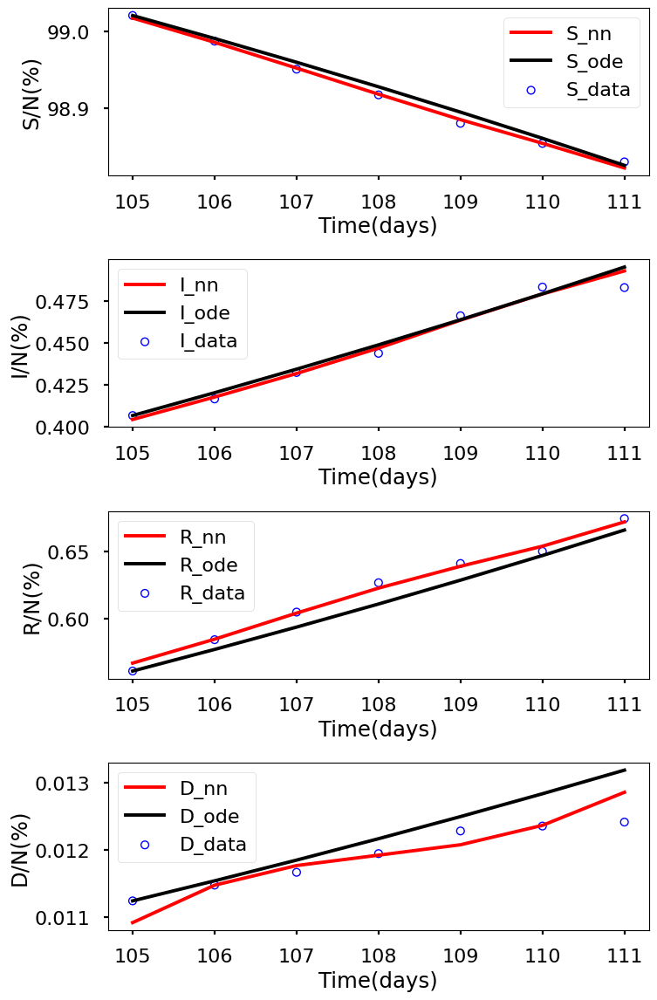

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.036e+00, GE_loss: 2.07373e+00,OB_loss: 9.62549e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 11.84, cumulative_time: 11.84
It: 10000, Loss: 2.324e-05, GE_loss: 6.78869e-06,OB_loss: 1.64526e-05, Beta: 1.04291e+00,gamma: 9.56860e-01,mu: 9.53575e-01, Time: 34.83, cumulative_time: 46.67
It: 20000, Loss: 7.077e-09, GE_loss: 1.57841e-09,OB_loss: 5.49906e-09, Beta: 6.95338e-02,gamma: 3.79953e-02,mu: 3.02546e-03, Time: 34.34, cumulative_time: 81.01
It: 30000, Loss: 9.054e-09, GE_loss: 4.07527e-09,OB_loss: 4.97874e-09, Beta: 6.85634e-02,gamma: 3.88659e-02,mu: 7.73445e-04, Time: 34.55, cumulative_time: 115.56
It: 40000, Loss: 6.008e-09, GE_loss: 1.95653e-09,OB_loss: 4.05173e-09, Beta: 6.85772e-02,gamma: 3.89067e-02,mu: 7.23227e-04, Time: 34.60, cumulative_time: 150.16
beta:  [0.068414]
gamma:  [0.03893735]
mu:  [0.00062908]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


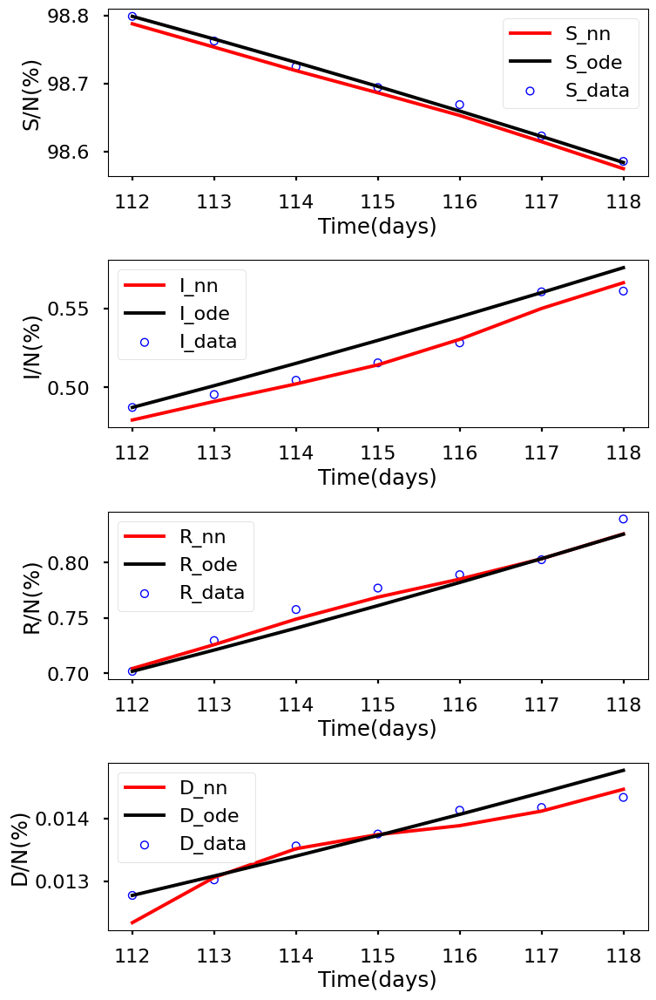

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 3.028e+00, GE_loss: 2.06527e+00,OB_loss: 9.62239e-01, Beta: 1.00100e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 12.30, cumulative_time: 12.30
It: 10000, Loss: 2.736e-05, GE_loss: 7.99711e-06,OB_loss: 1.93584e-05, Beta: 1.04194e+00,gamma: 9.52977e-01,mu: 9.49017e-01, Time: 36.87, cumulative_time: 49.17
It: 20000, Loss: 1.443e-08, GE_loss: 5.50249e-09,OB_loss: 8.92968e-09, Beta: 5.49596e-02,gamma: 4.32262e-02,mu: 2.49480e-03, Time: 35.53, cumulative_time: 84.70
It: 30000, Loss: 1.012e-08, GE_loss: 3.33076e-09,OB_loss: 6.79023e-09, Beta: 5.44680e-02,gamma: 4.39911e-02,mu: 7.05059e-04, Time: 35.51, cumulative_time: 120.21
It: 40000, Loss: 1.014e-08, GE_loss: 3.43821e-09,OB_loss: 6.69803e-09, Beta: 5.44638e-02,gamma: 4.40069e-02,mu: 6.30161e-04, Time: 37.50, cumulative_time: 157.71
beta:  [0.05445713]
gamma:  [0.04401333]
mu:  [0.00058023]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.


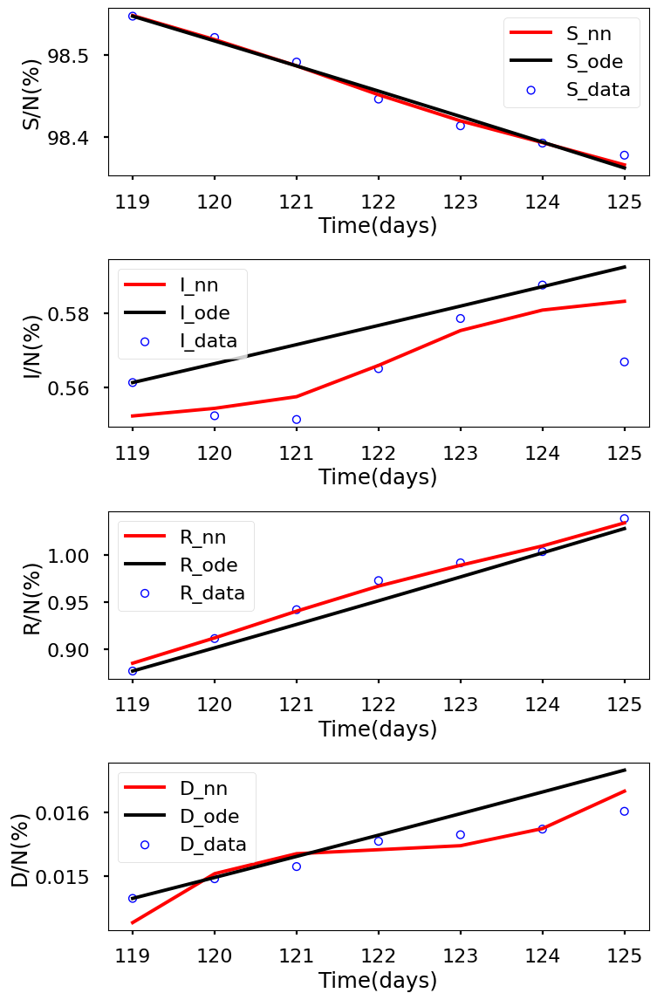

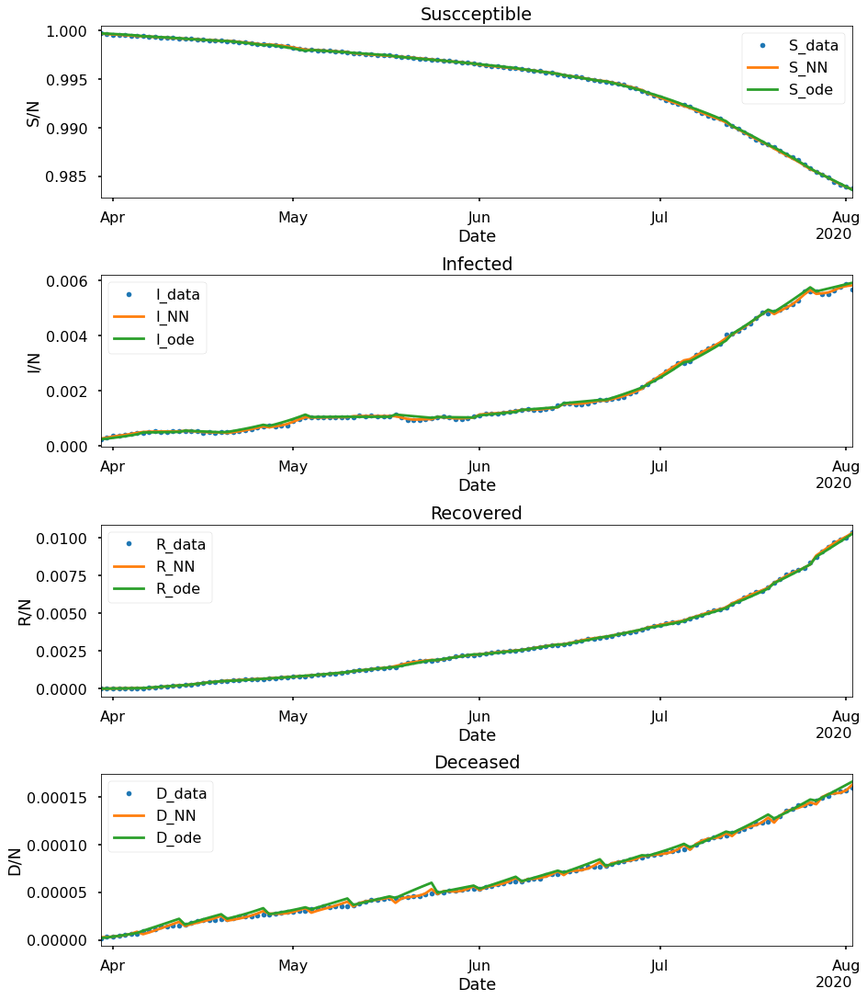

+---------------------+-------------+--------------+--------------+--------------+--------------+--------------+--------------+-------------+--------------+--------------+--------------+--------------+--------------+-------------+--------------+--------------+--------------+---------------+
|      Paramaters     |    Week 1   |    Week 2    |    Week 3    |    Week 4    |    Week 5    |    Week 6    |    Week 7    |    Week 8   |    Week 9    |   Week 10    |   Week 11    |   Week 12    |   Week 13    |   Week 14   |   Week 15    |   Week 16    |   Week 17    |    Week 18    |
+---------------------+-------------+--------------+--------------+--------------+--------------+--------------+--------------+-------------+--------------+--------------+--------------+--------------+--------------+-------------+--------------+--------------+--------------+---------------+
|         beta        | 0.107384555 |  0.06836197  |  0.06866527  |  0.10852949  |  0.10793435  | 0.038219724  | 0.039843045

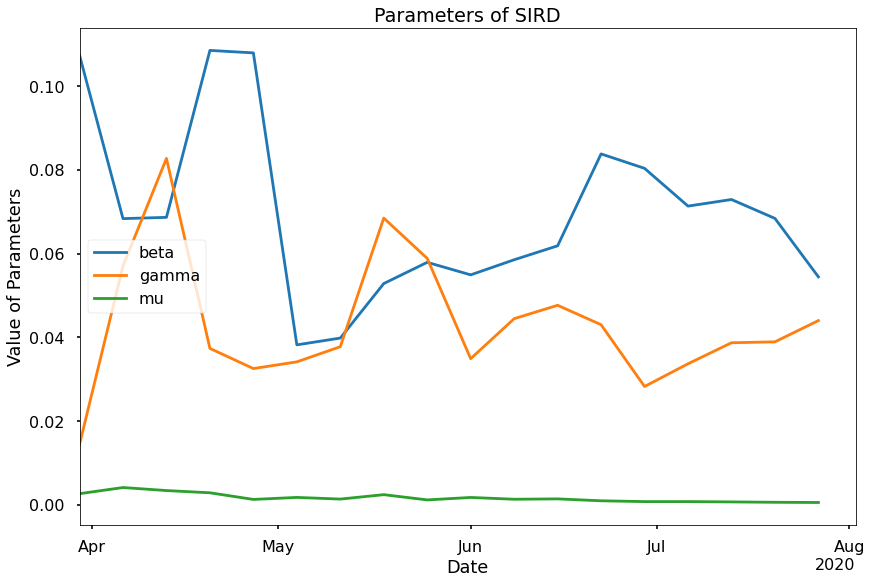

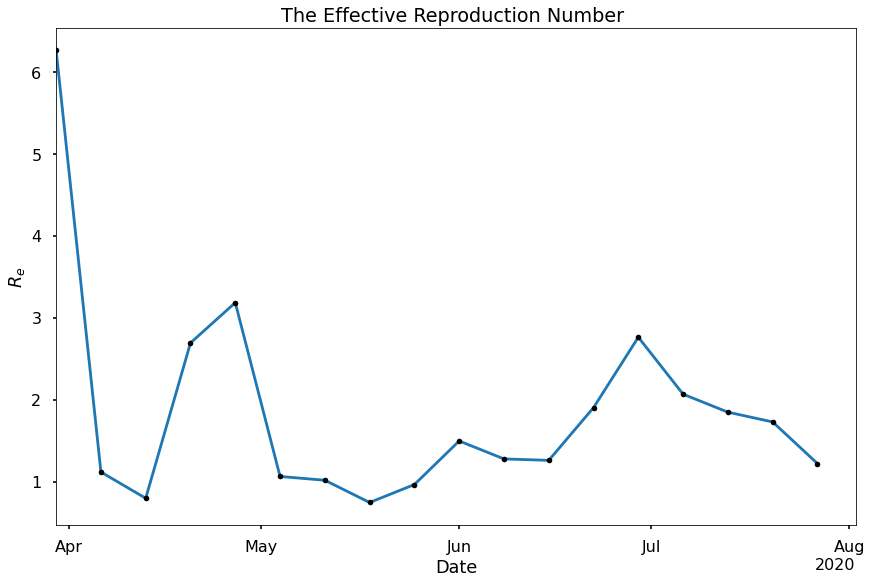

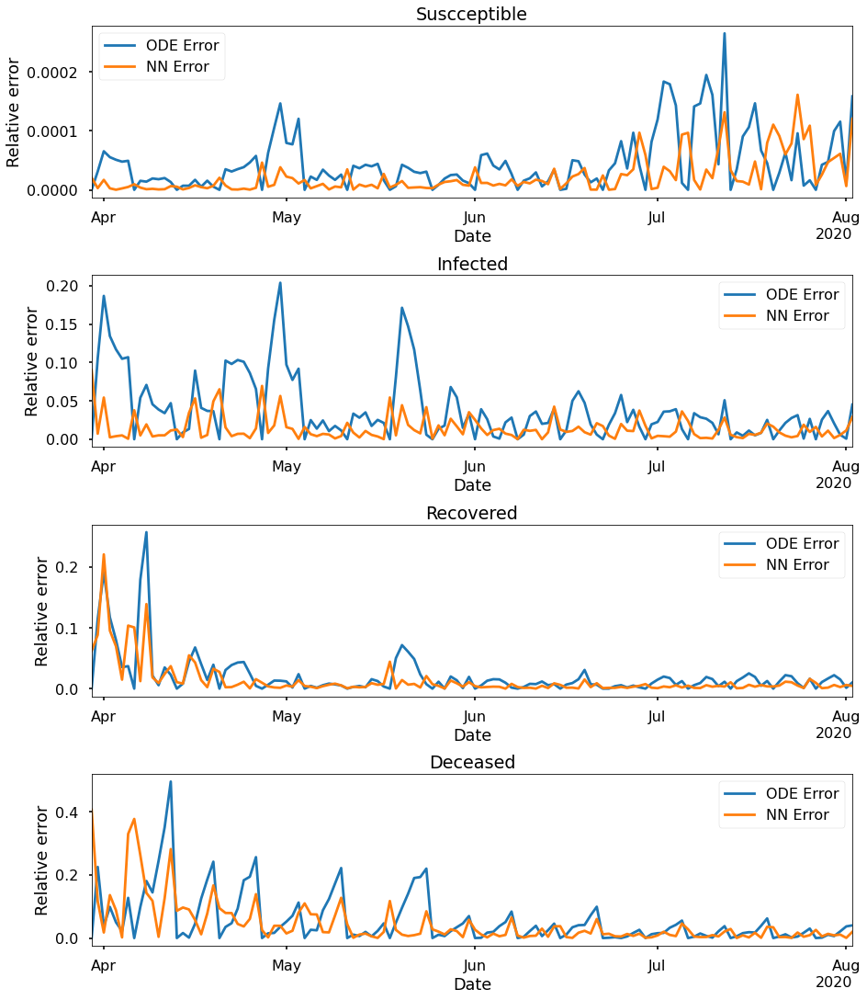

In [ ]:
layers564 = [1,64,64,64,64,64,4]
S564_ode,I564_ode,R564_ode,D564_ode,S564_learned,I564_learned,R564_learned,D564_learned,beta564,gamma564,mu564,S_errnn564,I_errnn564,R_errnn564,D_errnn564,S_erode564,I_errode564,R_errode564,D_errode564,time564 = sum_all(
    layers564,length,SS,II,RC,DC,N0,0.1,50000)

In [ ]:
#Compute the error for the differet layers and neurons for 
I_lnerr216 = np.linalg.norm(I216_learned.reshape(length,1) - II/N0,2)/np.linalg.norm(II/N0,2)
I_lnerr316 = np.linalg.norm(I316_learned.reshape(length,1) - II/N0,2)/np.linalg.norm(II/N0,2)
I_lnerr416 = np.linalg.norm(I416_learned.reshape(length,1) - II/N0,2)/np.linalg.norm(II/N0,2)
I_lnerr516 = np.linalg.norm(I516_learned.reshape(length,1) - II/N0,2)/np.linalg.norm(II/N0,2)
I_lnerr232 = np.linalg.norm(I232_learned.reshape(length,1) - II/N0,2)/np.linalg.norm(II/N0,2)
I_lnerr332 = np.linalg.norm(I332_learned.reshape(length,1) - II/N0,2)/np.linalg.norm(II/N0,2)
I_lnerr432 = np.linalg.norm(I432_learned.reshape(length,1) - II/N0,2)/np.linalg.norm(II/N0,2)
I_lnerr532 = np.linalg.norm(I532_learned.reshape(length,1) - II/N0,2)/np.linalg.norm(II/N0,2)
I_lnerr264 = np.linalg.norm(I264_learned.reshape(length,1) - II/N0,2)/np.linalg.norm(II/N0,2)
I_lnerr364 = np.linalg.norm(I364_learned.reshape(length,1) - II/N0,2)/np.linalg.norm(II/N0,2)
I_lnerr464 = np.linalg.norm(I464_learned.reshape(length,1) - II/N0,2)/np.linalg.norm(II/N0,2)
I_lnerr564 = np.linalg.norm(I564_learned.reshape(length,1) - II/N0,2)/np.linalg.norm(II/N0,2)
print("--------------------------------Learned Error---------------------------------")
x1 = PrettyTable()
x1.field_names = ["Neurons\Layers","2","3","4","5"]
x1.add_row(["16",I_lnerr216,I_lnerr316,I_lnerr416,I_lnerr516])
x1.add_row(["32",I_lnerr232,I_lnerr332,I_lnerr432,I_lnerr532])
x1.add_row(["64",I_lnerr264,I_lnerr364,I_lnerr464,I_lnerr564])
print(x1)

--------------------------------Learned Error---------------------------------
+----------------+----------------------+----------------------+----------------------+----------------------+
| Neurons\Layers |          2           |          3           |          4           |          5           |
+----------------+----------------------+----------------------+----------------------+----------------------+
|       16       | 0.01588260382365348  | 0.014987920586657617 | 0.014346802917905715 | 0.01430941231271781  |
|       32       | 0.014768405079545157 | 0.012778634223403345 | 0.01397583410583142  | 0.01406852069839882  |
|       64       | 0.014435475756174076 | 0.014275738925126982 | 0.014091989763442933 | 0.014078316558259451 |
+----------------+----------------------+----------------------+----------------------+----------------------+


In [ ]:
print("----------------------------------ODE error-------------------------------------")
#Compute the error for the differet layers and neurons for 
I_oderr216 = np.linalg.norm(I216_ode.reshape(length,1) - II/N0,1)/np.linalg.norm(II/N0,1)
I_oderr316 = np.linalg.norm(I316_ode.reshape(length,1) - II/N0,1)/np.linalg.norm(II/N0,1)
I_oderr416 = np.linalg.norm(I416_ode.reshape(length,1) - II/N0,1)/np.linalg.norm(II/N0,1)
I_oderr516 = np.linalg.norm(I516_ode.reshape(length,1) - II/N0,1)/np.linalg.norm(II/N0,1)
I_oderr232 = np.linalg.norm(I232_ode.reshape(length,1) - II/N0,1)/np.linalg.norm(II/N0,1)
I_oderr332 = np.linalg.norm(I332_ode.reshape(length,1) - II/N0,1)/np.linalg.norm(II/N0,1)
I_oderr432 = np.linalg.norm(I432_ode.reshape(length,1) - II/N0,1)/np.linalg.norm(II/N0,1)
I_oderr532 = np.linalg.norm(I532_ode.reshape(length,1) - II/N0,1)/np.linalg.norm(II/N0,1)
I_oderr264 = np.linalg.norm(I264_ode.reshape(length,1) - II/N0,1)/np.linalg.norm(II/N0,1)
I_oderr364 = np.linalg.norm(I364_ode.reshape(length,1) - II/N0,1)/np.linalg.norm(II/N0,1)
I_oderr464 = np.linalg.norm(I464_ode.reshape(length,1) - II/N0,1)/np.linalg.norm(II/N0,1)
I_oderr564 = np.linalg.norm(I564_ode.reshape(length,1) - II/N0,1)/np.linalg.norm(II/N0,1)
x2 = PrettyTable()
x2.field_names = ["Neurons\Layers","2","3","4","5"]
x2.add_row(["16",I_oderr216,I_oderr316,I_oderr416,I_oderr516])
x2.add_row(["32",I_oderr232,I_oderr332,I_oderr432,I_oderr532])
x2.add_row(["64",I_oderr264,I_oderr364,I_oderr464,I_oderr564])
print(x2)

----------------------------------ODE error-------------------------------------
+----------------+----------------------+----------------------+----------------------+----------------------+
| Neurons\Layers |          2           |          3           |          4           |          5           |
+----------------+----------------------+----------------------+----------------------+----------------------+
|       16       | 0.02733321846835755  | 0.026792953787528693 | 0.026383069742426657 | 0.026427477654050437 |
|       32       | 0.02681535041212241  | 0.02427419253128401  | 0.02601321050718036  | 0.026118635962672238 |
|       64       | 0.026526085269426215 | 0.02630184129754782  | 0.025996227365988705 | 0.026049695072473657 |
+----------------+----------------------+----------------------+----------------------+----------------------+


In [ ]:
x3 = PrettyTable()
print("---------------------CPU TIME--------------------------")
x3.field_names = ["Neurons\Layers","2","3","4","5"]
x3.add_row(["16",time216,time316,time416,time516])
x3.add_row(["32",time232,time332,time432,time532])
x3.add_row(["64",time264,time364,time464,time564])
print(x3)

---------------------CPU TIME--------------------------
+----------------+--------------------+--------------------+--------------------+--------------------+
| Neurons\Layers |         2          |         3          |         4          |         5          |
+----------------+--------------------+--------------------+--------------------+--------------------+
|       16       | 1580.3068747520447 | 1779.163183927536  | 1953.8383400440216 | 2133.7649533748627 |
|       32       | 1747.2543189525604 | 1931.9143872261047 | 2200.308916568756  | 2458.932013273239  |
|       64       | 1925.8477275371552 | 2224.690681695938  | 2507.535231113434  | 2747.4774923324585 |
+----------------+--------------------+--------------------+--------------------+--------------------+
